# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcatdata

100% 265k/265k [00:00<00:00, 604kB/s]
100% 265k/265k [00:00<00:00, 604kB/s]


In [ ]:
! unzip /content/memcatdata.zip

Archive:  /content/memcatdata.zip
  inflating: memcat_image_data.csv   


In [ ]:
! kaggle datasets download -d rattapornk/image-merged

100% 1.09G/1.09G [00:51<00:00, 27.0MB/s]
100% 1.09G/1.09G [00:51<00:00, 22.9MB/s]


In [ ]:
! unzip /content/image-merged.zip

Streaming output truncated to the last 5000 lines.
  inflating: merged/n02355227_5820.jpg  
  inflating: merged/n02355227_5898.jpg  
  inflating: merged/n02355227_6323.jpg  
  inflating: merged/n02355227_6434.jpg  
  inflating: merged/n02355227_6696.jpg  
  inflating: merged/n02355227_7587.jpg  
  inflating: merged/n02355227_7784.jpg  
  inflating: merged/n02355227_7881.jpg  
  inflating: merged/n02355227_8112.jpg  
  inflating: merged/n02355227_8561.jpg  
  inflating: merged/n02355227_8586.jpg  
  inflating: merged/n02355227_8789.jpg  
  inflating: merged/n02355227_9552.jpg  
  inflating: merged/n02355227_9703.jpg  
  inflating: merged/n02374451_17392.jpg  
  inflating: merged/n02374451_4963.jpg  
  inflating: merged/n02379743_11969.jpg  
  inflating: merged/n02381004_7100.jpg  
  inflating: merged/n02381004_8273.jpg  
  inflating: merged/n02381004_9323.jpg  
  inflating: merged/n02386310_9220.jpg  
  inflating: merged/n02387722_10980.jpg  
  inflating: merged/n02389026_1198.jpg  
  i

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.3 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 10.8 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
pip install scipy

In [ ]:
from scipy.stats import spearmanr
from torchsummary import summary
import time

# Preprocess & Split

In [ ]:
df_merge = pd.read_csv("/content/memcat_image_data.csv")
df_merge["image_file"] =df_merge["image_file"].apply(lambda file: "/content/merged" +"/"+ file) # Create image path
df_merge["memorability_wo_fa_correction"] = df_merge["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_merge.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,1,/content/merged/000000003481.jpg,animal,bear,316.0,500.0,coco,bear,1.0,55,4,98,0.561224,0.520408
1,2,/content/merged/000000005745.jpg,animal,bear,427.0,640.0,coco,bear,1.0,64,4,81,0.790123,0.740741
2,3,/content/merged/000000011552.jpg,animal,bear,427.0,640.0,coco,bear,1.0,75,5,104,0.721154,0.673077
3,4,/content/merged/000000027439.jpg,animal,bear,359.0,640.0,coco,bear,1.0,92,3,114,0.807018,0.780702
4,5,/content/merged/000000055601.jpg,animal,bear,380.0,640.0,coco,bear,1.0,83,12,102,0.813725,0.696078


Image shape: (10000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 115.64354532711522
Standard deviation of pixel values: 68.17203453698677


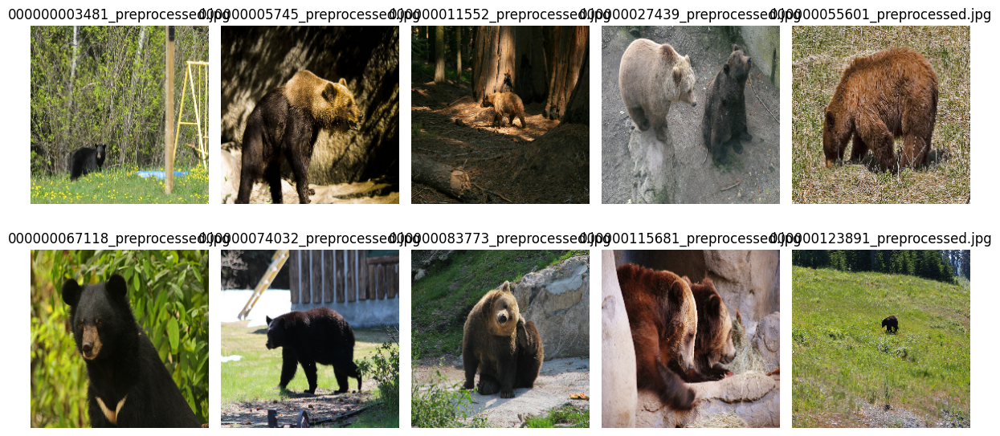

In [ ]:
# Sample data (replace this with your DataFrame)
df_merge = pd.DataFrame({
    'image_file': df_merge["image_file"],
    'memoscore': df_merge["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_merge['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_merge.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Calculate padding size
    target_size = 224
    pad_y = (target_size - image.shape[0]) // 2
    pad_x = (target_size - image.shape[1]) // 2

    # Add padding using np.pad()
    image = np.pad(image, ((pad_y, pad_y), (pad_x, pad_x), (0, 0)), mode='constant', constant_values=(0, 0))

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_merge.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_merge.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_merge.head()

,image_file,memoscore,preprocessed_image_path
0,/content/merged/000000003481.jpg,0.561224,/content/merged/000000003481_preprocessed.jpg
1,/content/merged/000000005745.jpg,0.790123,/content/merged/000000005745_preprocessed.jpg
2,/content/merged/000000011552.jpg,0.721154,/content/merged/000000011552_preprocessed.jpg
3,/content/merged/000000027439.jpg,0.807018,/content/merged/000000027439_preprocessed.jpg
4,/content/merged/000000055601.jpg,0.813725,/content/merged/000000055601_preprocessed.jpg


In [ ]:
del df_merge["image_file"]

In [ ]:
df_merge.head()

,memoscore,preprocessed_image_path
0,0.561224,/content/merged/000000003481_preprocessed.jpg
1,0.790123,/content/merged/000000005745_preprocessed.jpg
2,0.721154,/content/merged/000000011552_preprocessed.jpg
3,0.807018,/content/merged/000000027439_preprocessed.jpg
4,0.813725,/content/merged/000000055601_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_merge.drop('memoscore', axis=1)), pd.DataFrame(df_merge['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 9000
Validation set size: 500
Test set size: 500


In [ ]:
X_train.head()

,preprocessed_image_path
1662,/content/merged/000000381641_preprocessed.jpg
6297,/content/merged/10a34585df04a36e_preprocessed.jpg
983,/content/merged/000000498610_preprocessed.jpg
2716,/content/merged/000000125755_preprocessed.jpg
1788,/content/merged/n02355227_6323_preprocessed.jpg


In [ ]:
merged_train_merge= pd.concat([X_train, y_train], axis=1)
merged_train_merge

,preprocessed_image_path,memoscore
1662,/content/merged/000000381641_preprocessed.jpg,0.653846
6297,/content/merged/10a34585df04a36e_preprocessed.jpg,0.698925
983,/content/merged/000000498610_preprocessed.jpg,0.777778
2716,/content/merged/000000125755_preprocessed.jpg,0.798077
1788,/content/merged/n02355227_6323_preprocessed.jpg,0.876543
...,...,...
2288,/content/merged/n07720875_8835_preprocessed.jpg,0.931035
148,/content/merged/000000338091_preprocessed.jpg,0.793814
9244,/content/merged/n04349306_1467_preprocessed.jpg,0.840708
7684,/content/merged/000000126755_preprocessed.jpg,0.688172


In [ ]:
merged_val_merge = pd.concat([X_val, y_val], axis=1)
merged_val_merge

,preprocessed_image_path,memoscore
3130,/content/merged/000000032964_preprocessed.jpg,0.885417
2942,/content/merged/n07929519_31339_preprocessed.jpg,0.811111
2126,/content/merged/000000347568_preprocessed.jpg,0.871287
1758,/content/merged/n02355227_14799_preprocessed.jpg,0.861386
98,/content/merged/n02133161_1148_preprocessed.jpg,0.777778
...,...,...
2642,/content/merged/n07717556_3102_preprocessed.jpg,0.816327
7535,/content/merged/000000408049_preprocessed.jpg,0.777778
5759,/content/merged/n09472597_446_preprocessed.jpg,0.571429
28,/content/merged/000000272804_preprocessed.jpg,0.620690


In [ ]:
merged_test_merge = pd.concat([X_test, y_test], axis=1)
merged_test_merge

,preprocessed_image_path,memoscore
5073,/content/merged/n07801091_41884_preprocessed.jpg,0.569767
1844,/content/merged/n02396427_21276_preprocessed.jpg,0.630435
3545,/content/merged/000000271283_preprocessed.jpg,0.808989
1321,/content/merged/n02450034_2862_preprocessed.jpg,0.868687
6851,/content/merged/b0bc605978c40a86_preprocessed.jpg,0.772727
...,...,...
4939,/content/merged/n12345899_16717_preprocessed.jpg,0.703297
6661,/content/merged/97aaac154962a793_preprocessed.jpg,0.820513
8430,/content/merged/n04166281_5438_preprocessed.jpg,0.836364
4102,/content/merged/n02793495_12386_preprocessed.jpg,0.728972


# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_merge= '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/merge_Vit.csv'
merged_train_merge.to_csv(csv_train_merge, index=False)

In [ ]:
csv_val_merge = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/merge_Vit.csv'
merged_val_merge.to_csv(csv_val_merge, index=False)

In [ ]:
csv_test_merge = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/merge_Vit.csv'
merged_test_merge.to_csv(csv_test_merge, index=False)

#Load Dataset

In [ ]:
df_train_merge = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/merge_Vit.csv")
df_val_merge = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/merge_Vit.csv')
df_test_merge = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/merge_Vit.csv')

In [ ]:
df_train_merge.head()

,preprocessed_image_path,memoscore
0,/content/merged/n02932891_37818_preprocessed.jpg,0.625000
1,/content/merged/sun_auhghulmqnsysiyp_preproces...,0.490000
2,/content/merged/000000064283_preprocessed.jpg,0.776786
3,/content/merged/n04349306_5722_preprocessed.jpg,0.840909
4,/content/merged/n00464894_13676_preprocessed.jpg,0.860000


In [ ]:
df_train_merge.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9000 entries, 0 to 8999
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  9000 non-null   object 
 1   memoscore                9000 non-null   float64
dtypes: float64(1), object(1)
memory usage: 140.8+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_merge(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_merge["memoscore"]
        self.images = df_train_merge["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds = Dataset_merge(df_train_merge, trans_transform=trans_transform)
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_merge(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit =  ViTMem_model_merge( arch="vit_base_patch16_224_miil")



model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_merge().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_vit  = to_device(model_vit  , device)

In [ ]:
params = [param for param in list(model_vit.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.0026647751219570637

 Epoch: (1/30) Loss_rmse = 0.0516214594244957

 Epoch: (1/30) R^2 = 0.8811115622520447

 Epoch: (1/30) MAE = 0.03787370026111603
Spearman correlation coefficient: SignificanceResult(statistic=0.6651584366371639, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.861

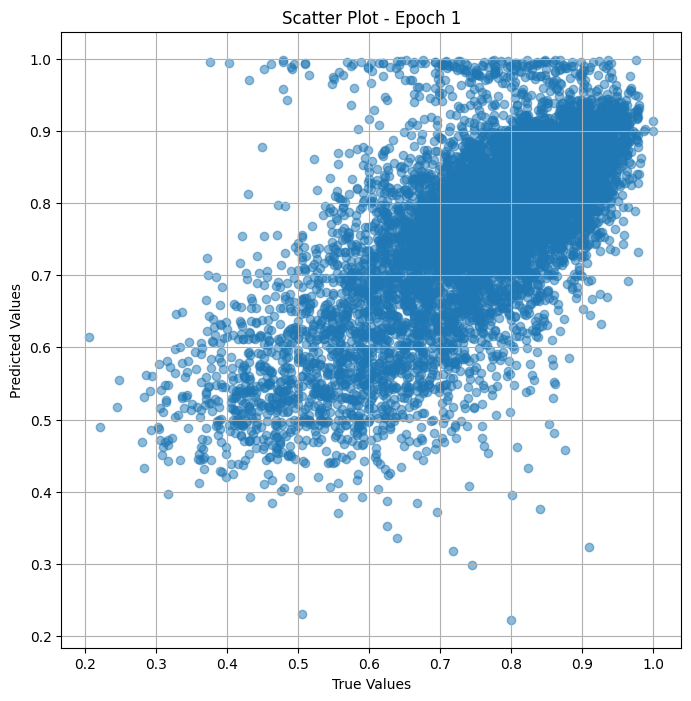

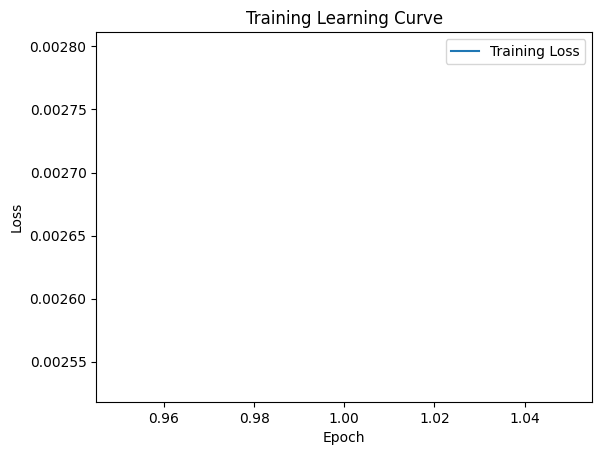


 Epoch: (2/30) Loss = 0.004135466180741787

 Epoch: (2/30) Loss_rmse = 0.06430759280920029

 Epoch: (2/30) R^2 = 0.8154969811439514

 Epoch: (2/30) MAE = 0.055677205324172974
Spearman correlation coefficient: SignificanceResult(statistic=0.824109480528842, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.861

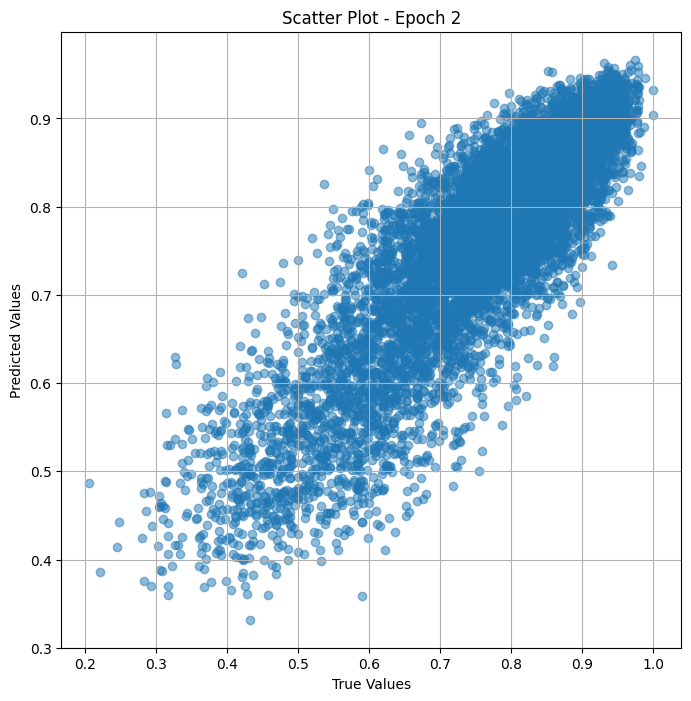

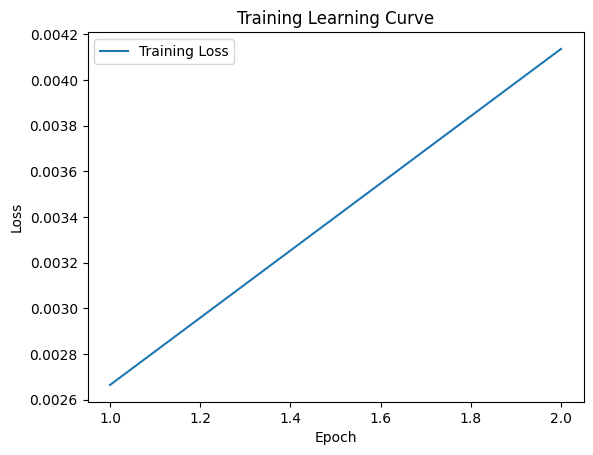


 Epoch: (3/30) Loss = 0.0031195497140288353

 Epoch: (3/30) Loss_rmse = 0.05585293099284172

 Epoch: (3/30) R^2 = 0.8608219027519226

 Epoch: (3/30) MAE = 0.04479499161243439
Spearman correlation coefficient: SignificanceResult(statistic=0.857386708345052, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.861

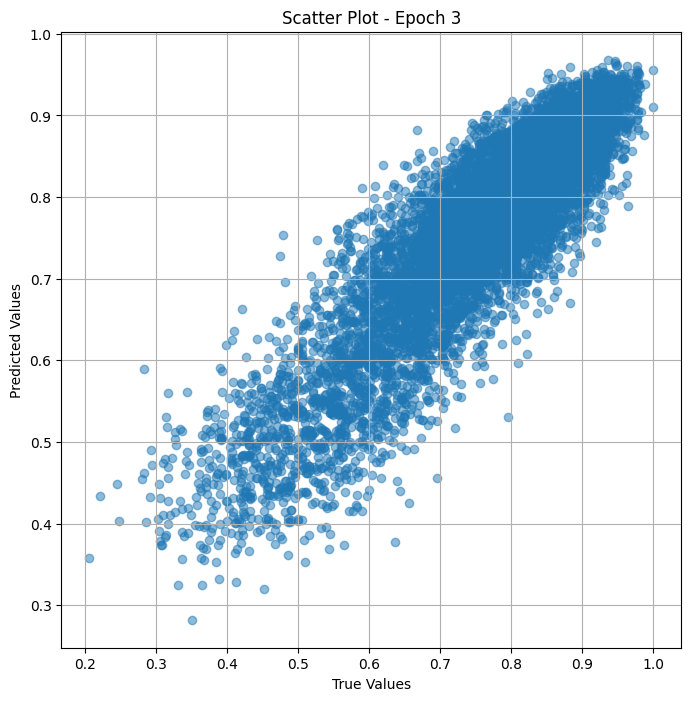

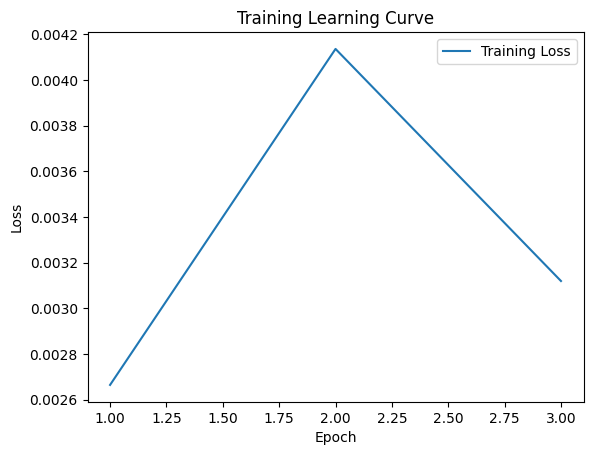


 Epoch: (4/30) Loss = 0.0014663219917565584

 Epoch: (4/30) Loss_rmse = 0.03829258307814598

 Epoch: (4/30) R^2 = 0.9345803260803223

 Epoch: (4/30) MAE = 0.03481309860944748
Spearman correlation coefficient: SignificanceResult(statistic=0.8761624740839401, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

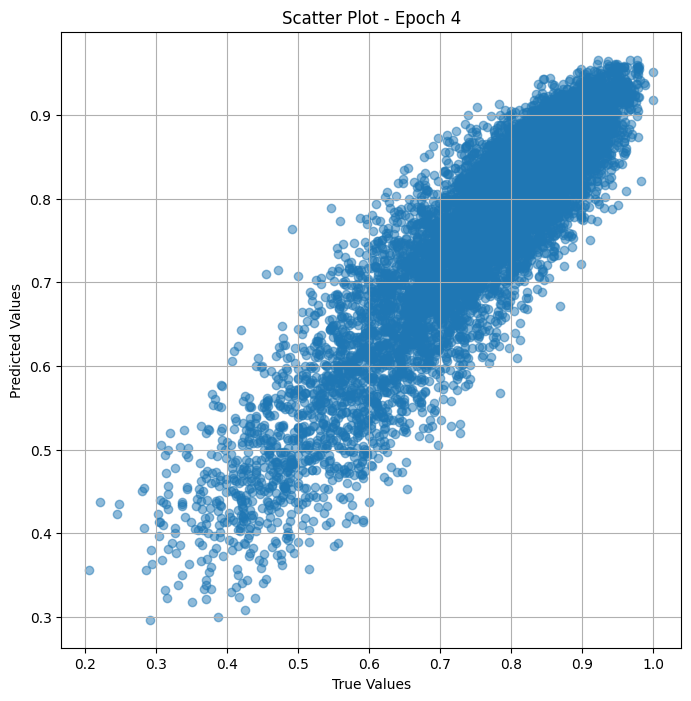

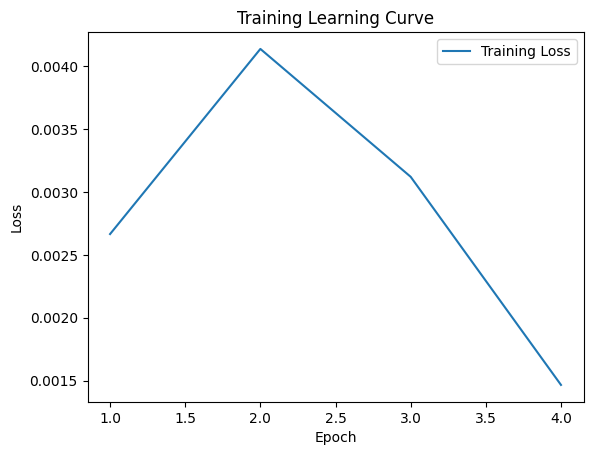


 Epoch: (5/30) Loss = 0.0025135460309684277

 Epoch: (5/30) Loss_rmse = 0.05013527721166611

 Epoch: (5/30) R^2 = 0.8878586292266846

 Epoch: (5/30) MAE = 0.03263641148805618
Spearman correlation coefficient: SignificanceResult(statistic=0.8965134470040367, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

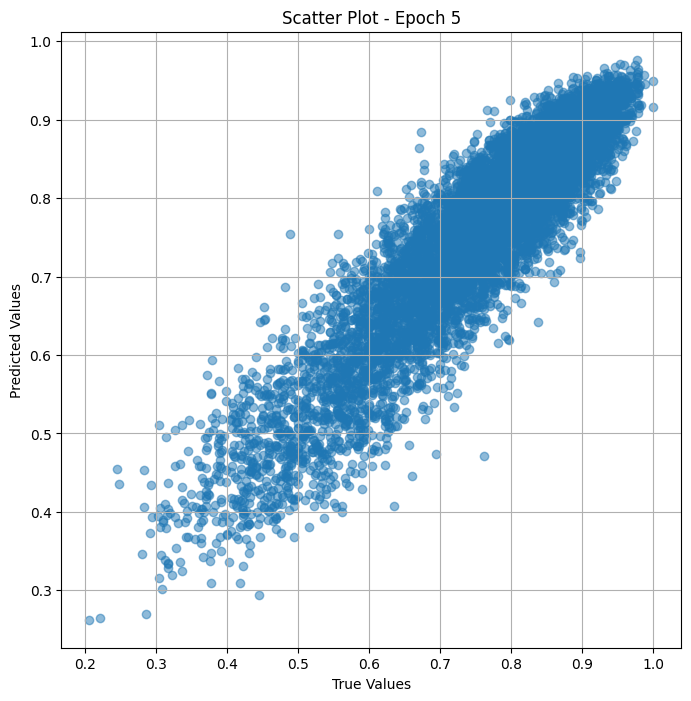

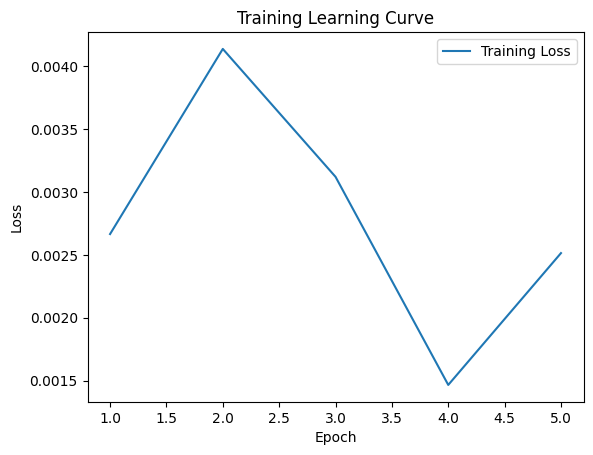


 Epoch: (6/30) Loss = 0.002160816453397274

 Epoch: (6/30) Loss_rmse = 0.046484582126140594

 Epoch: (6/30) R^2 = 0.9035955667495728

 Epoch: (6/30) MAE = 0.03061167523264885
Spearman correlation coefficient: SignificanceResult(statistic=0.9222038586821438, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

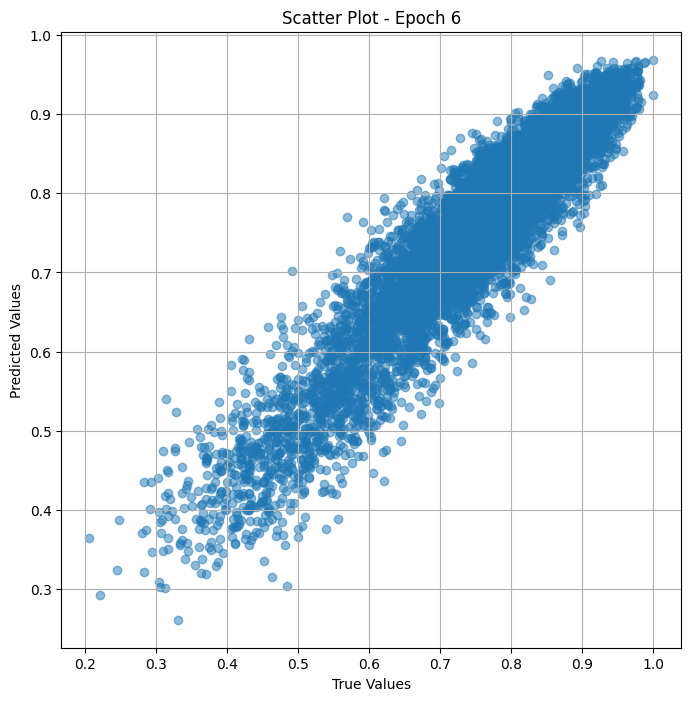

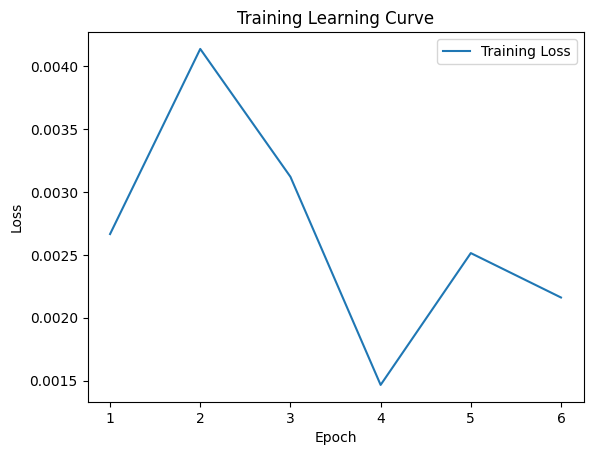

Epoch 0.06: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/30) Loss = 0.003911300096660852

 Epoch: (7/30) Loss_rmse = 0.06254038959741592

 Epoch: (7/30) R^2 = 0.825498104095459

 Epoch: (7/30) MAE = 0.04931582510471344
Spearman correlation coefficient: SignificanceResult(statistic=0.9436119509073867, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.

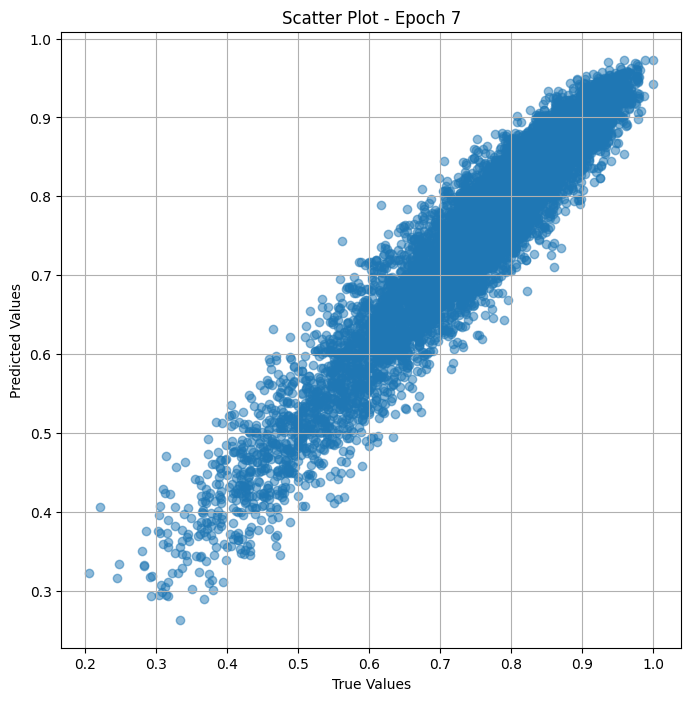

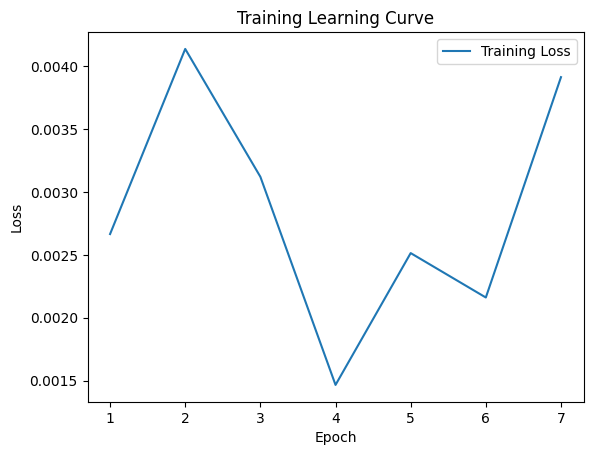


 Epoch: (8/30) Loss = 0.00032229407224804163

 Epoch: (8/30) Loss_rmse = 0.01795255020260811

 Epoch: (8/30) R^2 = 0.98562091588974

 Epoch: (8/30) MAE = 0.01554533839225769
Spearman correlation coefficient: SignificanceResult(statistic=0.966957297645396, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.8613

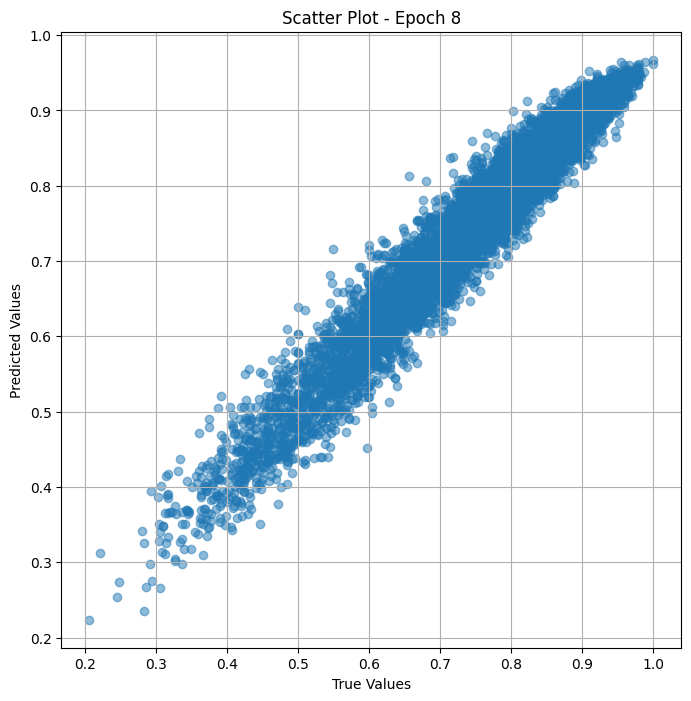

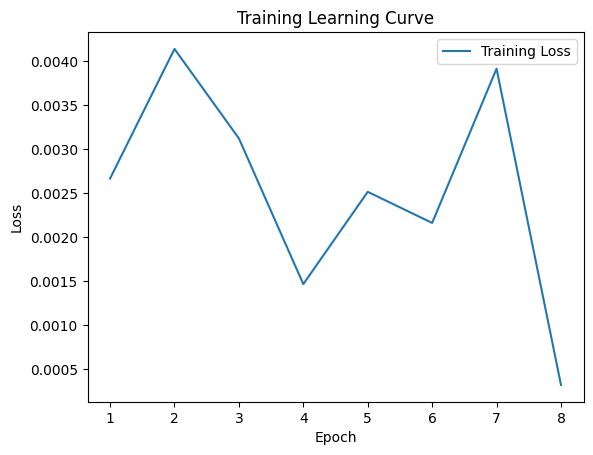


 Epoch: (9/30) Loss = 0.00018680273205973208

 Epoch: (9/30) Loss_rmse = 0.013667579740285873

 Epoch: (9/30) R^2 = 0.9916658401489258

 Epoch: (9/30) MAE = 0.011077247560024261
Spearman correlation coefficient: SignificanceResult(statistic=0.9765080814007463, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0

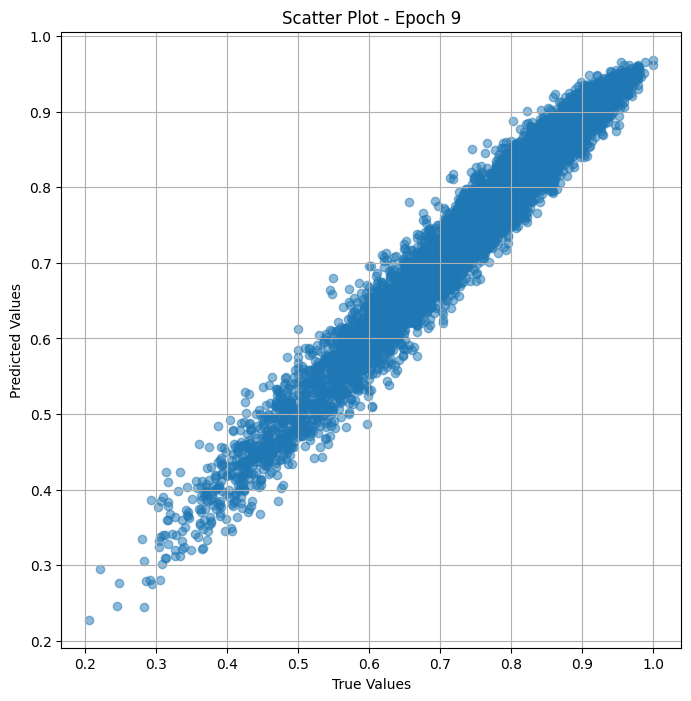

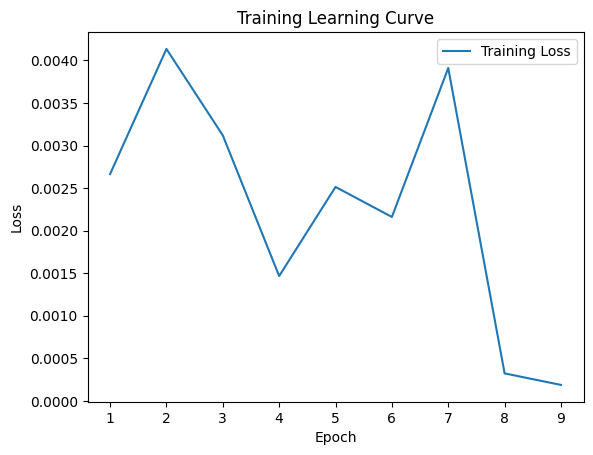


 Epoch: (10/30) Loss = 0.00012500239245127887

 Epoch: (10/30) Loss_rmse = 0.011180446483194828

 Epoch: (10/30) R^2 = 0.9944230318069458

 Epoch: (10/30) MAE = 0.008479684591293335
Spearman correlation coefficient: SignificanceResult(statistic=0.9815273472012864, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

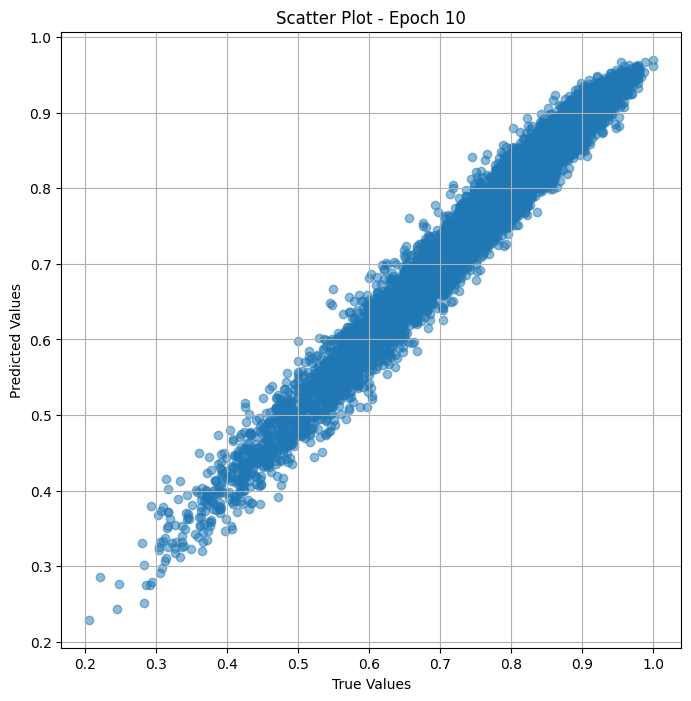

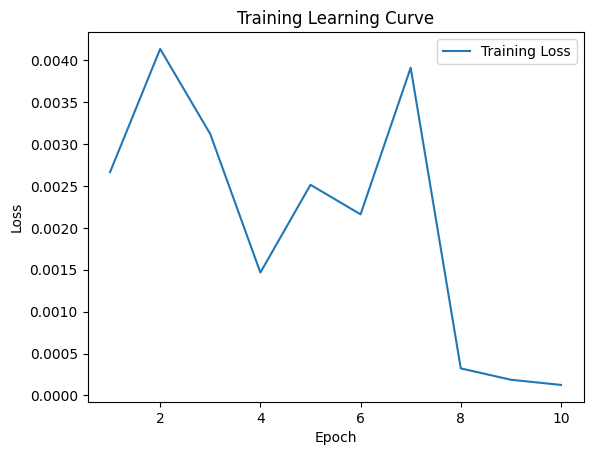


 Epoch: (11/30) Loss = 9.846198372542858e-05

 Epoch: (11/30) Loss_rmse = 0.00992280151695013

 Epoch: (11/30) R^2 = 0.9956071376800537

 Epoch: (11/30) MAE = 0.007232844829559326
Spearman correlation coefficient: SignificanceResult(statistic=0.985360184895083, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 

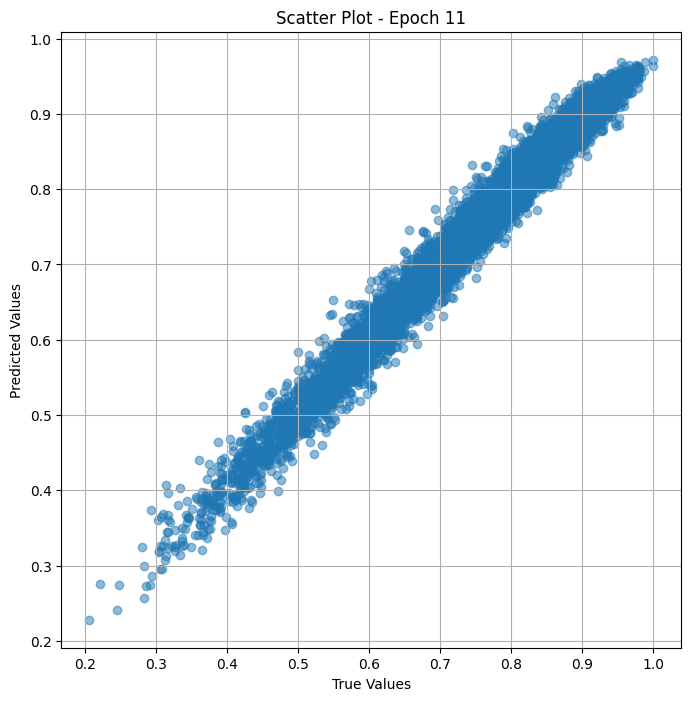

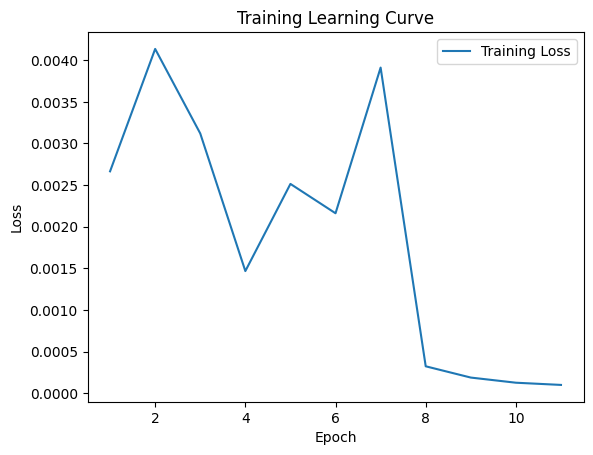


 Epoch: (12/30) Loss = 8.319686457980424e-05

 Epoch: (12/30) Loss_rmse = 0.009121231734752655

 Epoch: (12/30) R^2 = 0.9962881803512573

 Epoch: (12/30) MAE = 0.006390109658241272
Spearman correlation coefficient: SignificanceResult(statistic=0.9885071493238566, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

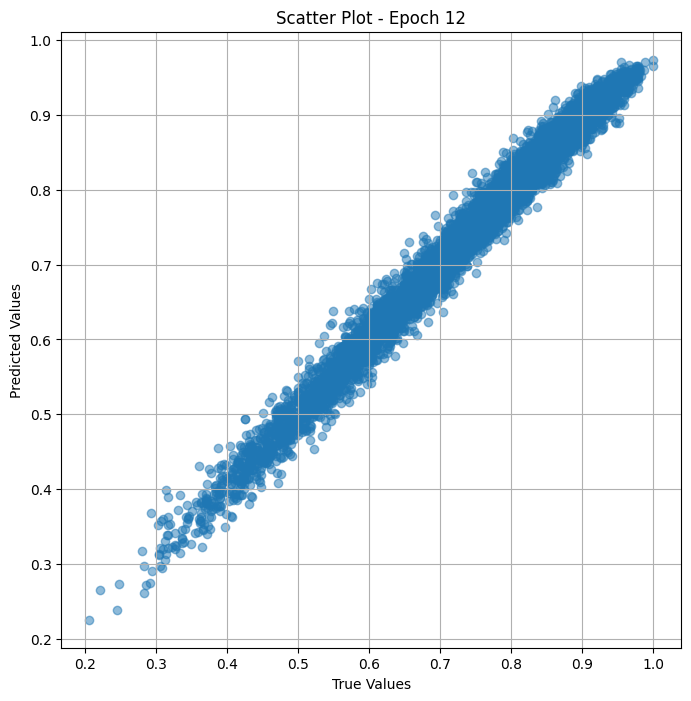

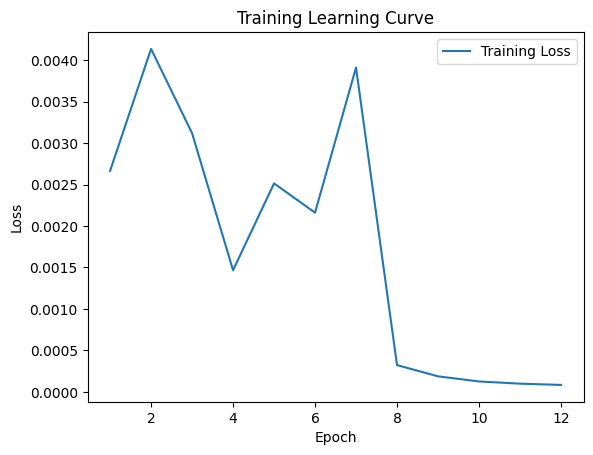


 Epoch: (13/30) Loss = 6.73461181577295e-05

 Epoch: (13/30) Loss_rmse = 0.00820646807551384

 Epoch: (13/30) R^2 = 0.9969953894615173

 Epoch: (13/30) MAE = 0.0055118128657341
Spearman correlation coefficient: SignificanceResult(statistic=0.9911386323500117, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.

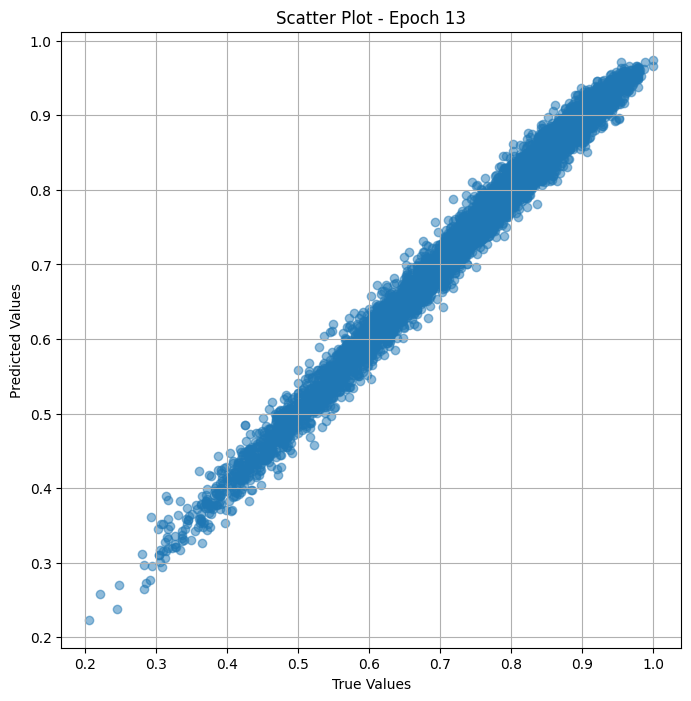

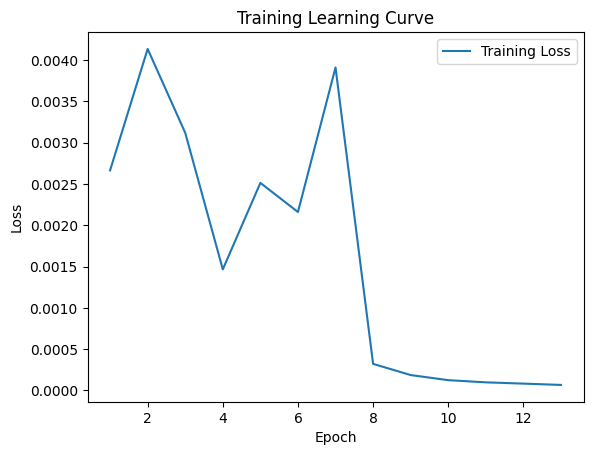


 Epoch: (14/30) Loss = 5.461613181978464e-05

 Epoch: (14/30) Loss_rmse = 0.007390272803604603

 Epoch: (14/30) R^2 = 0.9975633025169373

 Epoch: (14/30) MAE = 0.00473359227180481
Spearman correlation coefficient: SignificanceResult(statistic=0.9933209351162379, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694,

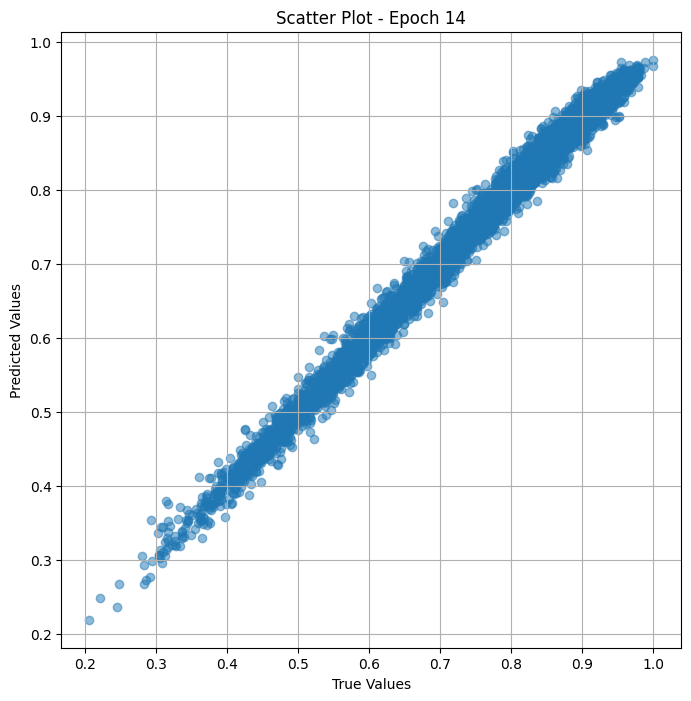

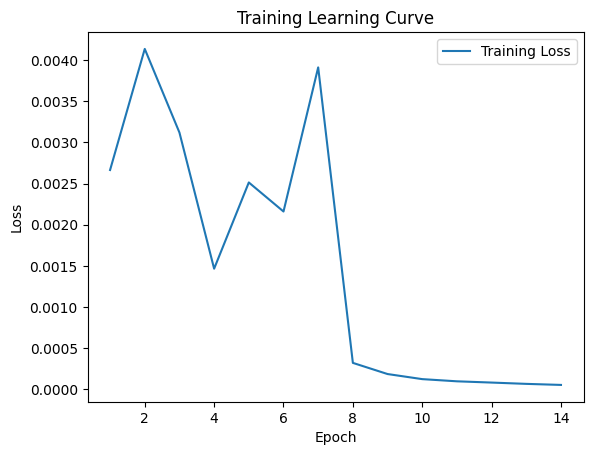


 Epoch: (15/30) Loss = 4.1667637560749426e-05

 Epoch: (15/30) Loss_rmse = 0.006455047521740198

 Epoch: (15/30) R^2 = 0.9981409907341003

 Epoch: (15/30) MAE = 0.003918573260307312
Spearman correlation coefficient: SignificanceResult(statistic=0.9950932866379273, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

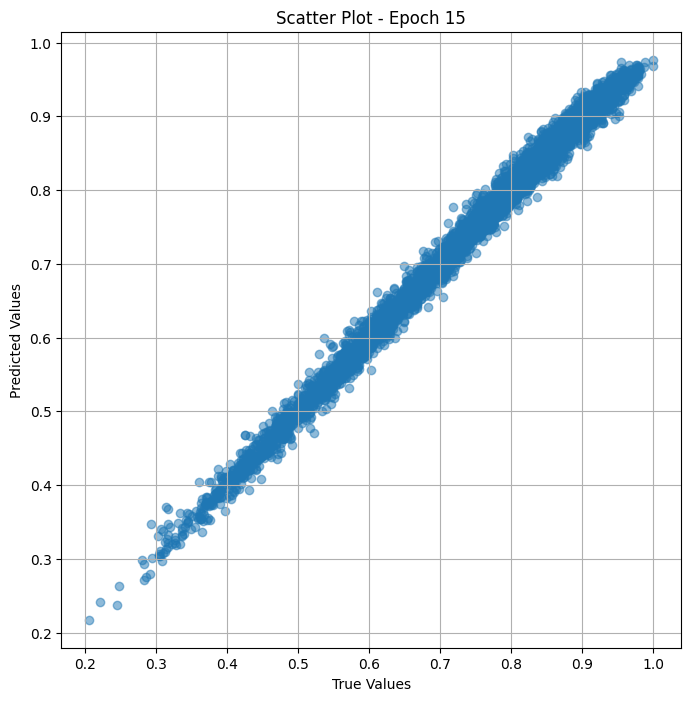

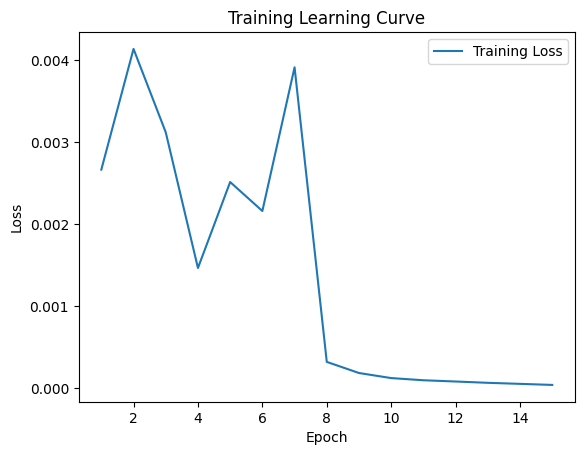


 Epoch: (16/30) Loss = 2.68356943706749e-05

 Epoch: (16/30) Loss_rmse = 0.005180317908525467

 Epoch: (16/30) R^2 = 0.9988027215003967

 Epoch: (16/30) MAE = 0.003113657236099243
Spearman correlation coefficient: SignificanceResult(statistic=0.9964863892168712, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694,

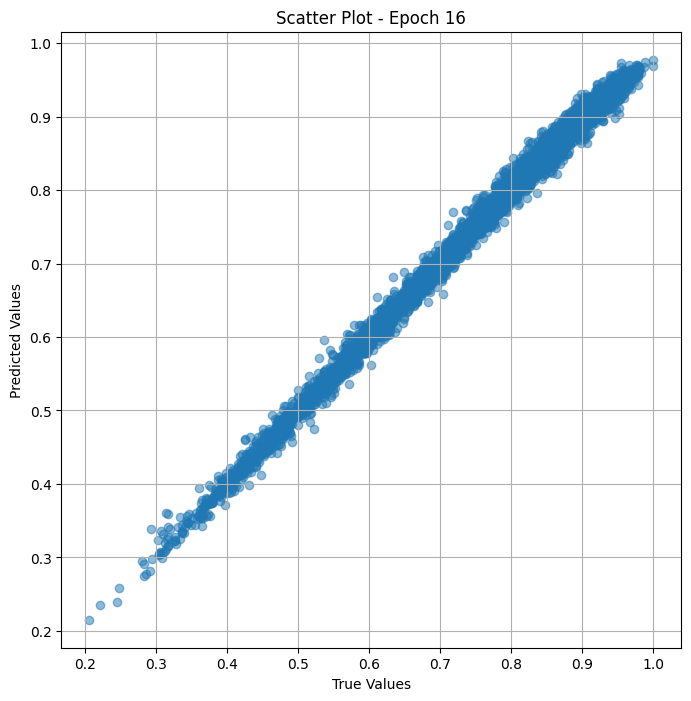

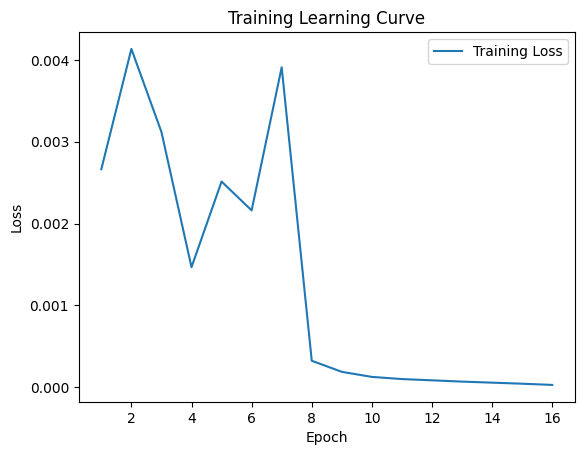


 Epoch: (17/30) Loss = 1.9110022549284622e-05

 Epoch: (17/30) Loss_rmse = 0.004371501039713621

 Epoch: (17/30) R^2 = 0.9991474151611328

 Epoch: (17/30) MAE = 0.0024733468890190125
Spearman correlation coefficient: SignificanceResult(statistic=0.9975492718491366, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

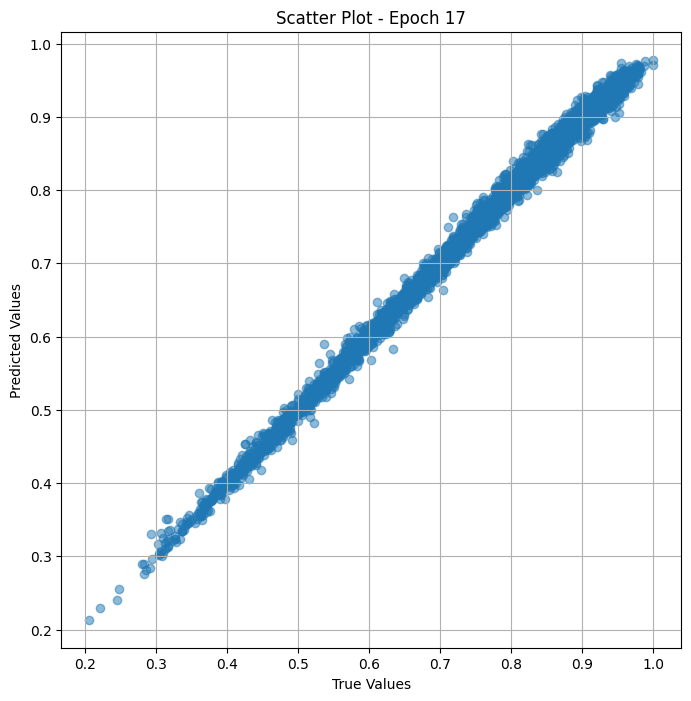

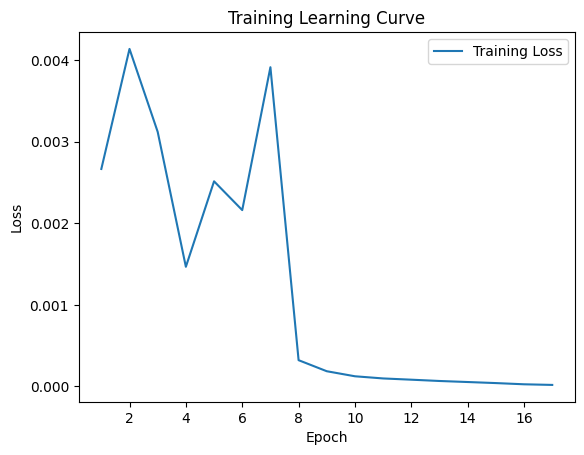


 Epoch: (18/30) Loss = 9.306411811849102e-06

 Epoch: (18/30) Loss_rmse = 0.003050641156733036

 Epoch: (18/30) R^2 = 0.9995847940444946

 Epoch: (18/30) MAE = 0.0017144344747066498
Spearman correlation coefficient: SignificanceResult(statistic=0.9983264936150174, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

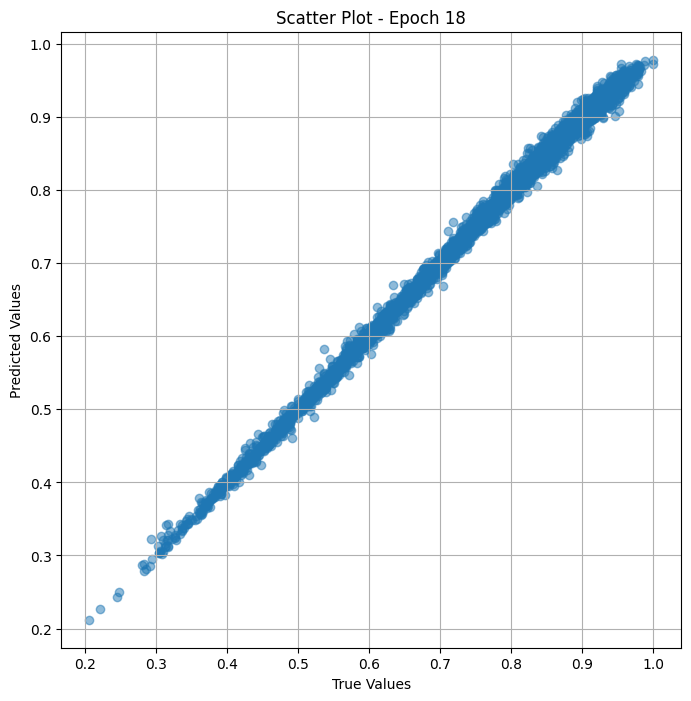

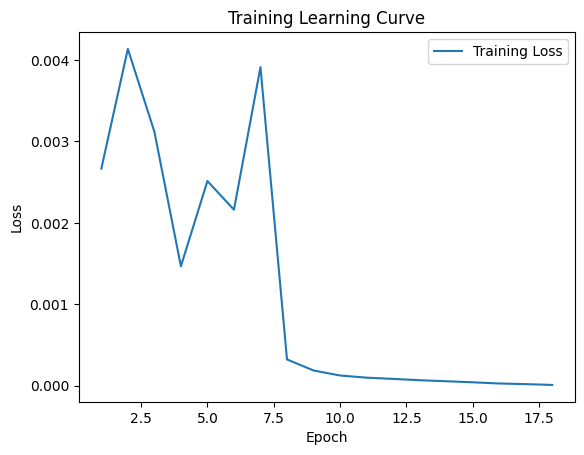


 Epoch: (19/30) Loss = 5.35726894668187e-06

 Epoch: (19/30) Loss_rmse = 0.002314577577635646

 Epoch: (19/30) R^2 = 0.9997609853744507

 Epoch: (19/30) MAE = 0.0013301409780979156
Spearman correlation coefficient: SignificanceResult(statistic=0.99888196754166, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 

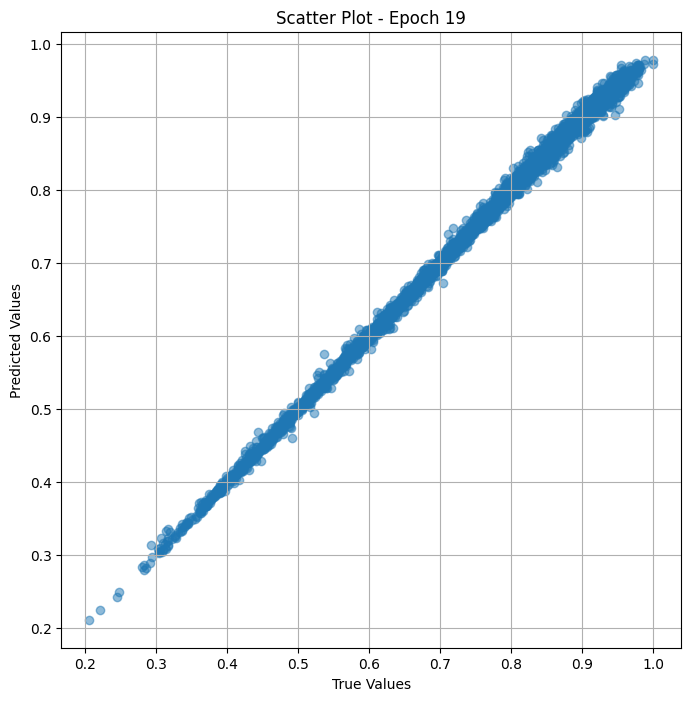

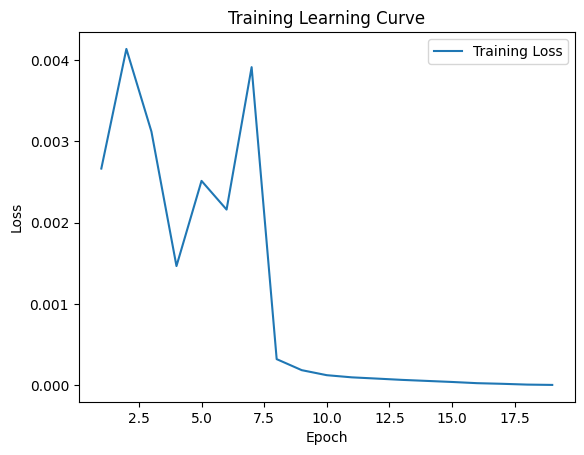


 Epoch: (20/30) Loss = 2.7826845325762406e-06

 Epoch: (20/30) Loss_rmse = 0.0016681380802765489

 Epoch: (20/30) R^2 = 0.9998758435249329

 Epoch: (20/30) MAE = 0.001082003116607666
Spearman correlation coefficient: SignificanceResult(statistic=0.9992584767529089, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

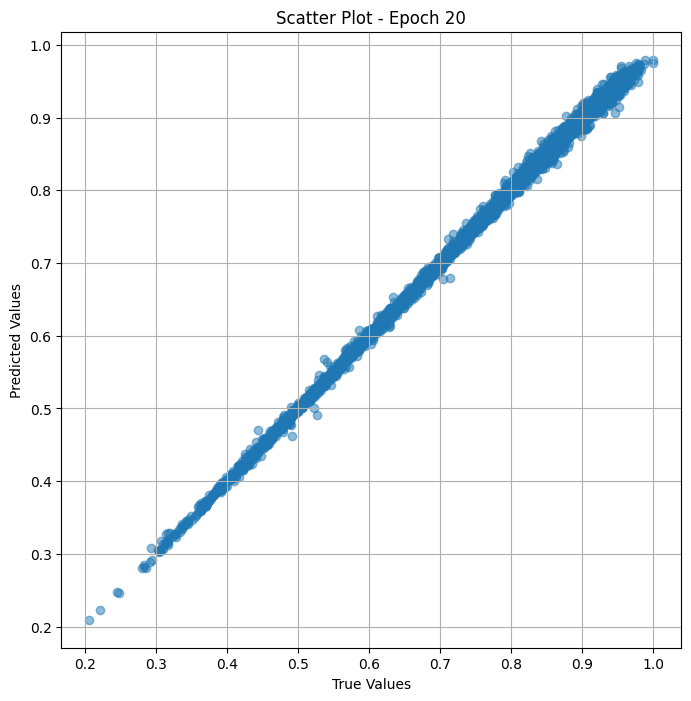

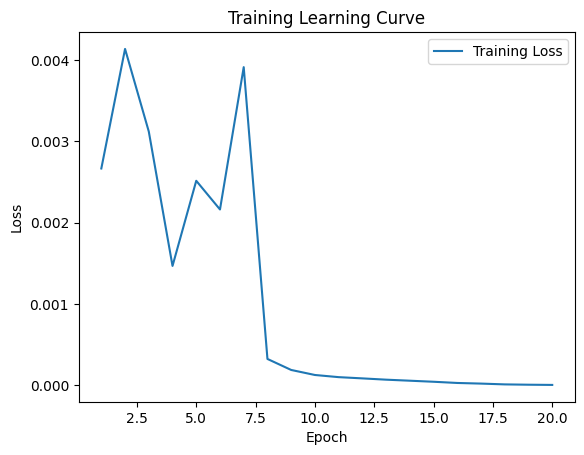


 Epoch: (21/30) Loss = 2.1587852643278893e-06

 Epoch: (21/30) Loss_rmse = 0.0014692805707454681

 Epoch: (21/30) R^2 = 0.999903678894043

 Epoch: (21/30) MAE = 0.001090817153453827
Spearman correlation coefficient: SignificanceResult(statistic=0.9994851506951243, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

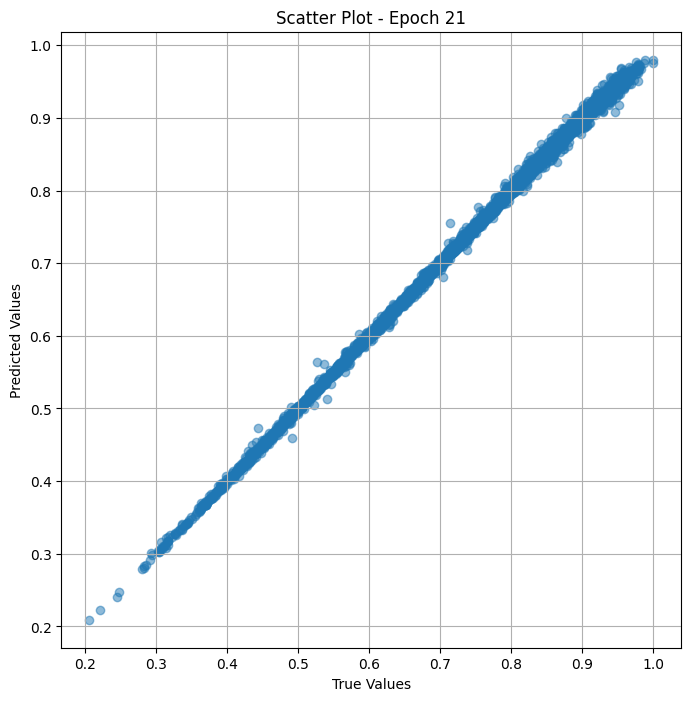

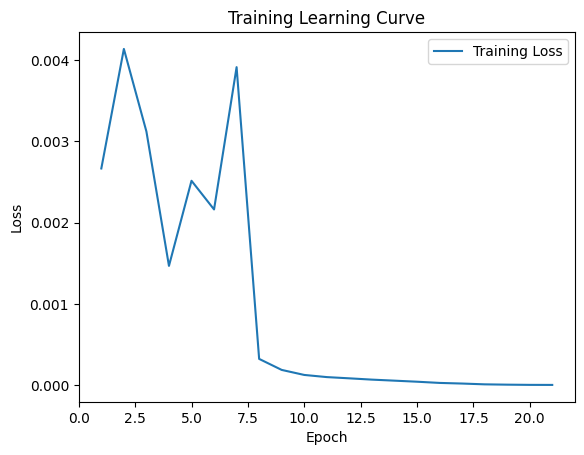


 Epoch: (22/30) Loss = 3.5334305721335113e-06

 Epoch: (22/30) Loss_rmse = 0.0018797421362251043

 Epoch: (22/30) R^2 = 0.9998423457145691

 Epoch: (22/30) MAE = 0.001405220478773117
Spearman correlation coefficient: SignificanceResult(statistic=0.9995921705608998, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

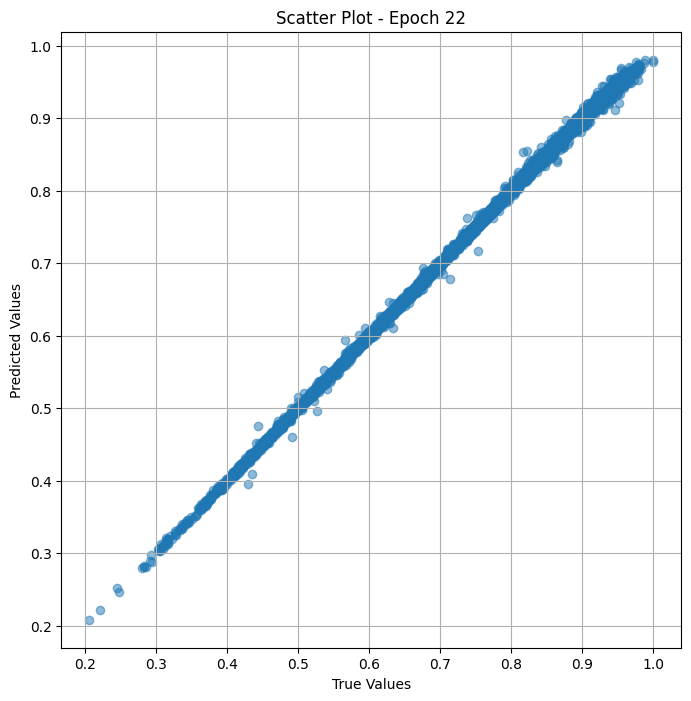

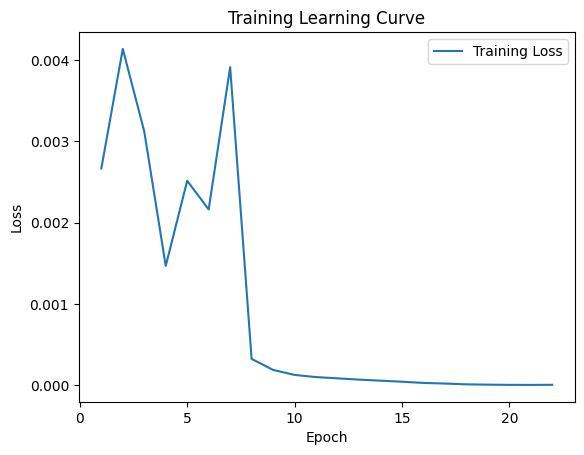


 Epoch: (23/30) Loss = 3.319672487123171e-06

 Epoch: (23/30) Loss_rmse = 0.0018219968769699335

 Epoch: (23/30) R^2 = 0.9998518824577332

 Epoch: (23/30) MAE = 0.0014852583408355713
Spearman correlation coefficient: SignificanceResult(statistic=0.999554428566951, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

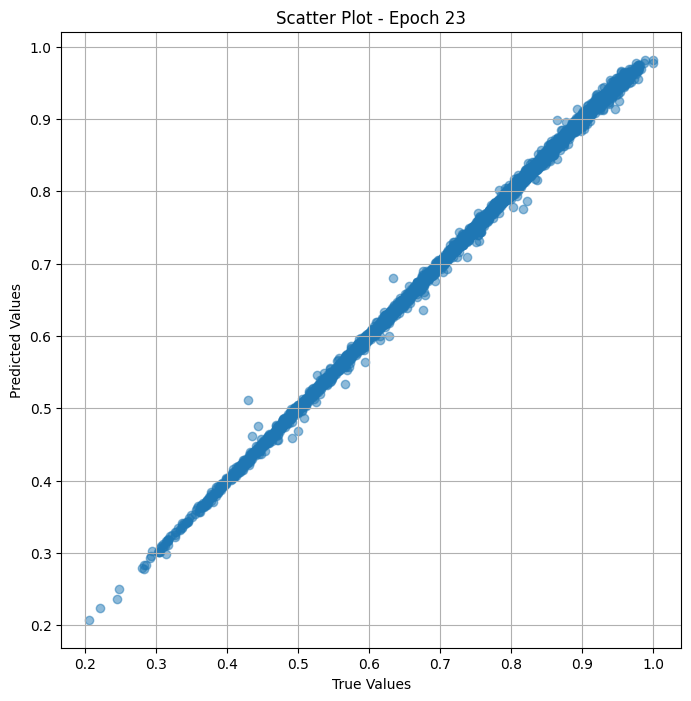

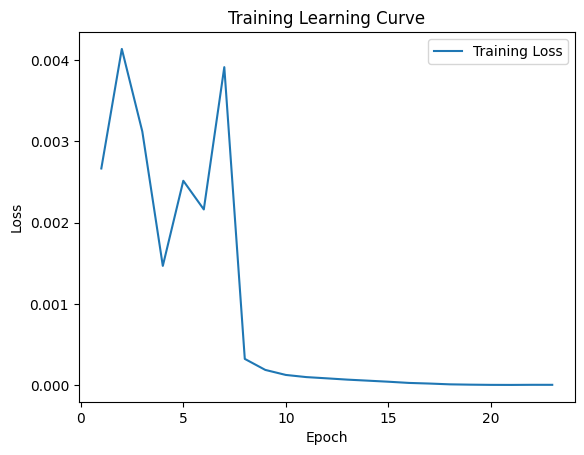

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (24/30) Loss = 2.9195896786404774e-05

 Epoch: (24/30) Loss_rmse = 0.005403322633355856

 Epoch: (24/30) R^2 = 0.9986974596977234

 Epoch: (24/30) MAE = 0.004486367106437683
Spearman correlation coefficient: SignificanceResult(statistic=0.9993676428255455, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.947

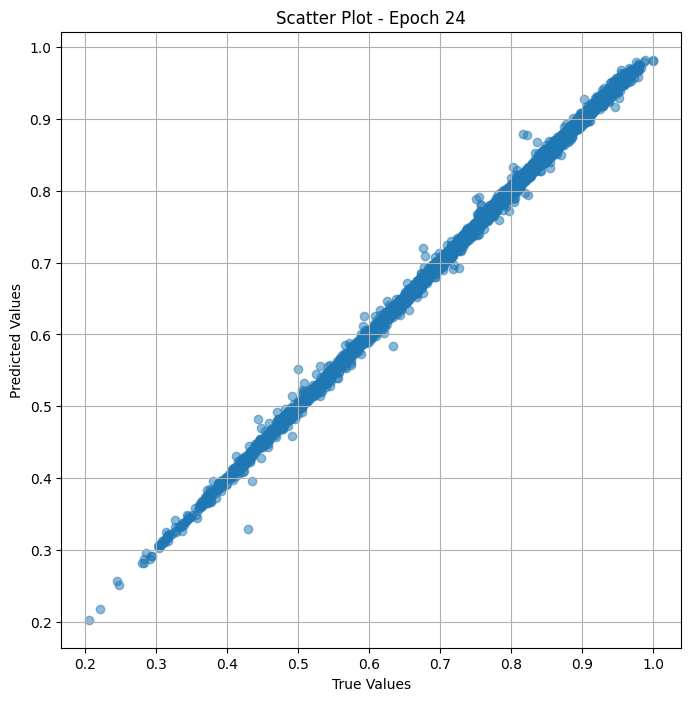

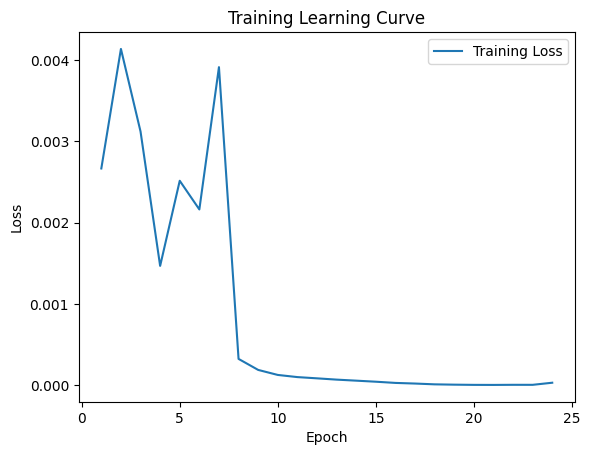


 Epoch: (25/30) Loss = 1.655221603868995e-05

 Epoch: (25/30) Loss_rmse = 0.004068441689014435

 Epoch: (25/30) R^2 = 0.9992614984512329

 Epoch: (25/30) MAE = 0.0038788802921772003
Spearman correlation coefficient: SignificanceResult(statistic=0.9982557830639429, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

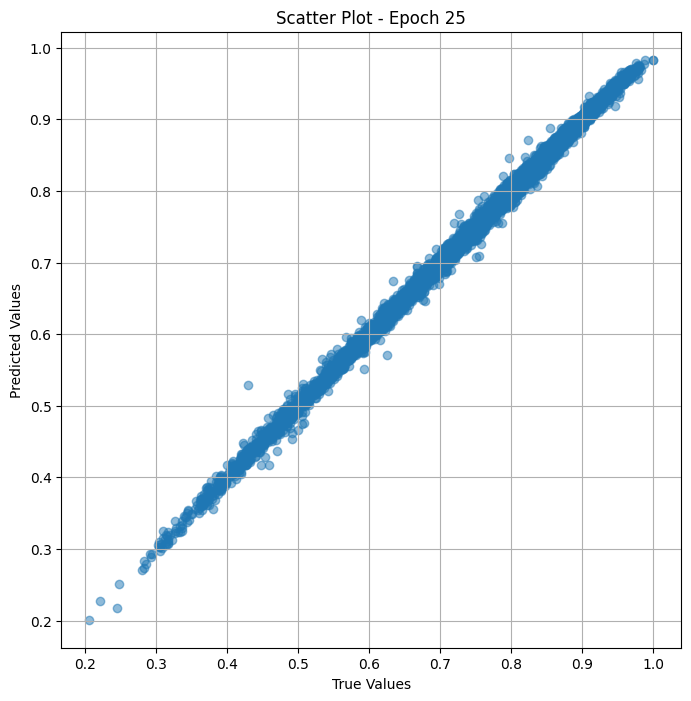

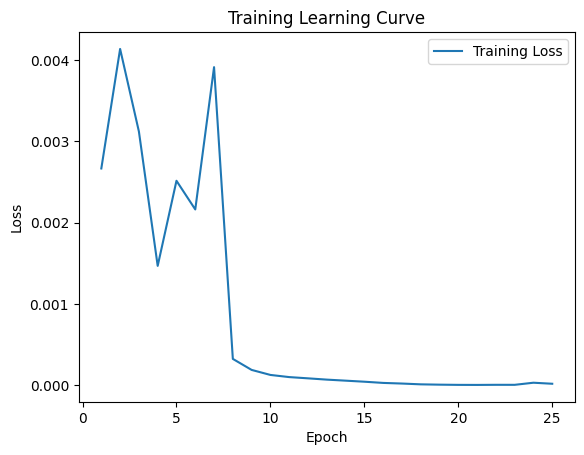


 Epoch: (26/30) Loss = 8.974589945864864e-06

 Epoch: (26/30) Loss_rmse = 0.0029957620427012444

 Epoch: (26/30) R^2 = 0.9995995759963989

 Epoch: (26/30) MAE = 0.002851232886314392
Spearman correlation coefficient: SignificanceResult(statistic=0.9986275623287688, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

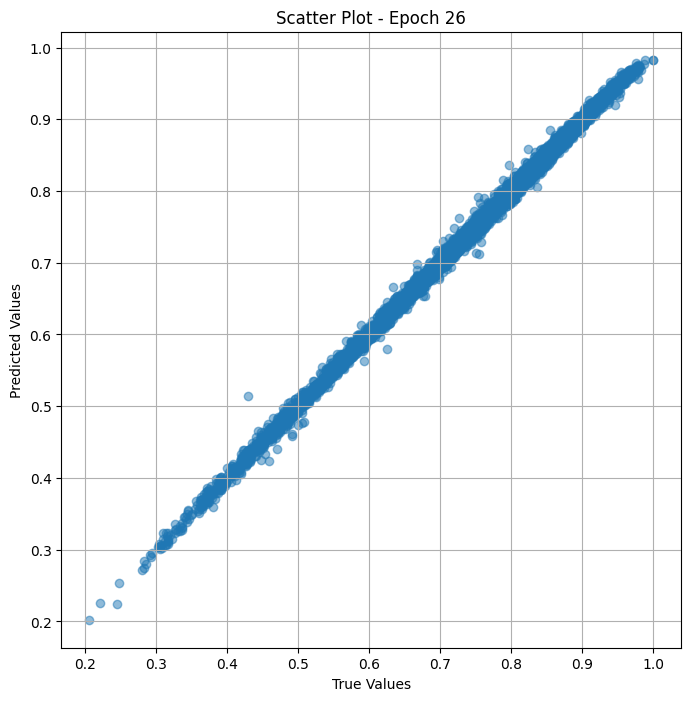

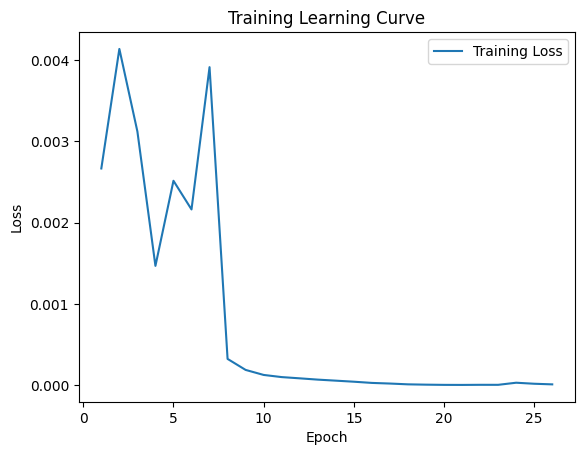

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (27/30) Loss = 5.212965334067121e-06

 Epoch: (27/30) Loss_rmse = 0.0022831920068711042

 Epoch: (27/30) R^2 = 0.9997674226760864

 Epoch: (27/30) MAE = 0.0021440833806991577
Spearman correlation coefficient: SignificanceResult(statistic=0.9989237706785525, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94

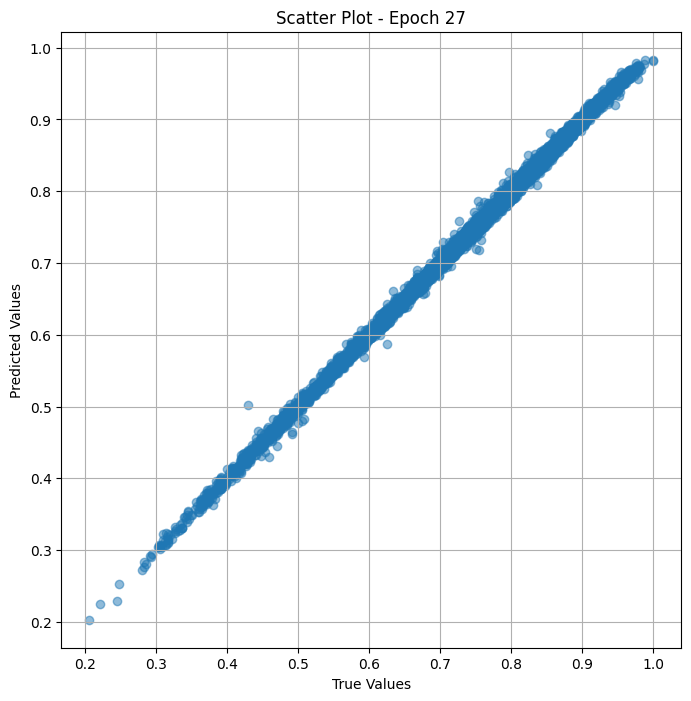

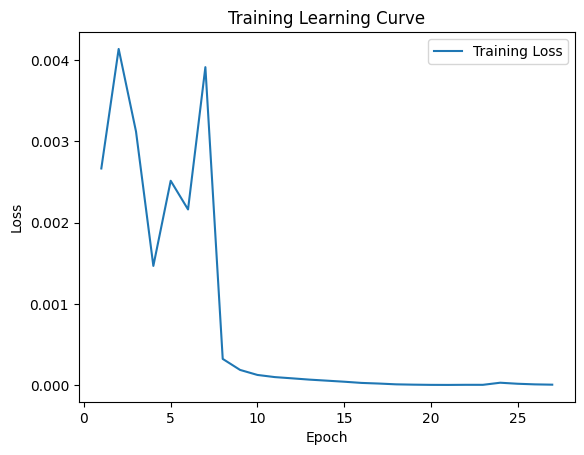


 Epoch: (28/30) Loss = 6.5522463046363555e-06

 Epoch: (28/30) Loss_rmse = 0.0025597356725484133

 Epoch: (28/30) R^2 = 0.9997076988220215

 Epoch: (28/30) MAE = 0.0021805278956890106
Spearman correlation coefficient: SignificanceResult(statistic=0.9988644048389043, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734

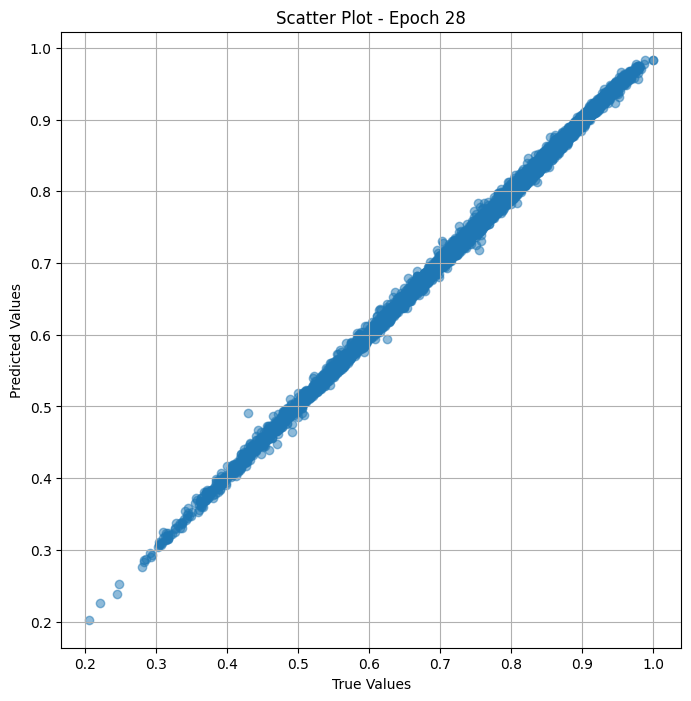

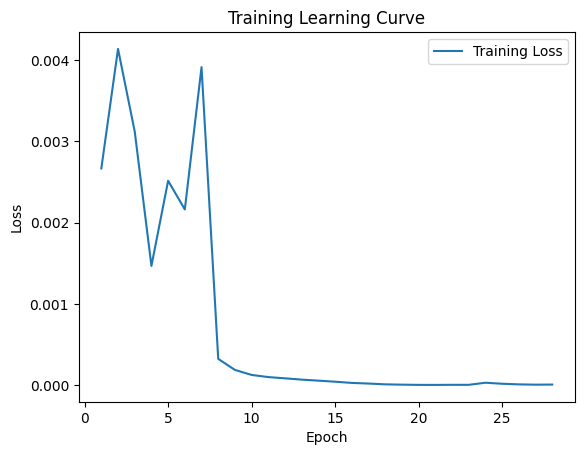


 Epoch: (29/30) Loss = 7.082144747982966e-06

 Epoch: (29/30) Loss_rmse = 0.00266123004257679

 Epoch: (29/30) R^2 = 0.9996840357780457

 Epoch: (29/30) MAE = 0.0020788200199604034
Spearman correlation coefficient: SignificanceResult(statistic=0.9989559233859429, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

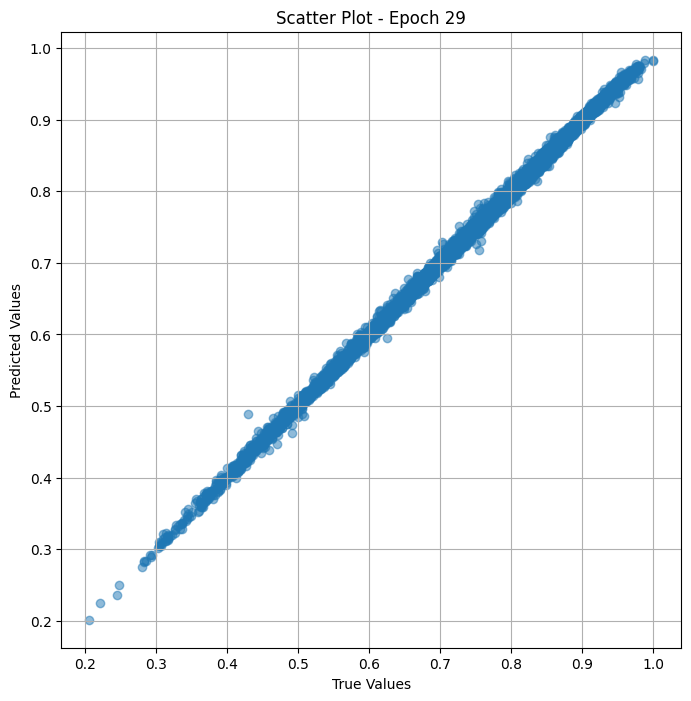

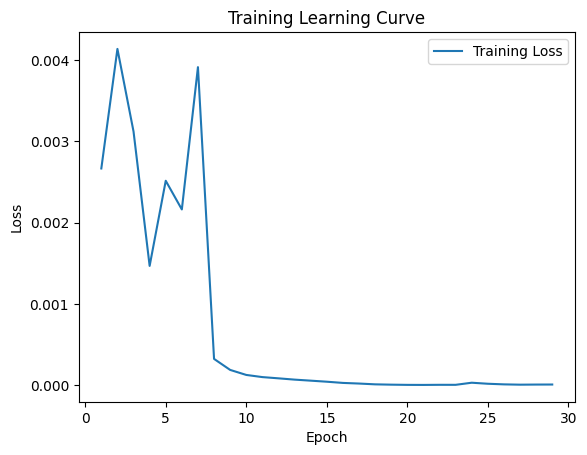

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (30/30) Loss = 7.08013067196589e-06

 Epoch: (30/30) Loss_rmse = 0.0026608514599502087

 Epoch: (30/30) R^2 = 0.9996840953826904

 Epoch: (30/30) MAE = 0.0020804889500141144
Spearman correlation coefficient: SignificanceResult(statistic=0.998998923726594, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.9473

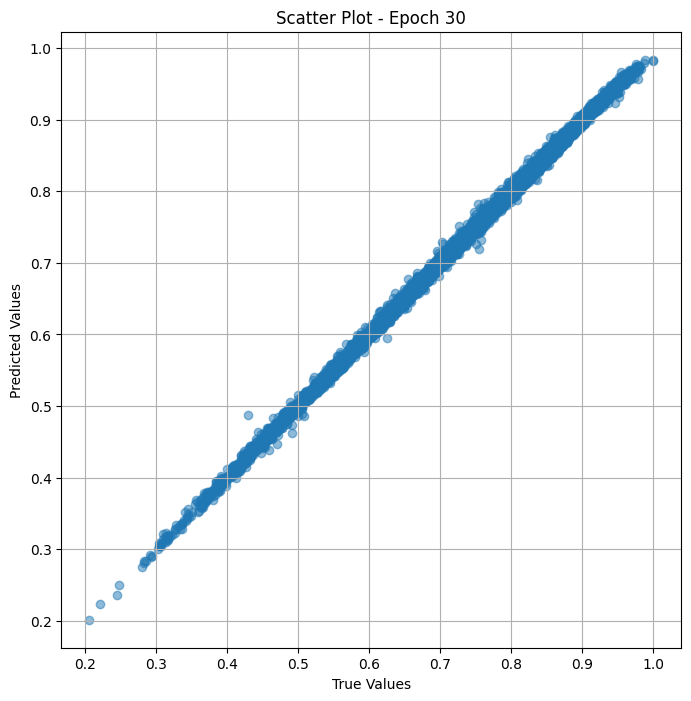

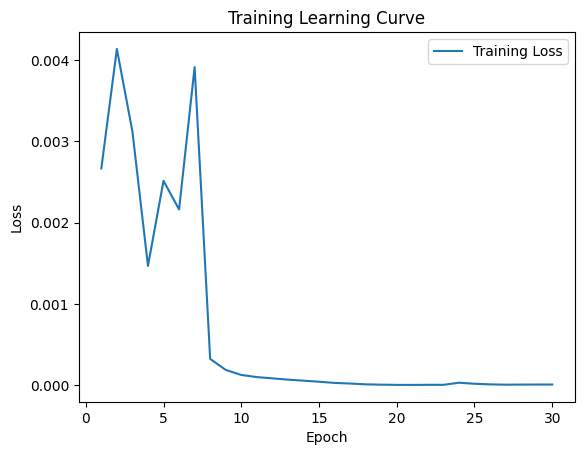

In [ ]:
# Training the model and save weights
fit(30, model_vit , train_dl)
torch.save(model_vit.state_dict(), "model_weights_1")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_vit(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_merge' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_merge['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                             Image Path  True Value  \
0      /content/merged/n02932891_37818_preprocessed.jpg    0.625000   
1     /content/merged/sun_auhghulmqnsysiyp_preproces...    0.490000   
2         /content/merged/000000064283_preprocessed.jpg    0.776786   
3       /content/merged/n04349306_5722_preprocessed.jpg    0.840909   
4      /content/merged/n00464894_13676_preprocessed.jpg    0.860000   
...                                                 ...         ...   
8995  /content/merged/46cd2e8468293902_preprocessed.jpg    0.813084   
8996      /content/merged/000000500987_preprocessed.jpg    0.677778   
8997   /content/merged/n09421951_11637_preprocessed.jpg    0.489796   
8998      /content/merged/000000225360_preprocessed.jpg    0.910112   
8999   /content/merged/n09468604_51842_preprocessed.jpg    0.559322   

      Predicted Value  
0            0.628550  
1            0.489250  
2            0.782838  
3            0.843646  
4            0.854329  
...

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+-------------------------------------------------------+------------+---------------------+
|                       Image Path                      | True Value |   Predicted Value   |
+-------------------------------------------------------+------------+---------------------+
|    /content/merged/n02932891_37818_preprocessed.jpg   |   0.625    |  0.6285496354103088 |
| /content/merged/sun_auhghulmqnsysiyp_preprocessed.jpg |    0.49    | 0.48924964666366577 |
|     /content/merged/000000064283_preprocessed.jpg     | 0.77678573 |  0.782837986946106  |
|    /content/merged/n04349306_5722_preprocessed.jpg    | 0.84090906 |  0.8436456322669983 |
|    /content/merged/n00464894_13676_preprocessed.jpg   |    0.86    |  0.8543285727500916 |
|    /content/merged/n09468604_13099_preprocessed.jpg   | 0.5555556  |  0.5592142343521118 |
|    /content/merged/n00440941_7716_preprocessed.jpg    | 0.9019608  |  0.9004608988761902 |
|     /content/merged/000000072905_preprocessed.jpg     | 0.7222222  |

## Valid

In [ ]:
class Dataset_val_merge(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_val_merge["memoscore"]
        self.images = df_val_merge["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
val_ds = Dataset_val_merge(df_val_merge, trans_transform=trans_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
class ViTMem_model_val_merge(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_sval =  ViTMem_model_val_merge( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_val_merge().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_vit_sval  = to_device(model_vit_sval  , device)

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.011708894744515419

 Epoch: (1/30) Loss_rmse = 0.10820764303207397

 Epoch: (1/30) R^2 = 0.05784201622009277

 Epoch: (1/30) MAE = 0.0904020220041275
Spearman correlation coefficient: SignificanceResult(statistic=0.30921274912349866, pvalue=4.288468337345591e-12)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821

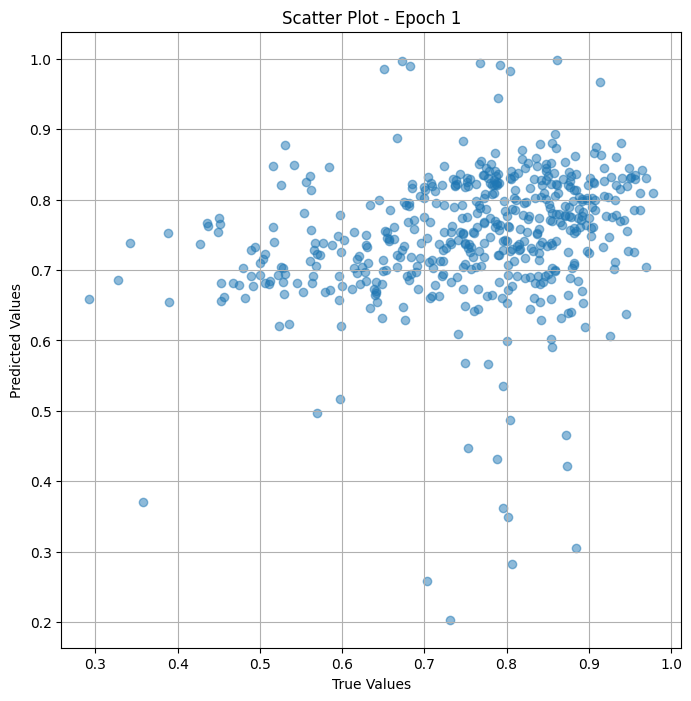

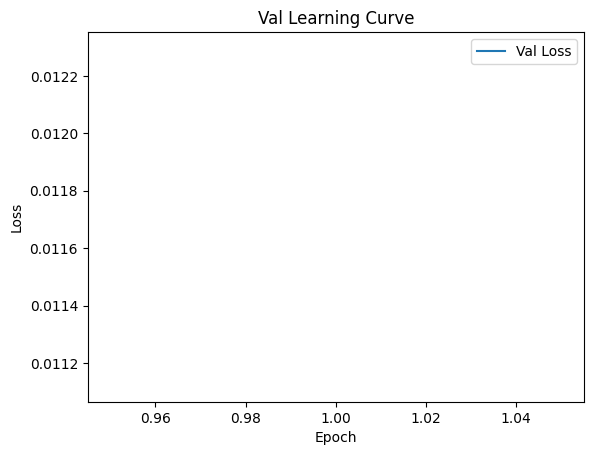


 Epoch: (2/30) Loss = 0.01046026311814785

 Epoch: (2/30) Loss_rmse = 0.10227543115615845

 Epoch: (2/30) R^2 = 0.1583133339881897

 Epoch: (2/30) MAE = 0.07976517826318741
Spearman correlation coefficient: SignificanceResult(statistic=0.6184748150719805, pvalue=5.3653367108204156e-52)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.598214

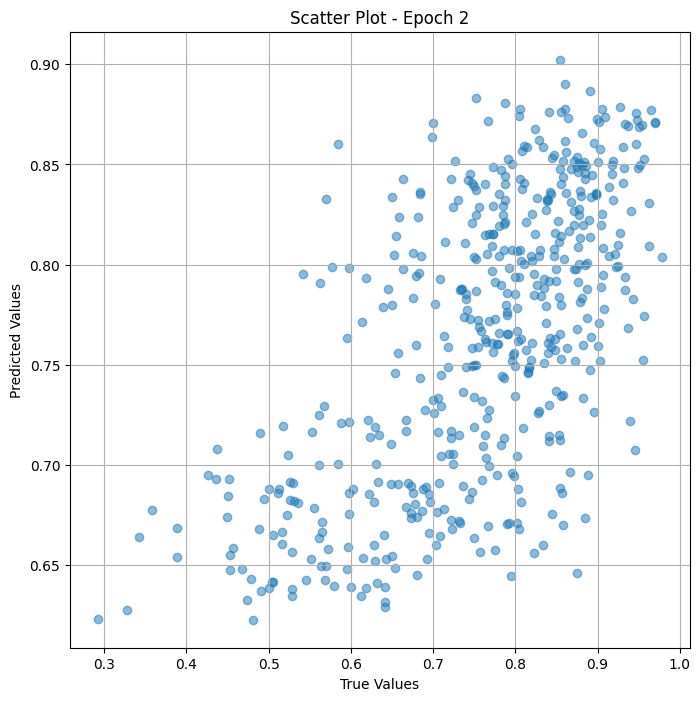

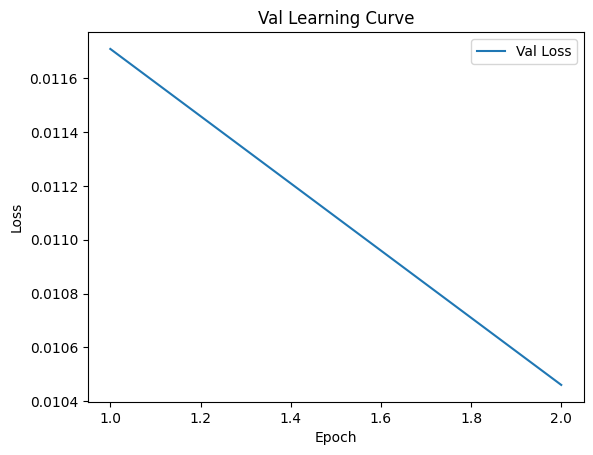


 Epoch: (3/30) Loss = 0.0079067787155509

 Epoch: (3/30) Loss_rmse = 0.08892007172107697

 Epoch: (3/30) R^2 = 0.36377984285354614

 Epoch: (3/30) MAE = 0.06869897991418839
Spearman correlation coefficient: SignificanceResult(statistic=0.7010187016893502, pvalue=3.4176826692420567e-72)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.598214

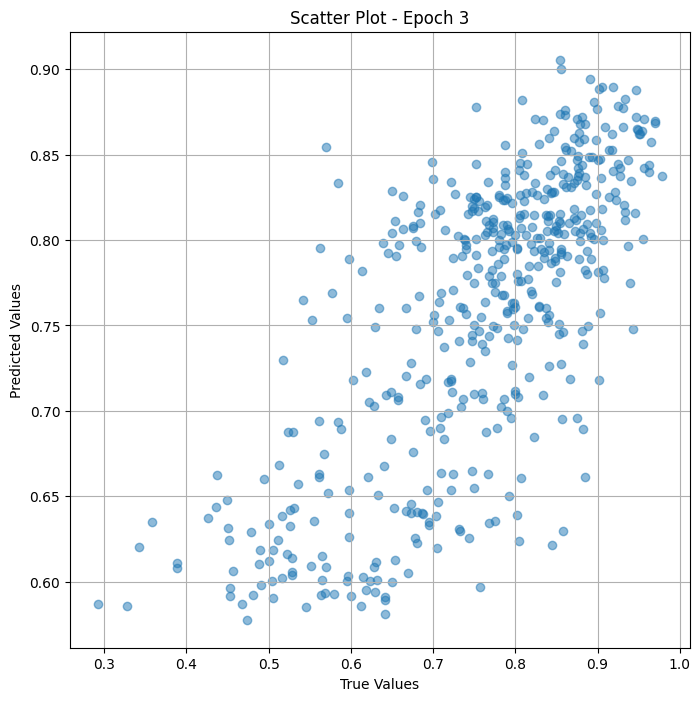

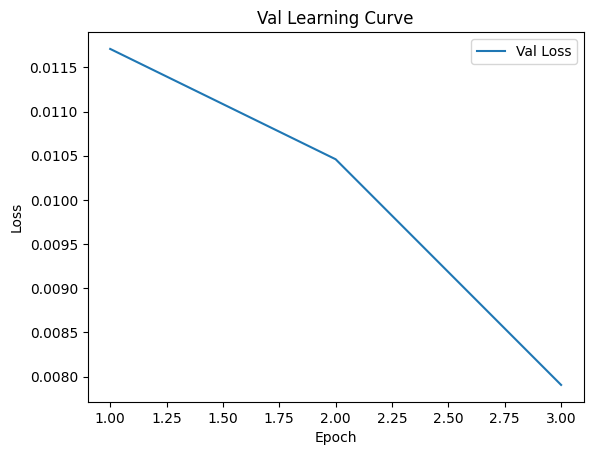


 Epoch: (4/30) Loss = 0.005280526354908943

 Epoch: (4/30) Loss_rmse = 0.07266723364591599

 Epoch: (4/30) R^2 = 0.5751016139984131

 Epoch: (4/30) MAE = 0.05736036226153374
Spearman correlation coefficient: SignificanceResult(statistic=0.7379640023591322, pvalue=1.1251875337336994e-83)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821

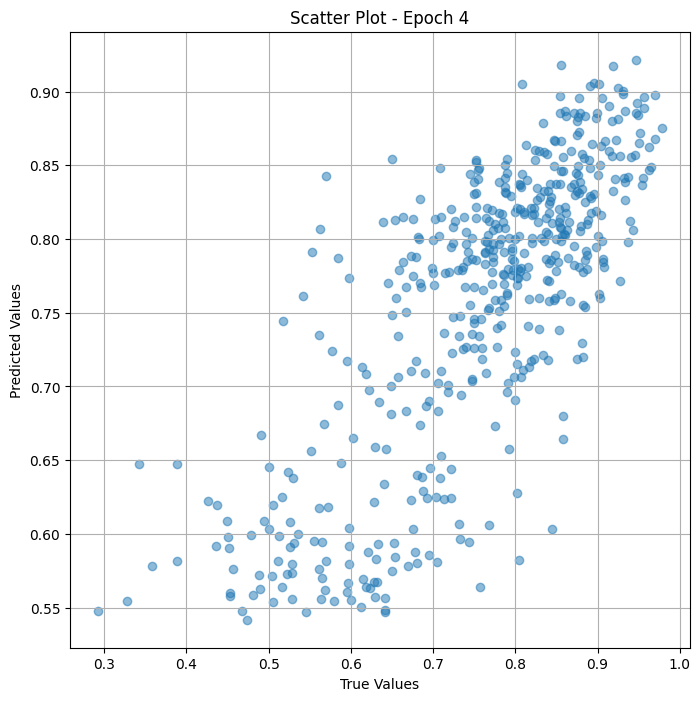

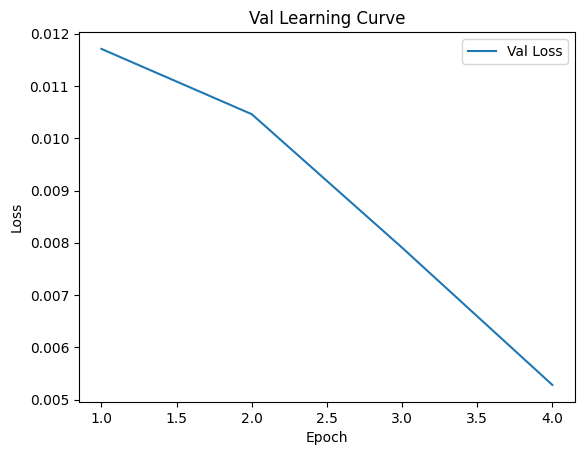


 Epoch: (5/30) Loss = 0.006394948810338974

 Epoch: (5/30) Loss_rmse = 0.0799684226512909

 Epoch: (5/30) R^2 = 0.48542946577072144

 Epoch: (5/30) MAE = 0.0659865289926529
Spearman correlation coefficient: SignificanceResult(statistic=0.7358249325476758, pvalue=5.86845183014734e-83)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427

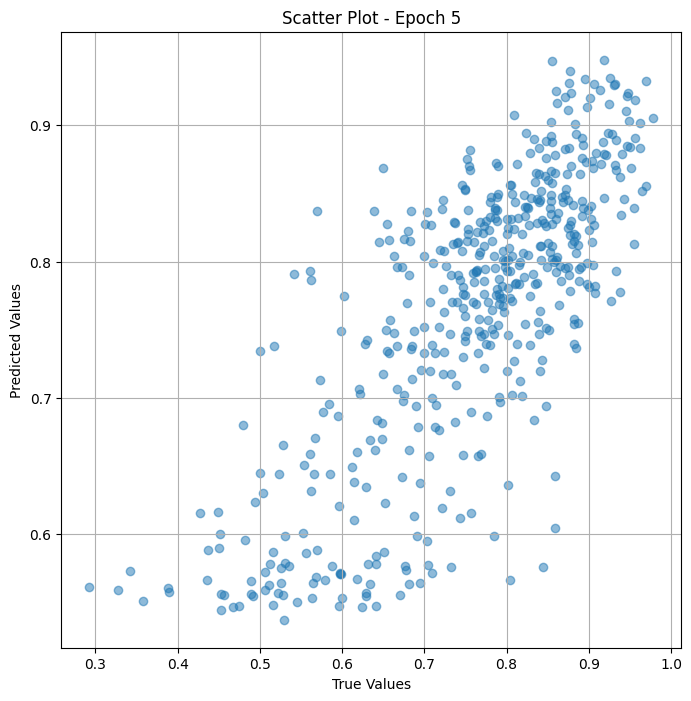

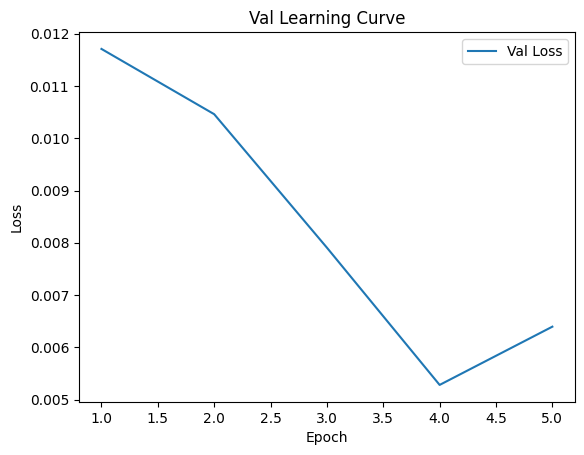


 Epoch: (6/30) Loss = 0.003538693068549037

 Epoch: (6/30) Loss_rmse = 0.05948691442608833

 Epoch: (6/30) R^2 = 0.7152584791183472

 Epoch: (6/30) MAE = 0.049643829464912415
Spearman correlation coefficient: SignificanceResult(statistic=0.7718595267002206, pvalue=4.558349318445271e-96)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821

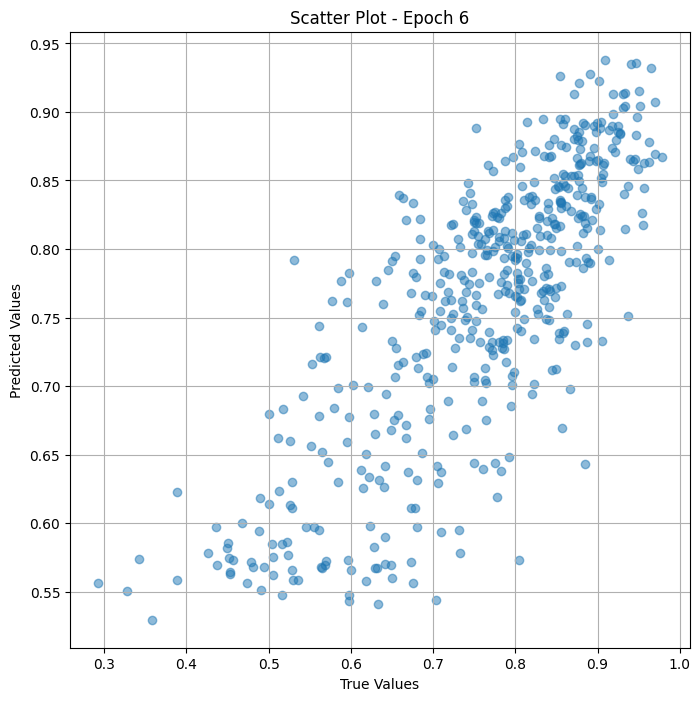

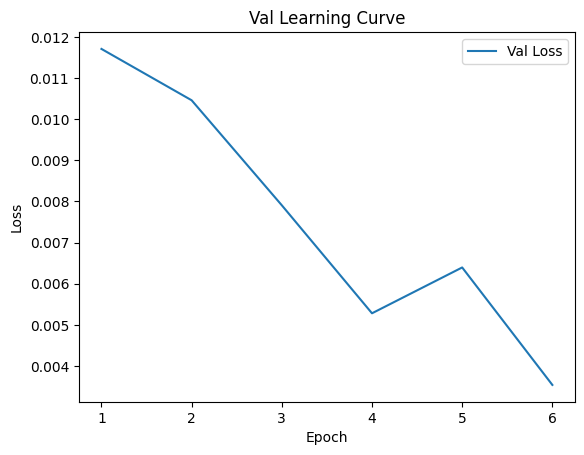


 Epoch: (7/30) Loss = 0.002072248375043273

 Epoch: (7/30) Loss_rmse = 0.04552195593714714

 Epoch: (7/30) R^2 = 0.8332562446594238

 Epoch: (7/30) MAE = 0.03796987980604172
Spearman correlation coefficient: SignificanceResult(statistic=0.8330564438729231, pvalue=5.421264508260562e-125)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821

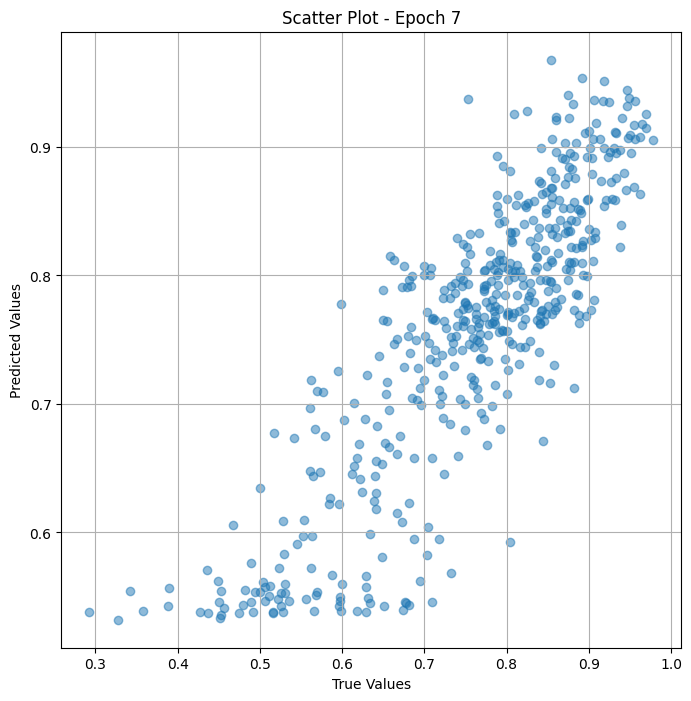

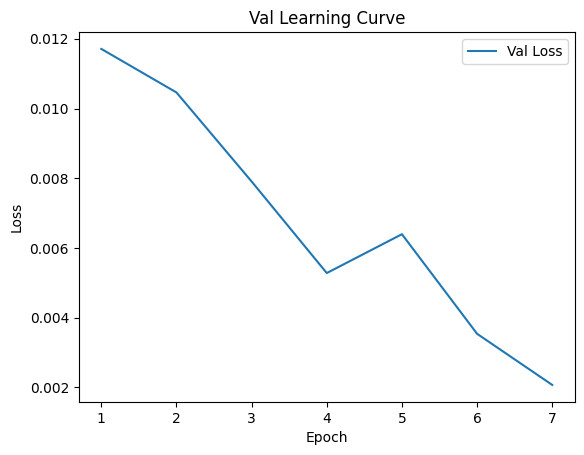


 Epoch: (8/30) Loss = 0.0009623112273402512

 Epoch: (8/30) Loss_rmse = 0.03102114237844944

 Epoch: (8/30) R^2 = 0.9225674867630005

 Epoch: (8/30) MAE = 0.02764168754220009
Spearman correlation coefficient: SignificanceResult(statistic=0.9043623335963964, pvalue=6.853770594834641e-179)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982

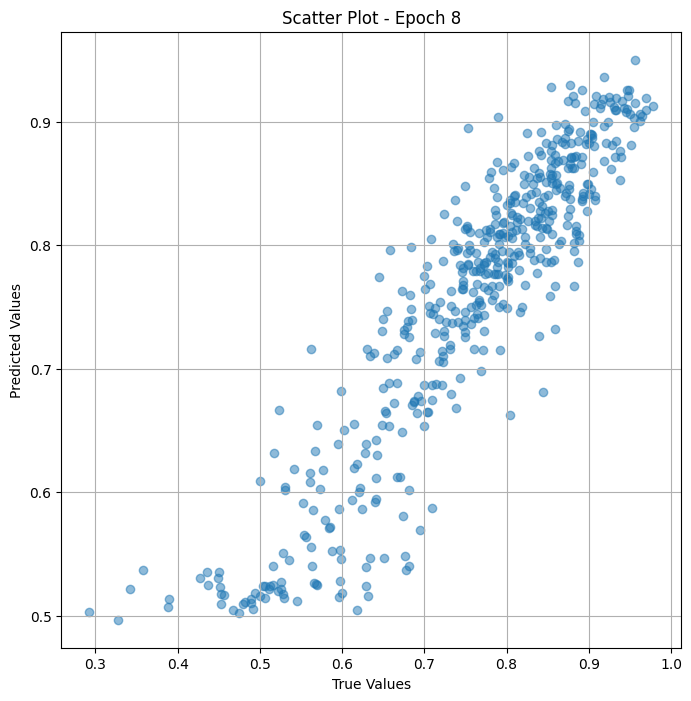

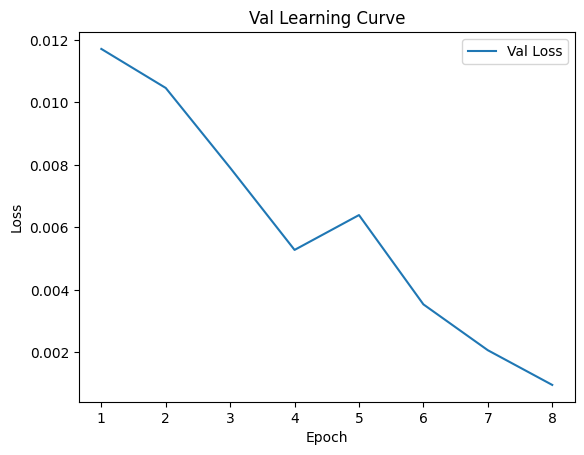


 Epoch: (9/30) Loss = 0.0009149637189693749

 Epoch: (9/30) Loss_rmse = 0.03024836629629135

 Epoch: (9/30) R^2 = 0.9263772964477539

 Epoch: (9/30) MAE = 0.025046056136488914
Spearman correlation coefficient: SignificanceResult(statistic=0.9346441662304901, pvalue=8.746739210090925e-217)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.598

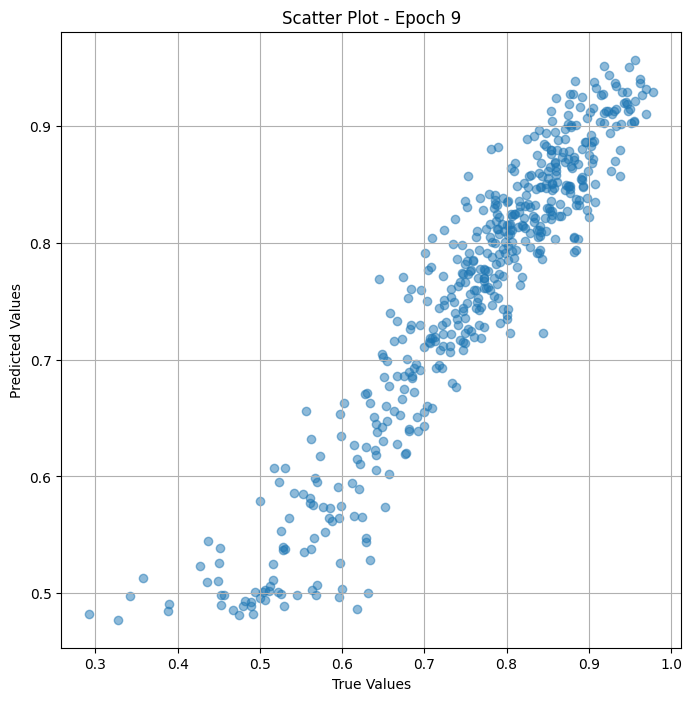

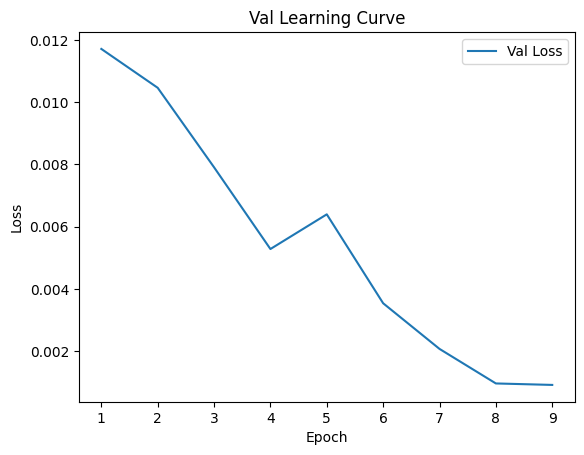


 Epoch: (10/30) Loss = 0.00037839883589185774

 Epoch: (10/30) Loss_rmse = 0.019452476873993874

 Epoch: (10/30) R^2 = 0.9695520997047424

 Epoch: (10/30) MAE = 0.014854803681373596
Spearman correlation coefficient: SignificanceResult(statistic=0.9408148457938761, pvalue=9.450046771197589e-227)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773,

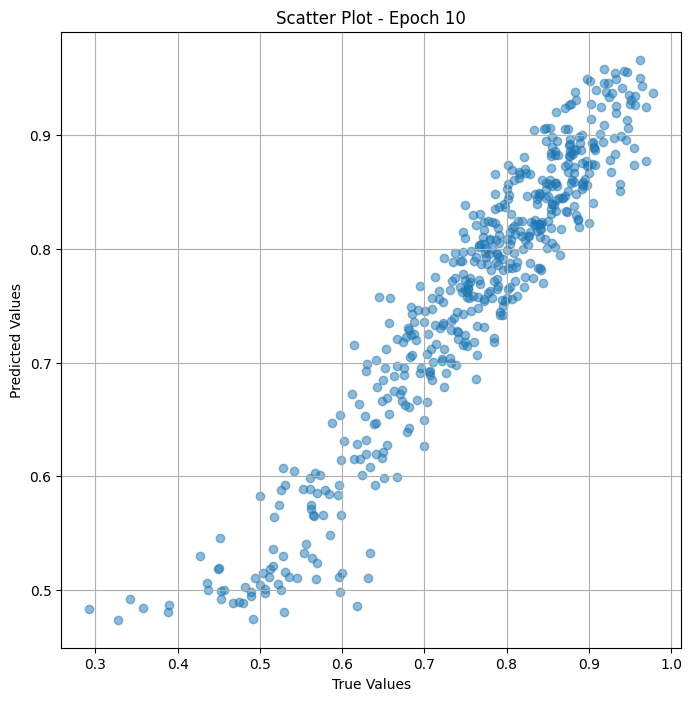

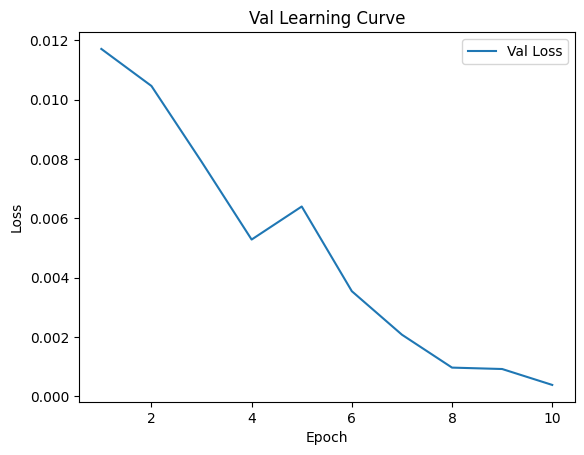


 Epoch: (11/30) Loss = 0.004153871908783913

 Epoch: (11/30) Loss_rmse = 0.06445053964853287

 Epoch: (11/30) R^2 = 0.6657580137252808

 Epoch: (11/30) MAE = 0.059861209243535995
Spearman correlation coefficient: SignificanceResult(statistic=0.8824462403958722, pvalue=1.151543147362356e-158)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.

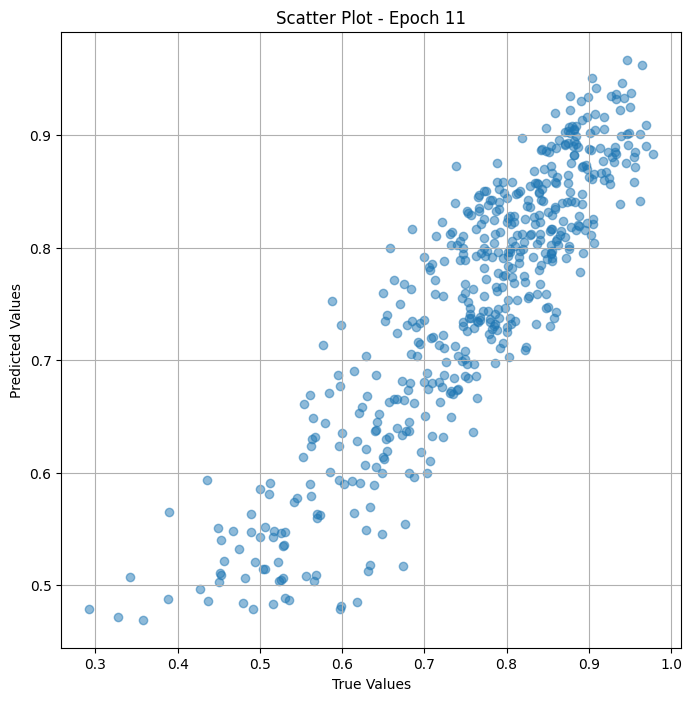

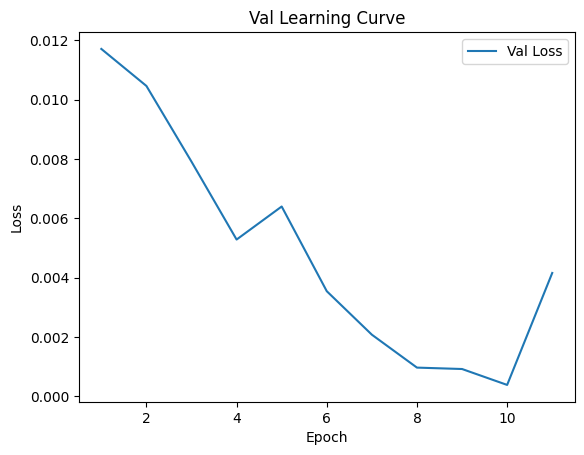


 Epoch: (12/30) Loss = 0.0025806406047195196

 Epoch: (12/30) Loss_rmse = 0.050800006836652756

 Epoch: (12/30) R^2 = 0.7923483848571777

 Epoch: (12/30) MAE = 0.04197501391172409
Spearman correlation coefficient: SignificanceResult(statistic=0.869711509594362, pvalue=1.093979198116159e-148)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.

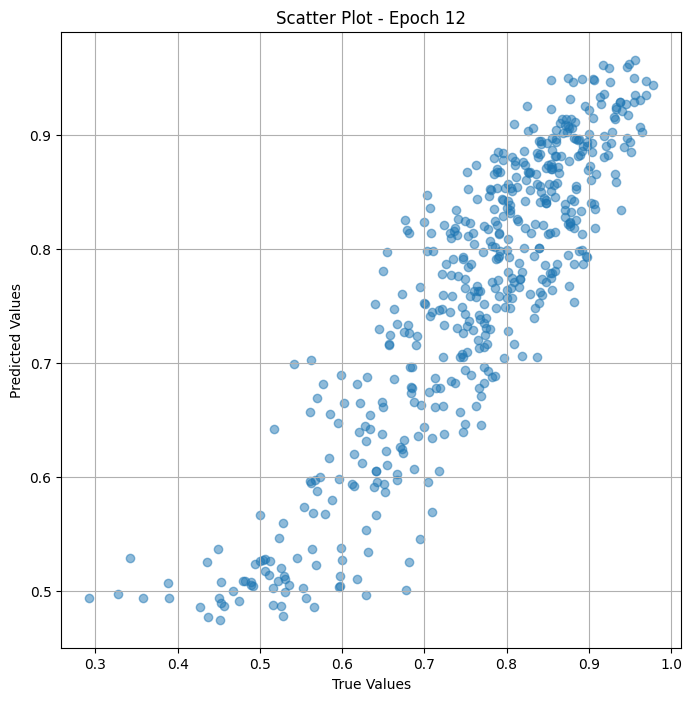

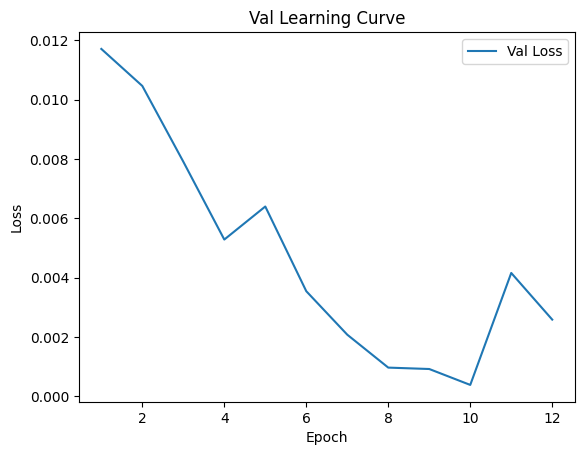

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (13/30) Loss = 0.00048547398182563484

 Epoch: (13/30) Loss_rmse = 0.02203347347676754

 Epoch: (13/30) R^2 = 0.9609362483024597

 Epoch: (13/30) MAE = 0.01835058443248272
Spearman correlation coefficient: SignificanceResult(statistic=0.9485632839791955, pvalue=6.620697998211993e-241)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.792079

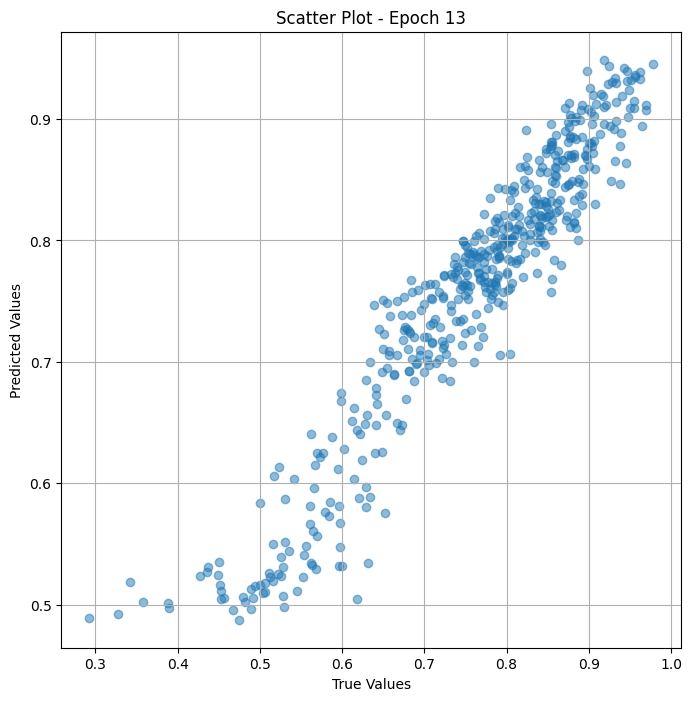

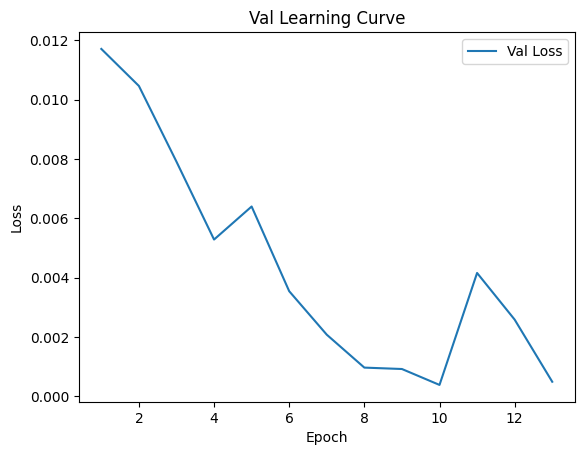


 Epoch: (14/30) Loss = 0.0004331214295234531

 Epoch: (14/30) Loss_rmse = 0.020811568945646286

 Epoch: (14/30) R^2 = 0.9651488065719604

 Epoch: (14/30) MAE = 0.016672644764184952
Spearman correlation coefficient: SignificanceResult(statistic=0.9732876692531875, pvalue=1.2833046004151392e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773,

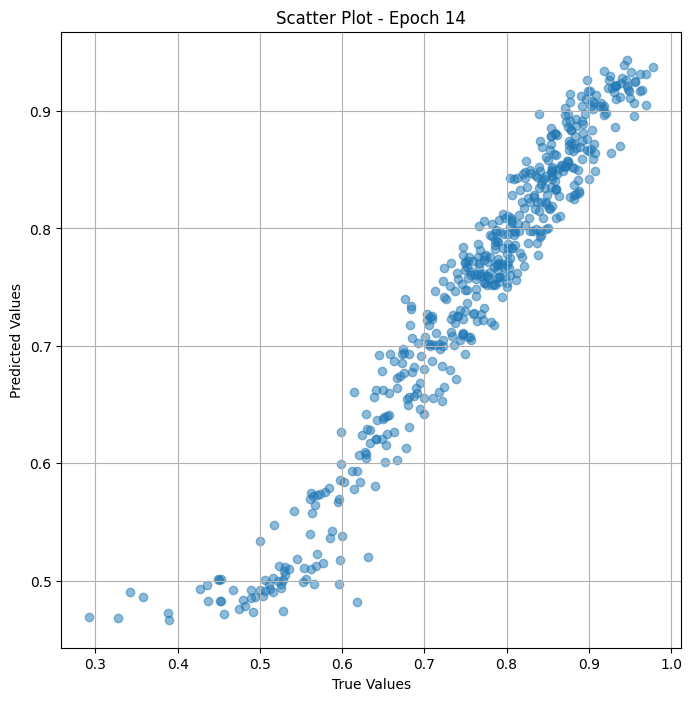

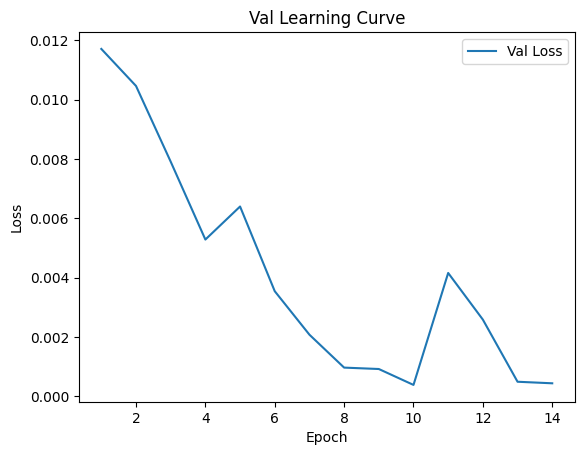


 Epoch: (15/30) Loss = 0.0003259012009948492

 Epoch: (15/30) Loss_rmse = 0.018052734434604645

 Epoch: (15/30) R^2 = 0.9737762808799744

 Epoch: (15/30) MAE = 0.014648071490228176
Spearman correlation coefficient: SignificanceResult(statistic=0.9766749592982955, pvalue=1.62e-321)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0

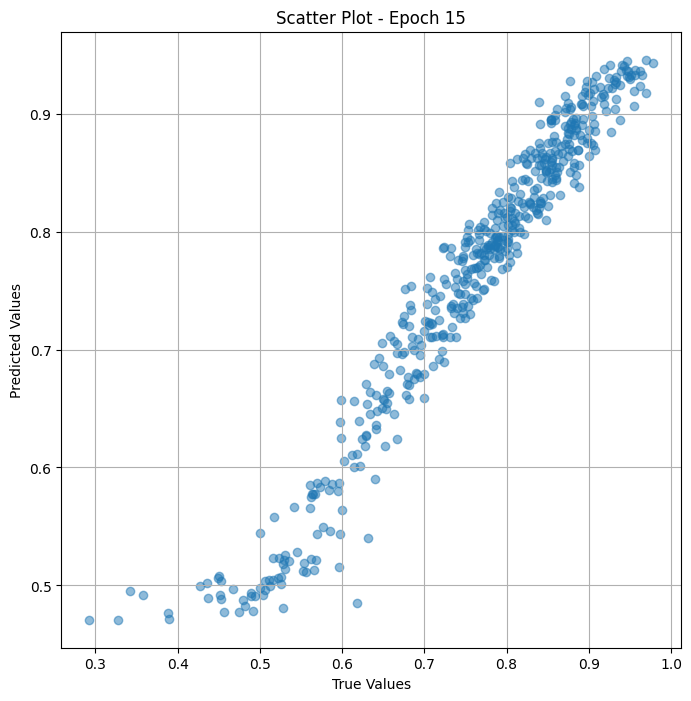

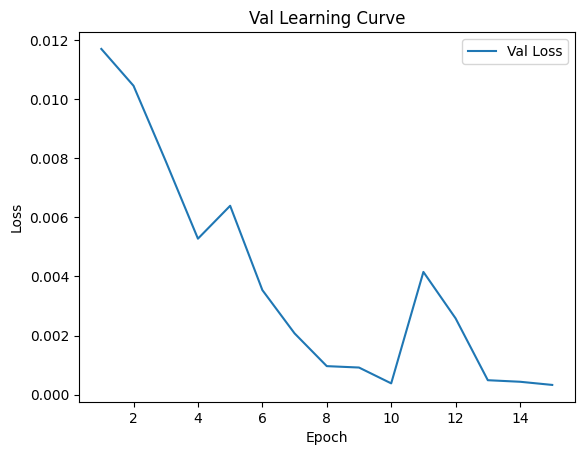


 Epoch: (16/30) Loss = 0.0001947425480466336

 Epoch: (16/30) Loss_rmse = 0.013955018483102322

 Epoch: (16/30) R^2 = 0.9843299984931946

 Epoch: (16/30) MAE = 0.011873281560838223
Spearman correlation coefficient: SignificanceResult(statistic=0.9780400425033594, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

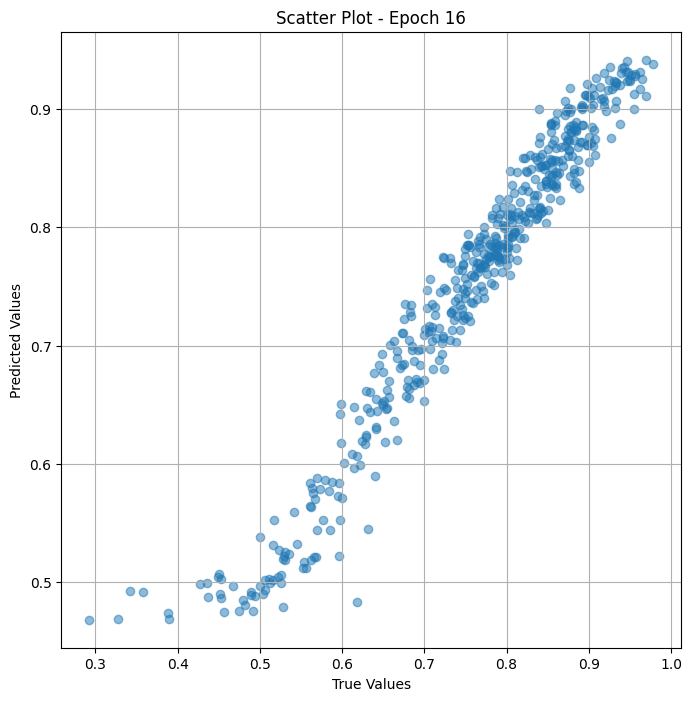

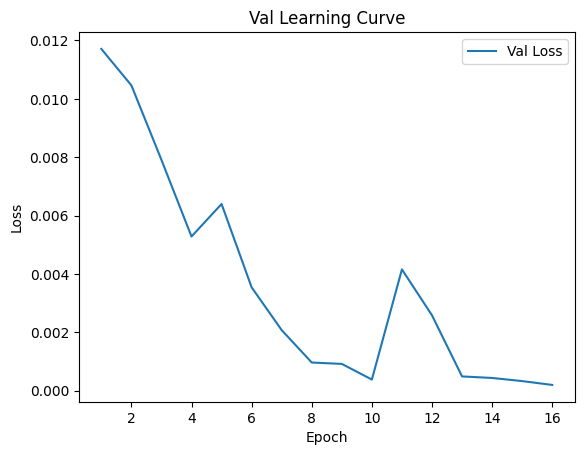


 Epoch: (17/30) Loss = 0.0002027528826147318

 Epoch: (17/30) Loss_rmse = 0.014239132404327393

 Epoch: (17/30) R^2 = 0.9836854338645935

 Epoch: (17/30) MAE = 0.011790263466536999
Spearman correlation coefficient: SignificanceResult(statistic=0.9831071428181384, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

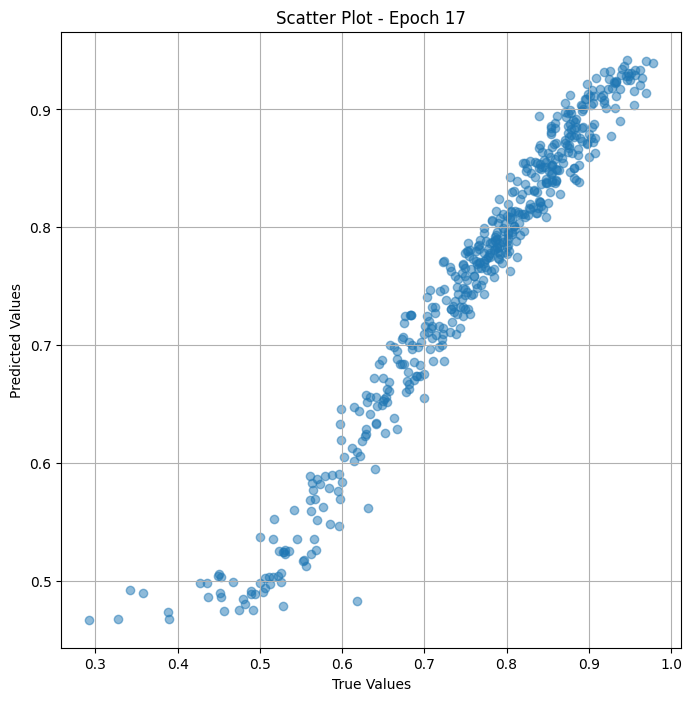

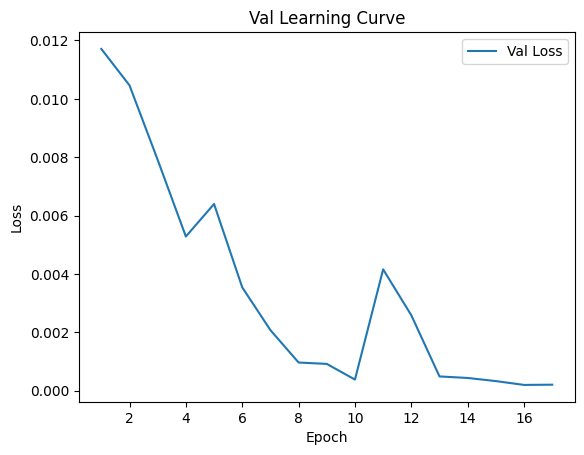


 Epoch: (18/30) Loss = 0.0001539537770440802

 Epoch: (18/30) Loss_rmse = 0.012407811358571053

 Epoch: (18/30) R^2 = 0.9876120686531067

 Epoch: (18/30) MAE = 0.010437197051942348
Spearman correlation coefficient: SignificanceResult(statistic=0.9838772773952967, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

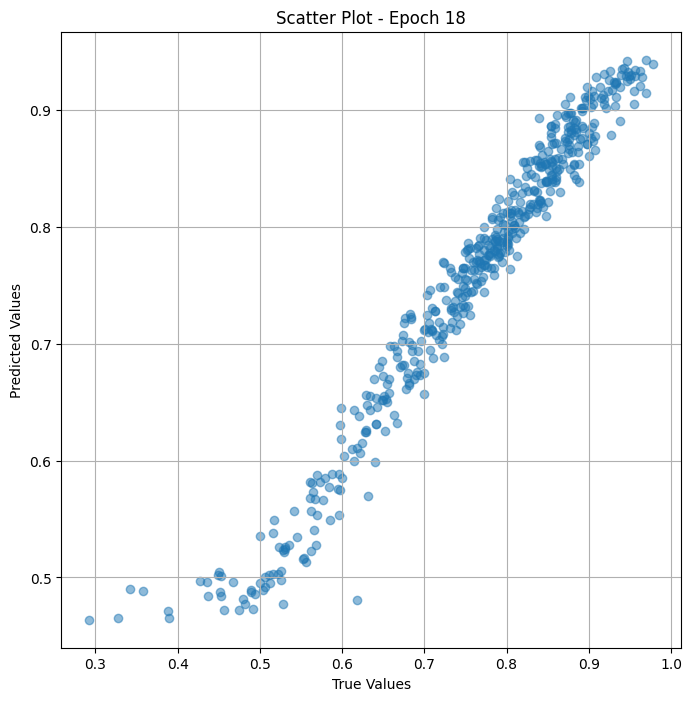

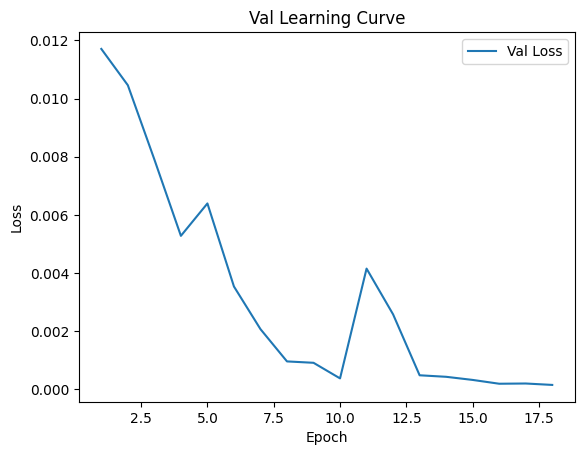


 Epoch: (19/30) Loss = 0.00014016078785061836

 Epoch: (19/30) Loss_rmse = 0.011838952079415321

 Epoch: (19/30) R^2 = 0.9887219667434692

 Epoch: (19/30) MAE = 0.009812450967729092
Spearman correlation coefficient: SignificanceResult(statistic=0.9860570376564093, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

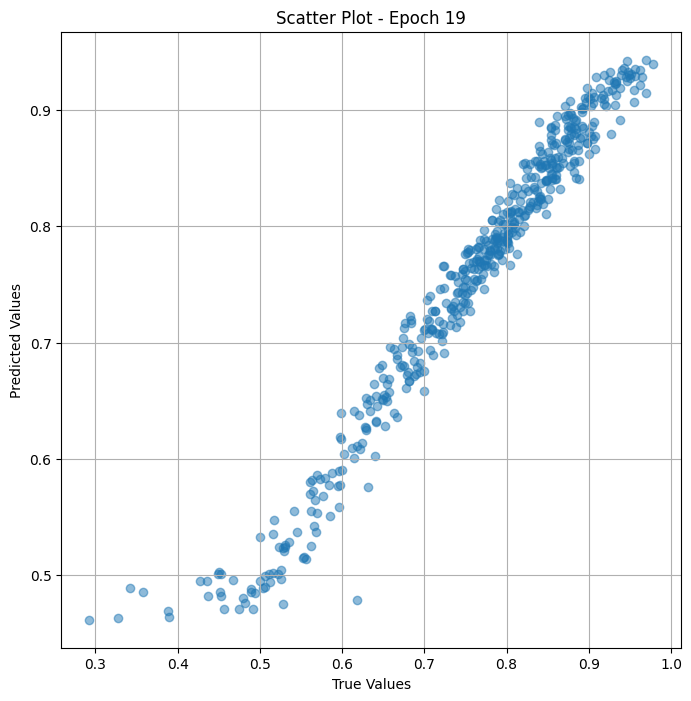

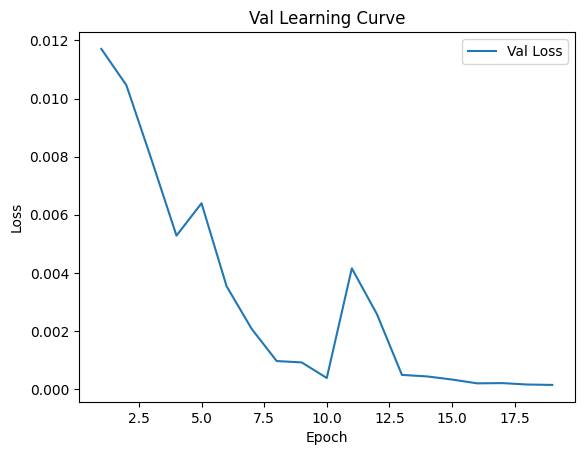


 Epoch: (20/30) Loss = 0.00012409281043801457

 Epoch: (20/30) Loss_rmse = 0.011139695532619953

 Epoch: (20/30) R^2 = 0.9900148510932922

 Epoch: (20/30) MAE = 0.009168306365609169
Spearman correlation coefficient: SignificanceResult(statistic=0.9873284785733313, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

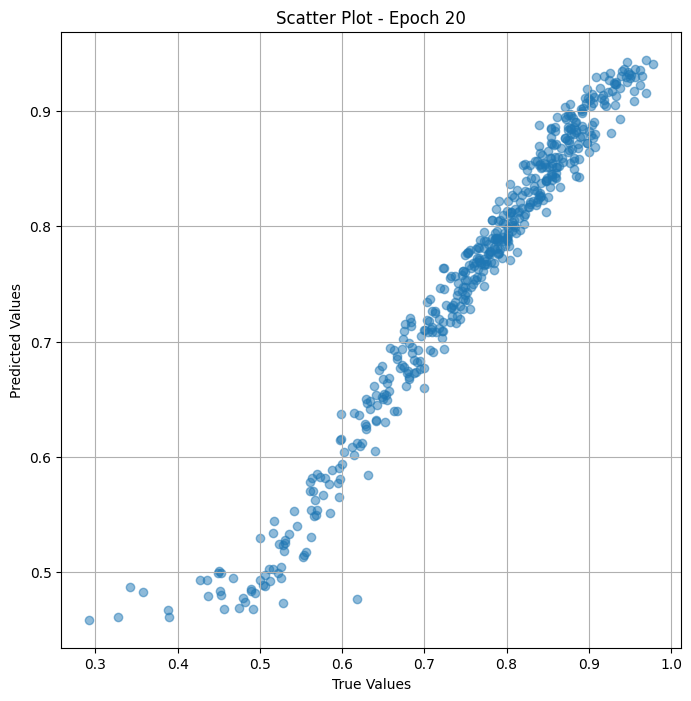

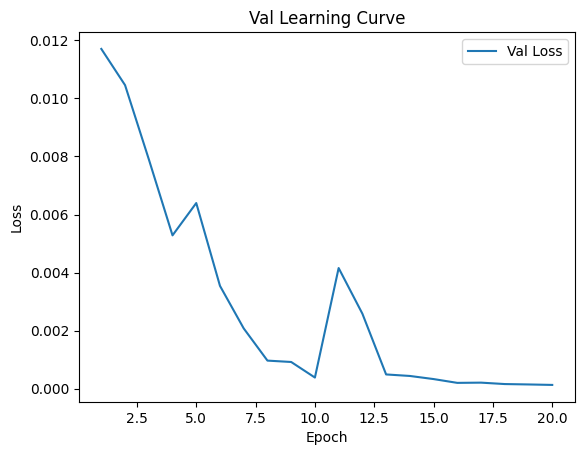


 Epoch: (21/30) Loss = 0.00011008462024619803

 Epoch: (21/30) Loss_rmse = 0.010492121800780296

 Epoch: (21/30) R^2 = 0.9911420345306396

 Epoch: (21/30) MAE = 0.008624458685517311
Spearman correlation coefficient: SignificanceResult(statistic=0.9884662377996495, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

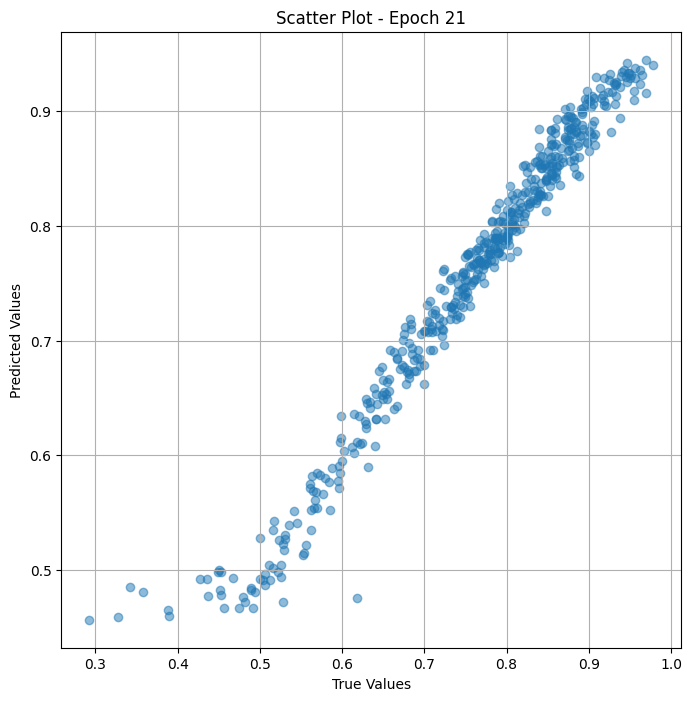

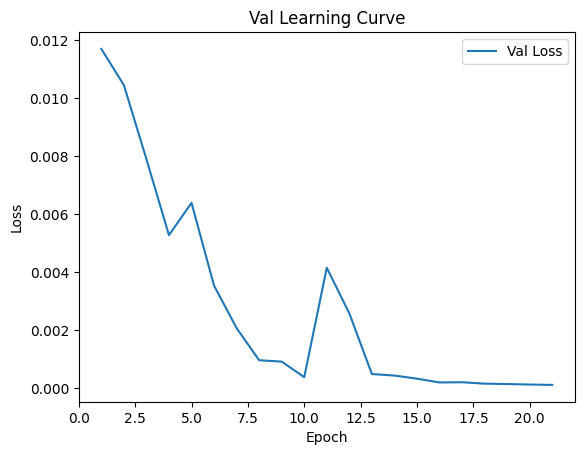


 Epoch: (22/30) Loss = 0.00010109823051607236

 Epoch: (22/30) Loss_rmse = 0.010054761543869972

 Epoch: (22/30) R^2 = 0.9918650984764099

 Epoch: (22/30) MAE = 0.008166340179741383
Spearman correlation coefficient: SignificanceResult(statistic=0.9897442976963823, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

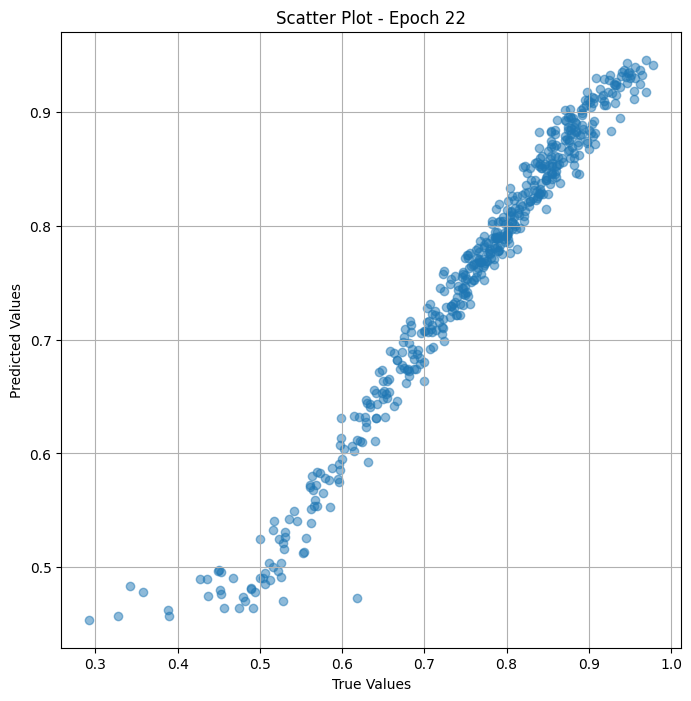

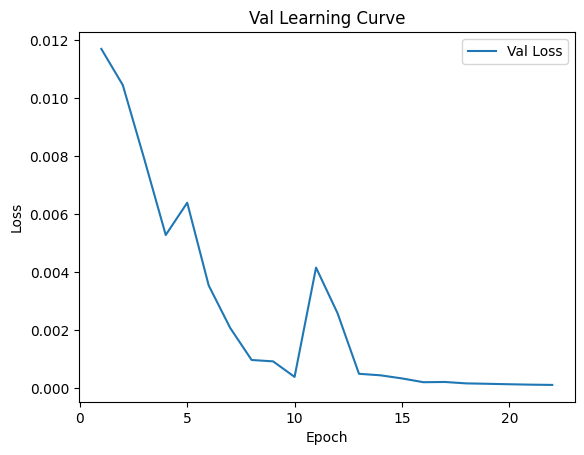


 Epoch: (23/30) Loss = 9.172780846711248e-05

 Epoch: (23/30) Loss_rmse = 0.009577463380992413

 Epoch: (23/30) R^2 = 0.9926190972328186

 Epoch: (23/30) MAE = 0.0076774656772613525
Spearman correlation coefficient: SignificanceResult(statistic=0.9907283012769332, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

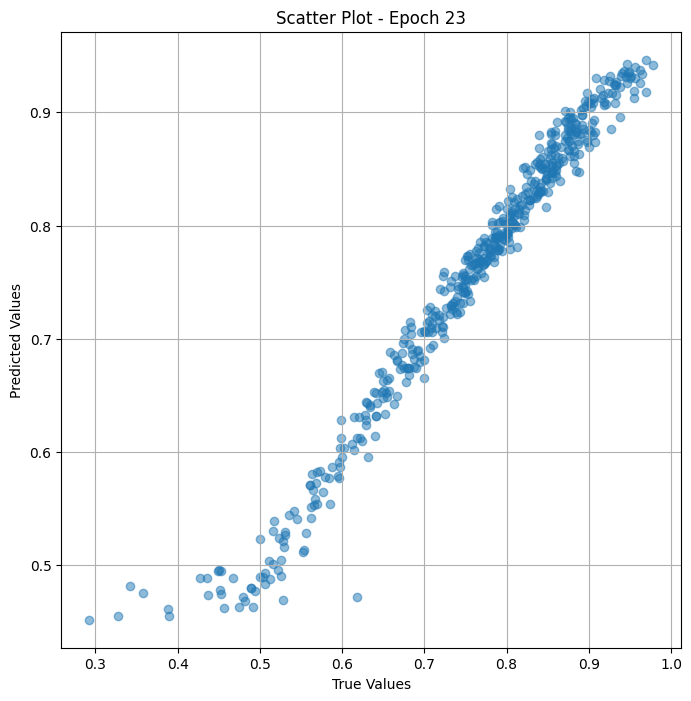

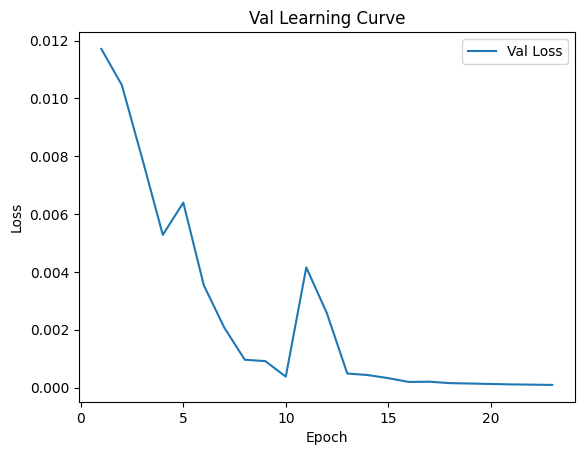


 Epoch: (24/30) Loss = 8.117467950796708e-05

 Epoch: (24/30) Loss_rmse = 0.00900969933718443

 Epoch: (24/30) R^2 = 0.9934682846069336

 Epoch: (24/30) MAE = 0.007120960857719183
Spearman correlation coefficient: SignificanceResult(statistic=0.991496102934978, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

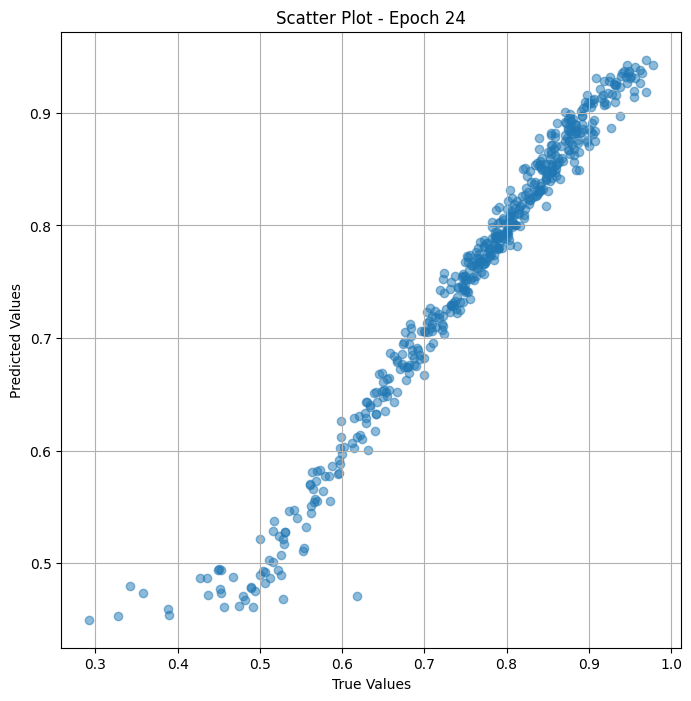

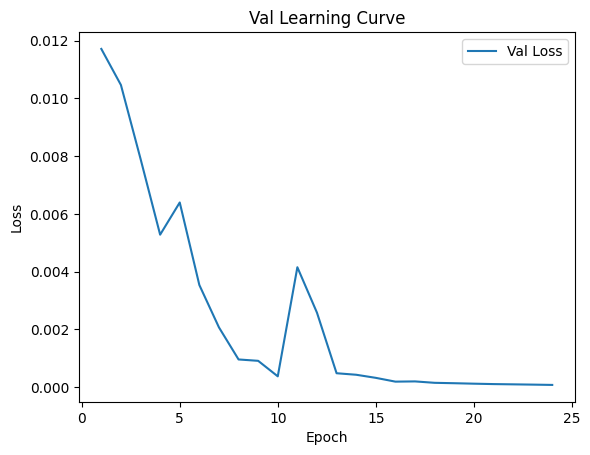


 Epoch: (25/30) Loss = 7.032880967017263e-05

 Epoch: (25/30) Loss_rmse = 0.008386227302253246

 Epoch: (25/30) R^2 = 0.9943409562110901

 Epoch: (25/30) MAE = 0.006570988800376654
Spearman correlation coefficient: SignificanceResult(statistic=0.9923683434138069, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

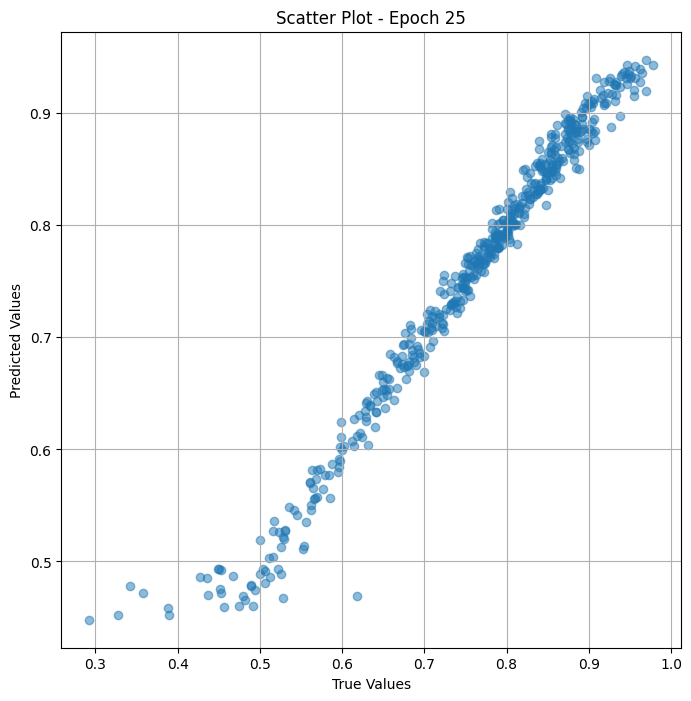

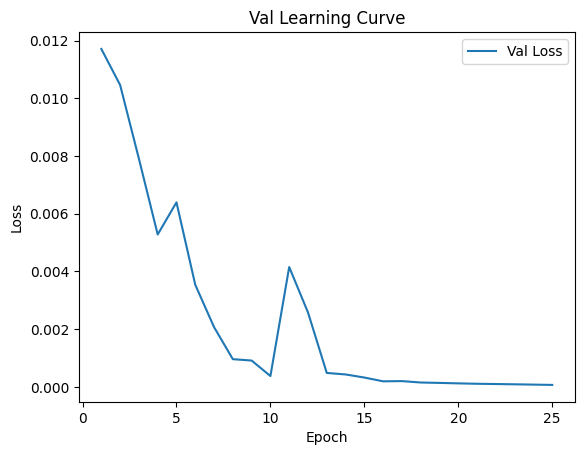


 Epoch: (26/30) Loss = 6.175397720653564e-05

 Epoch: (26/30) Loss_rmse = 0.007858369499444962

 Epoch: (26/30) R^2 = 0.99503093957901

 Epoch: (26/30) MAE = 0.006093350239098072
Spearman correlation coefficient: SignificanceResult(statistic=0.9930587247096392, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

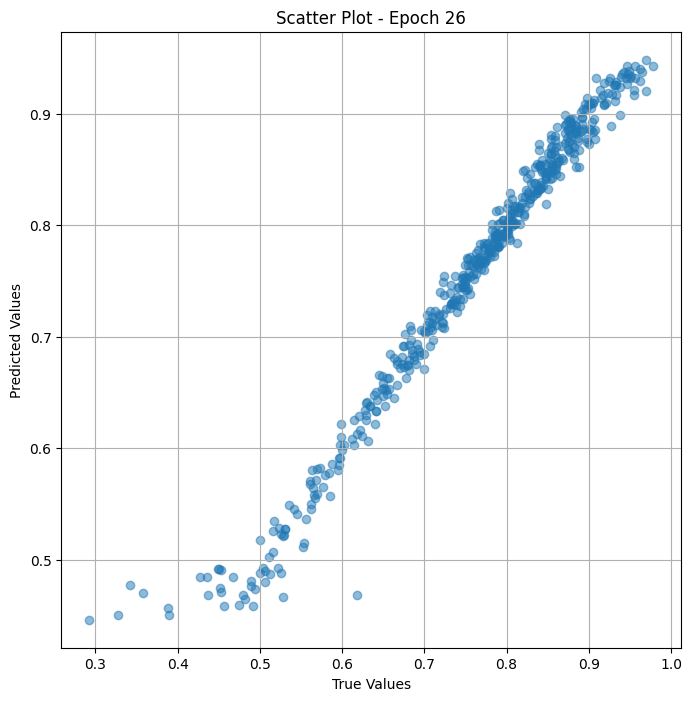

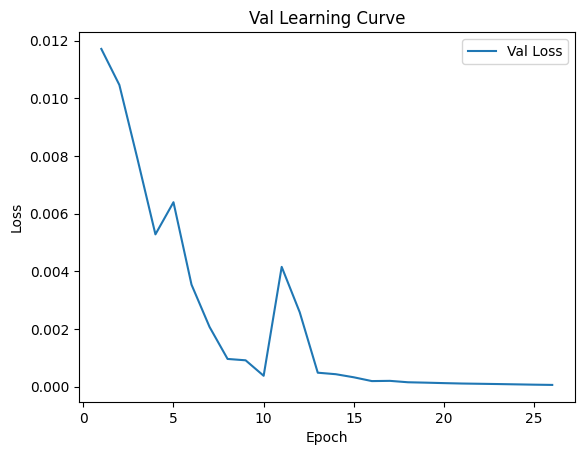


 Epoch: (27/30) Loss = 5.5442797020077705e-05

 Epoch: (27/30) Loss_rmse = 0.007445991970598698

 Epoch: (27/30) R^2 = 0.9955387711524963

 Epoch: (27/30) MAE = 0.005753952544182539
Spearman correlation coefficient: SignificanceResult(statistic=0.9936786844006, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

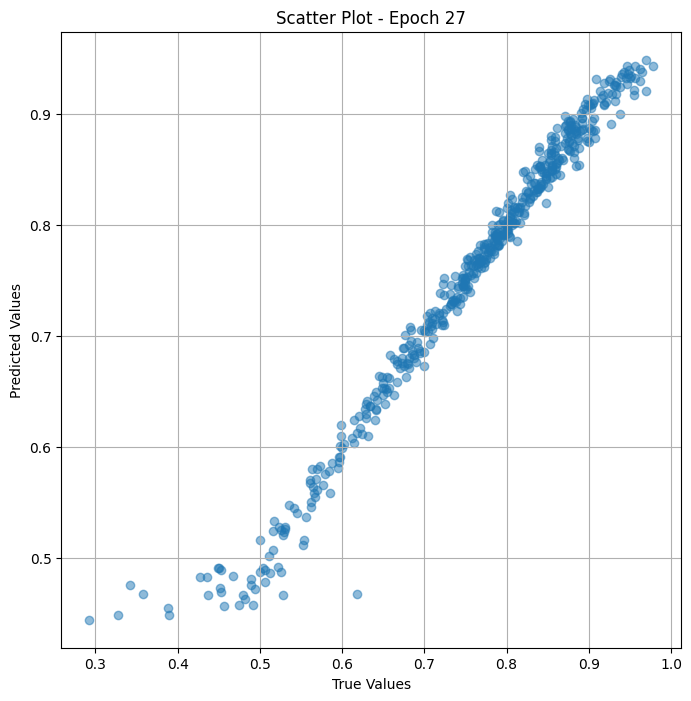

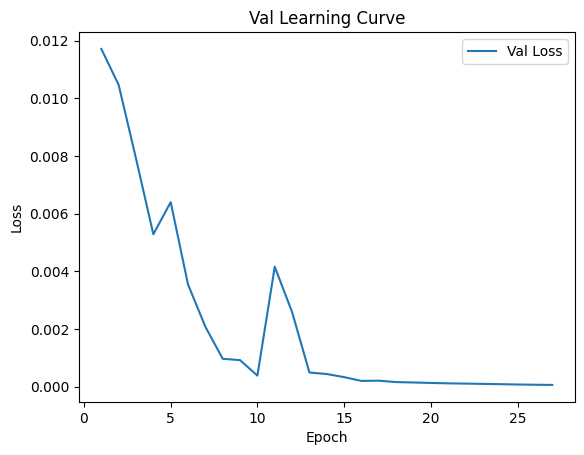


 Epoch: (28/30) Loss = 4.8177702410612255e-05

 Epoch: (28/30) Loss_rmse = 0.006941015832126141

 Epoch: (28/30) R^2 = 0.9961233735084534

 Epoch: (28/30) MAE = 0.005349457263946533
Spearman correlation coefficient: SignificanceResult(statistic=0.9943093863702702, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0

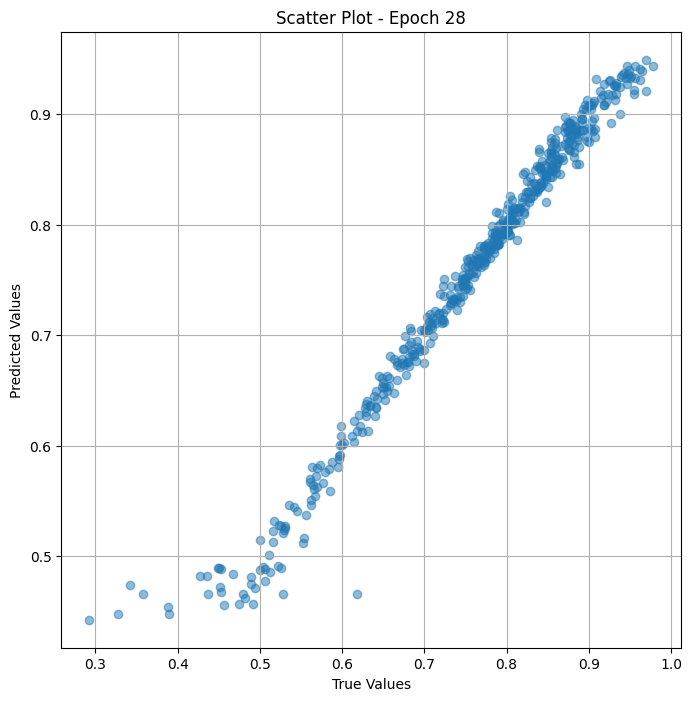

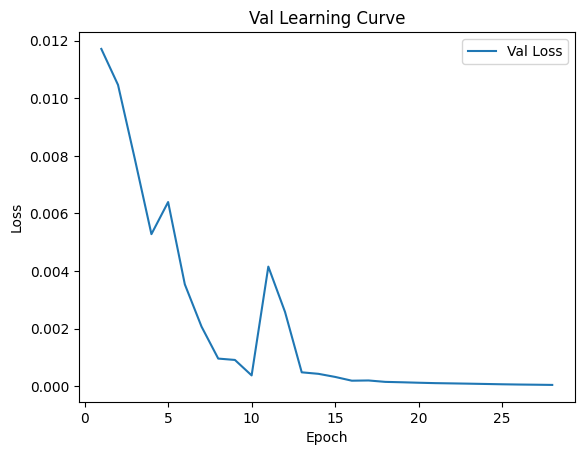


 Epoch: (29/30) Loss = 4.290525976102799e-05

 Epoch: (29/30) Loss_rmse = 0.006550210528075695

 Epoch: (29/30) R^2 = 0.9965476393699646

 Epoch: (29/30) MAE = 0.00504607567563653
Spearman correlation coefficient: SignificanceResult(statistic=0.994795393100963, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

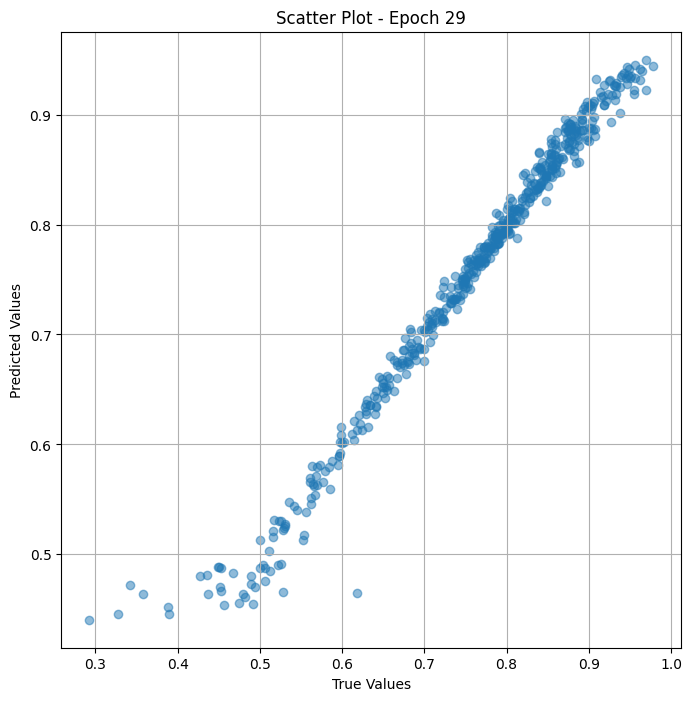

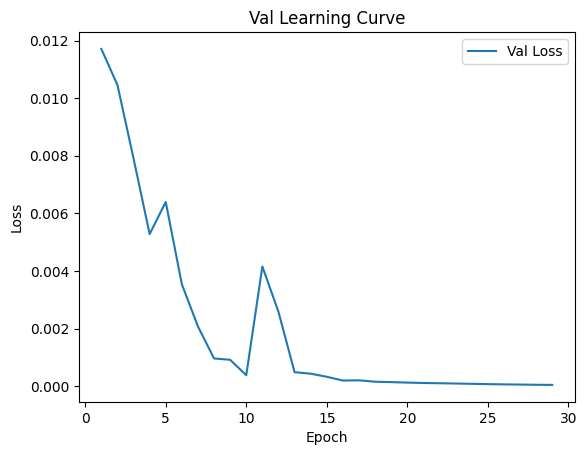


 Epoch: (30/30) Loss = 3.77763899450656e-05

 Epoch: (30/30) Loss_rmse = 0.006146250292658806

 Epoch: (30/30) R^2 = 0.9969603419303894

 Epoch: (30/30) MAE = 0.004759767558425665
Spearman correlation coefficient: SignificanceResult(statistic=0.9952001816941421, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

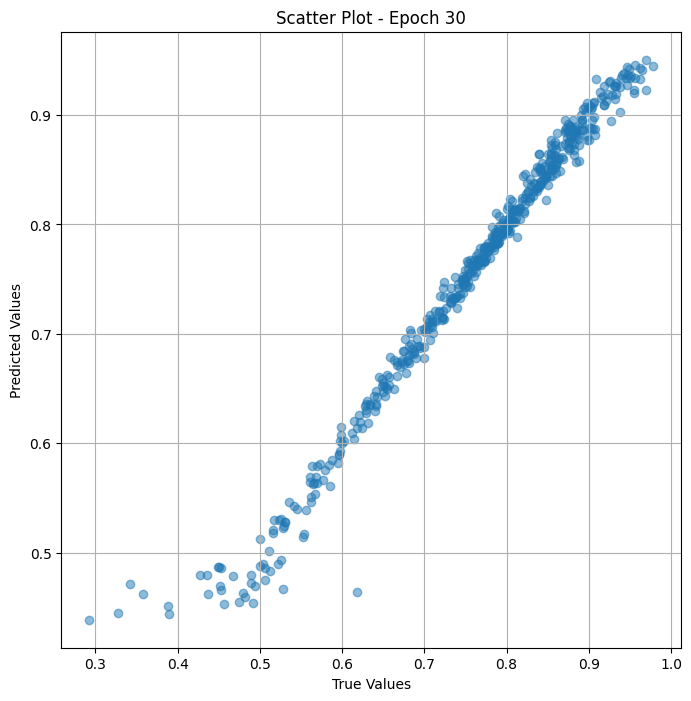

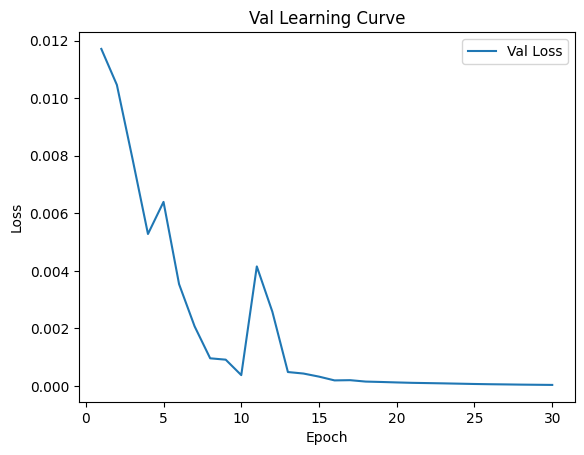

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_vit(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_merge' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_merge['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                            Image Path  True Value  \
0     /content/merged/n02946348_13257_preprocessed.jpg    0.731482   
1      /content/merged/n09288635_4220_preprocessed.jpg    0.703297   
2    /content/merged/a7aa9768e5b4e053_preprocessed.jpg    0.752688   
3      /content/merged/n01811909_2049_preprocessed.jpg    0.795455   
4      /content/merged/n04166281_4690_preprocessed.jpg    0.855556   
..                                                 ...         ...   
495    /content/merged/n09217230_5502_preprocessed.jpg    0.528736   
496  /content/merged/9b2823448b008dec_preprocessed.jpg    0.765306   
497   /content/merged/n07863374_16766_preprocessed.jpg    0.898990   
498   /content/merged/n04231693_18458_preprocessed.jpg    0.833333   
499      /content/merged/000000409138_preprocessed.jpg    0.670000   

     Predicted Value  
0           0.793765  
1           0.675034  
2           0.713598  
3           0.776281  
4           0.736159  
..               ... 

## Test

In [ ]:
df_test_merge.head()


,preprocessed_image_path,memoscore
0,/content/merged/n02332755_342_preprocessed.jpg,0.830357
1,/content/merged/6bfa7b57d0deb743_preprocessed.jpg,0.370787
2,/content/merged/8ec8d873e23d2435_preprocessed.jpg,0.840909
3,/content/merged/n03670208_41966_preprocessed.jpg,0.921348
4,/content/merged/000000233169_preprocessed.jpg,0.940000


In [ ]:
class Dataset_test_merge(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_test_merge["memoscore"]
        self.images = df_test_merge["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_merge(df_test_merge, trans_transform=trans_transform)
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
print(test_ds)

In [ ]:
class ViTMem_model_test_merge(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_test =  ViTMem_model_test_merge( arch="vit_base_patch16_224_miil")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_test_merge().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_vit_test  = to_device(model_vit_test  , device)

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.009122601710259914

 Epoch: (1/50) Loss_rmse = 0.09551230818033218

 Epoch: (1/50) R^2 = 0.05851614475250244

 Epoch: (1/50) MAE = 0.08175203949213028
Spearman correlation coefficient: SignificanceResult(statistic=0.2107089686407252, pvalue=3.212422502431918e-06)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286,

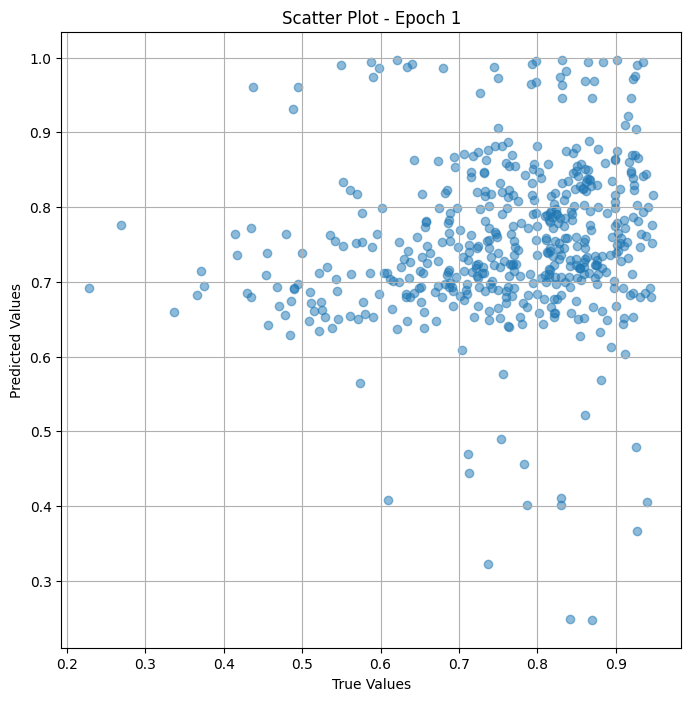

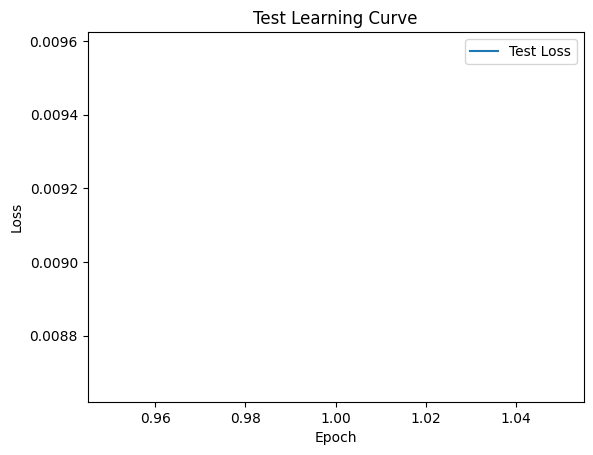


 Epoch: (2/50) Loss = 0.006406442262232304

 Epoch: (2/50) Loss_rmse = 0.08004025369882584

 Epoch: (2/50) R^2 = 0.33883315324783325

 Epoch: (2/50) MAE = 0.06512129306793213
Spearman correlation coefficient: SignificanceResult(statistic=0.622835385191633, pvalue=6.496844994030539e-53)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286, 

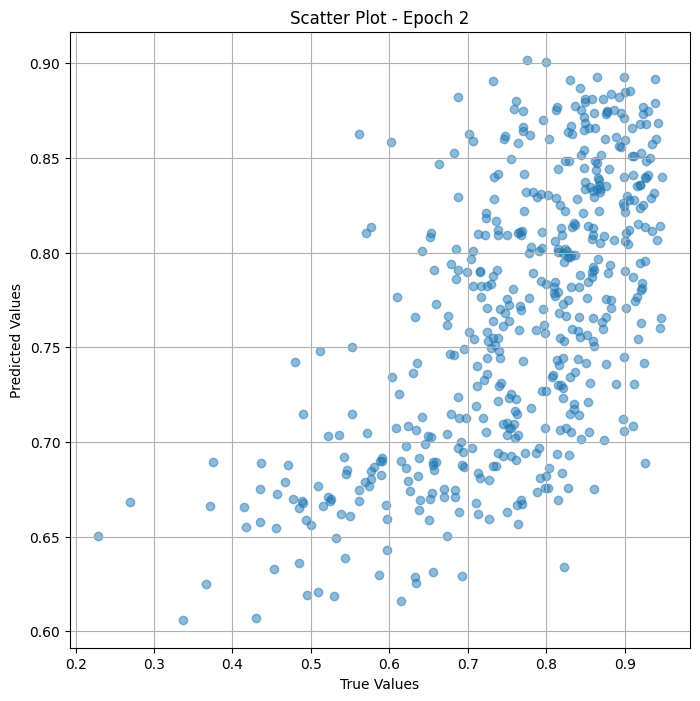

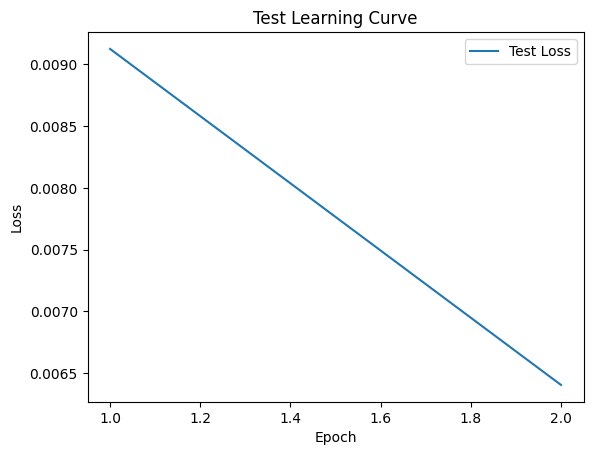


 Epoch: (3/50) Loss = 0.004942262079566717

 Epoch: (3/50) Loss_rmse = 0.07030122727155685

 Epoch: (3/50) R^2 = 0.4899415969848633

 Epoch: (3/50) MAE = 0.058345358818769455
Spearman correlation coefficient: SignificanceResult(statistic=0.720057103305352, pvalue=7.049195815301755e-78)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286, 

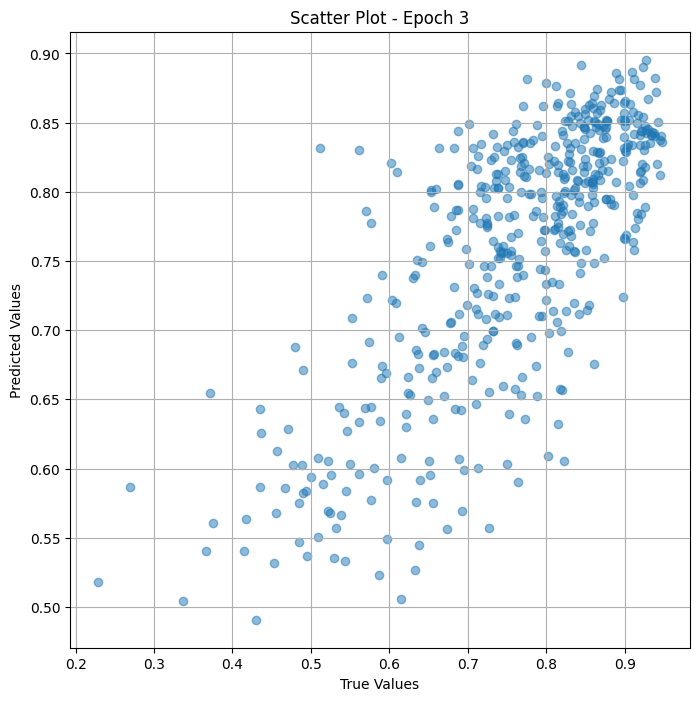

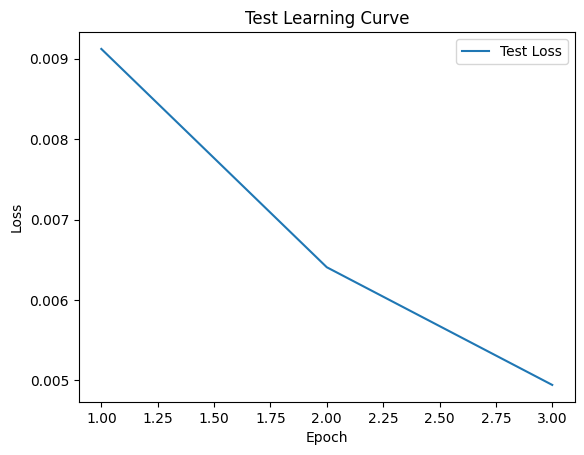


 Epoch: (4/50) Loss = 0.0029868416022509336

 Epoch: (4/50) Loss_rmse = 0.054652005434036255

 Epoch: (4/50) R^2 = 0.6917476654052734

 Epoch: (4/50) MAE = 0.04279039427638054
Spearman correlation coefficient: SignificanceResult(statistic=0.8053404705451191, pvalue=1.288382120037775e-110)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942528

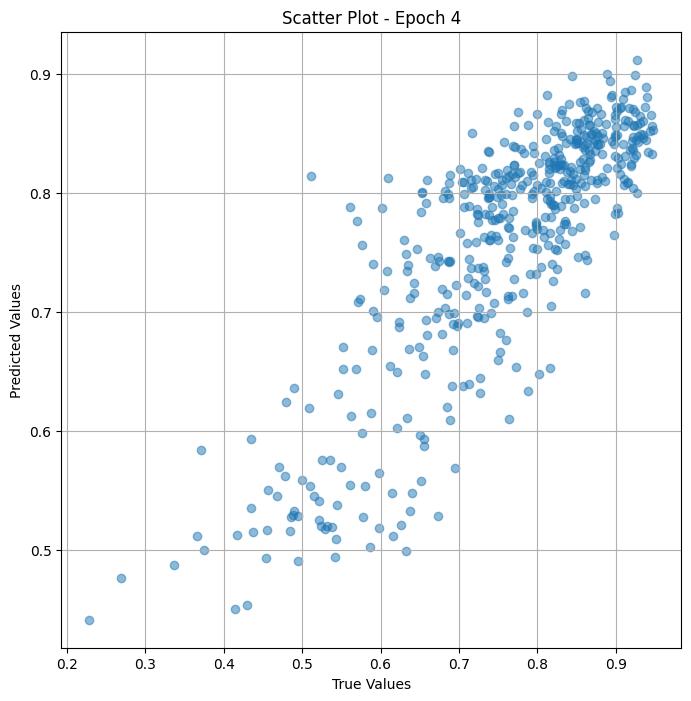

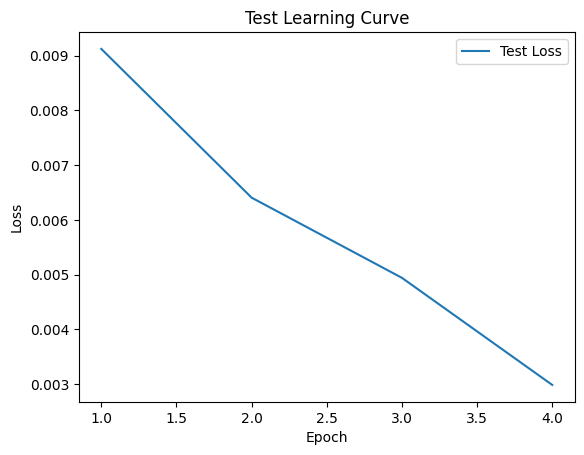


 Epoch: (5/50) Loss = 0.0013571521267294884

 Epoch: (5/50) Loss_rmse = 0.03683954477310181

 Epoch: (5/50) R^2 = 0.8599372506141663

 Epoch: (5/50) MAE = 0.02789207734167576
Spearman correlation coefficient: SignificanceResult(statistic=0.8778599597625292, pvalue=6.065772944035664e-155)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286

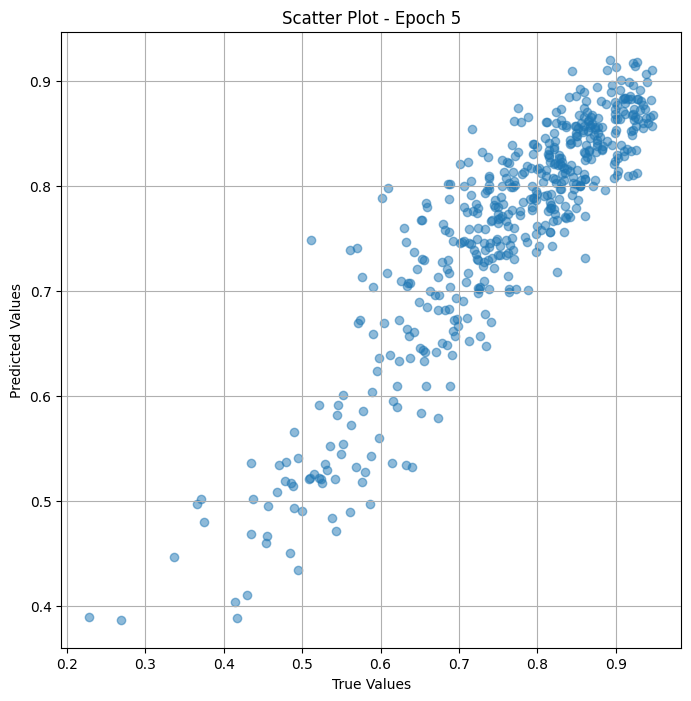

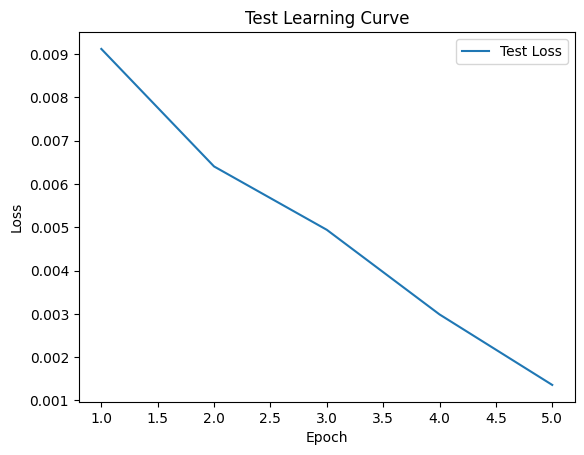


 Epoch: (6/50) Loss = 0.0008599046850576997

 Epoch: (6/50) Loss_rmse = 0.029324131086468697

 Epoch: (6/50) R^2 = 0.9112548828125

 Epoch: (6/50) MAE = 0.024373099207878113
Spearman correlation coefficient: SignificanceResult(statistic=0.8996628066702772, pvalue=3.6374777380561e-174)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286, 0

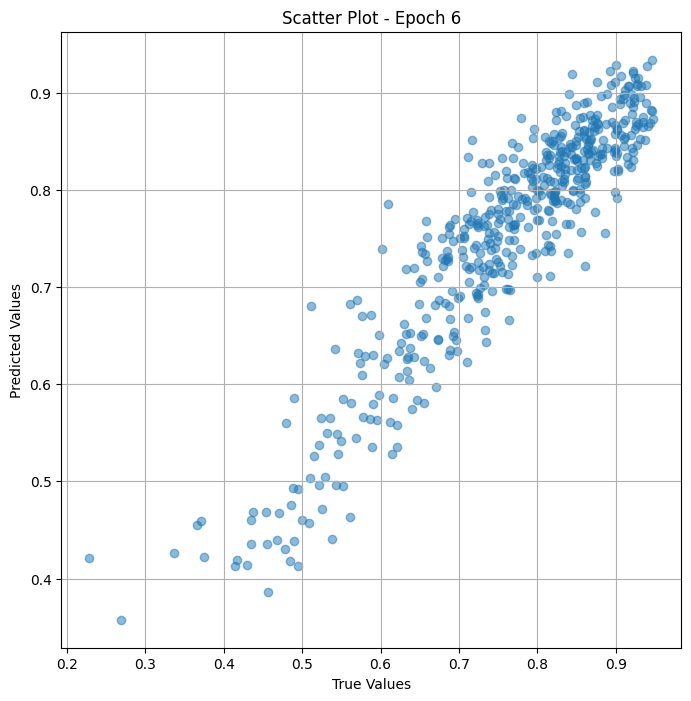

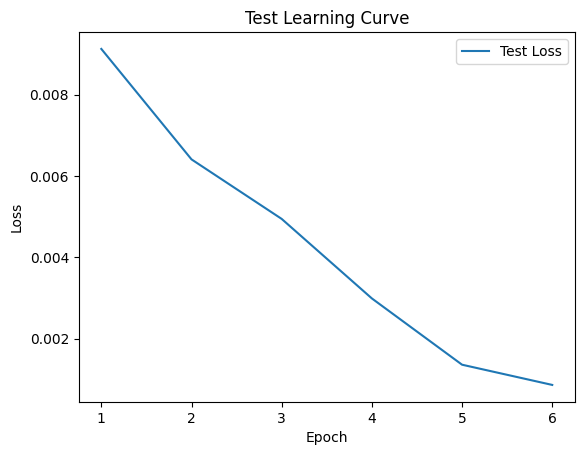


 Epoch: (7/50) Loss = 0.0023561231791973114

 Epoch: (7/50) Loss_rmse = 0.048539914190769196

 Epoch: (7/50) R^2 = 0.7568399906158447

 Epoch: (7/50) MAE = 0.040943022817373276
Spearman correlation coefficient: SignificanceResult(statistic=0.8414875027030608, pvalue=6.715757352189819e-130)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

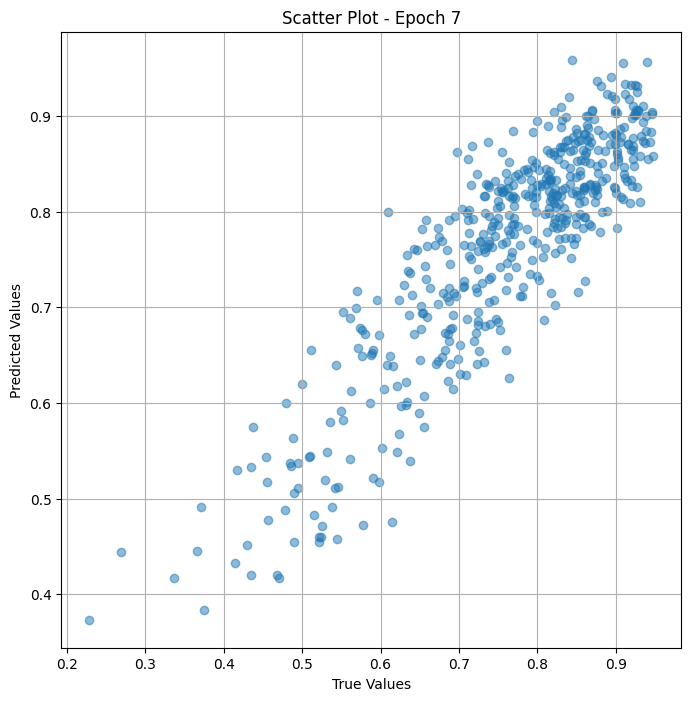

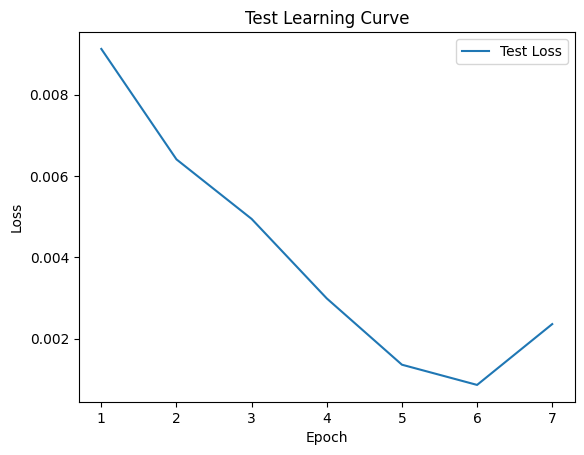


 Epoch: (8/50) Loss = 0.0009221938671544194

 Epoch: (8/50) Loss_rmse = 0.030367644503712654

 Epoch: (8/50) R^2 = 0.9048264026641846

 Epoch: (8/50) MAE = 0.022150183096528053
Spearman correlation coefficient: SignificanceResult(statistic=0.9261846566910851, pvalue=1.3335279551279524e-204)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425

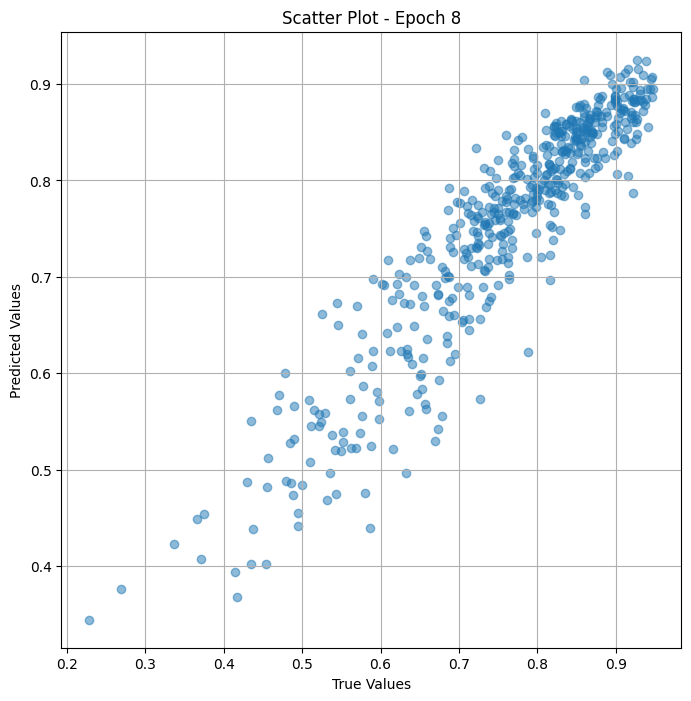

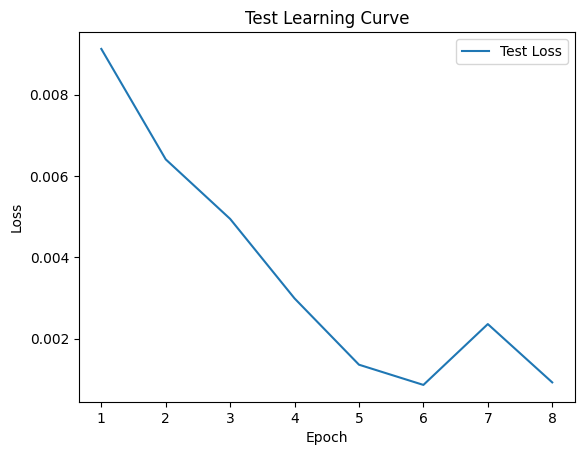


 Epoch: (9/50) Loss = 0.000582349777687341

 Epoch: (9/50) Loss_rmse = 0.02413192391395569

 Epoch: (9/50) R^2 = 0.9398995041847229

 Epoch: (9/50) MAE = 0.01838400773704052
Spearman correlation coefficient: SignificanceResult(statistic=0.9623252326364441, pvalue=1.6863959339359306e-272)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286

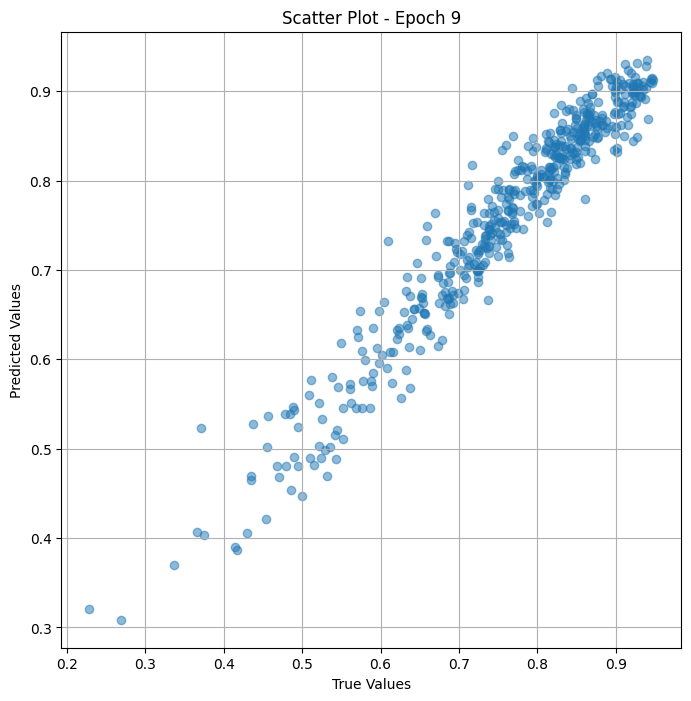

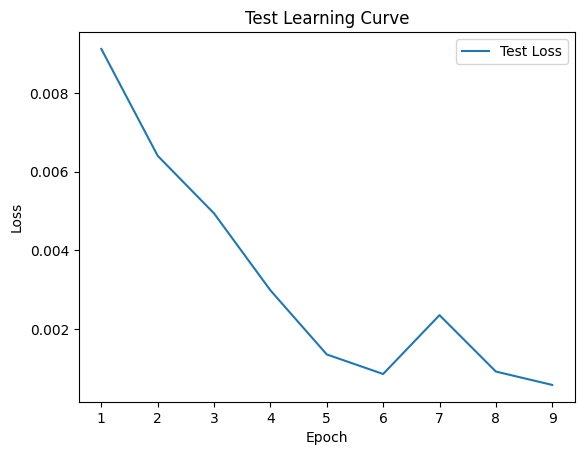


 Epoch: (10/50) Loss = 0.0003316059010103345

 Epoch: (10/50) Loss_rmse = 0.018210049718618393

 Epoch: (10/50) R^2 = 0.9657771587371826

 Epoch: (10/50) MAE = 0.01451768446713686
Spearman correlation coefficient: SignificanceResult(statistic=0.9716287977299561, pvalue=1.8855428287843096e-301)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

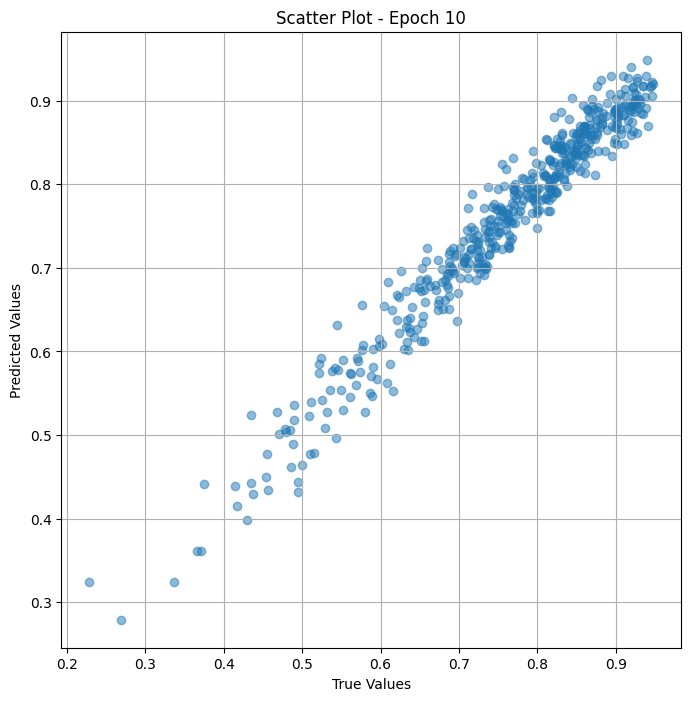

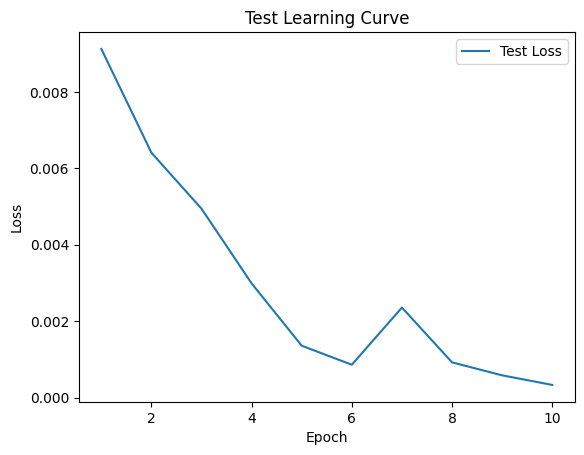


 Epoch: (11/50) Loss = 0.0010432186536490917

 Epoch: (11/50) Loss_rmse = 0.032298896461725235

 Epoch: (11/50) R^2 = 0.8923362493515015

 Epoch: (11/50) MAE = 0.028400177136063576
Spearman correlation coefficient: SignificanceResult(statistic=0.9492948595199118, pvalue=2.3586082089340272e-242)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

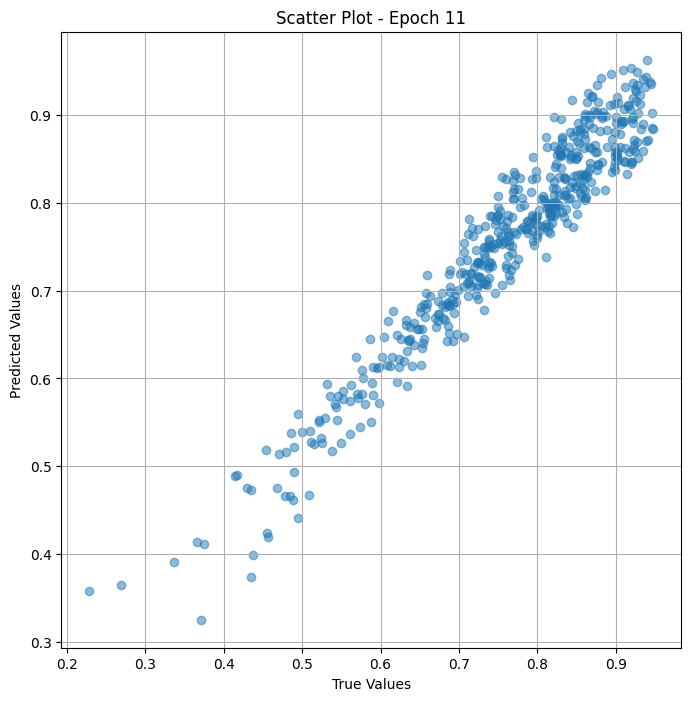

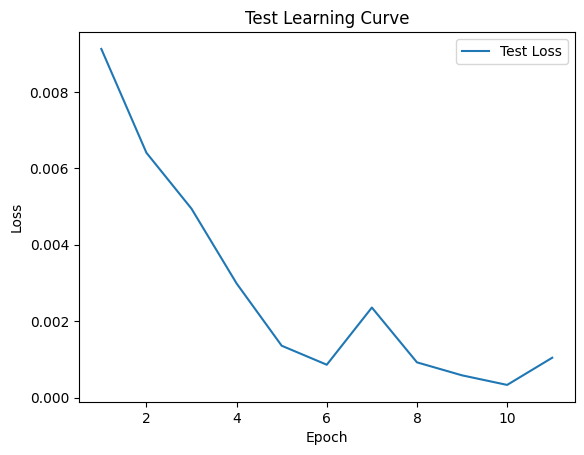


 Epoch: (12/50) Loss = 0.0021710307337343693

 Epoch: (12/50) Loss_rmse = 0.046594321727752686

 Epoch: (12/50) R^2 = 0.7759421467781067

 Epoch: (12/50) MAE = 0.04051309823989868
Spearman correlation coefficient: SignificanceResult(statistic=0.9224636538340006, pvalue=1.073397277481009e-199)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

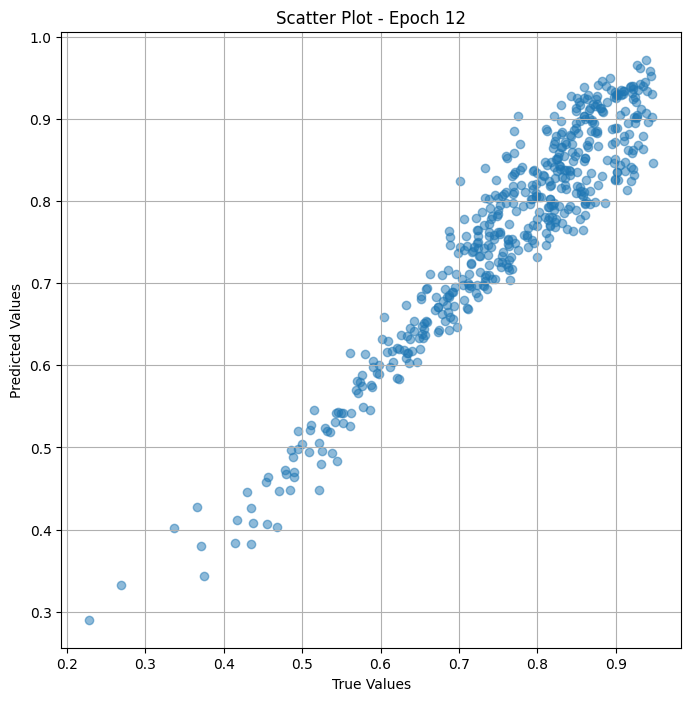

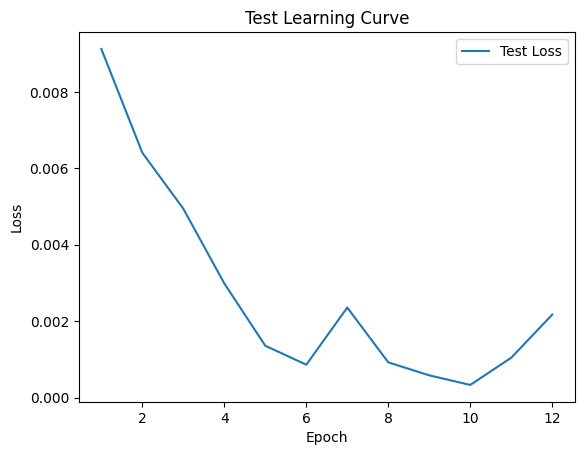

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (13/50) Loss = 0.0010903335642069578

 Epoch: (13/50) Loss_rmse = 0.033020198345184326

 Epoch: (13/50) R^2 = 0.8874738216400146

 Epoch: (13/50) MAE = 0.02979295328259468
Spearman correlation coefficient: SignificanceResult(statistic=0.9268375479702591, pvalue=1.7286950710113814e-205)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 

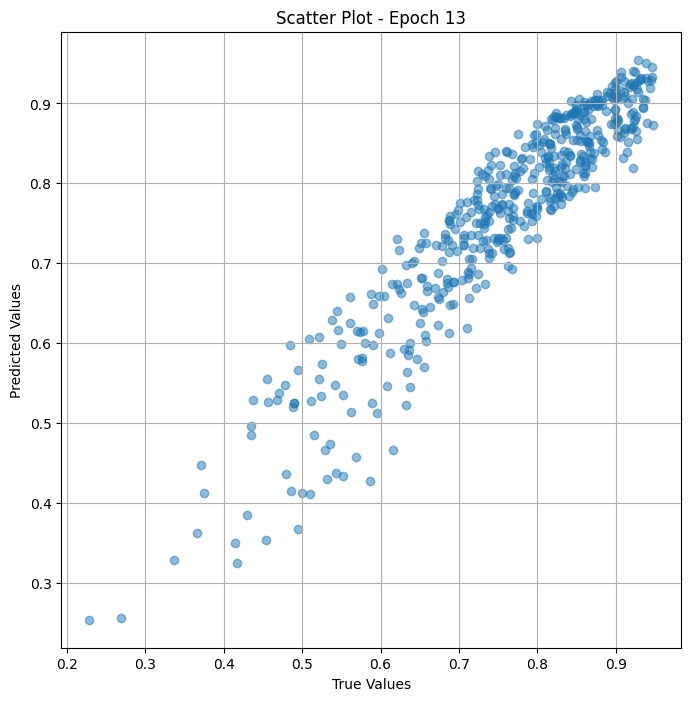

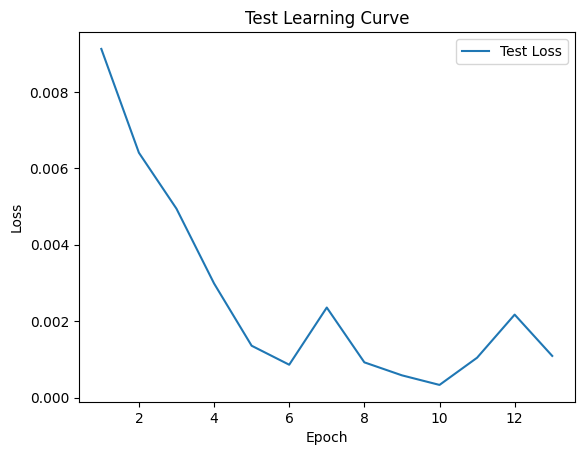


 Epoch: (14/50) Loss = 0.001311344327405095

 Epoch: (14/50) Loss_rmse = 0.0362124890089035

 Epoch: (14/50) R^2 = 0.8646647930145264

 Epoch: (14/50) MAE = 0.02681431546807289
Spearman correlation coefficient: SignificanceResult(statistic=0.9101335356402123, pvalue=4.861581244130597e-185)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

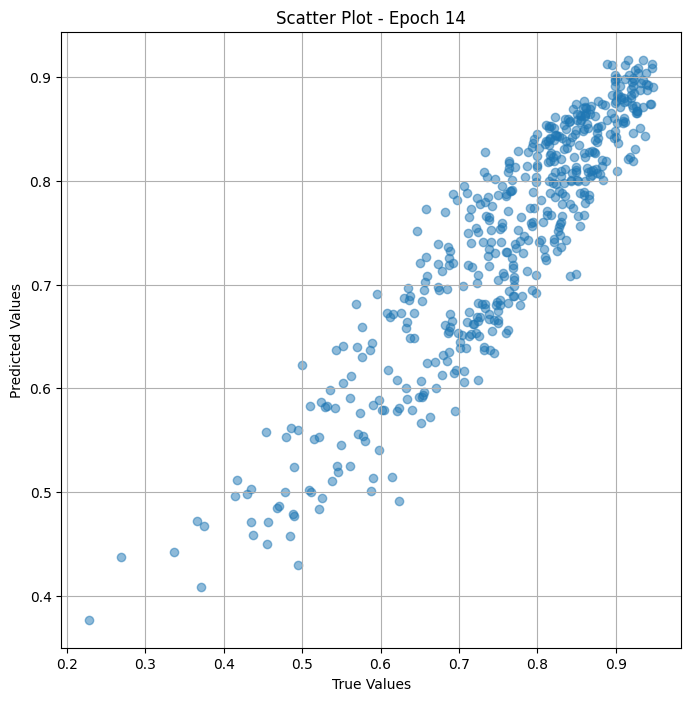

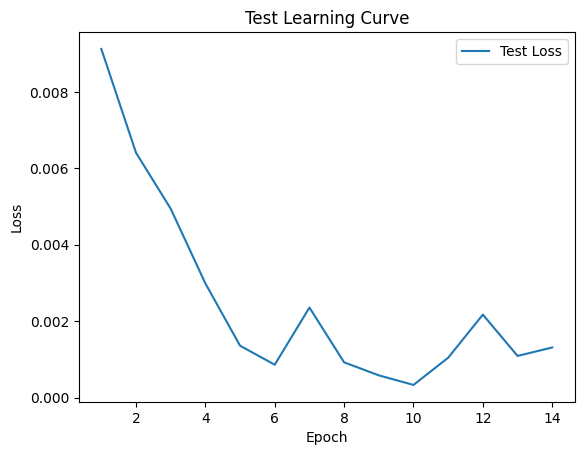


 Epoch: (15/50) Loss = 0.0011838354403153062

 Epoch: (15/50) Loss_rmse = 0.034406911581754684

 Epoch: (15/50) R^2 = 0.8778241276741028

 Epoch: (15/50) MAE = 0.025440841913223267
Spearman correlation coefficient: SignificanceResult(statistic=0.9535646947004235, pvalue=2.9318872784002765e-251)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

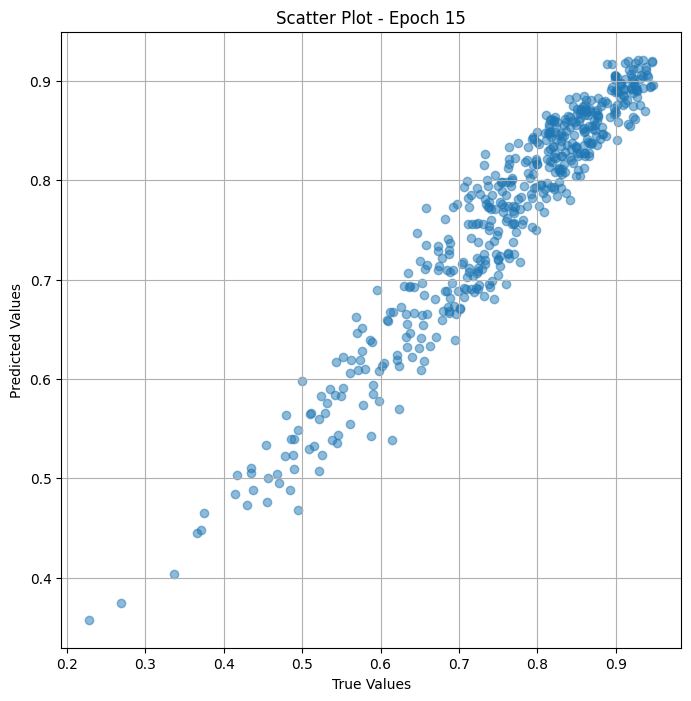

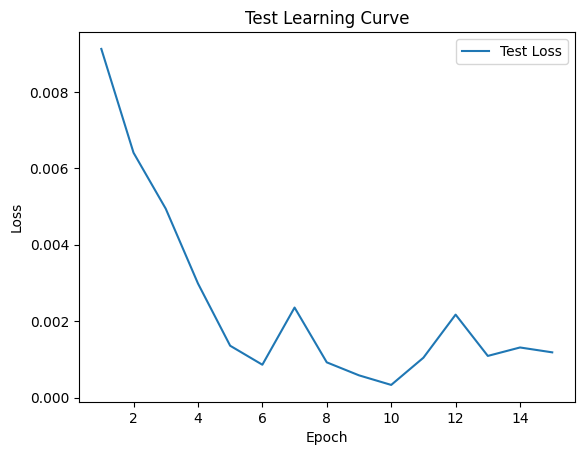

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (16/50) Loss = 0.0008011051686480641

 Epoch: (16/50) Loss_rmse = 0.028303802013397217

 Epoch: (16/50) R^2 = 0.9173231720924377

 Epoch: (16/50) MAE = 0.020049158483743668
Spearman correlation coefficient: SignificanceResult(statistic=0.9615342652142173, pvalue=2.1982350673761118e-270)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514,

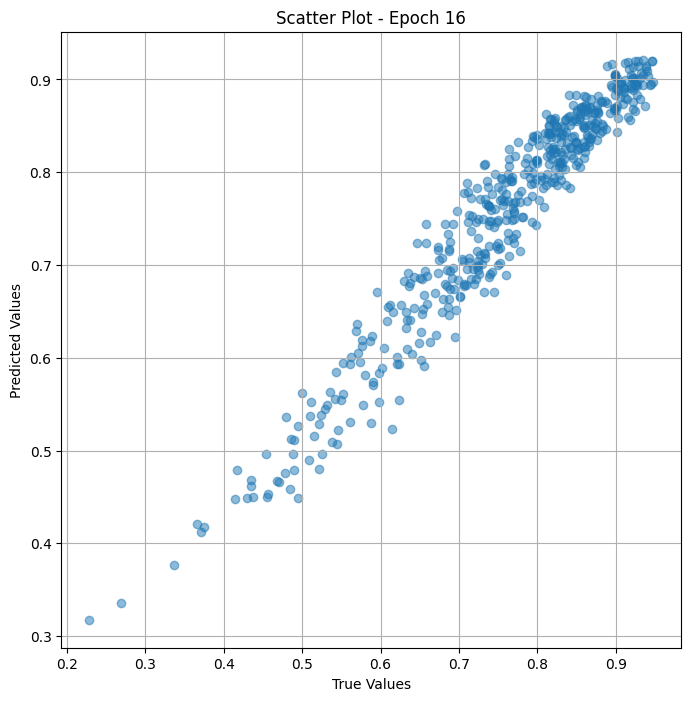

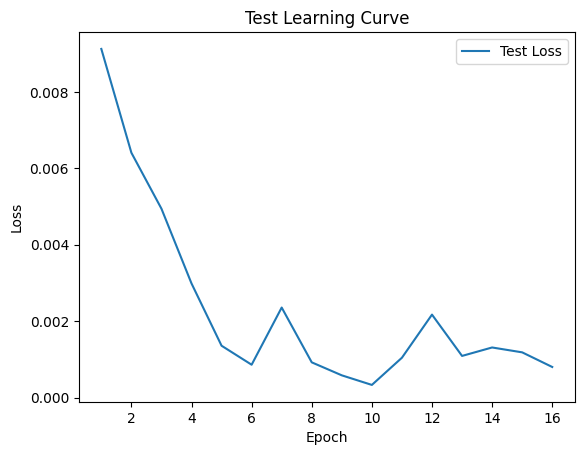


 Epoch: (17/50) Loss = 0.0007361106690950692

 Epoch: (17/50) Loss_rmse = 0.02713136002421379

 Epoch: (17/50) R^2 = 0.9240308403968811

 Epoch: (17/50) MAE = 0.019129976630210876
Spearman correlation coefficient: SignificanceResult(statistic=0.967787893782048, pvalue=1.7928246594587965e-288)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

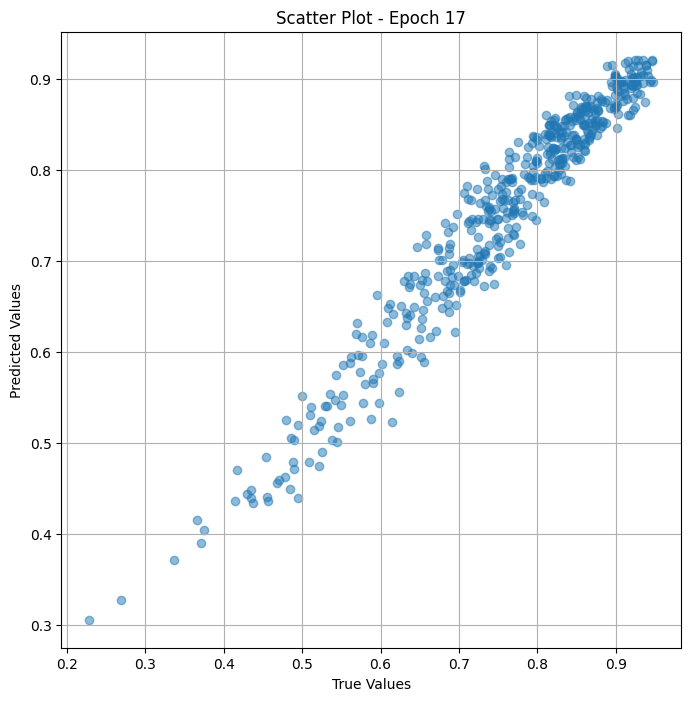

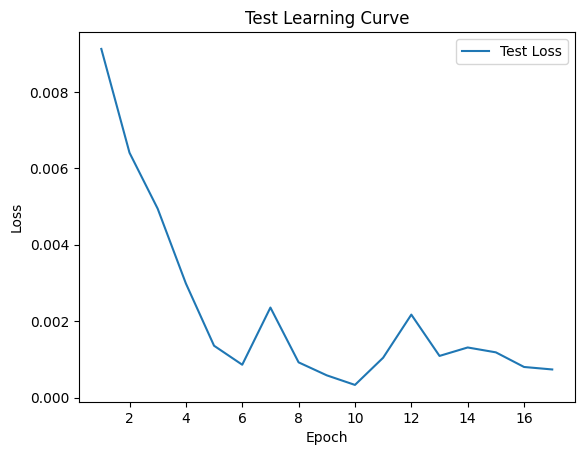


 Epoch: (18/50) Loss = 0.0007358057191595435

 Epoch: (18/50) Loss_rmse = 0.027125738561153412

 Epoch: (18/50) R^2 = 0.9240623116493225

 Epoch: (18/50) MAE = 0.019260181114077568
Spearman correlation coefficient: SignificanceResult(statistic=0.9681339793288198, pvalue=1.413900327716731e-289)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

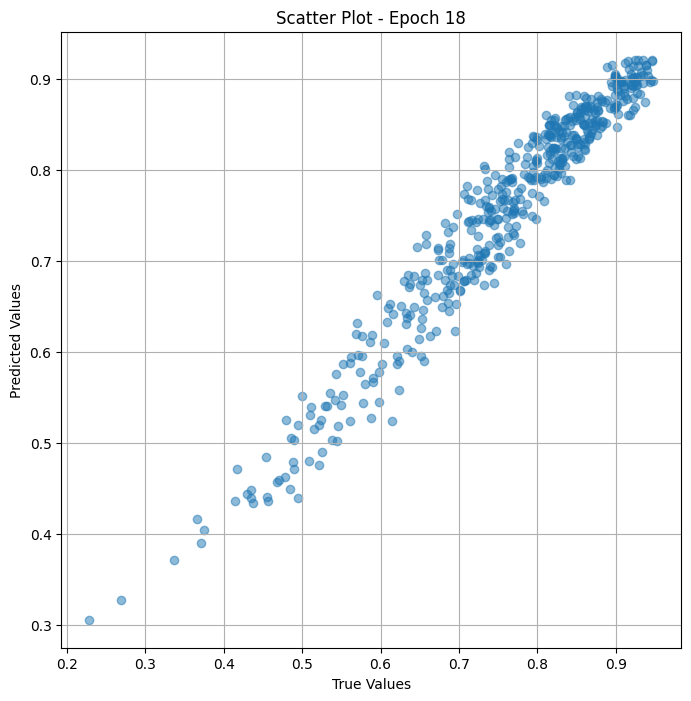

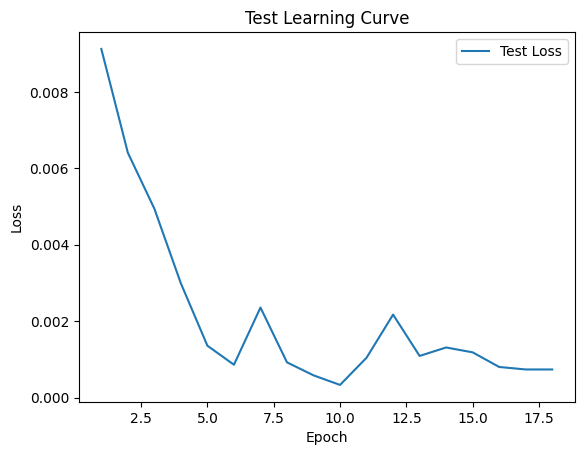

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (19/50) Loss = 0.0007339987787418067

 Epoch: (19/50) Loss_rmse = 0.02709241211414337

 Epoch: (19/50) R^2 = 0.9242488145828247

 Epoch: (19/50) MAE = 0.0194226186722517
Spearman correlation coefficient: SignificanceResult(statistic=0.9685322028612394, pvalue=7.344192190100463e-291)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9

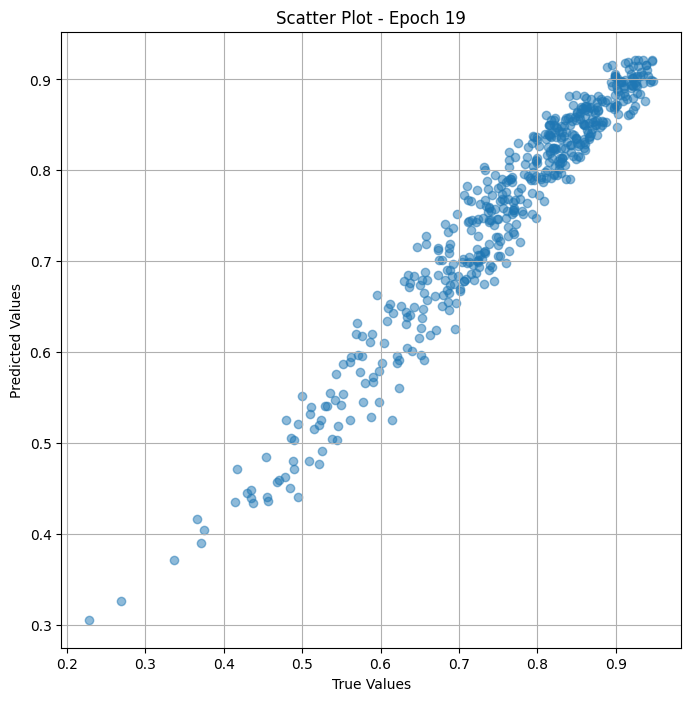

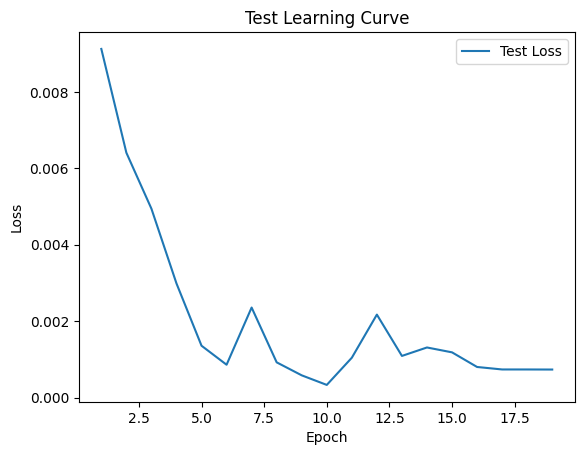


 Epoch: (20/50) Loss = 0.0007287845946848392

 Epoch: (20/50) Loss_rmse = 0.026996010914444923

 Epoch: (20/50) R^2 = 0.9247869253158569

 Epoch: (20/50) MAE = 0.01935369335114956
Spearman correlation coefficient: SignificanceResult(statistic=0.9694286398402816, pvalue=8.184134174748797e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

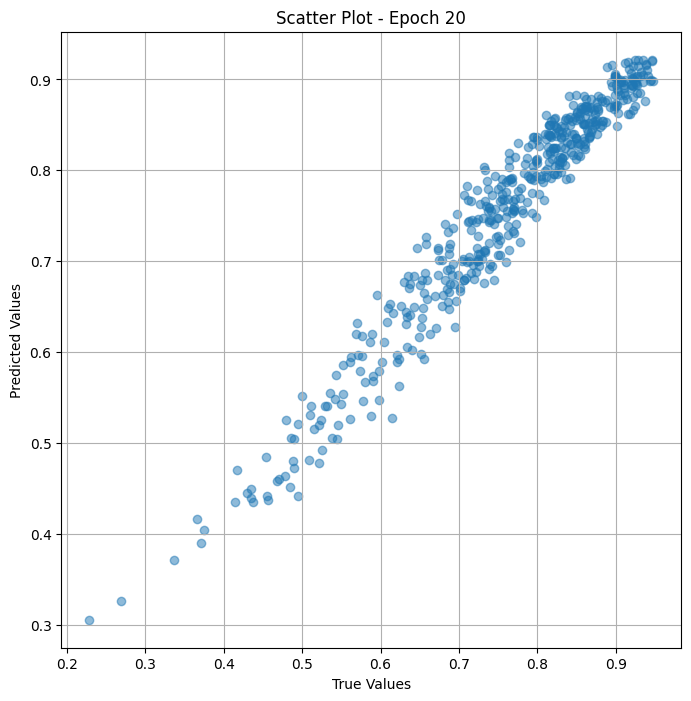

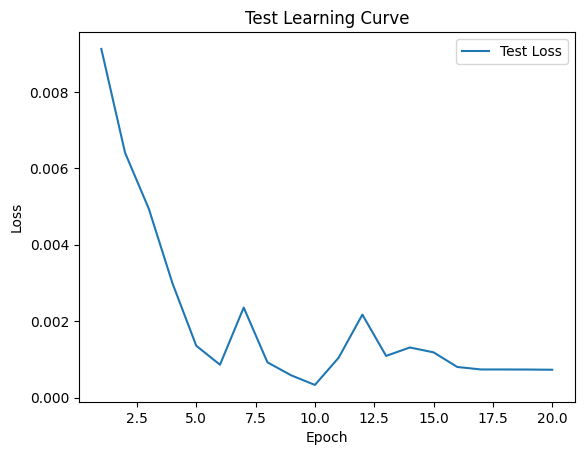


 Epoch: (21/50) Loss = 0.0007281985017471015

 Epoch: (21/50) Loss_rmse = 0.026985153555870056

 Epoch: (21/50) R^2 = 0.924847424030304

 Epoch: (21/50) MAE = 0.019361499696969986
Spearman correlation coefficient: SignificanceResult(statistic=0.9694956976449234, pvalue=4.8814759540850636e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

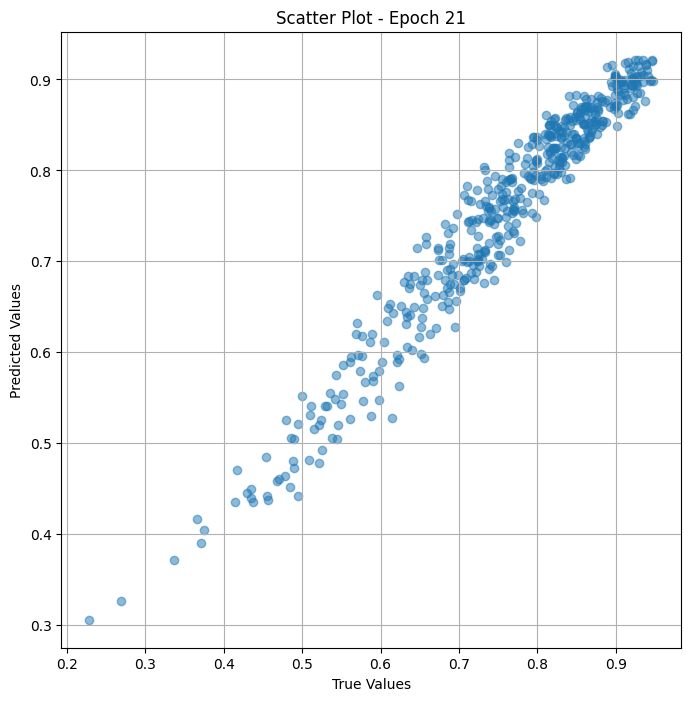

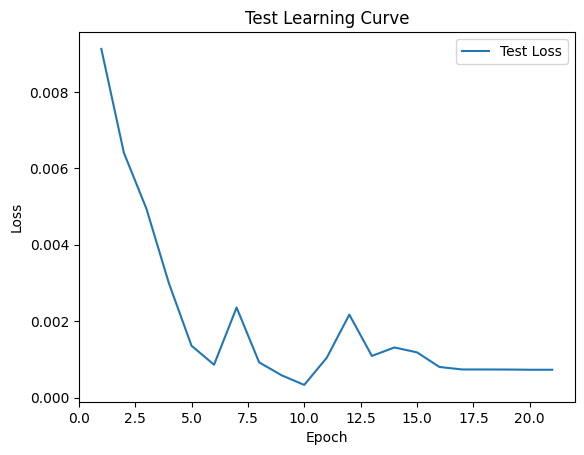

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (22/50) Loss = 0.0007275601383298635

 Epoch: (22/50) Loss_rmse = 0.02697332203388214

 Epoch: (22/50) R^2 = 0.9249132871627808

 Epoch: (22/50) MAE = 0.019368549808859825
Spearman correlation coefficient: SignificanceResult(statistic=0.9695256457906855, pvalue=3.874022153399728e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0

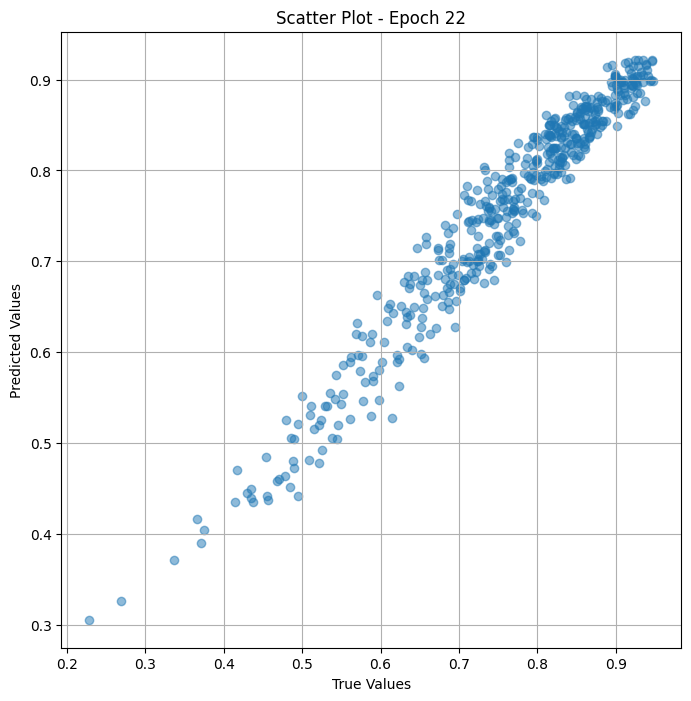

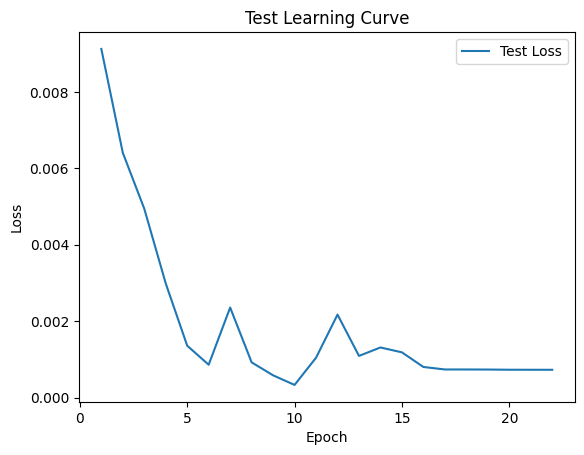


 Epoch: (23/50) Loss = 0.0007269973284564912

 Epoch: (23/50) Loss_rmse = 0.02696288749575615

 Epoch: (23/50) R^2 = 0.9249714016914368

 Epoch: (23/50) MAE = 0.019360169768333435
Spearman correlation coefficient: SignificanceResult(statistic=0.9696013299634002, pvalue=2.1578148421871786e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

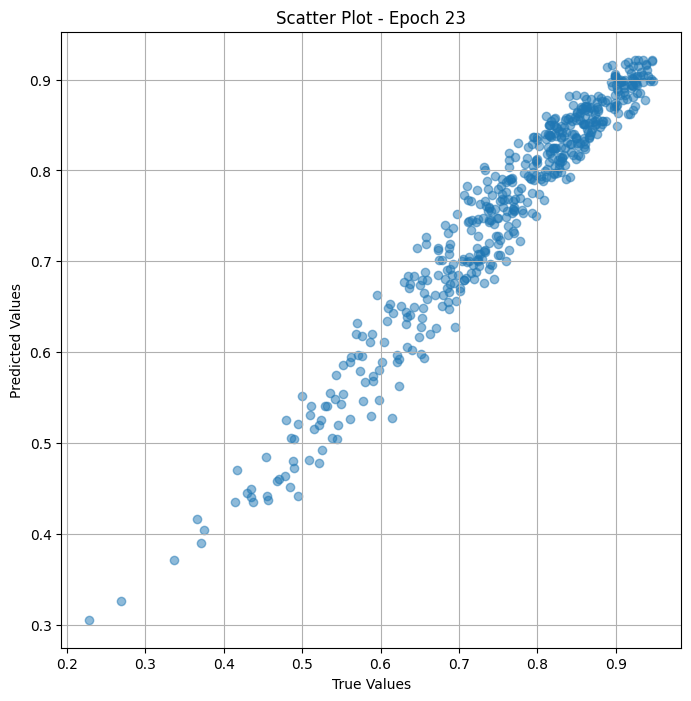

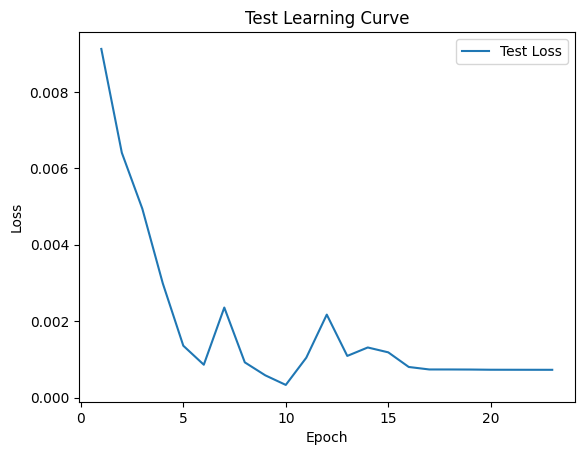


 Epoch: (24/50) Loss = 0.0007269677589647472

 Epoch: (24/50) Loss_rmse = 0.026962339878082275

 Epoch: (24/50) R^2 = 0.9249744415283203

 Epoch: (24/50) MAE = 0.019360730424523354
Spearman correlation coefficient: SignificanceResult(statistic=0.9696013299634002, pvalue=2.1578148421871786e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

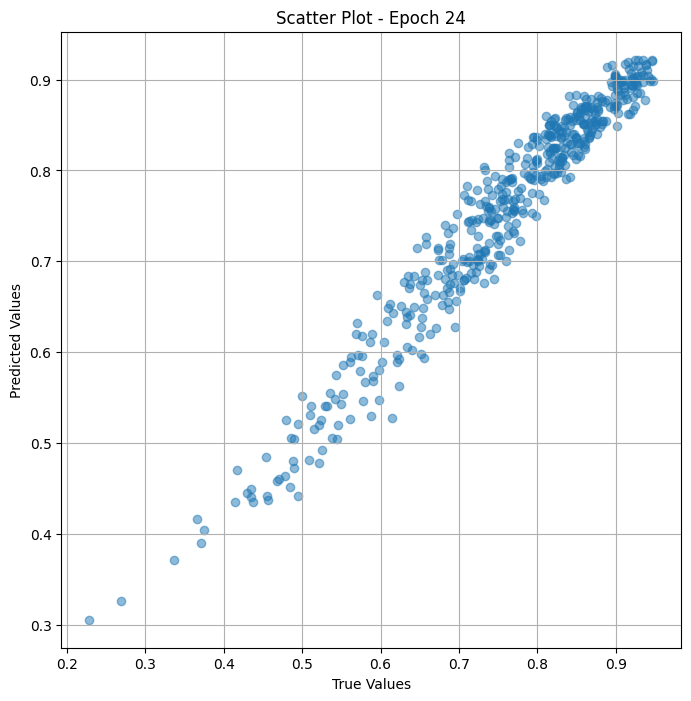

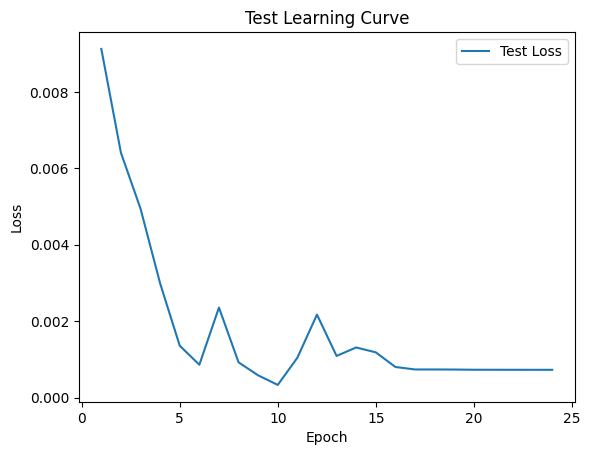


 Epoch: (25/50) Loss = 0.0007269374909810722

 Epoch: (25/50) Loss_rmse = 0.026961779221892357

 Epoch: (25/50) R^2 = 0.9249775409698486

 Epoch: (25/50) MAE = 0.019361330196261406
Spearman correlation coefficient: SignificanceResult(statistic=0.9696013299634002, pvalue=2.1578148421871786e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

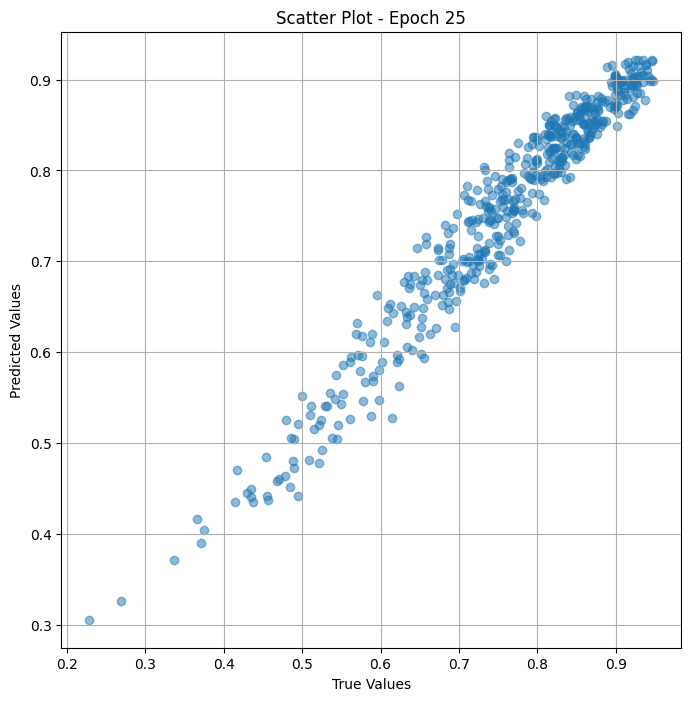

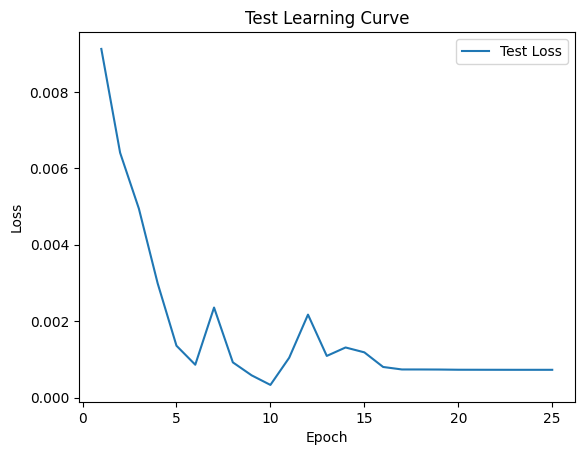


 Epoch: (26/50) Loss = 0.0007269044290296733

 Epoch: (26/50) Loss_rmse = 0.02696116454899311

 Epoch: (26/50) R^2 = 0.9249809384346008

 Epoch: (26/50) MAE = 0.01936189830303192
Spearman correlation coefficient: SignificanceResult(statistic=0.9696060500515912, pvalue=2.0803806428813042e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

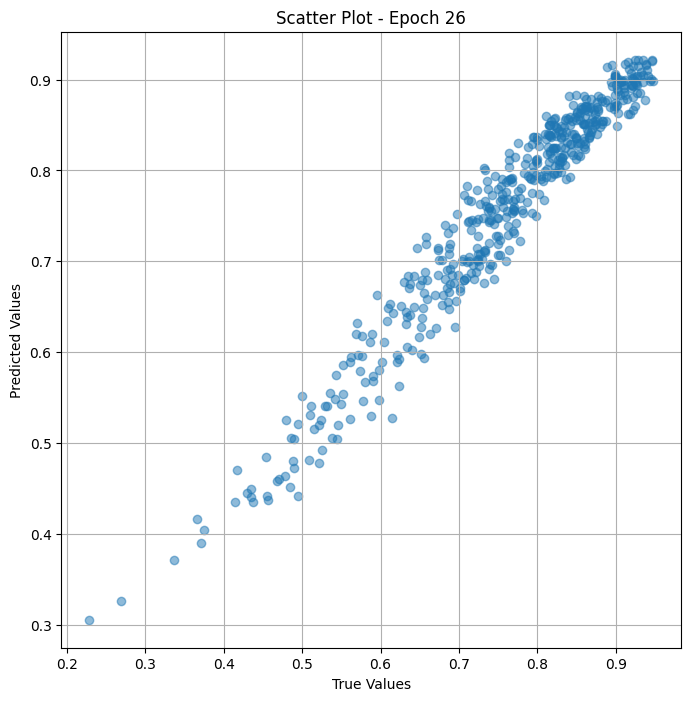

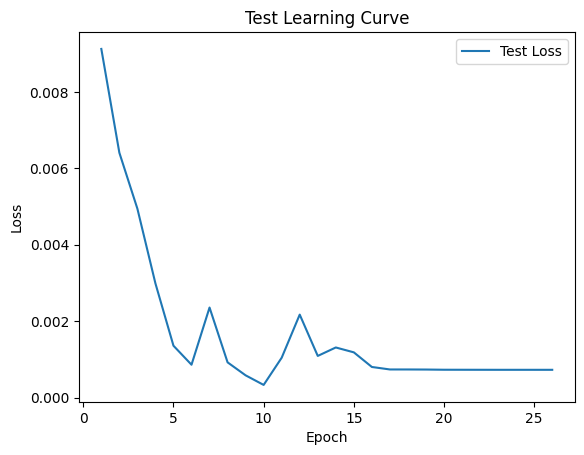


 Epoch: (27/50) Loss = 0.0007268712506629527

 Epoch: (27/50) Loss_rmse = 0.026960549876093864

 Epoch: (27/50) R^2 = 0.9249843955039978

 Epoch: (27/50) MAE = 0.019362494349479675
Spearman correlation coefficient: SignificanceResult(statistic=0.9696060500515912, pvalue=2.0803806428813042e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

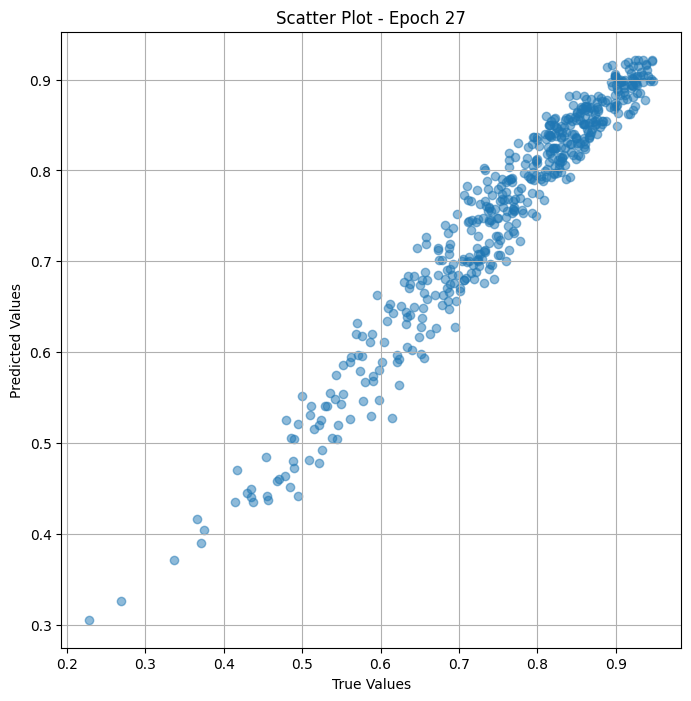

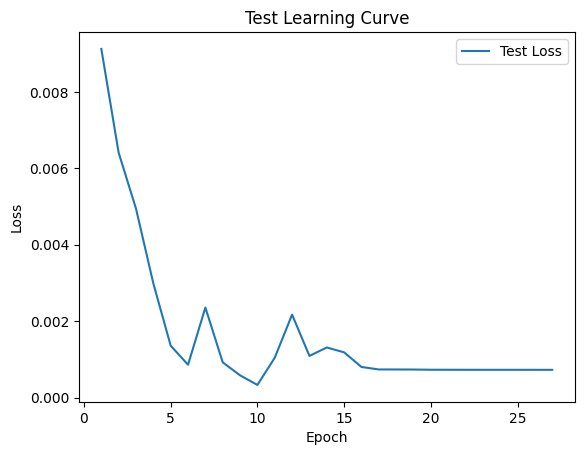


 Epoch: (28/50) Loss = 0.0007268374902196229

 Epoch: (28/50) Loss_rmse = 0.026959924027323723

 Epoch: (28/50) R^2 = 0.9249878525733948

 Epoch: (28/50) MAE = 0.019363099709153175
Spearman correlation coefficient: SignificanceResult(statistic=0.9696060500515912, pvalue=2.0803806428813042e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

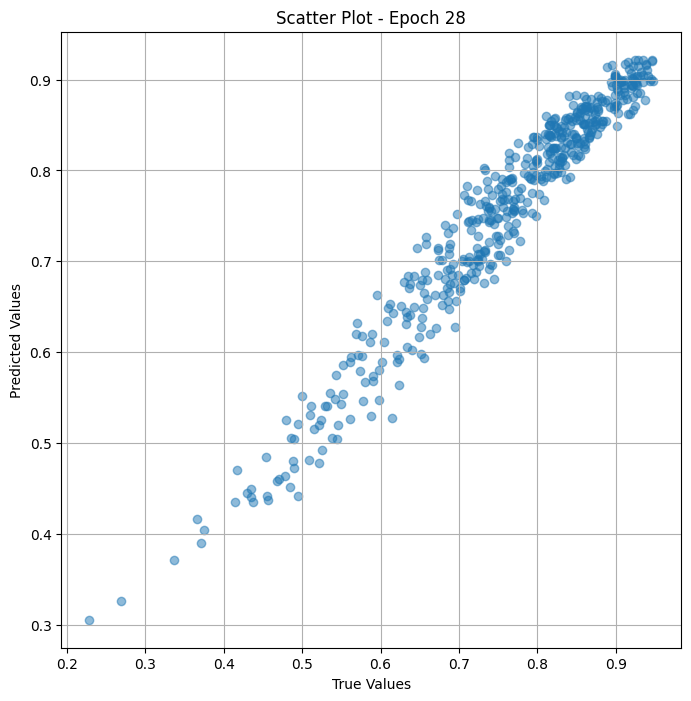

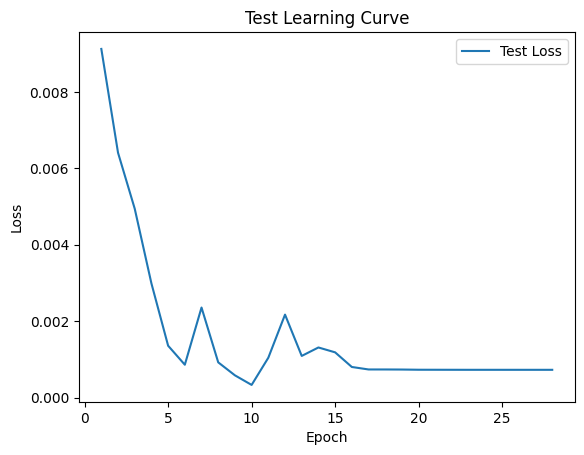


 Epoch: (29/50) Loss = 0.0007268009940162301

 Epoch: (29/50) Loss_rmse = 0.026959246024489403

 Epoch: (29/50) R^2 = 0.9249916076660156

 Epoch: (29/50) MAE = 0.019363701343536377
Spearman correlation coefficient: SignificanceResult(statistic=0.9696117467097523, pvalue=1.9906016773784005e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

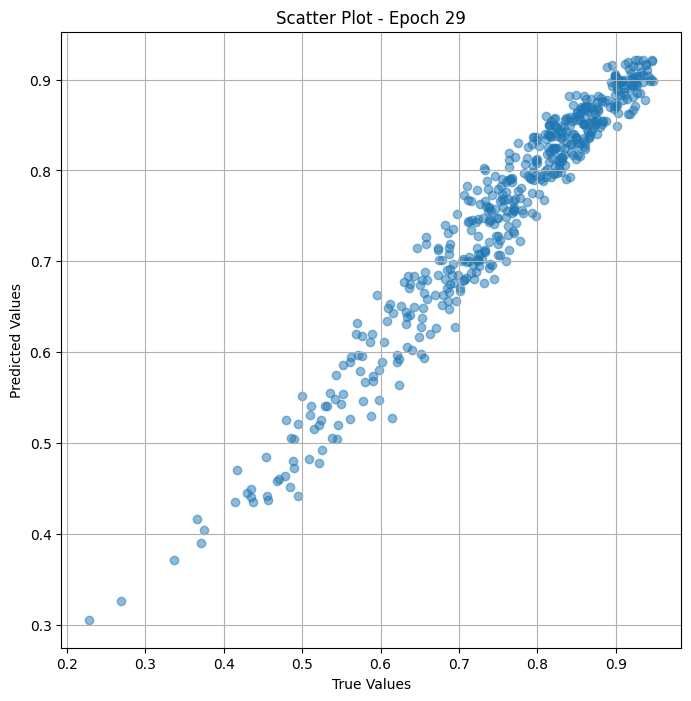

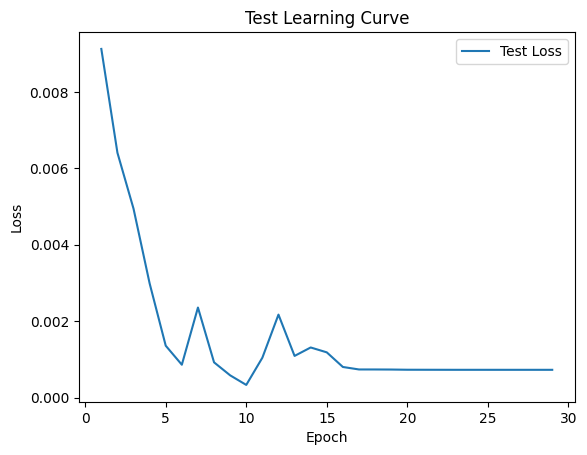


 Epoch: (30/50) Loss = 0.0007267638575285673

 Epoch: (30/50) Loss_rmse = 0.026958558708429337

 Epoch: (30/50) R^2 = 0.924995481967926

 Epoch: (30/50) MAE = 0.01936430111527443
Spearman correlation coefficient: SignificanceResult(statistic=0.9696298675080942, pvalue=1.7298881240280074e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

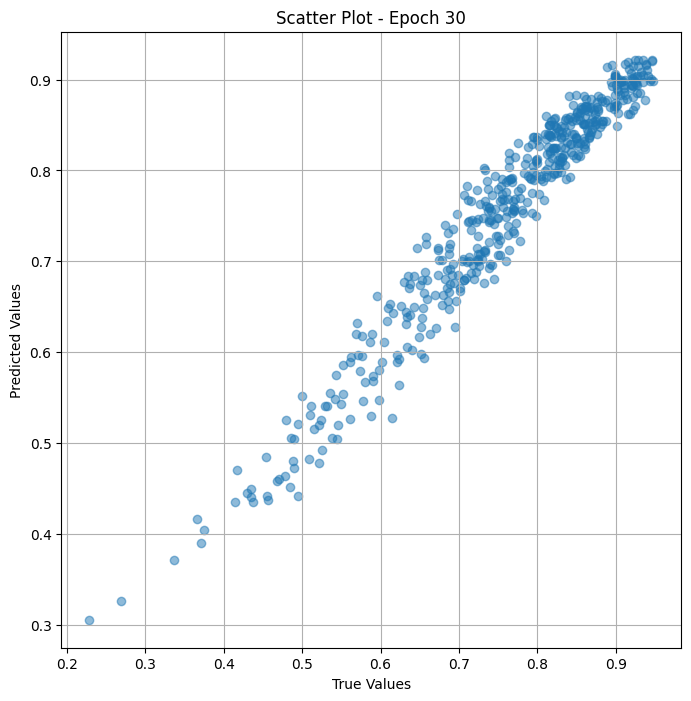

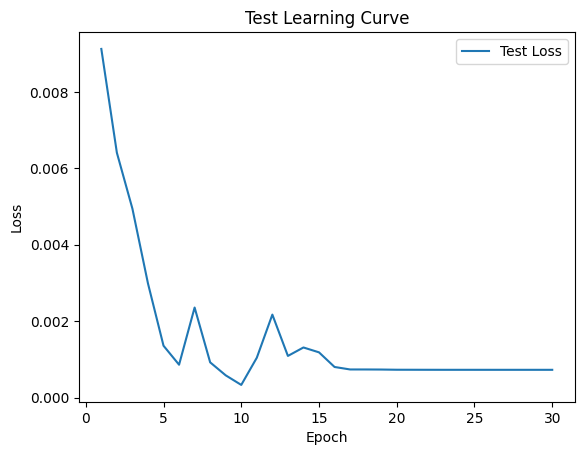


 Epoch: (31/50) Loss = 0.0007267251494340599

 Epoch: (31/50) Loss_rmse = 0.026957839727401733

 Epoch: (31/50) R^2 = 0.924999475479126

 Epoch: (31/50) MAE = 0.019364912062883377
Spearman correlation coefficient: SignificanceResult(statistic=0.9696298675080942, pvalue=1.7298881240280074e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

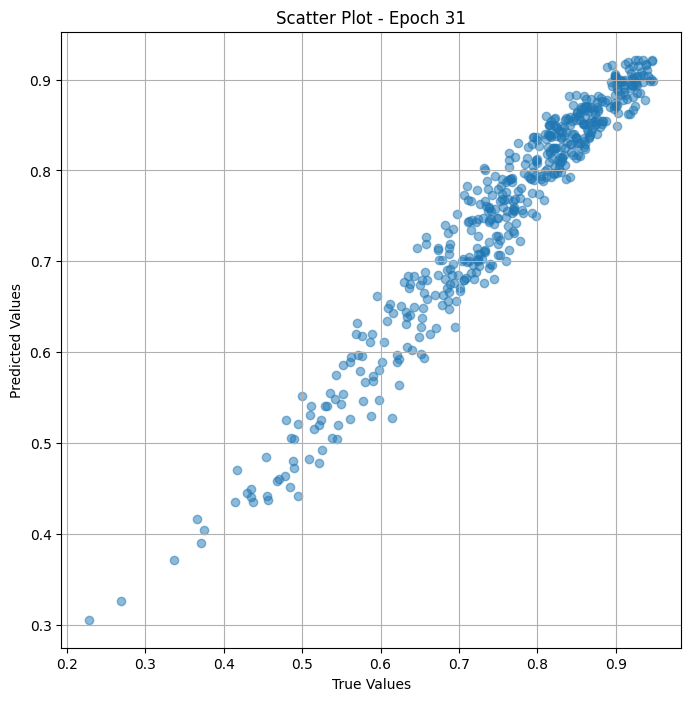

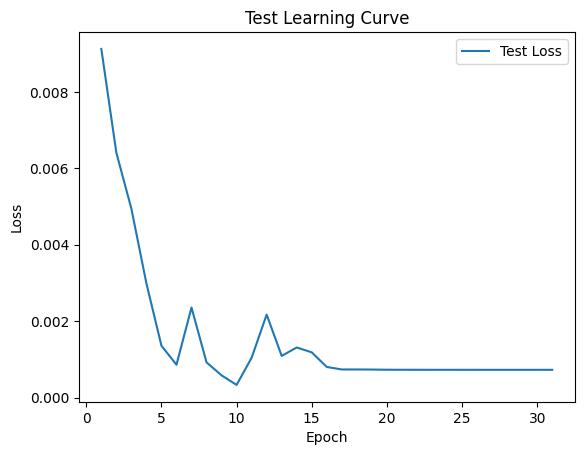


 Epoch: (32/50) Loss = 0.0007266854518093169

 Epoch: (32/50) Loss_rmse = 0.026957103982567787

 Epoch: (32/50) R^2 = 0.9250035285949707

 Epoch: (32/50) MAE = 0.01936550810933113
Spearman correlation coefficient: SignificanceResult(statistic=0.9696318206480352, pvalue=1.703901903783095e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

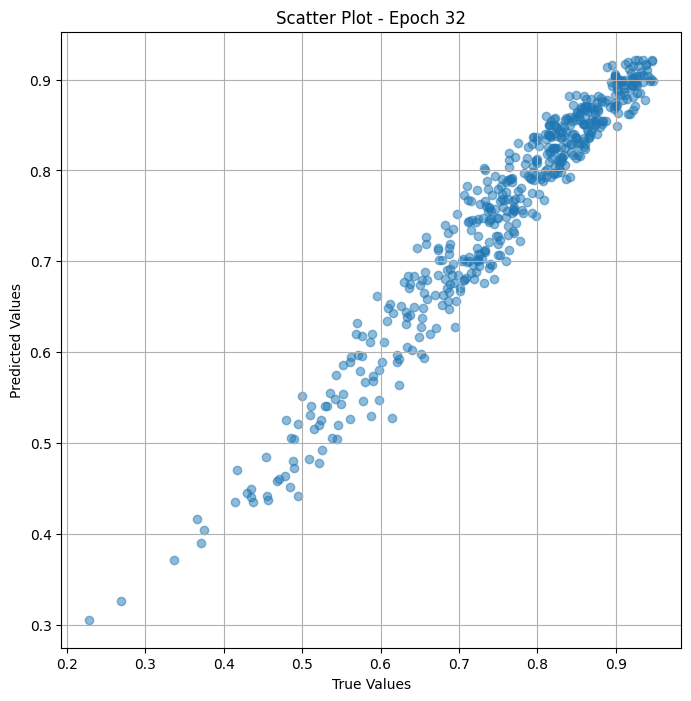

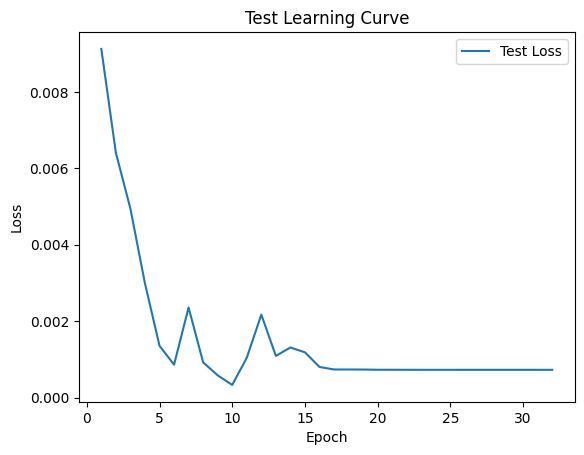


 Epoch: (33/50) Loss = 0.0007266437751241028

 Epoch: (33/50) Loss_rmse = 0.026956330984830856

 Epoch: (33/50) R^2 = 0.9250078797340393

 Epoch: (33/50) MAE = 0.01936611533164978
Spearman correlation coefficient: SignificanceResult(statistic=0.9696318206480352, pvalue=1.703901903783095e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

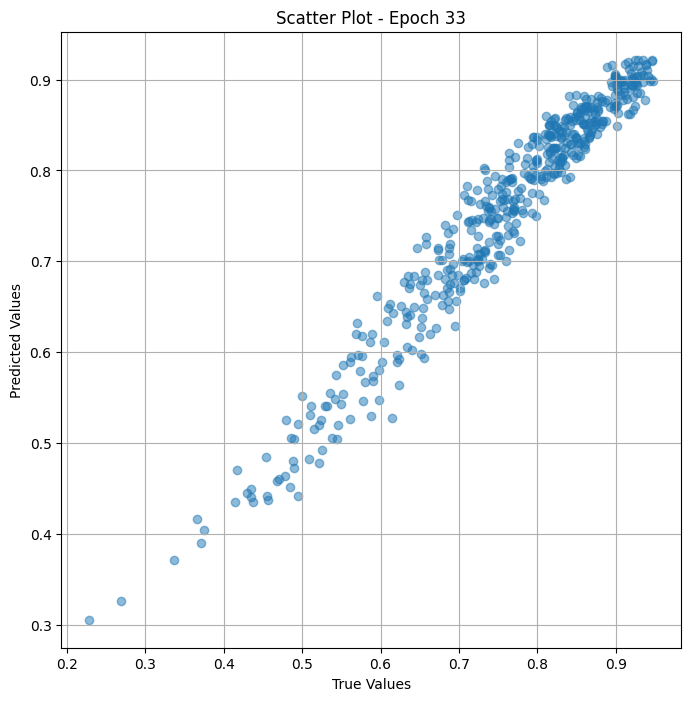

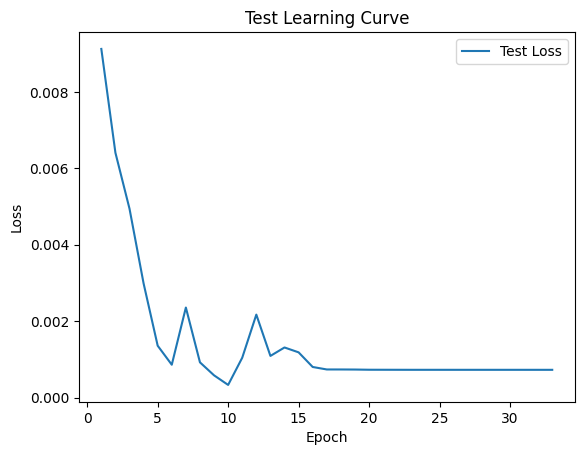


 Epoch: (34/50) Loss = 0.0007266021566465497

 Epoch: (34/50) Loss_rmse = 0.026955559849739075

 Epoch: (34/50) R^2 = 0.9250121712684631

 Epoch: (34/50) MAE = 0.019366765394806862
Spearman correlation coefficient: SignificanceResult(statistic=0.9696318206480352, pvalue=1.703901903783095e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

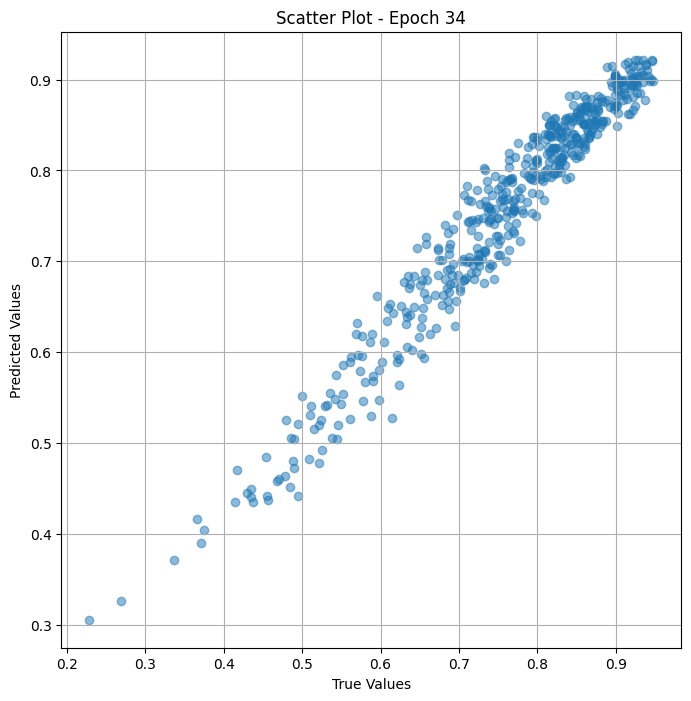

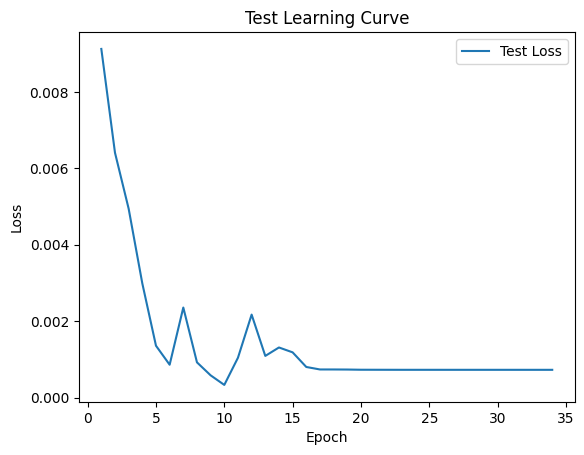


 Epoch: (35/50) Loss = 0.0007265591411851346

 Epoch: (35/50) Loss_rmse = 0.026954760774970055

 Epoch: (35/50) R^2 = 0.9250165820121765

 Epoch: (35/50) MAE = 0.019367391243577003
Spearman correlation coefficient: SignificanceResult(statistic=0.9696290536997855, pvalue=1.7408318312776508e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

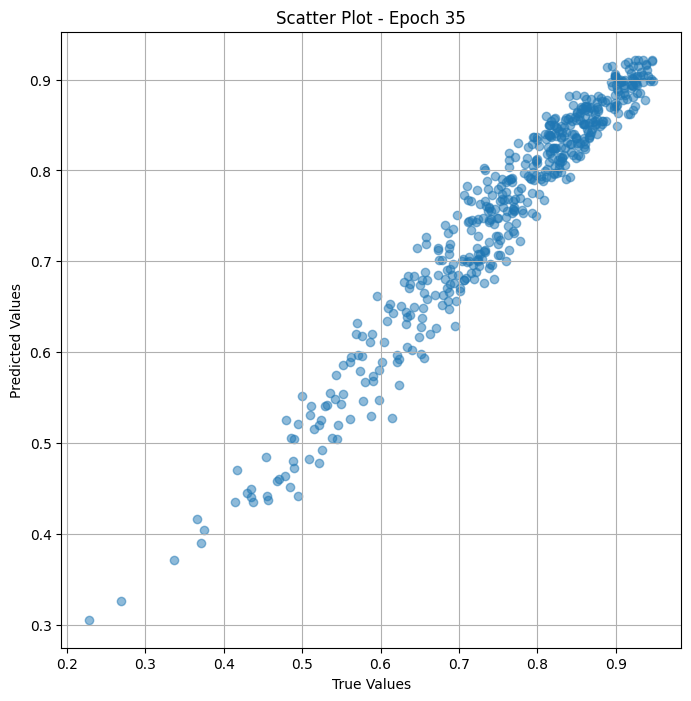

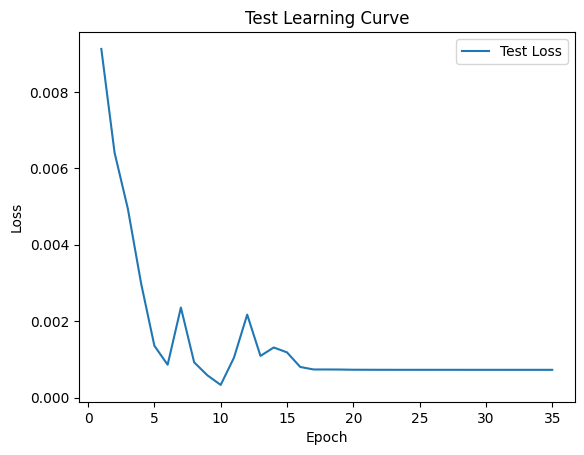


 Epoch: (36/50) Loss = 0.0007265139138326049

 Epoch: (36/50) Loss_rmse = 0.0269539225846529

 Epoch: (36/50) R^2 = 0.9250212907791138

 Epoch: (36/50) MAE = 0.0193680077791214
Spearman correlation coefficient: SignificanceResult(statistic=0.969627914368153, pvalue=1.7562689238520043e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

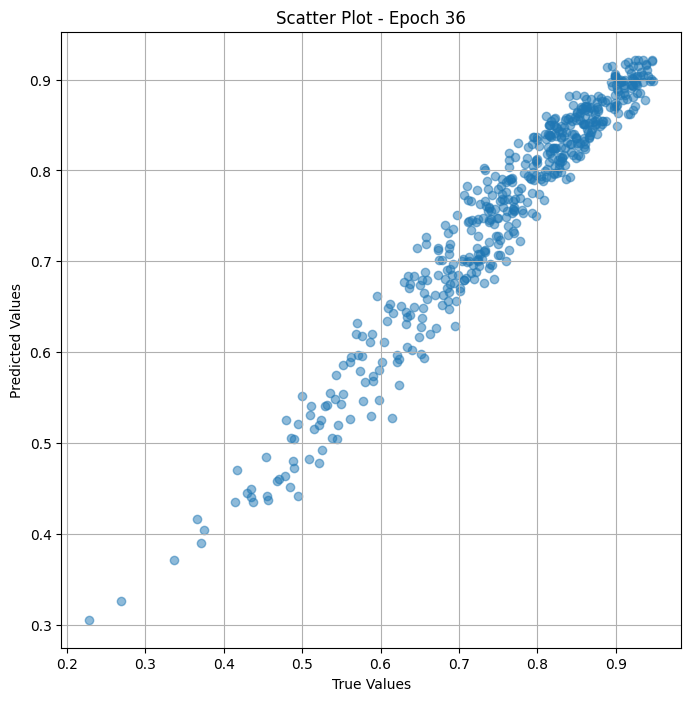

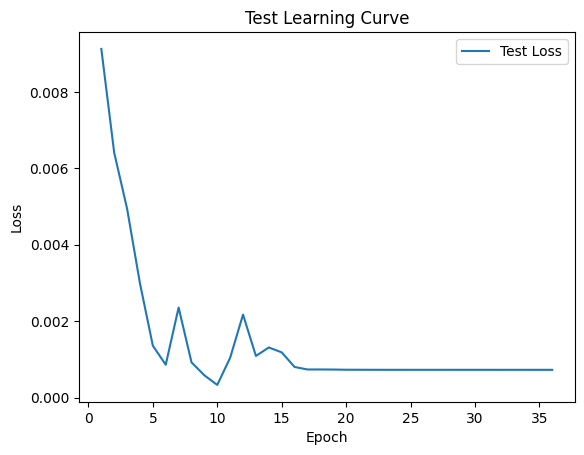


 Epoch: (37/50) Loss = 0.0007264686864800751

 Epoch: (37/50) Loss_rmse = 0.026953082531690598

 Epoch: (37/50) R^2 = 0.9250259399414062

 Epoch: (37/50) MAE = 0.019368628039956093
Spearman correlation coefficient: SignificanceResult(statistic=0.969627914368153, pvalue=1.7562689238520043e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

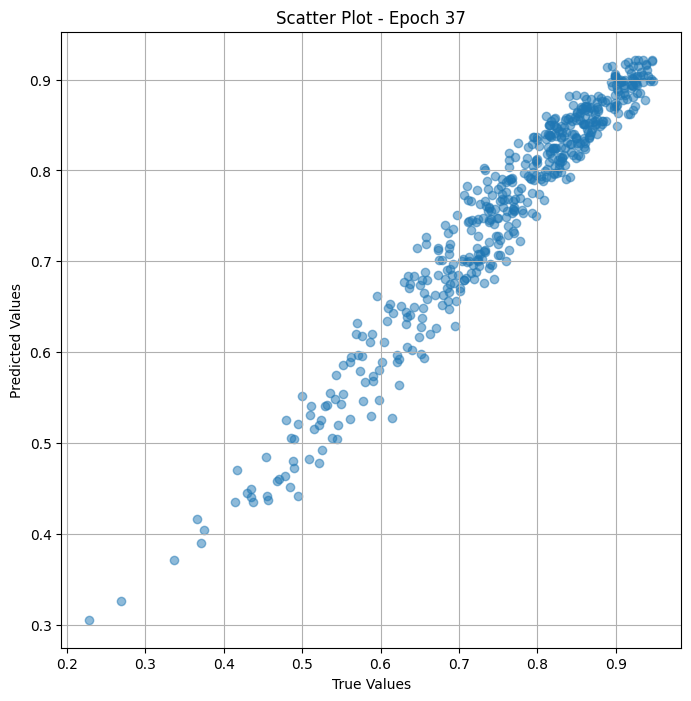

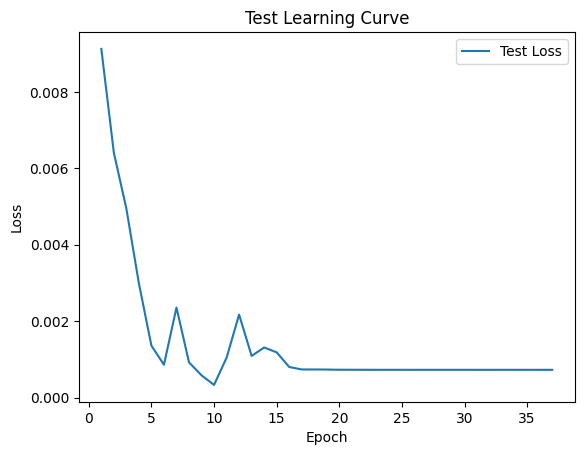


 Epoch: (38/50) Loss = 0.0007264199666678905

 Epoch: (38/50) Loss_rmse = 0.02695217914879322

 Epoch: (38/50) R^2 = 0.9250309467315674

 Epoch: (38/50) MAE = 0.019369233399629593
Spearman correlation coefficient: SignificanceResult(statistic=0.9696314951247116, pvalue=1.7082057896092342e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

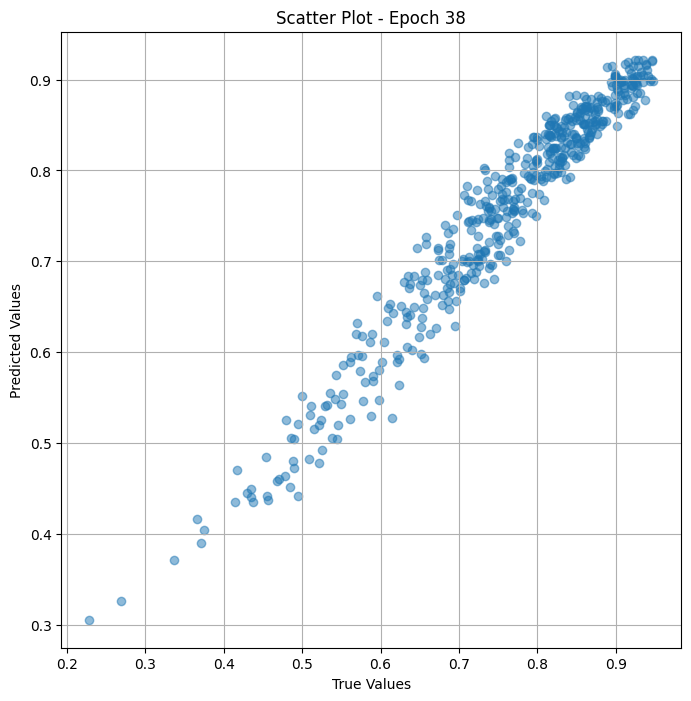

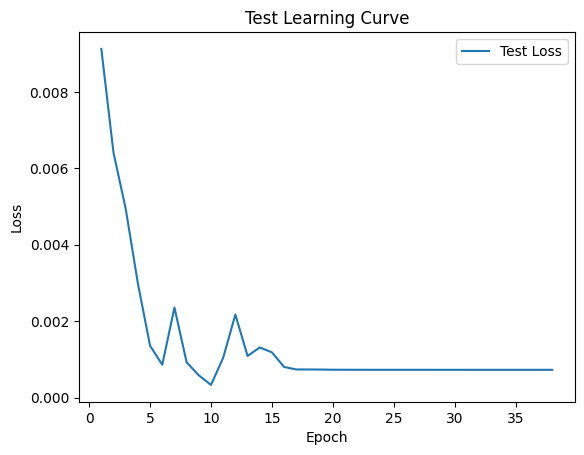


 Epoch: (39/50) Loss = 0.0007263720035552979

 Epoch: (39/50) Loss_rmse = 0.026951288804411888

 Epoch: (39/50) R^2 = 0.9250358939170837

 Epoch: (39/50) MAE = 0.019369883462786674
Spearman correlation coefficient: SignificanceResult(statistic=0.9696407725394315, pvalue=1.5896842670340904e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

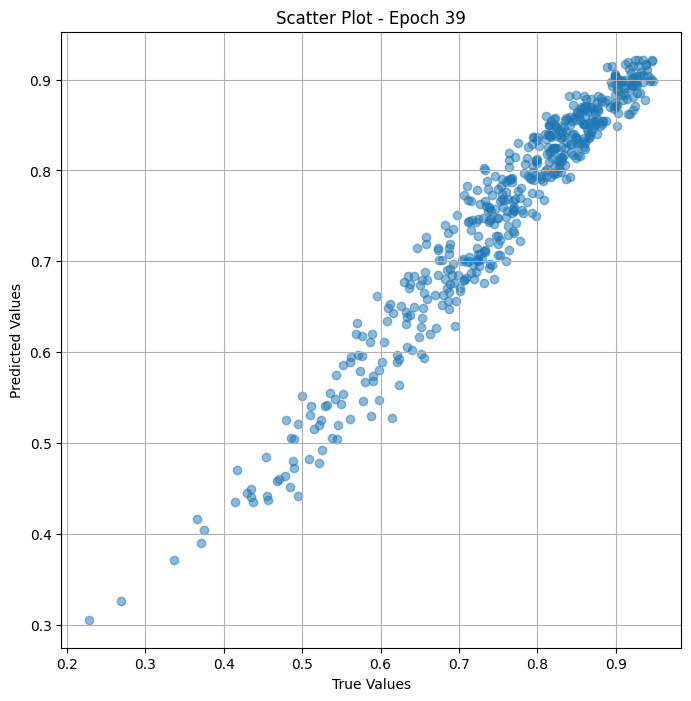

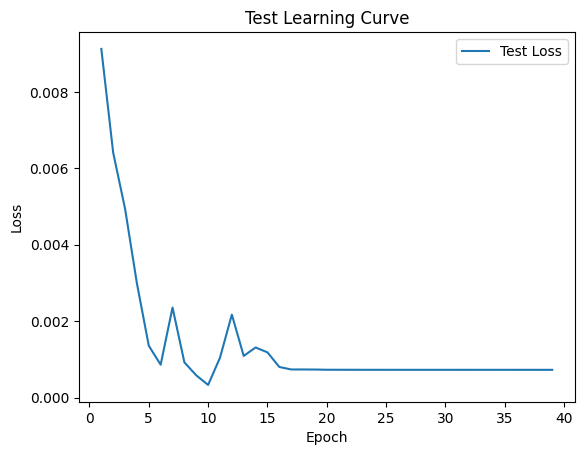


 Epoch: (40/50) Loss = 0.0007263219449669123

 Epoch: (40/50) Loss_rmse = 0.02695036120712757

 Epoch: (40/50) R^2 = 0.9250410795211792

 Epoch: (40/50) MAE = 0.01937050186097622
Spearman correlation coefficient: SignificanceResult(statistic=0.9696424544099362, pvalue=1.5690919114641364e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

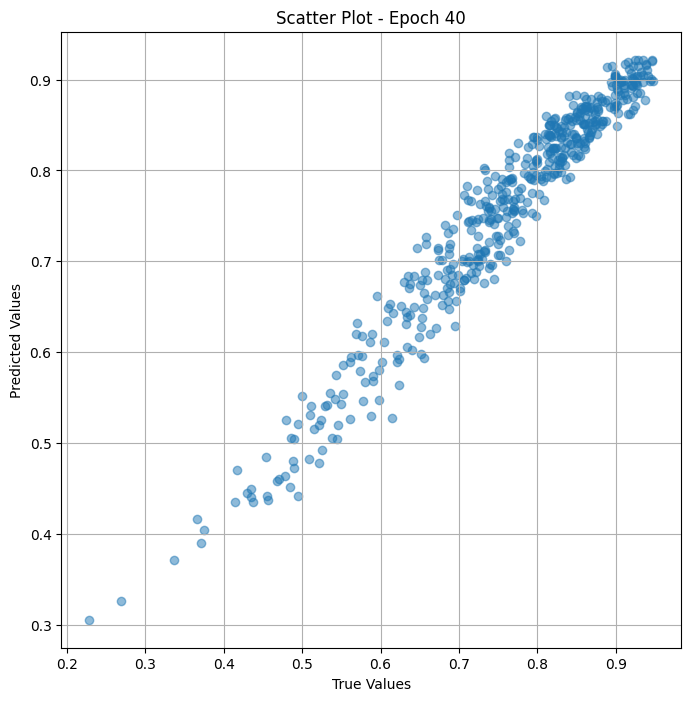

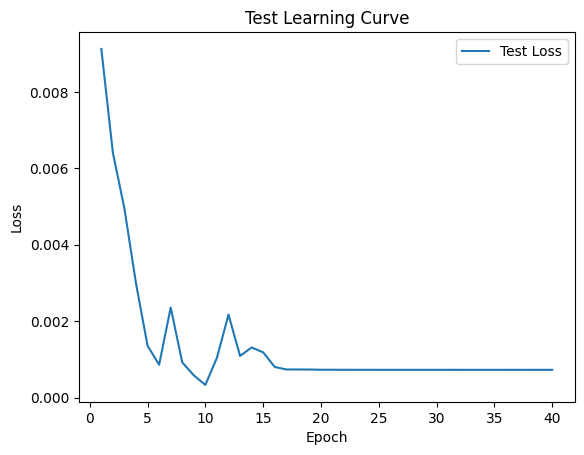


 Epoch: (41/50) Loss = 0.0007262721774168313

 Epoch: (41/50) Loss_rmse = 0.026949437335133553

 Epoch: (41/50) R^2 = 0.9250462055206299

 Epoch: (41/50) MAE = 0.01937115751206875
Spearman correlation coefficient: SignificanceResult(statistic=0.9696523828713032, pvalue=1.4528303977363612e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

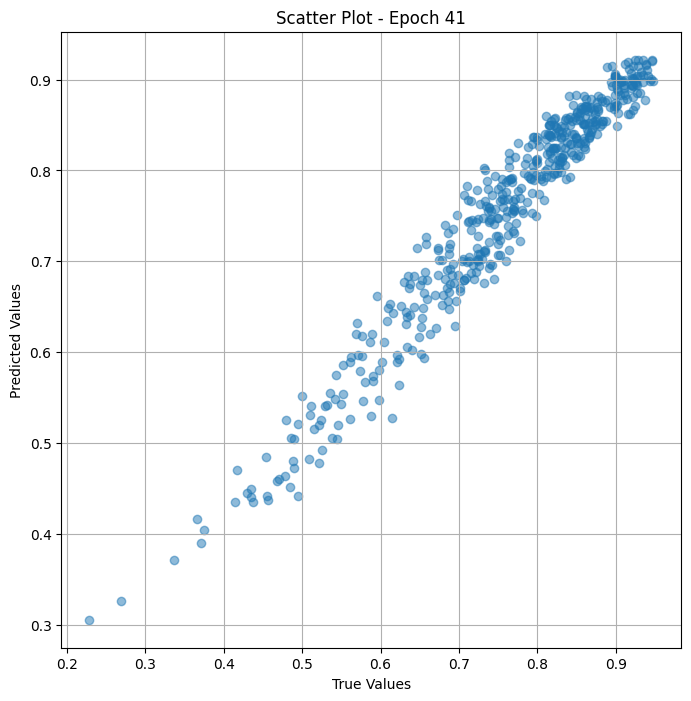

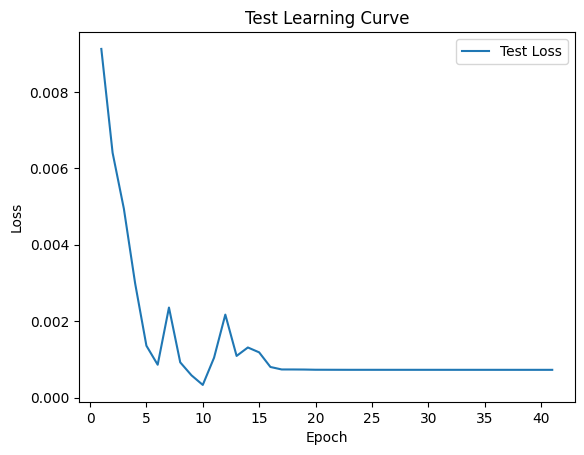


 Epoch: (42/50) Loss = 0.0007262193830683827

 Epoch: (42/50) Loss_rmse = 0.026948457583785057

 Epoch: (42/50) R^2 = 0.9250516891479492

 Epoch: (42/50) MAE = 0.019371777772903442
Spearman correlation coefficient: SignificanceResult(statistic=0.9696523828713032, pvalue=1.4528303977363612e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

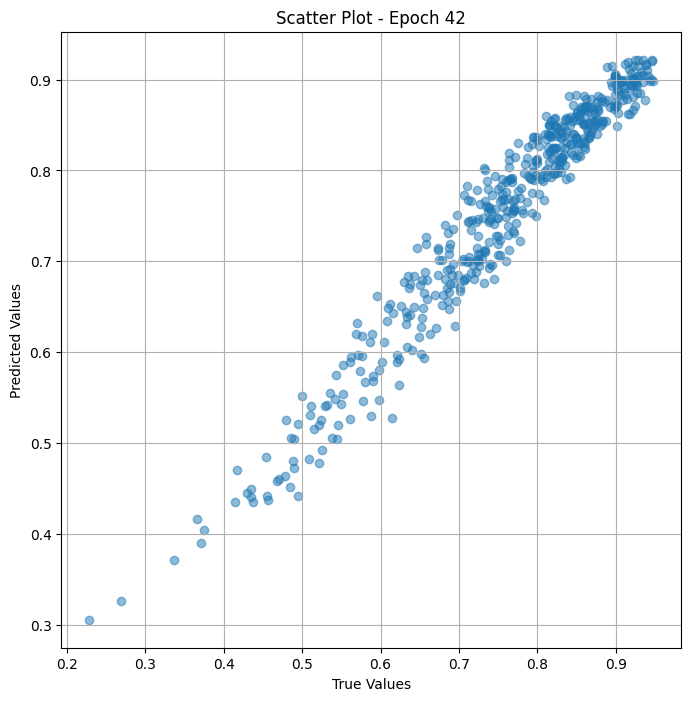

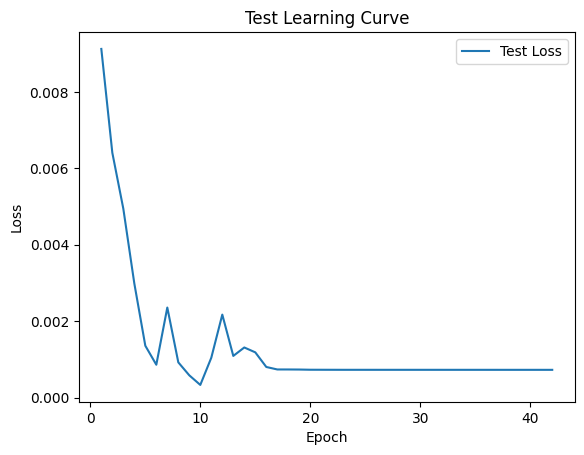


 Epoch: (43/50) Loss = 0.0007261655991896987

 Epoch: (43/50) Loss_rmse = 0.02694745920598507

 Epoch: (43/50) R^2 = 0.9250572323799133

 Epoch: (43/50) MAE = 0.01937238685786724
Spearman correlation coefficient: SignificanceResult(statistic=0.9696533586179753, pvalue=1.441878125560803e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942

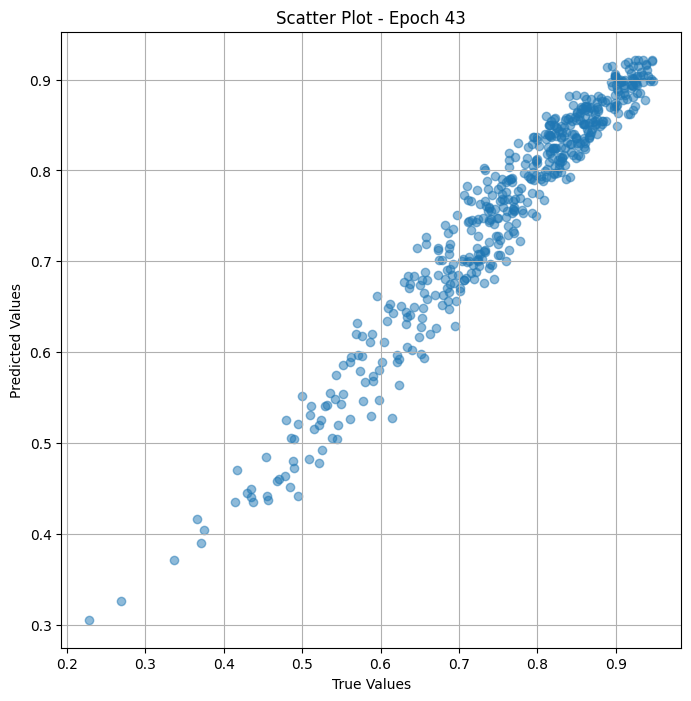

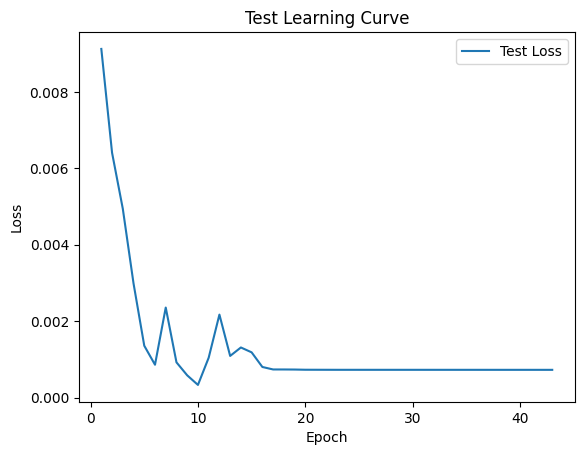


 Epoch: (44/50) Loss = 0.0007261101272888482

 Epoch: (44/50) Loss_rmse = 0.026946431025862694

 Epoch: (44/50) R^2 = 0.9250629544258118

 Epoch: (44/50) MAE = 0.019373005256056786
Spearman correlation coefficient: SignificanceResult(statistic=0.9696542817573568, pvalue=1.4315920360682603e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

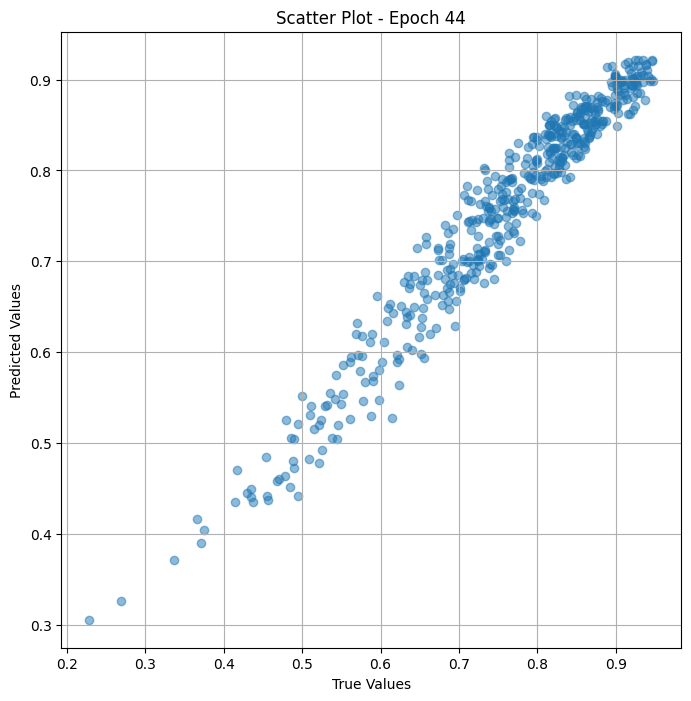

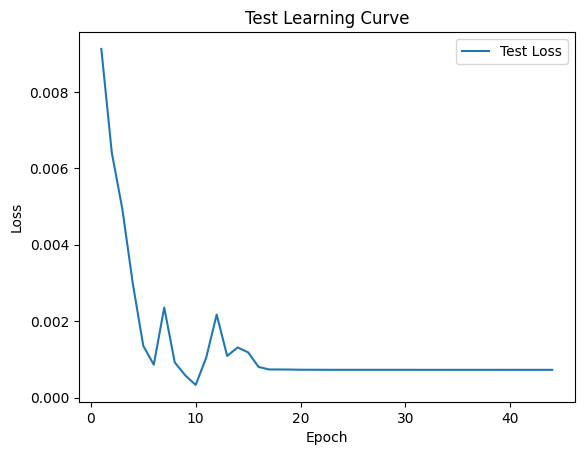


 Epoch: (45/50) Loss = 0.0007260543643496931

 Epoch: (45/50) Loss_rmse = 0.02694539539515972

 Epoch: (45/50) R^2 = 0.9250686764717102

 Epoch: (45/50) MAE = 0.019373631104826927
Spearman correlation coefficient: SignificanceResult(statistic=0.9696605209543908, pvalue=1.3639616239915878e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

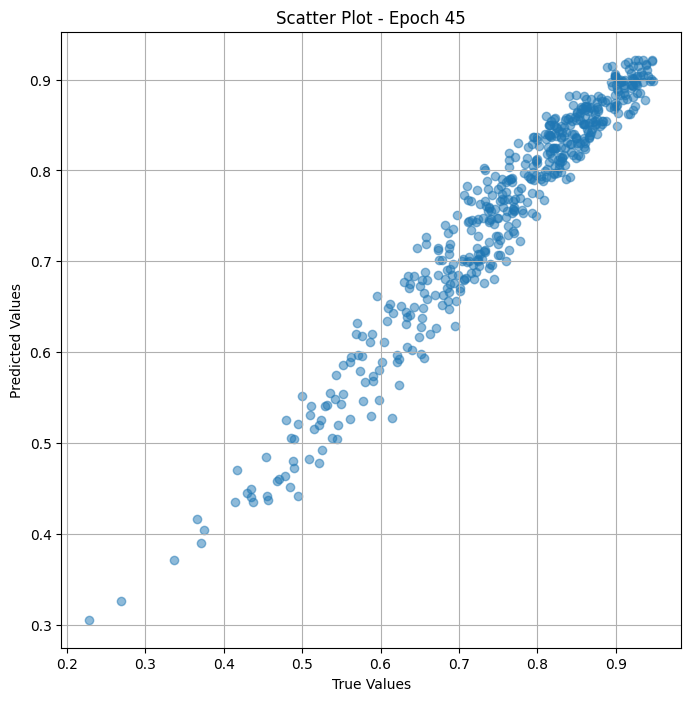

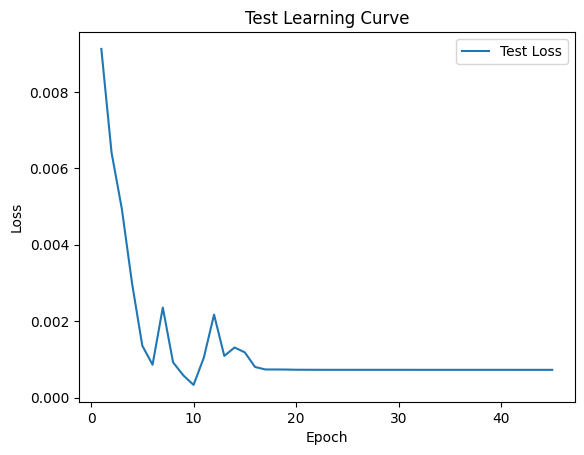


 Epoch: (46/50) Loss = 0.0007259959238581359

 Epoch: (46/50) Loss_rmse = 0.02694431133568287

 Epoch: (46/50) R^2 = 0.9250746965408325

 Epoch: (46/50) MAE = 0.019374249503016472
Spearman correlation coefficient: SignificanceResult(statistic=0.9696605209543908, pvalue=1.3639616239915878e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

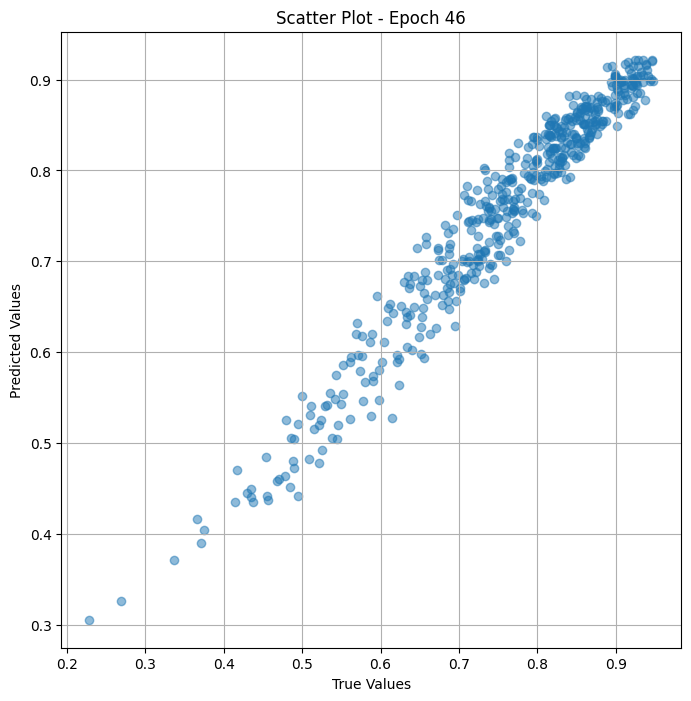

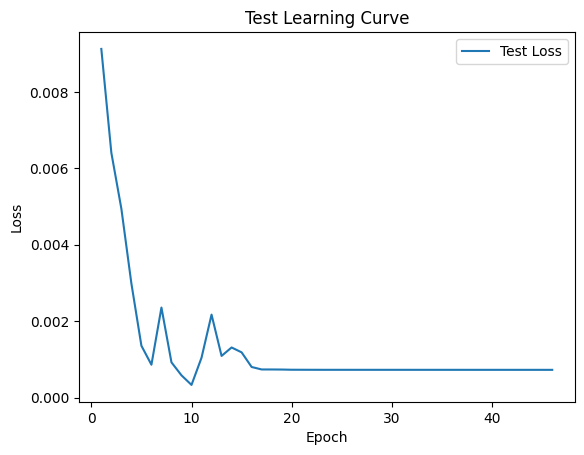


 Epoch: (47/50) Loss = 0.0007259362027980387

 Epoch: (47/50) Loss_rmse = 0.026943203061819077

 Epoch: (47/50) R^2 = 0.9250808954238892

 Epoch: (47/50) MAE = 0.019374845549464226
Spearman correlation coefficient: SignificanceResult(statistic=0.9696660548508904, pvalue=1.3066437738665177e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

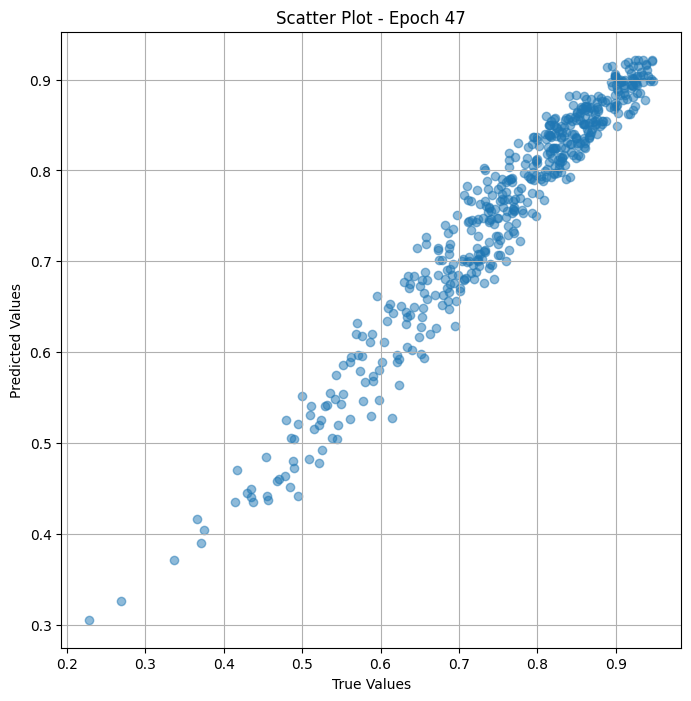

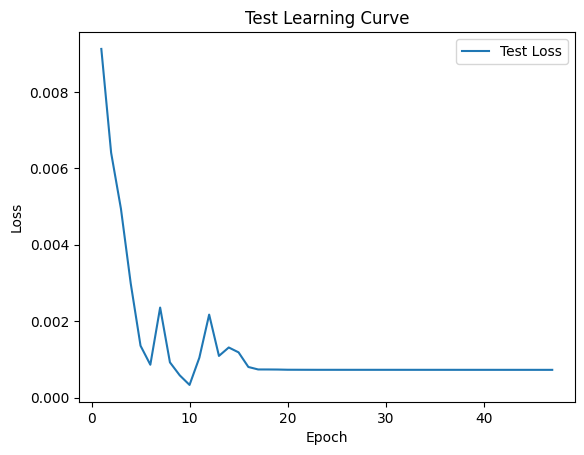


 Epoch: (48/50) Loss = 0.0007258752593770623

 Epoch: (48/50) Loss_rmse = 0.026942072436213493

 Epoch: (48/50) R^2 = 0.9250871539115906

 Epoch: (48/50) MAE = 0.019375456497073174
Spearman correlation coefficient: SignificanceResult(statistic=0.9696660548508904, pvalue=1.3066437738665177e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

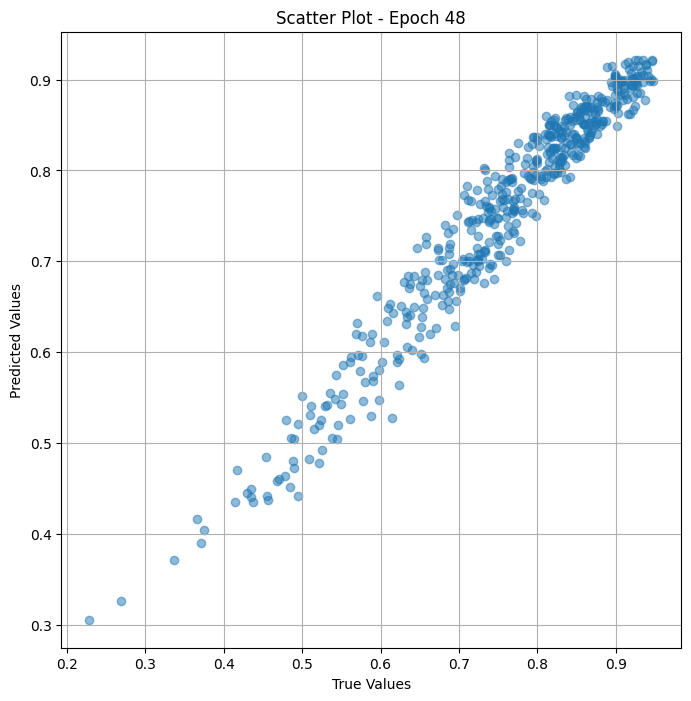

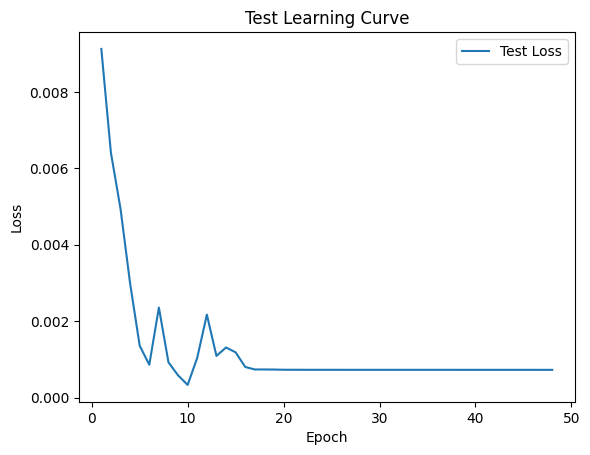


 Epoch: (49/50) Loss = 0.000725813617464155

 Epoch: (49/50) Loss_rmse = 0.026940928772091866

 Epoch: (49/50) R^2 = 0.9250935316085815

 Epoch: (49/50) MAE = 0.019376058131456375
Spearman correlation coefficient: SignificanceResult(statistic=0.969667519705846, pvalue=1.2918770932891037e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

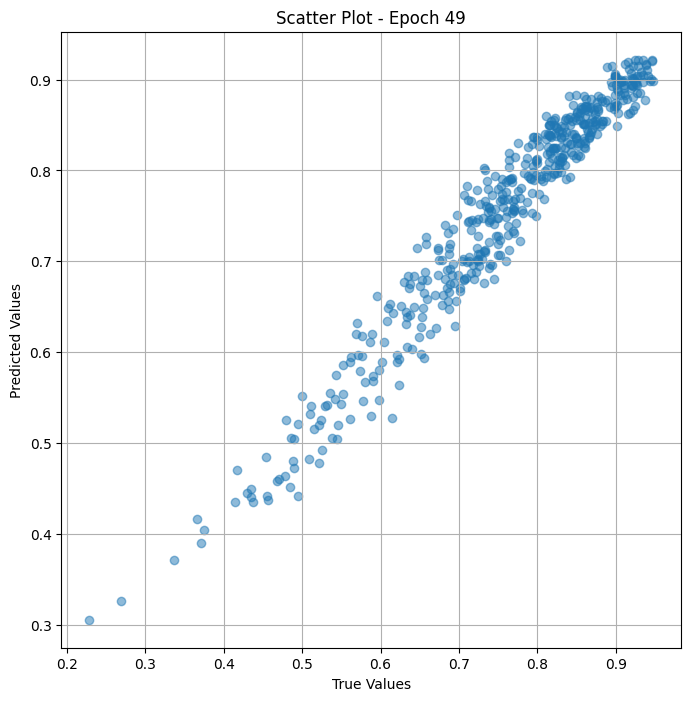

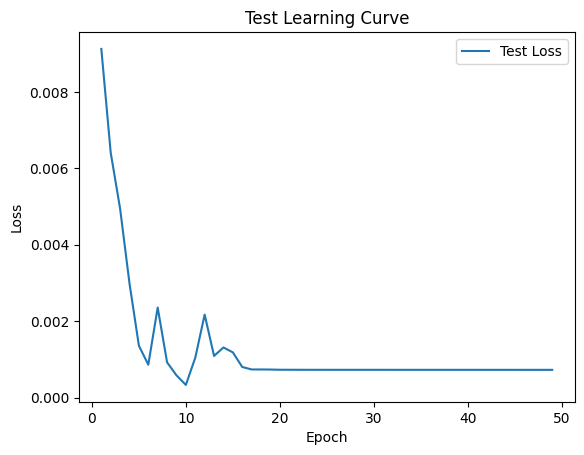


 Epoch: (50/50) Loss = 0.0007257515098899603

 Epoch: (50/50) Loss_rmse = 0.02693977579474449

 Epoch: (50/50) R^2 = 0.9250999689102173

 Epoch: (50/50) MAE = 0.019376685842871666
Spearman correlation coefficient: SignificanceResult(statistic=0.969667519705846, pvalue=1.2918770932891037e-294)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

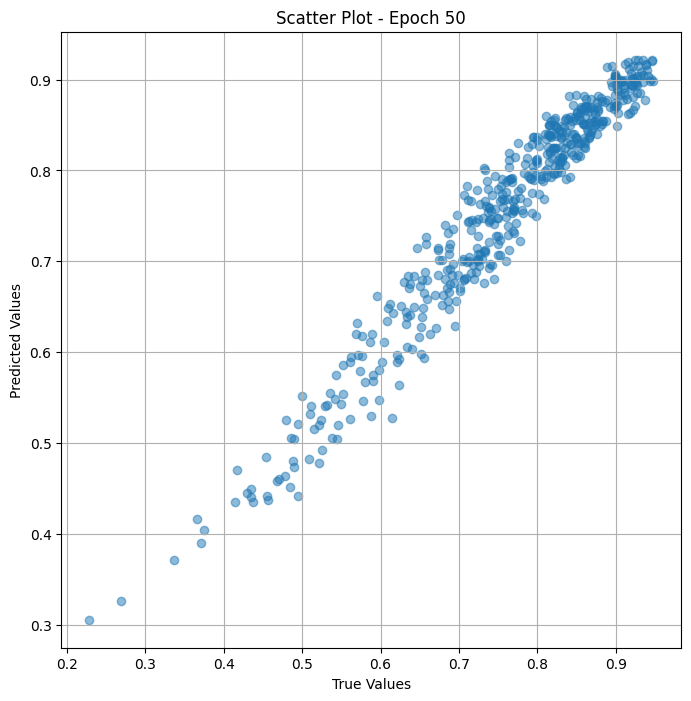

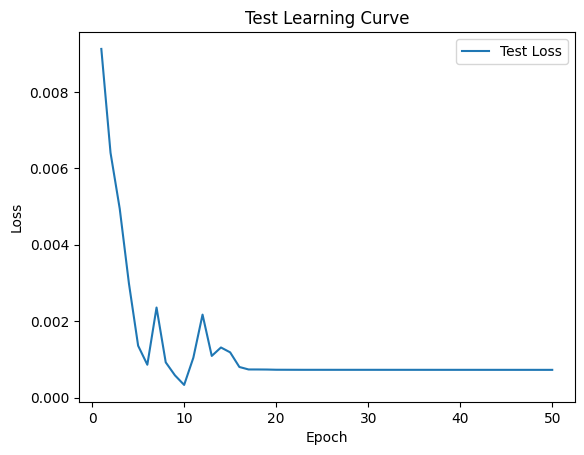

In [ ]:
# val the model and save weights
fit(50, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_merge' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_merge['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                            Image Path  True Value  \
0       /content/merged/n02332755_342_preprocessed.jpg    0.830357   
1    /content/merged/6bfa7b57d0deb743_preprocessed.jpg    0.370787   
2    /content/merged/8ec8d873e23d2435_preprocessed.jpg    0.840909   
3     /content/merged/n03670208_41966_preprocessed.jpg    0.921348   
4        /content/merged/000000233169_preprocessed.jpg    0.940000   
..                                                 ...         ...   
495      /content/merged/000000124462_preprocessed.jpg    0.923077   
496  /content/merged/sun_awesiopwrhjoojme_preproces...    0.637255   
497      /content/merged/000000259491_preprocessed.jpg    0.682243   
498      /content/merged/000000420002_preprocessed.jpg    0.766667   
499      /content/merged/000000076372_preprocessed.jpg    0.760417   

     Predicted Value  
0           0.792518  
1           0.636956  
2           0.843079  
3           0.860347  
4           0.921039  
..               ... 

#Finetuning

##Train

In [ ]:
class Dataset_train_fine_merge(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_merge["memoscore"]
        self.images = df_train_merge["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine_merge(df_train_merge, trans_transform=trans_transform)
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)



/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
class ViTMem_model_fine_merge(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_fine =  ViTMem_model_fine_merge( arch="vit_base_patch16_224_miil")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_vit_fine  = to_device(model_vit_fine  , device)

In [ ]:
params = [param for param in list(model_vit_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_fine, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.0024548012297600508

 Epoch: (1/30) Loss_rmse = 0.049545951187610626

 Epoch: (1/30) R^2 = 0.8904795050621033

 Epoch: (1/30) MAE = 0.04385305941104889
Spearman correlation coefficient: SignificanceResult(statistic=0.686948058139651, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

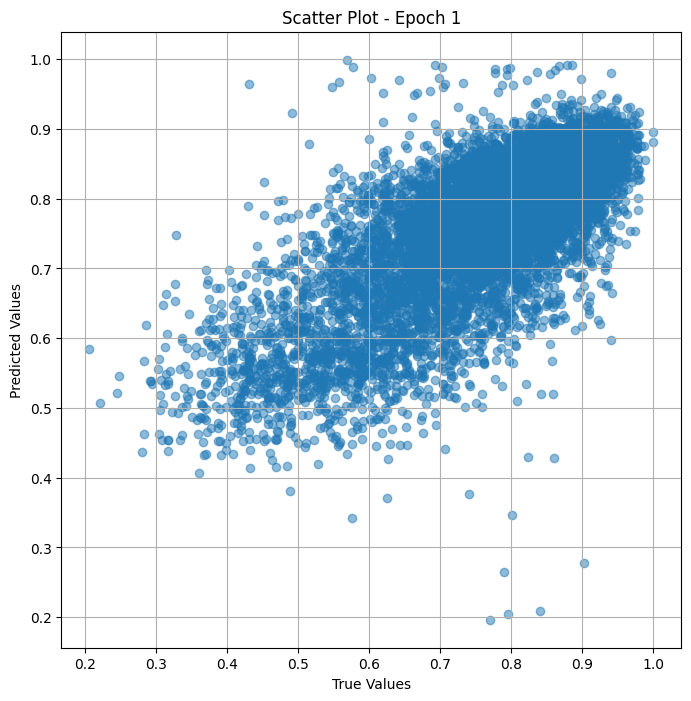

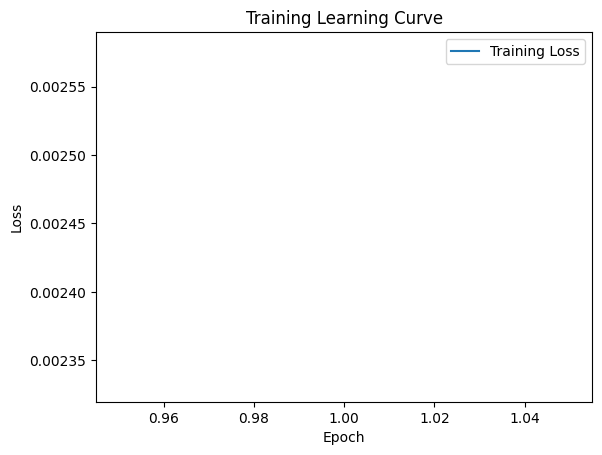


 Epoch: (2/30) Loss = 0.002018272178247571

 Epoch: (2/30) Loss_rmse = 0.044925183057785034

 Epoch: (2/30) R^2 = 0.9099552035331726

 Epoch: (2/30) MAE = 0.039338063448667526
Spearman correlation coefficient: SignificanceResult(statistic=0.8166921460696338, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.8

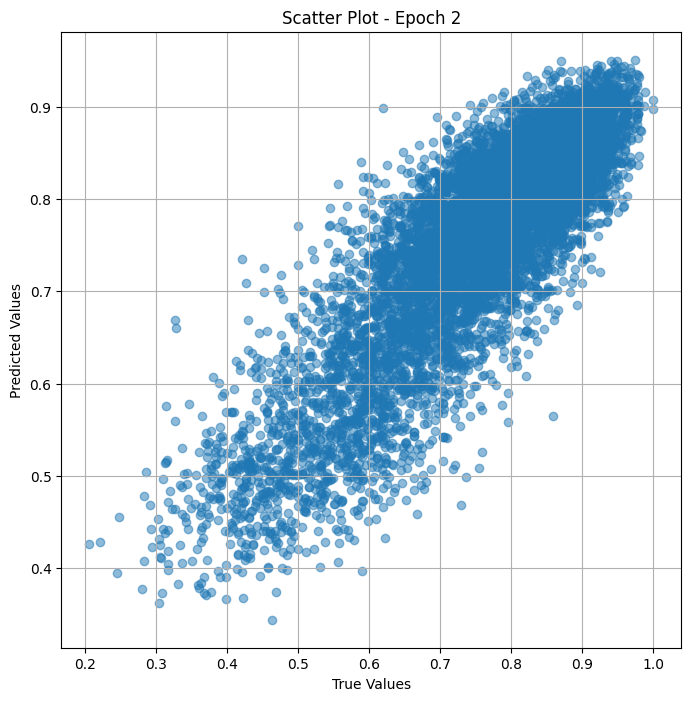

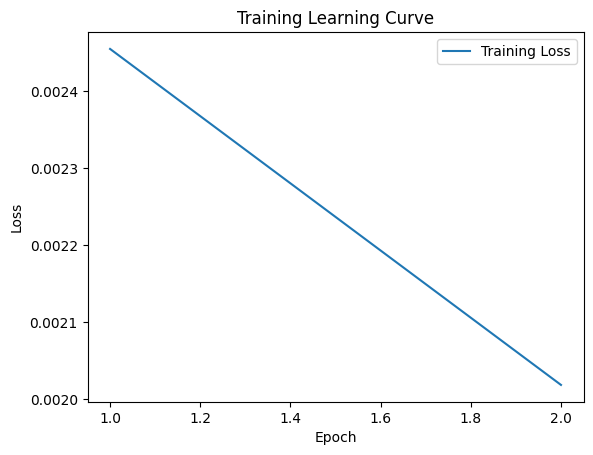


 Epoch: (3/30) Loss = 0.003608903381973505

 Epoch: (3/30) Loss_rmse = 0.06007415056228638

 Epoch: (3/30) R^2 = 0.8389894962310791

 Epoch: (3/30) MAE = 0.039409421384334564
Spearman correlation coefficient: SignificanceResult(statistic=0.8687480852061785, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

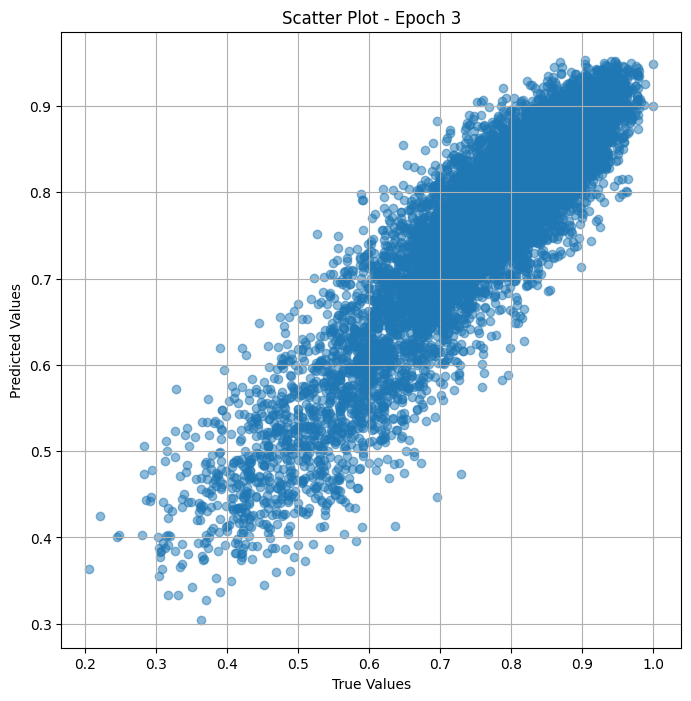

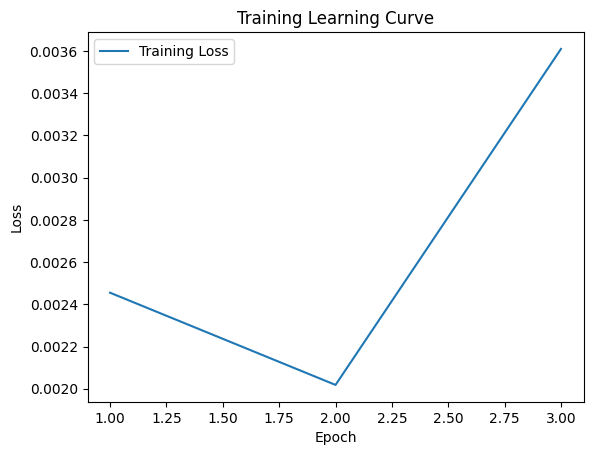


 Epoch: (4/30) Loss = 0.0014549829065799713

 Epoch: (4/30) Loss_rmse = 0.03814423829317093

 Epoch: (4/30) R^2 = 0.9350862503051758

 Epoch: (4/30) MAE = 0.03478598594665527
Spearman correlation coefficient: SignificanceResult(statistic=0.8912951377315309, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

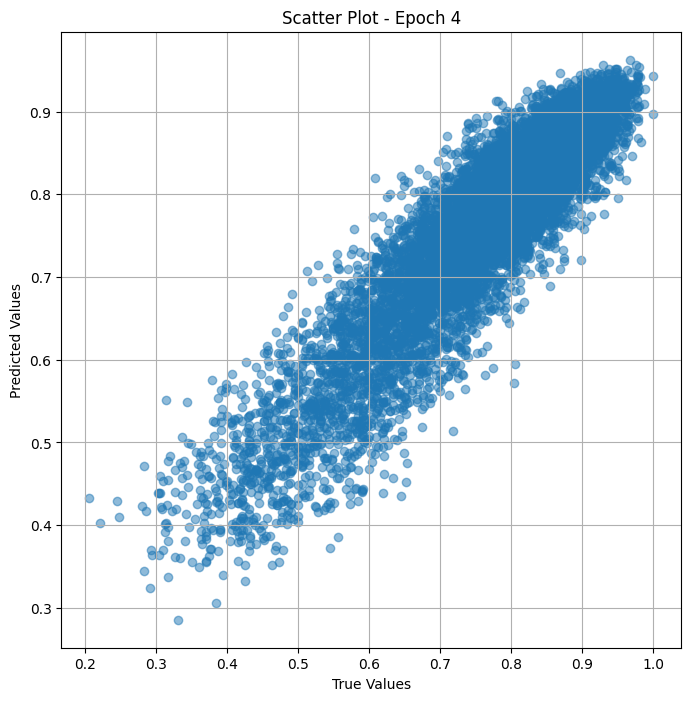

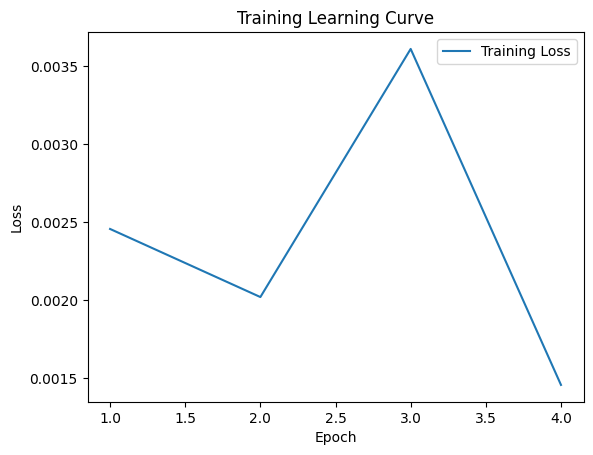


 Epoch: (5/30) Loss = 0.0018279998330399394

 Epoch: (5/30) Loss_rmse = 0.042755115777254105

 Epoch: (5/30) R^2 = 0.9184441566467285

 Epoch: (5/30) MAE = 0.033498942852020264
Spearman correlation coefficient: SignificanceResult(statistic=0.9118746327342068, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.

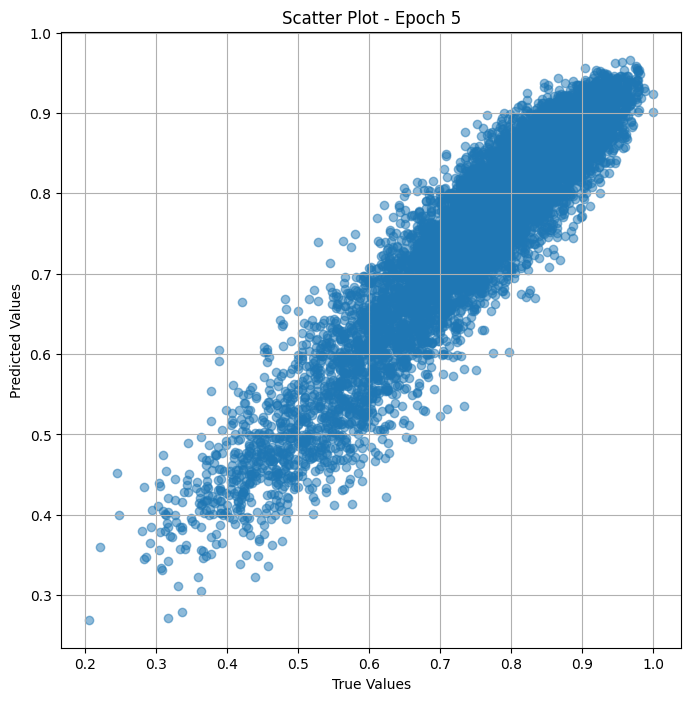

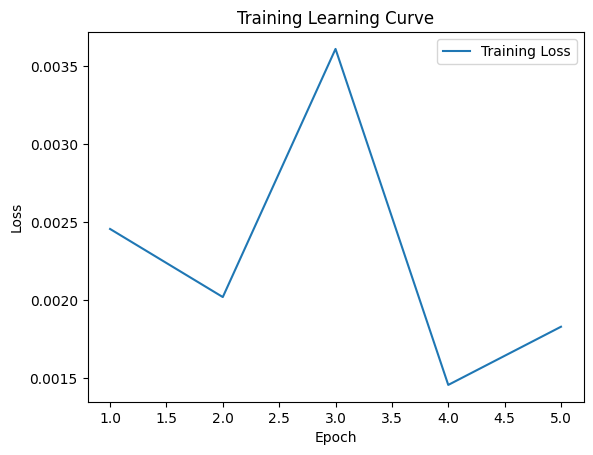


 Epoch: (6/30) Loss = 0.0017388468841090798

 Epoch: (6/30) Loss_rmse = 0.04169948399066925

 Epoch: (6/30) R^2 = 0.9224216938018799

 Epoch: (6/30) MAE = 0.02968134731054306
Spearman correlation coefficient: SignificanceResult(statistic=0.9329835688461899, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

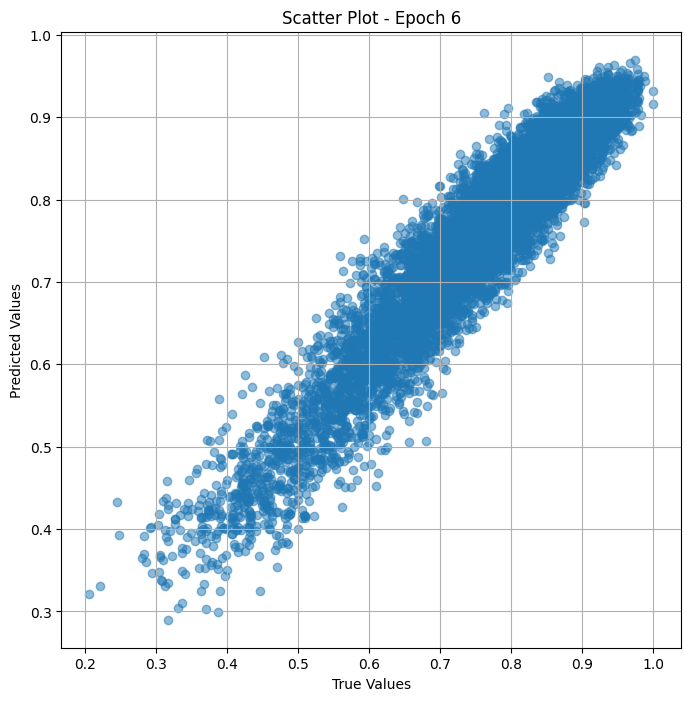

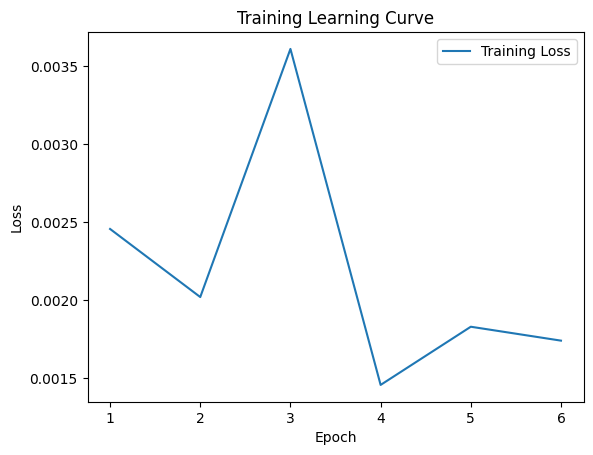

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/30) Loss = 0.001611007610335946

 Epoch: (7/30) Loss_rmse = 0.040137358009815216

 Epoch: (7/30) R^2 = 0.9281252026557922

 Epoch: (7/30) MAE = 0.03381824493408203
Spearman correlation coefficient: SignificanceResult(statistic=0.9566897599096665, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 

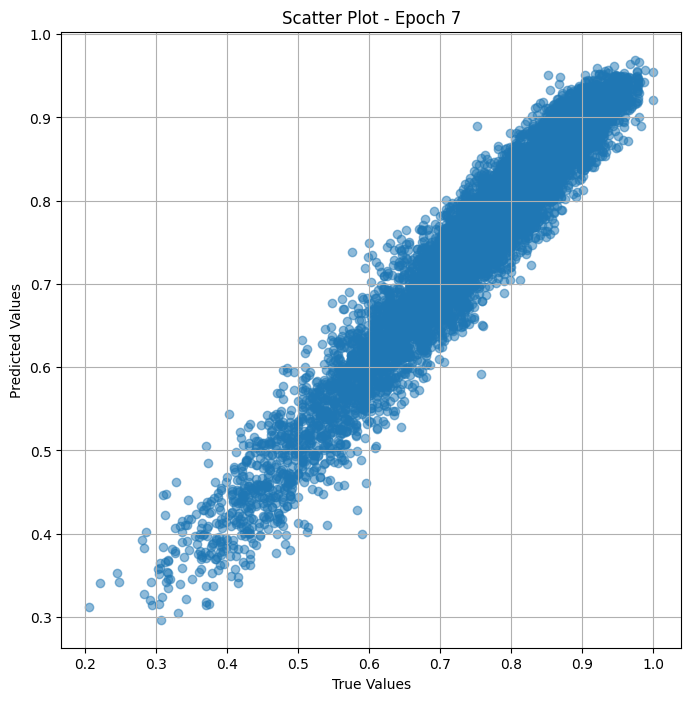

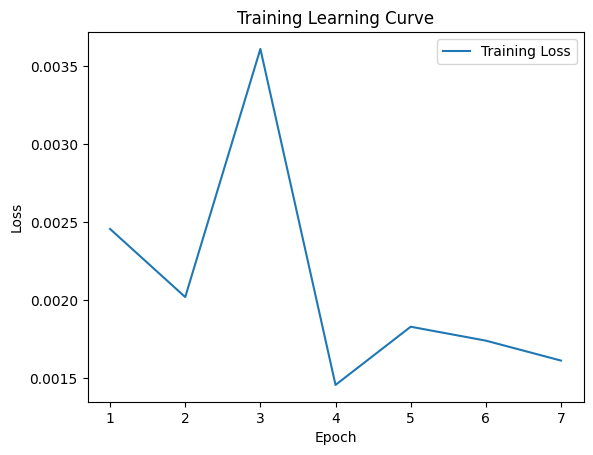


 Epoch: (8/30) Loss = 0.000799945613835007

 Epoch: (8/30) Loss_rmse = 0.028283309191465378

 Epoch: (8/30) R^2 = 0.9643105864524841

 Epoch: (8/30) MAE = 0.02186538279056549
Spearman correlation coefficient: SignificanceResult(statistic=0.9735891988693931, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.86

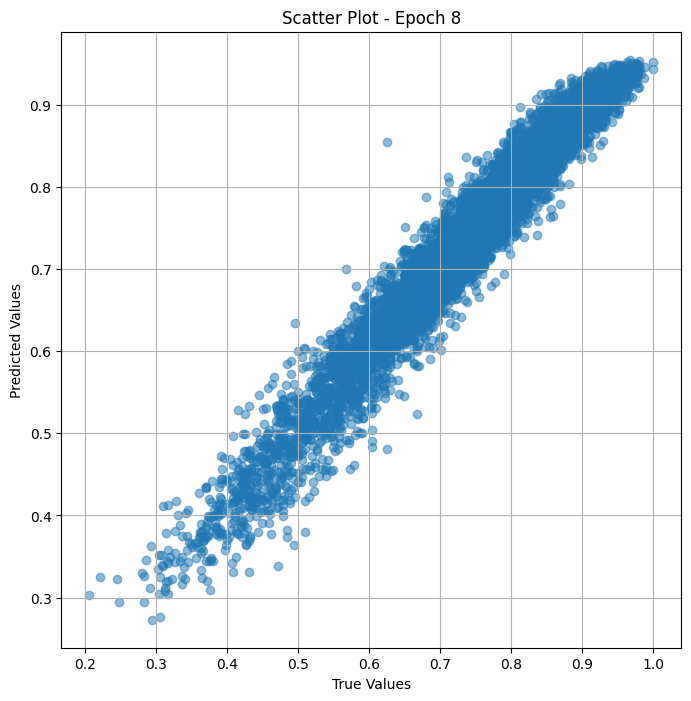

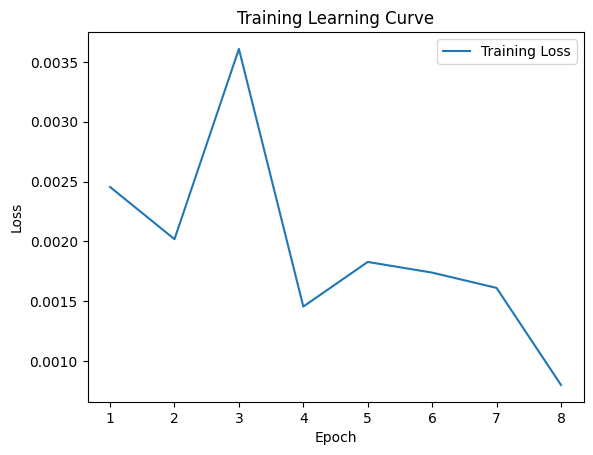


 Epoch: (9/30) Loss = 0.0005312673165462911

 Epoch: (9/30) Loss_rmse = 0.023049237206578255

 Epoch: (9/30) R^2 = 0.9762976169586182

 Epoch: (9/30) MAE = 0.018097124993801117
Spearman correlation coefficient: SignificanceResult(statistic=0.9817644416796969, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 0.

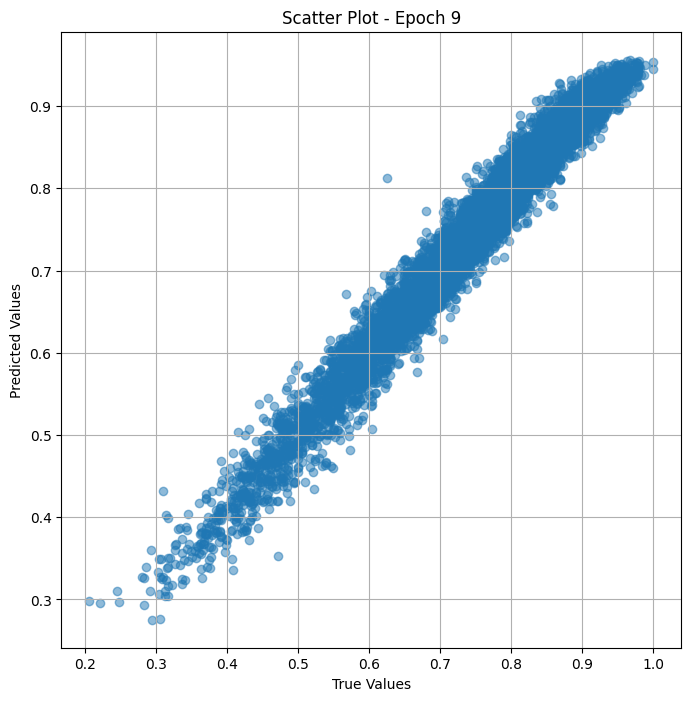

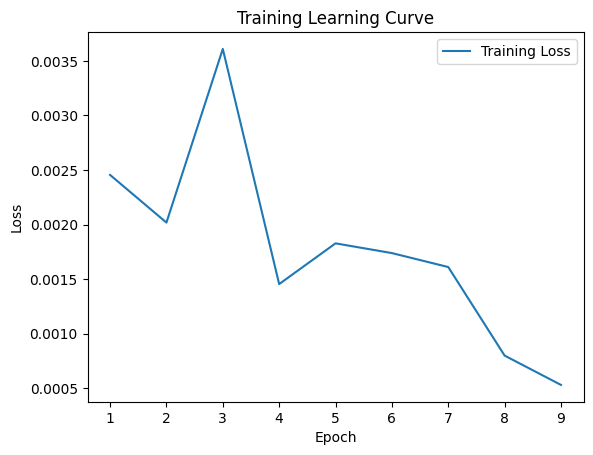


 Epoch: (10/30) Loss = 0.00038817519089207053

 Epoch: (10/30) Loss_rmse = 0.019702162593603134

 Epoch: (10/30) R^2 = 0.9826816320419312

 Epoch: (10/30) MAE = 0.015527546405792236
Spearman correlation coefficient: SignificanceResult(statistic=0.9857712316481704, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

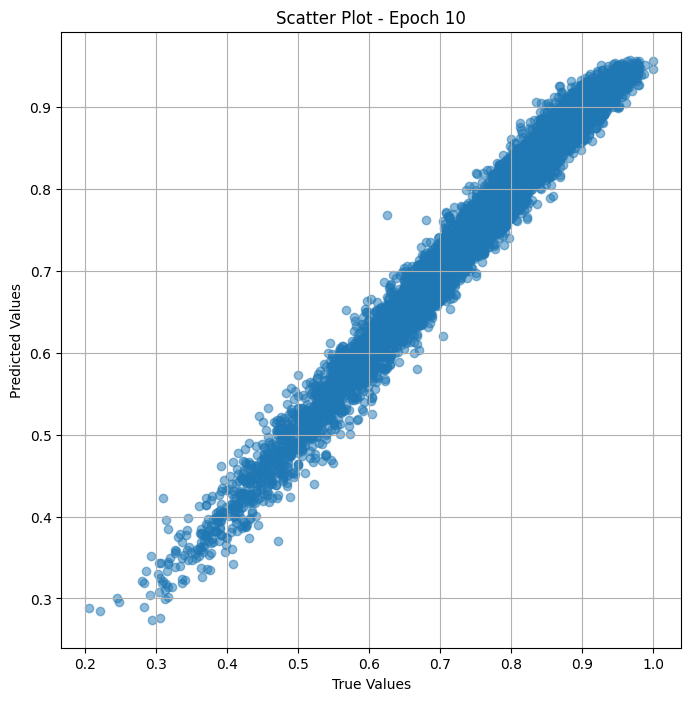

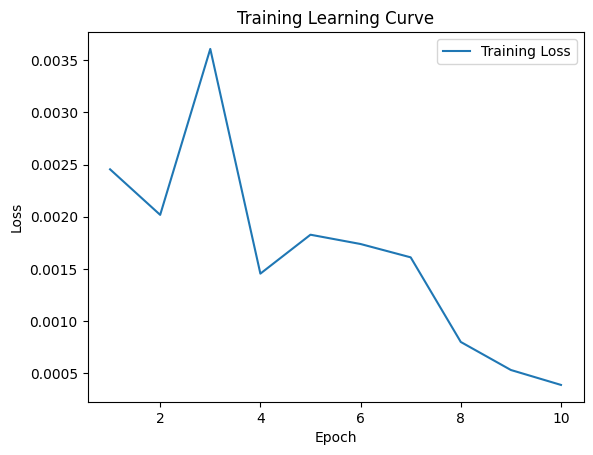


 Epoch: (11/30) Loss = 0.00028497035964392126

 Epoch: (11/30) Loss_rmse = 0.01688106544315815

 Epoch: (11/30) R^2 = 0.9872860908508301

 Epoch: (11/30) MAE = 0.013291053473949432
Spearman correlation coefficient: SignificanceResult(statistic=0.9888598500011725, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

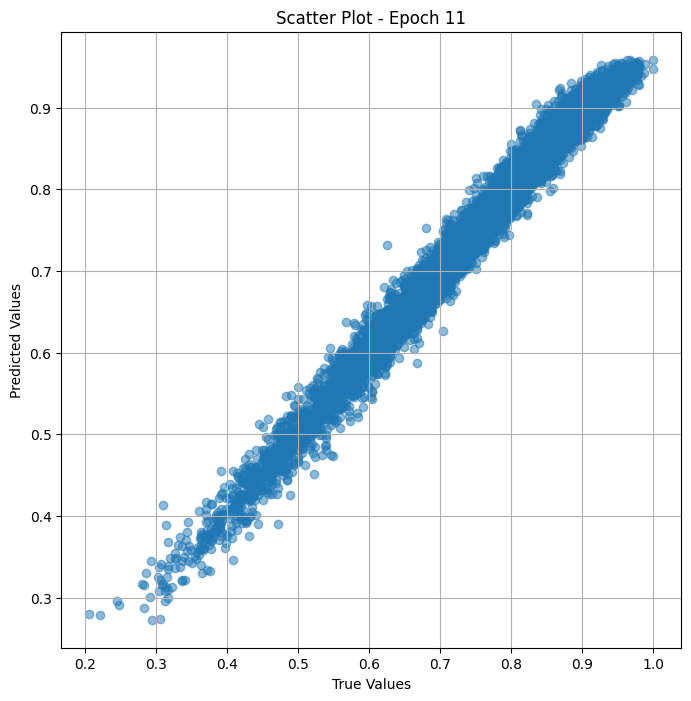

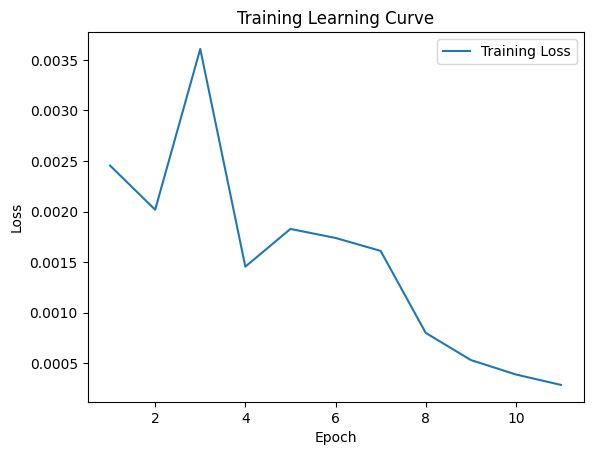


 Epoch: (12/30) Loss = 0.00021319679217413068

 Epoch: (12/30) Loss_rmse = 0.014601259492337704

 Epoch: (12/30) R^2 = 0.9904882907867432

 Epoch: (12/30) MAE = 0.011498719453811646
Spearman correlation coefficient: SignificanceResult(statistic=0.9913284084951899, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

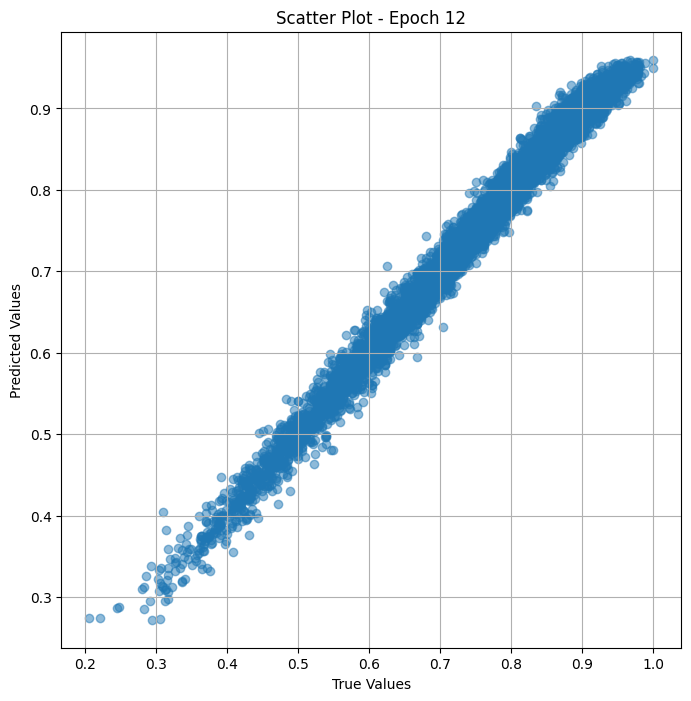

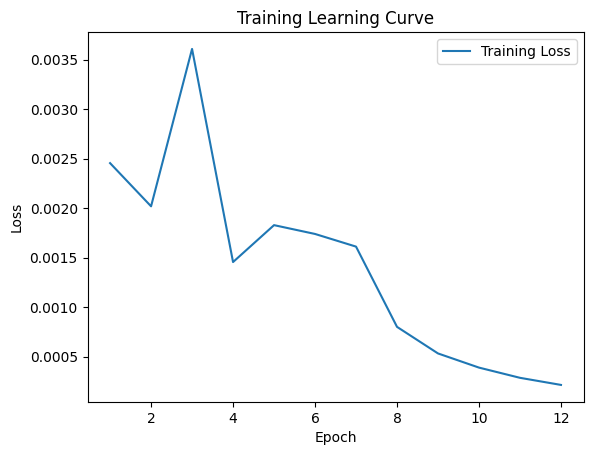


 Epoch: (13/30) Loss = 0.0001492802839493379

 Epoch: (13/30) Loss_rmse = 0.012218031100928783

 Epoch: (13/30) R^2 = 0.9933398962020874

 Epoch: (13/30) MAE = 0.009428068995475769
Spearman correlation coefficient: SignificanceResult(statistic=0.9933475952063613, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

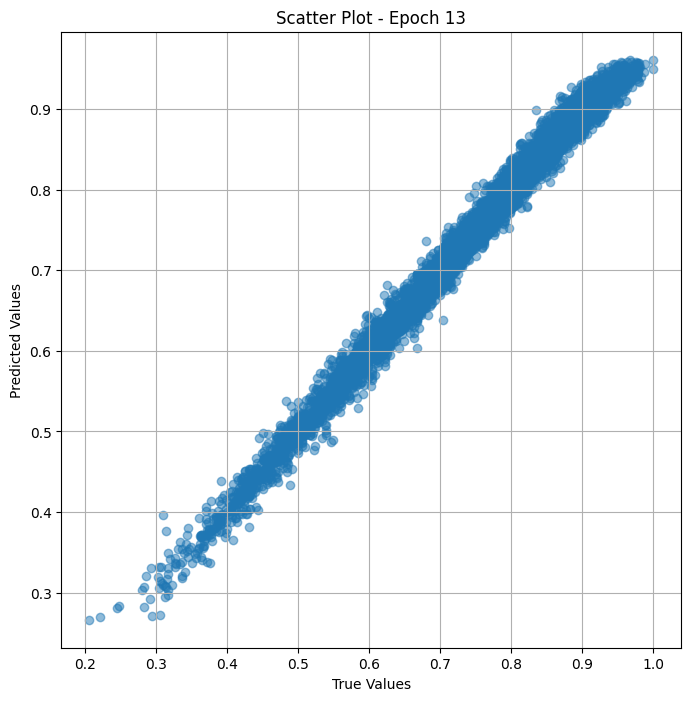

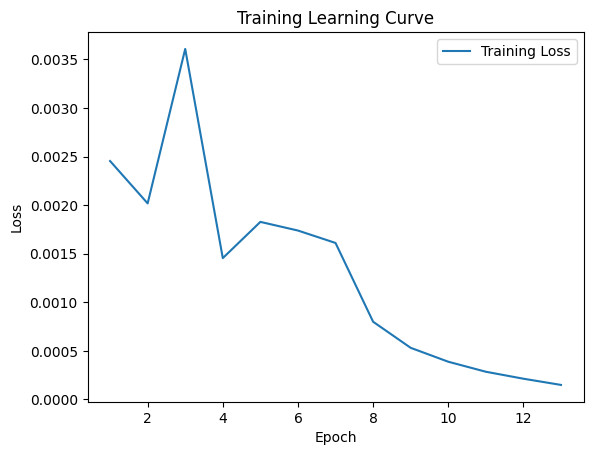


 Epoch: (14/30) Loss = 0.00010182982077822089

 Epoch: (14/30) Loss_rmse = 0.010091076605021954

 Epoch: (14/30) R^2 = 0.995456874370575

 Epoch: (14/30) MAE = 0.007507901638746262
Spearman correlation coefficient: SignificanceResult(statistic=0.9950298325253276, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

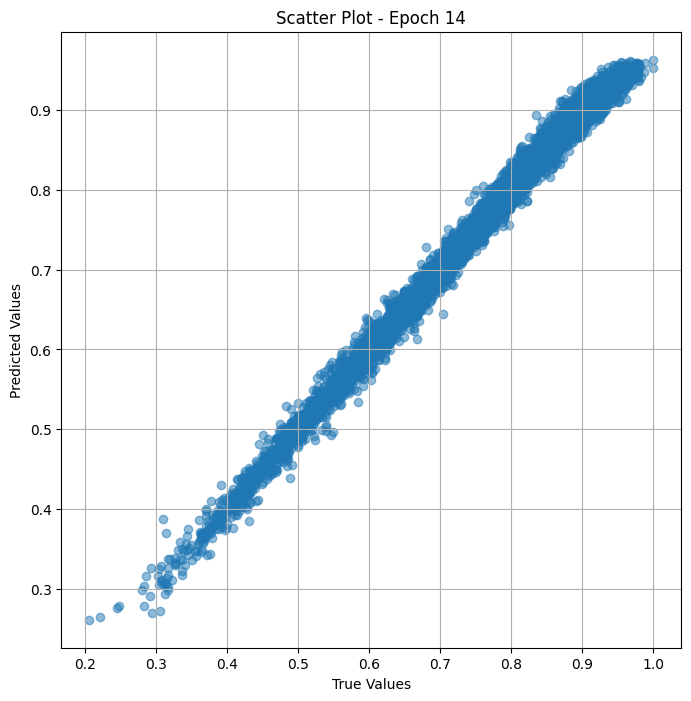

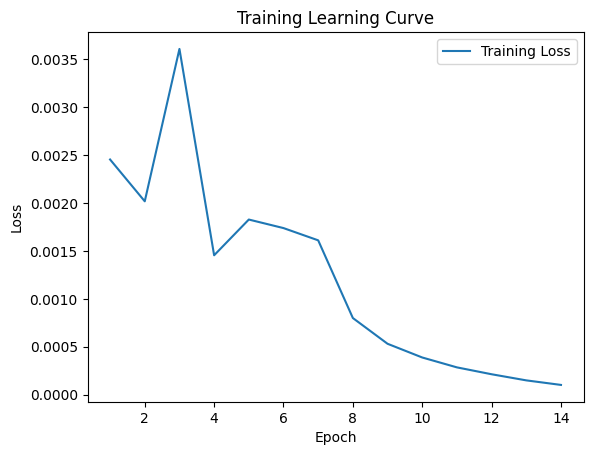


 Epoch: (15/30) Loss = 6.35423930361867e-05

 Epoch: (15/30) Loss_rmse = 0.007971348240971565

 Epoch: (15/30) R^2 = 0.9971650838851929

 Epoch: (15/30) MAE = 0.0057606808841228485
Spearman correlation coefficient: SignificanceResult(statistic=0.9963724933670624, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

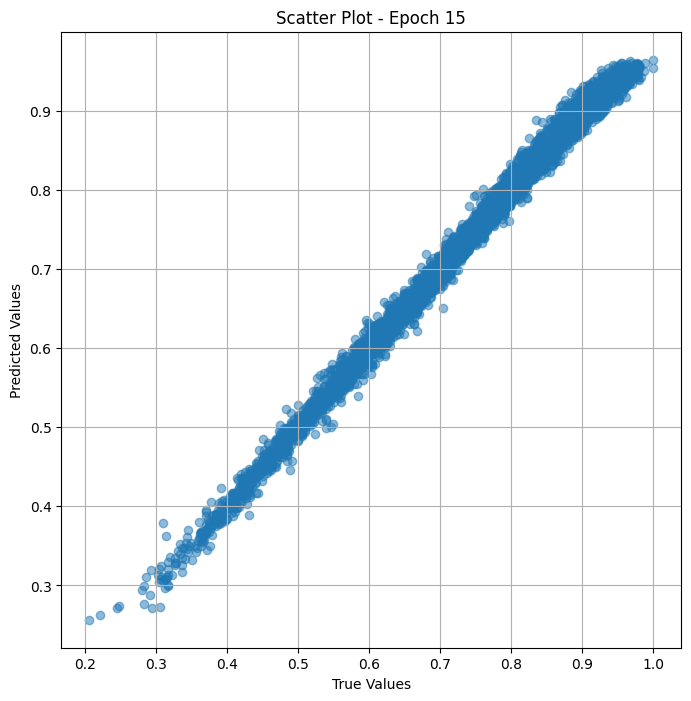

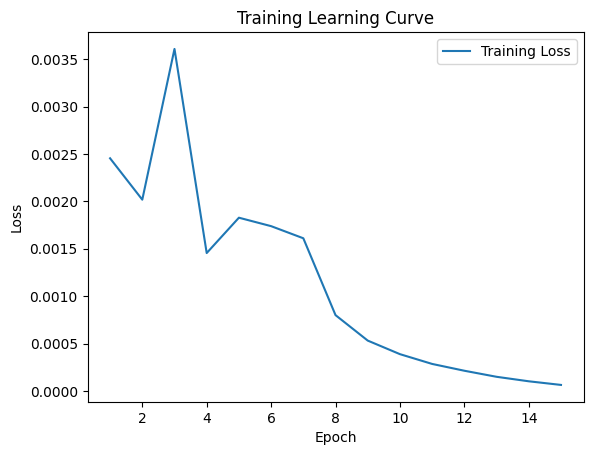


 Epoch: (16/30) Loss = 4.2405619751662016e-05

 Epoch: (16/30) Loss_rmse = 0.006511959712952375

 Epoch: (16/30) R^2 = 0.9981080889701843

 Epoch: (16/30) MAE = 0.00428476557135582
Spearman correlation coefficient: SignificanceResult(statistic=0.9974259793698804, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694

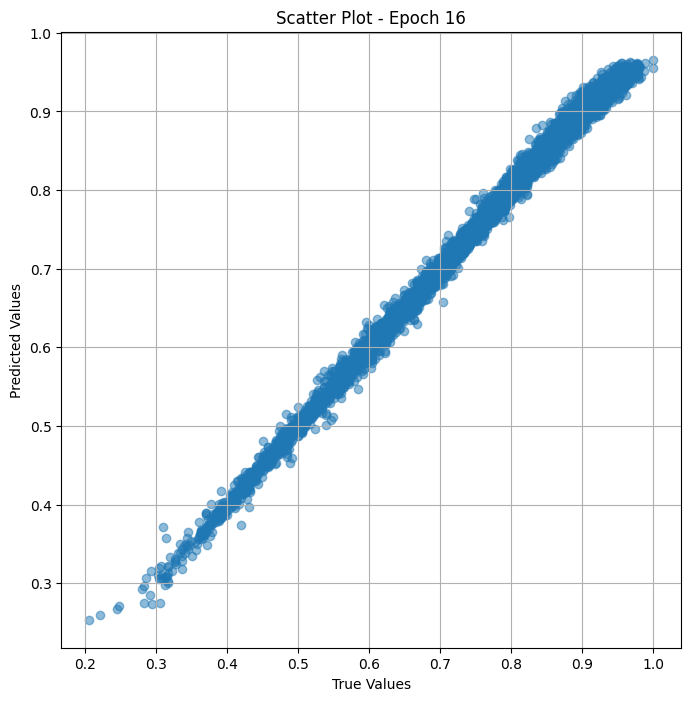

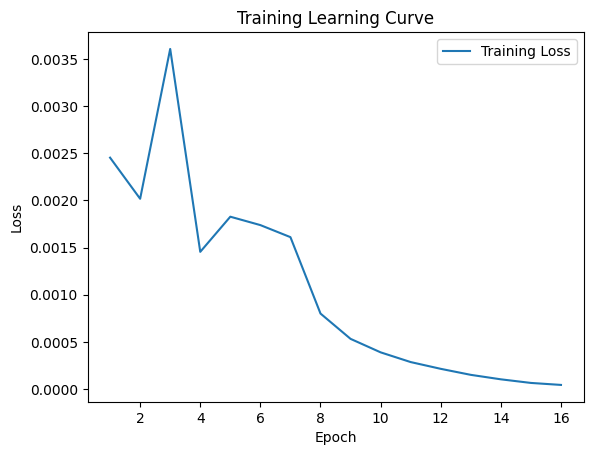


 Epoch: (17/30) Loss = 2.3373337171506137e-05

 Epoch: (17/30) Loss_rmse = 0.004834597930312157

 Epoch: (17/30) R^2 = 0.9989572167396545

 Epoch: (17/30) MAE = 0.003197811543941498
Spearman correlation coefficient: SignificanceResult(statistic=0.9982005727752365, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

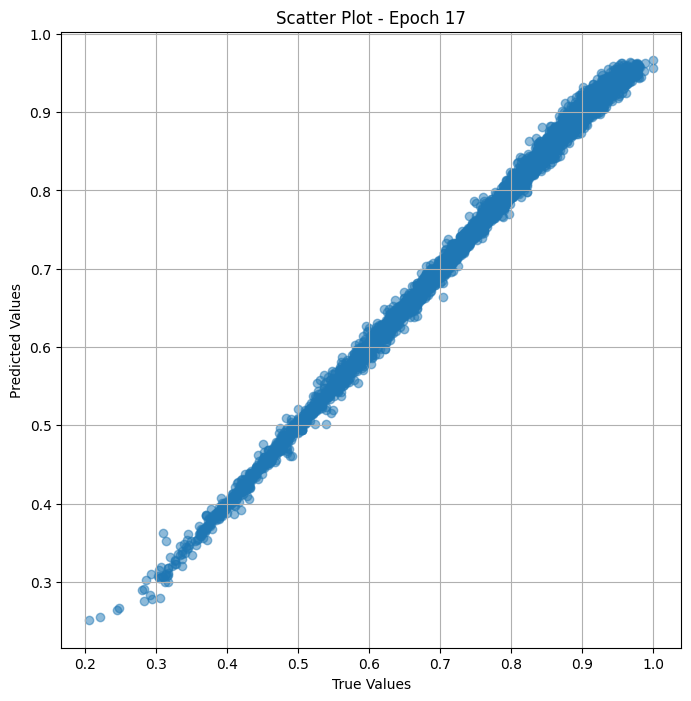

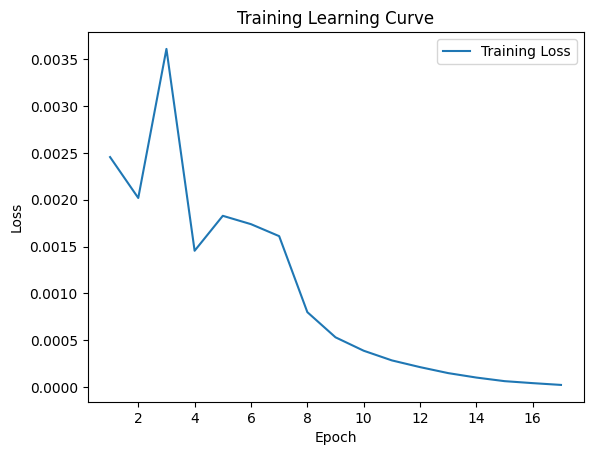


 Epoch: (18/30) Loss = 1.2102640539524145e-05

 Epoch: (18/30) Loss_rmse = 0.003478884929791093

 Epoch: (18/30) R^2 = 0.9994600415229797

 Epoch: (18/30) MAE = 0.0022768452763557434
Spearman correlation coefficient: SignificanceResult(statistic=0.9987687390841329, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

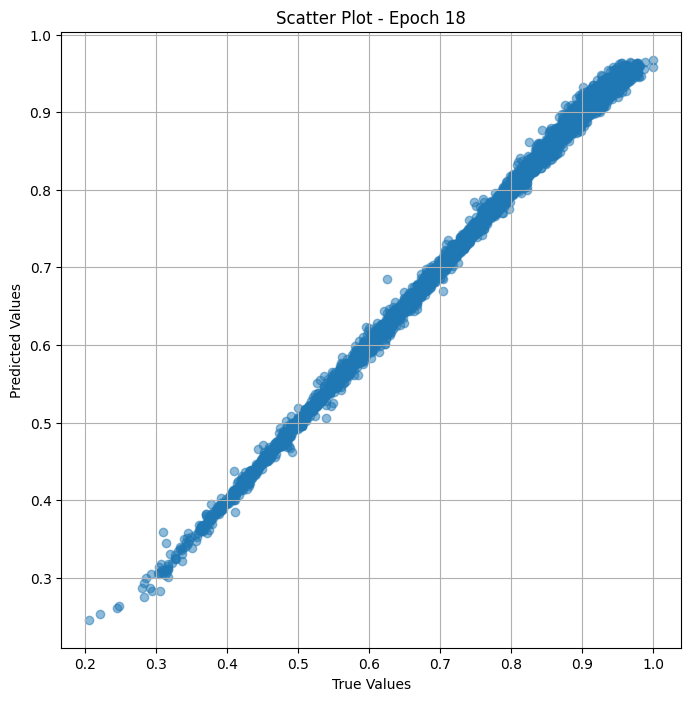

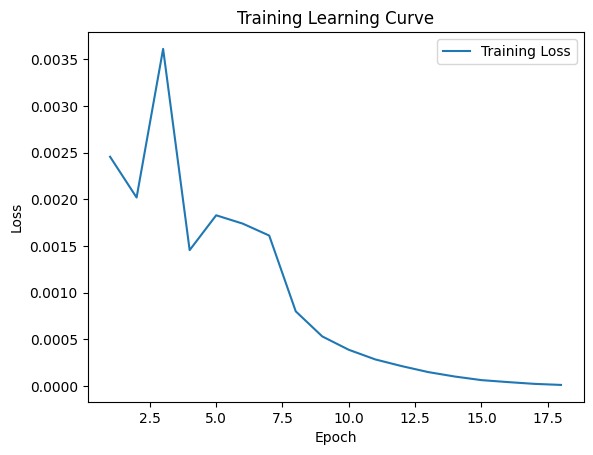


 Epoch: (19/30) Loss = 6.207626029208768e-06

 Epoch: (19/30) Loss_rmse = 0.0024915107060223818

 Epoch: (19/30) R^2 = 0.9997230768203735

 Epoch: (19/30) MAE = 0.001513466238975525
Spearman correlation coefficient: SignificanceResult(statistic=0.9991735453953718, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

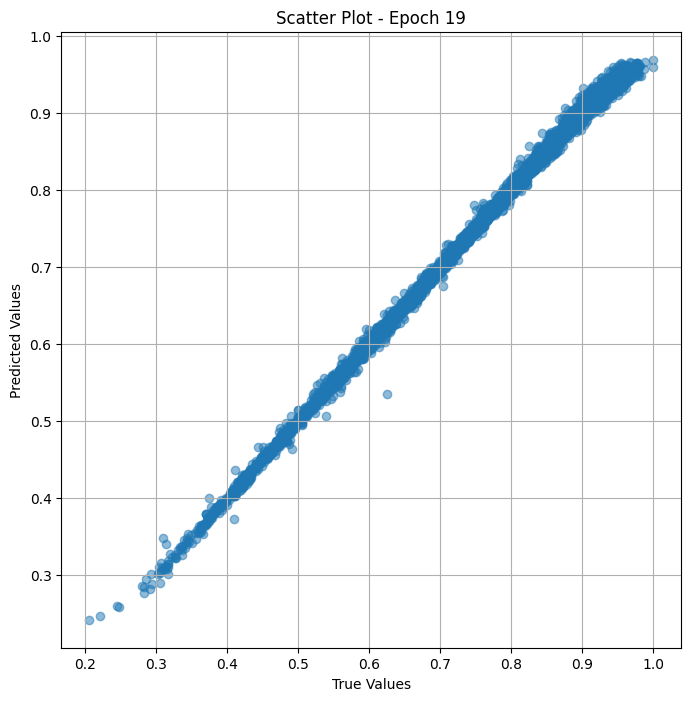

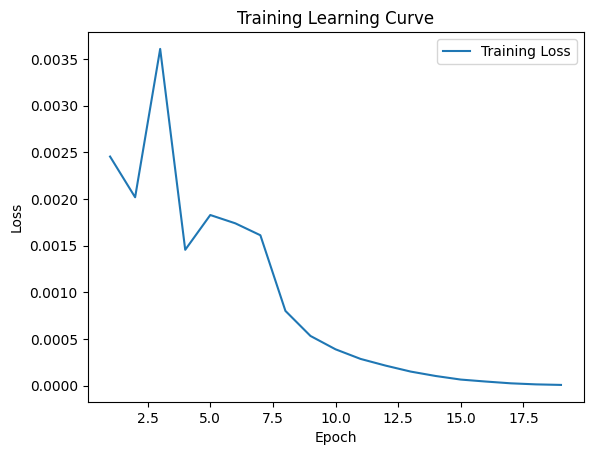


 Epoch: (20/30) Loss = 2.575643975433195e-06

 Epoch: (20/30) Loss_rmse = 0.0016048812540248036

 Epoch: (20/30) R^2 = 0.999885082244873

 Epoch: (20/30) MAE = 0.0009619146585464478
Spearman correlation coefficient: SignificanceResult(statistic=0.9994515041165332, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

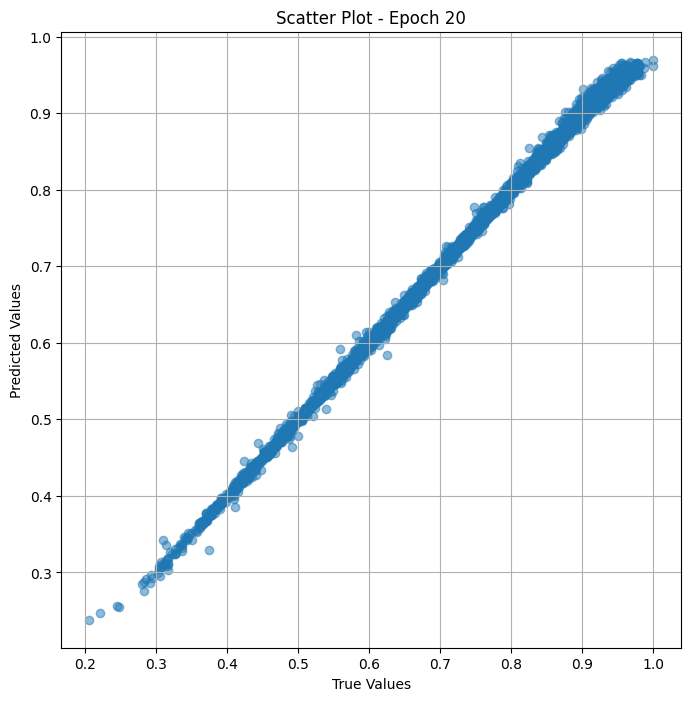

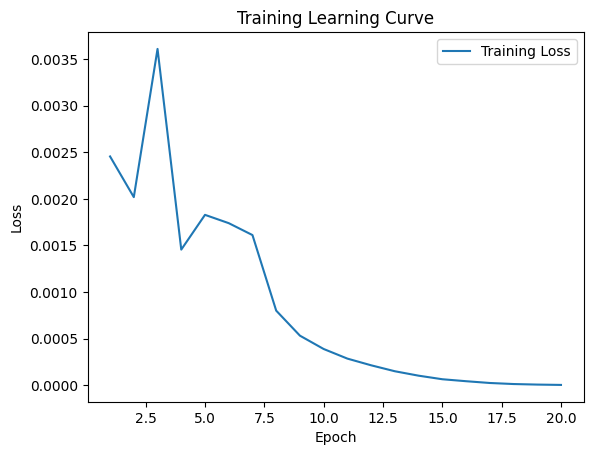


 Epoch: (21/30) Loss = 1.8123014342563692e-06

 Epoch: (21/30) Loss_rmse = 0.001346217468380928

 Epoch: (21/30) R^2 = 0.9999191164970398

 Epoch: (21/30) MAE = 0.0009882524609565735
Spearman correlation coefficient: SignificanceResult(statistic=0.9996289379732908, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

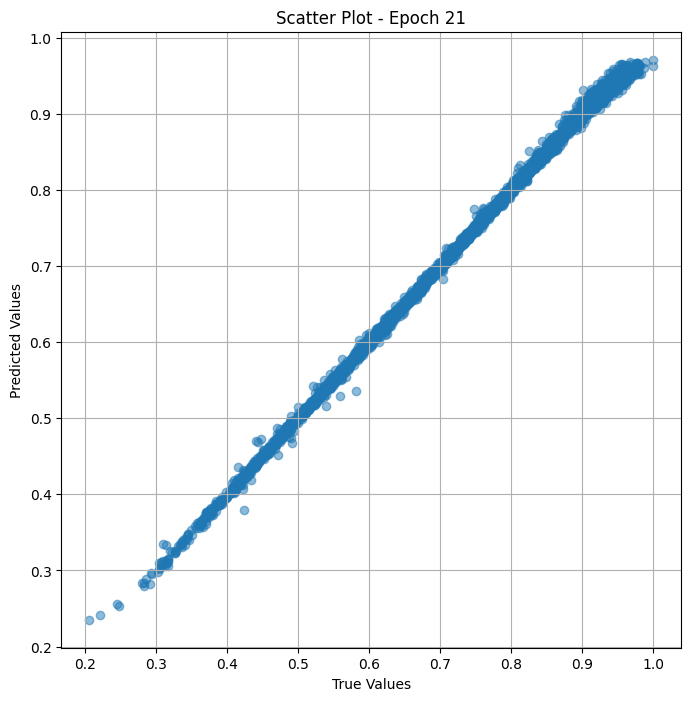

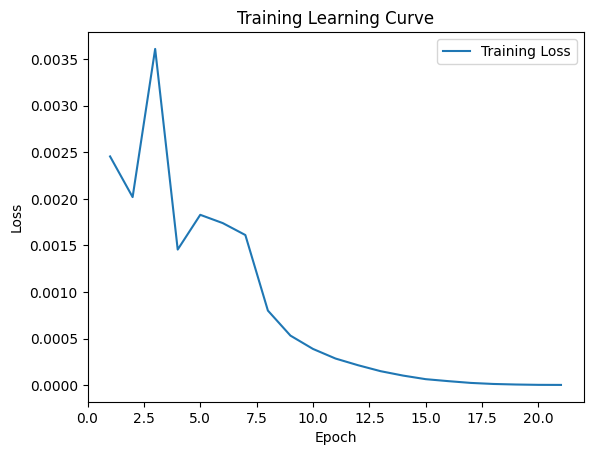


 Epoch: (22/30) Loss = 8.142785077325243e-07

 Epoch: (22/30) Loss_rmse = 0.0009023738093674183

 Epoch: (22/30) R^2 = 0.9999637007713318

 Epoch: (22/30) MAE = 0.0007227249443531036
Spearman correlation coefficient: SignificanceResult(statistic=0.9997084142992858, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

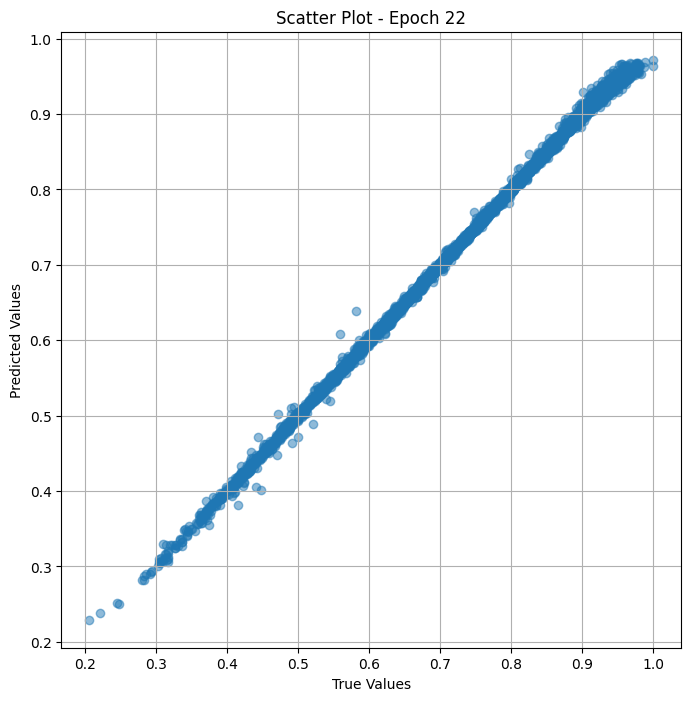

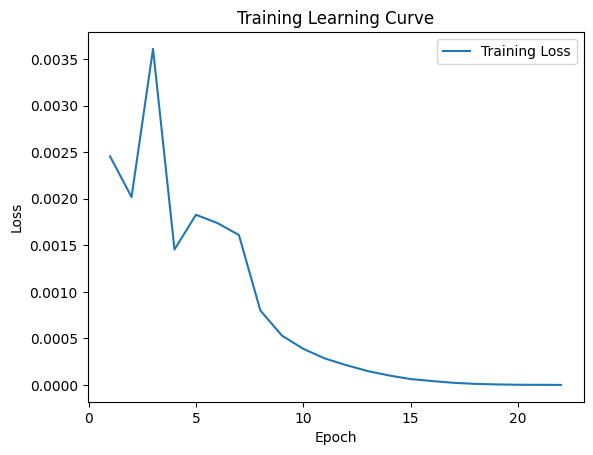


 Epoch: (23/30) Loss = 1.7225453348146402e-06

 Epoch: (23/30) Loss_rmse = 0.001312457723543048

 Epoch: (23/30) R^2 = 0.9999231696128845

 Epoch: (23/30) MAE = 0.001194726675748825
Spearman correlation coefficient: SignificanceResult(statistic=0.9997373892969688, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

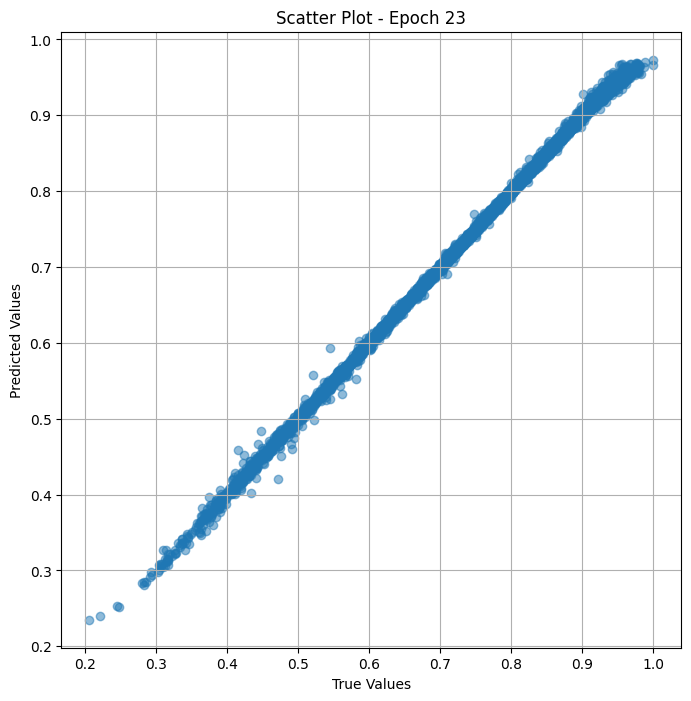

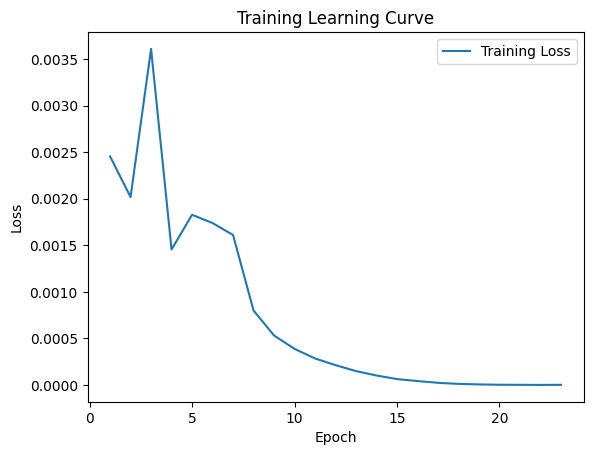


 Epoch: (24/30) Loss = 8.234346751123667e-06

 Epoch: (24/30) Loss_rmse = 0.0028695552609860897

 Epoch: (24/30) R^2 = 0.9996325969696045

 Epoch: (24/30) MAE = 0.002111673355102539
Spearman correlation coefficient: SignificanceResult(statistic=0.9996431844654788, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

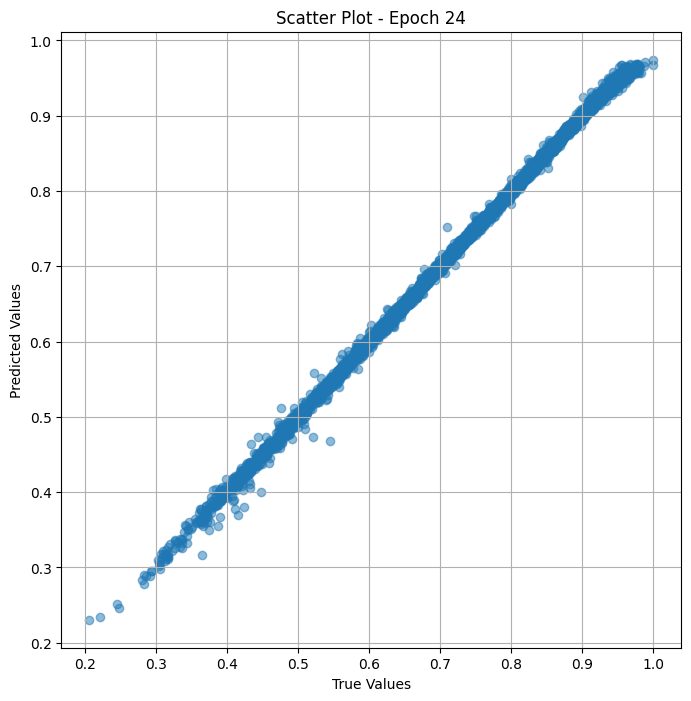

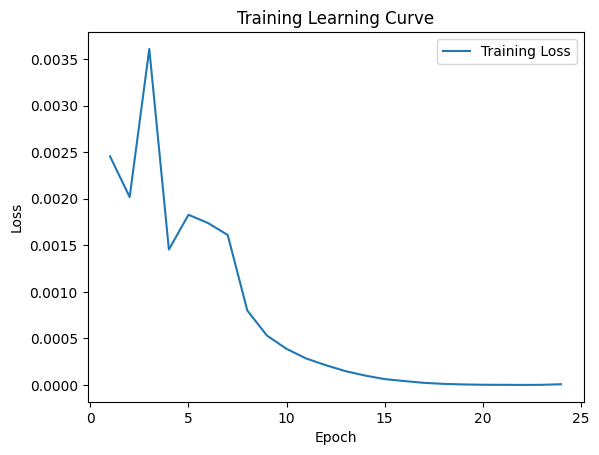

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (25/30) Loss = 3.2723211916163564e-05

 Epoch: (25/30) Loss_rmse = 0.005720420740544796

 Epoch: (25/30) R^2 = 0.9985400438308716

 Epoch: (25/30) MAE = 0.004111040383577347
Spearman correlation coefficient: SignificanceResult(statistic=0.9993843718161431, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.947

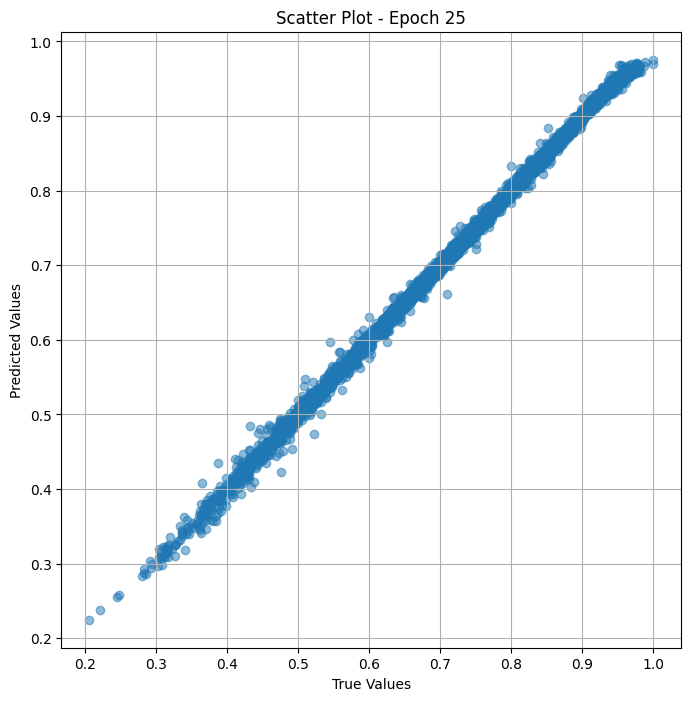

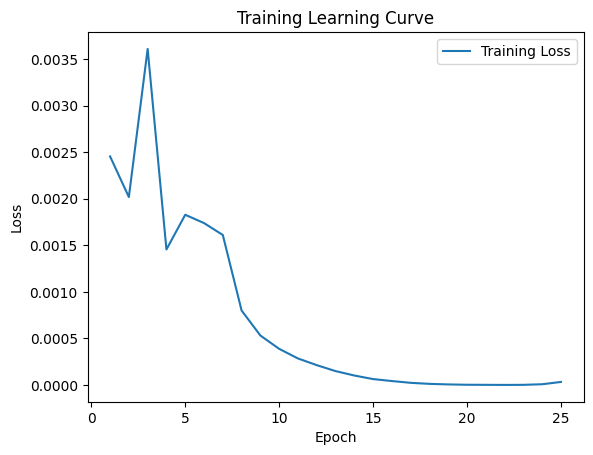


 Epoch: (26/30) Loss = 4.581522716762265e-06

 Epoch: (26/30) Loss_rmse = 0.0021404491271823645

 Epoch: (26/30) R^2 = 0.9997956156730652

 Epoch: (26/30) MAE = 0.0016325786709785461
Spearman correlation coefficient: SignificanceResult(statistic=0.9986152000405228, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

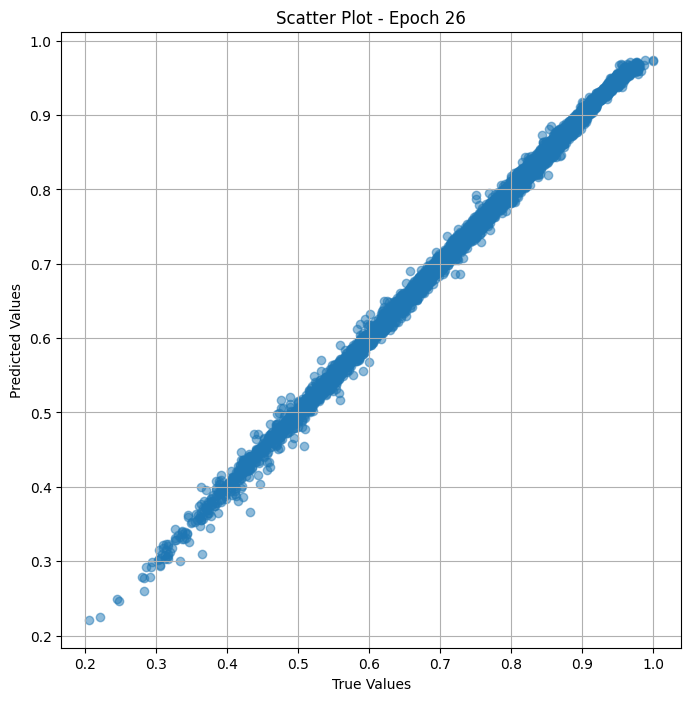

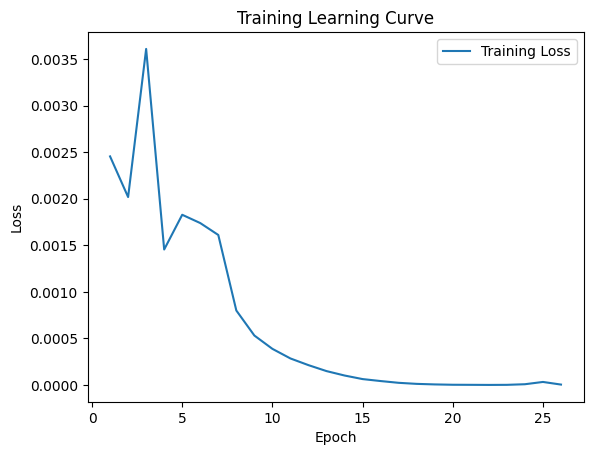


 Epoch: (27/30) Loss = 2.09272275242256e-06

 Epoch: (27/30) Loss_rmse = 0.0014466246357187629

 Epoch: (27/30) R^2 = 0.9999066591262817

 Epoch: (27/30) MAE = 0.0010346658527851105
Spearman correlation coefficient: SignificanceResult(statistic=0.9989580801477007, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.8673469

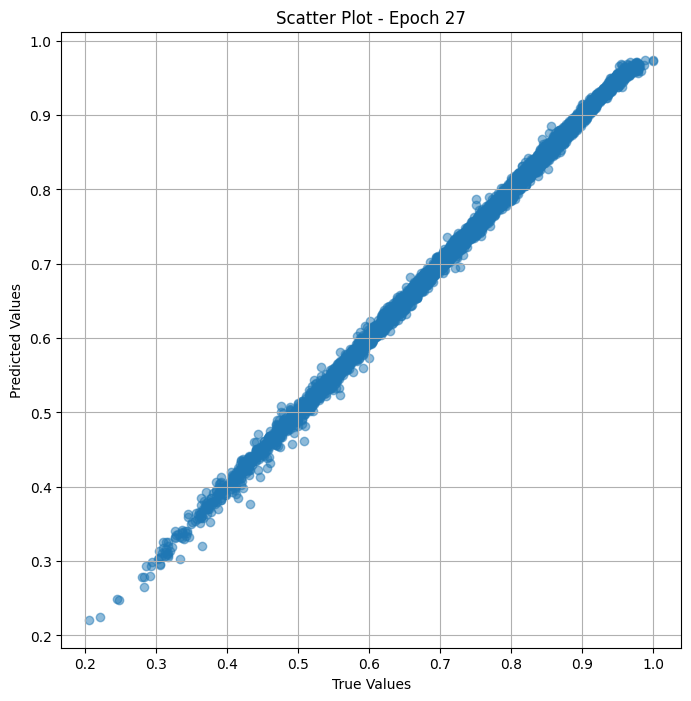

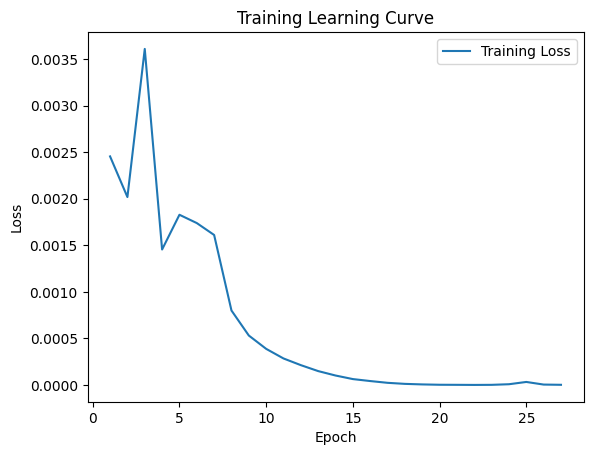

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (28/30) Loss = 1.3112842225382337e-06

 Epoch: (28/30) Loss_rmse = 0.0011451131431385875

 Epoch: (28/30) R^2 = 0.9999414682388306

 Epoch: (28/30) MAE = 0.0008822530508041382
Spearman correlation coefficient: SignificanceResult(statistic=0.9991768539477032, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.9

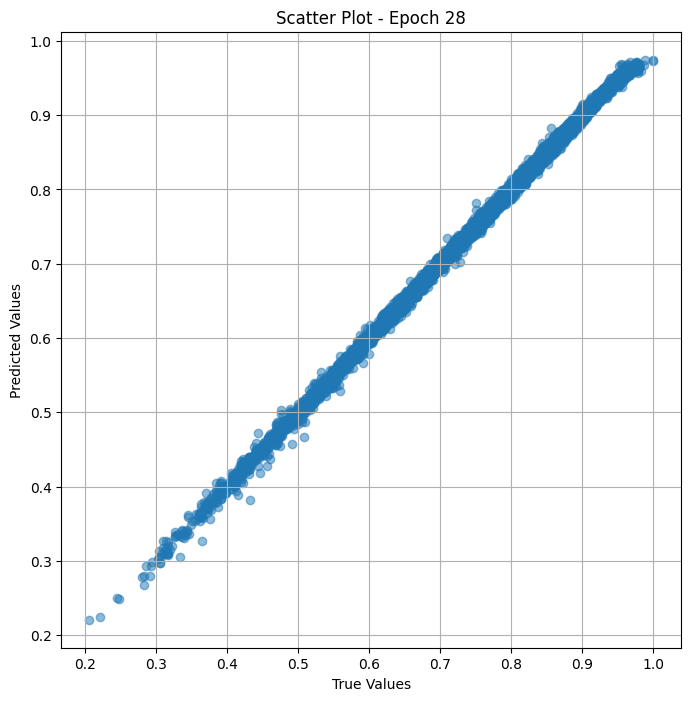

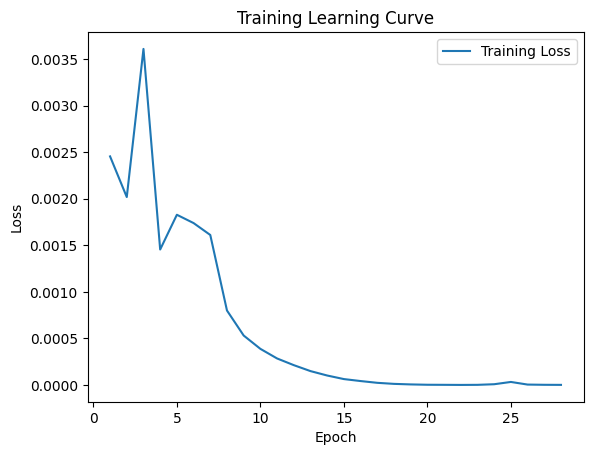


 Epoch: (29/30) Loss = 7.643549906788394e-06

 Epoch: (29/30) Loss_rmse = 0.0027646971866488457

 Epoch: (29/30) R^2 = 0.99965900182724

 Epoch: (29/30) MAE = 0.0024185478687286377
Spearman correlation coefficient: SignificanceResult(statistic=0.99911936385733, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.86734694, 

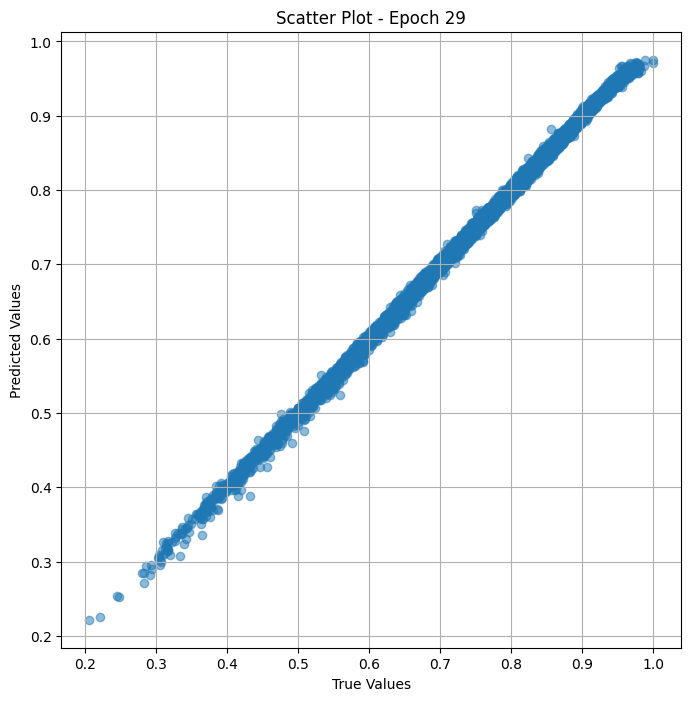

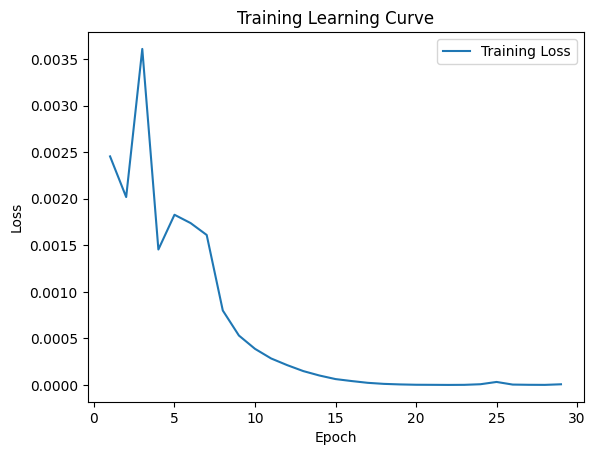


 Epoch: (30/30) Loss = 8.456942850898486e-06

 Epoch: (30/30) Loss_rmse = 0.0029080824460834265

 Epoch: (30/30) R^2 = 0.9996227025985718

 Epoch: (30/30) MAE = 0.0025314725935459137
Spearman correlation coefficient: SignificanceResult(statistic=0.9992015441073908, pvalue=0.0)

 true_values_list_val : 9000

 predicted_values_list_val : 9000

 true_values_list_val : [0.625, 0.49, 0.77678573, 0.84090906, 0.86, 0.5555556, 0.9019608, 0.7222222, 0.74038464, 0.74, 0.91, 0.5764706, 0.8018018, 0.8235294, 0.6451613, 0.6896552, 0.63917524, 0.79611653, 0.84158415, 0.64285713, 0.65346533, 0.625, 0.47572815, 0.63917524, 0.87628865, 0.74757284, 0.48913044, 0.8, 0.79, 0.83505154, 0.77, 0.7619048, 0.8021978, 0.43010753, 0.725, 0.8541667, 0.77319586, 0.8712871, 0.49107143, 0.6421053, 0.9029126, 0.79787236, 0.5576923, 0.8815789, 0.7816092, 0.5151515, 0.7699115, 0.7029703, 0.7826087, 0.8857143, 0.6635514, 0.6597938, 0.8363636, 0.94285715, 0.94736844, 0.85087717, 0.8695652, 0.6857143, 0.8787879, 0.867346

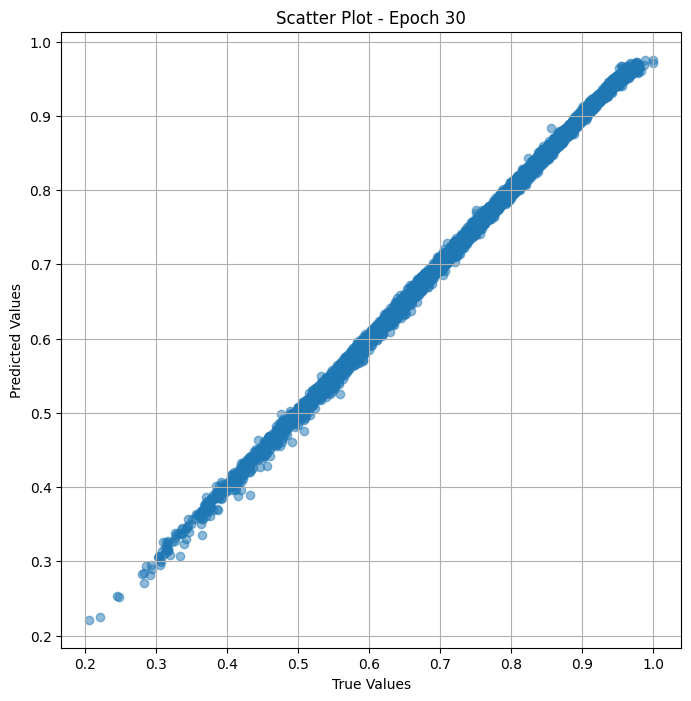

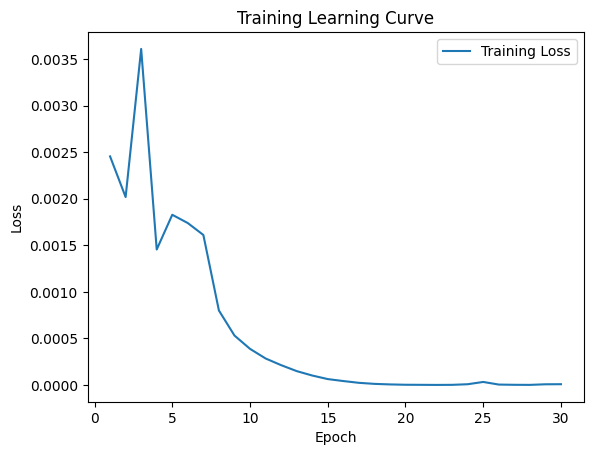

In [ ]:
# Training the model and save weights
fit(30,model_vit_fine , train_dl)
torch.save(model_vit_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.0034183699171990156

 Epoch: (1/30) Loss_rmse = 0.058466825634241104

 Epoch: (1/30) R^2 = 0.724940299987793

 Epoch: (1/30) MAE = 0.04381786286830902
Spearman correlation coefficient: SignificanceResult(statistic=0.8077409620002596, pvalue=9.093573262829e-112)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982142

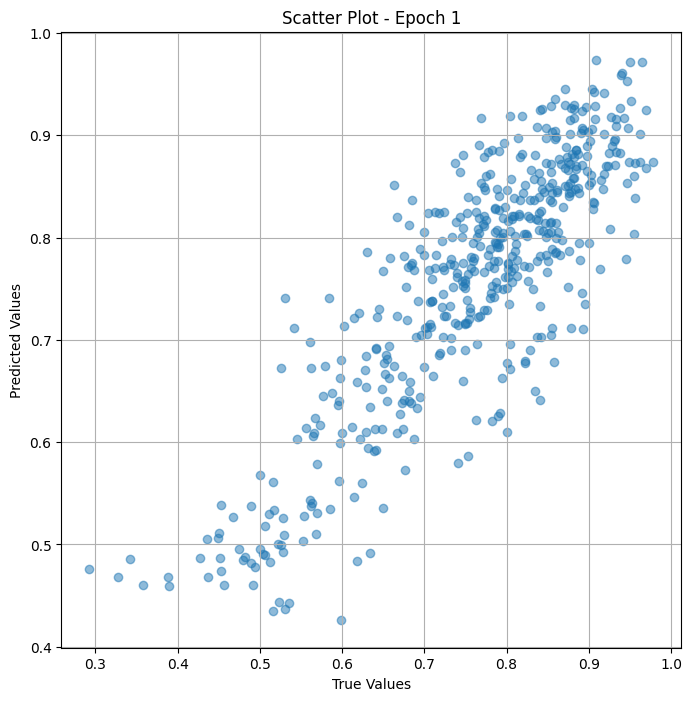

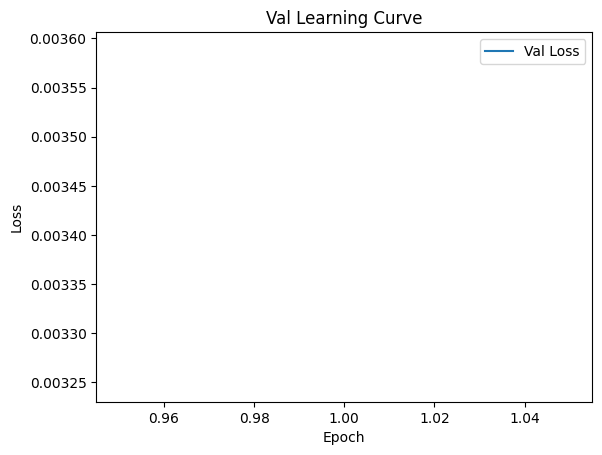


 Epoch: (2/30) Loss = 0.001931147649884224

 Epoch: (2/30) Loss_rmse = 0.0439448244869709

 Epoch: (2/30) R^2 = 0.8446099162101746

 Epoch: (2/30) MAE = 0.03483989089727402
Spearman correlation coefficient: SignificanceResult(statistic=0.8778193022385069, pvalue=6.53438083865895e-155)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982142

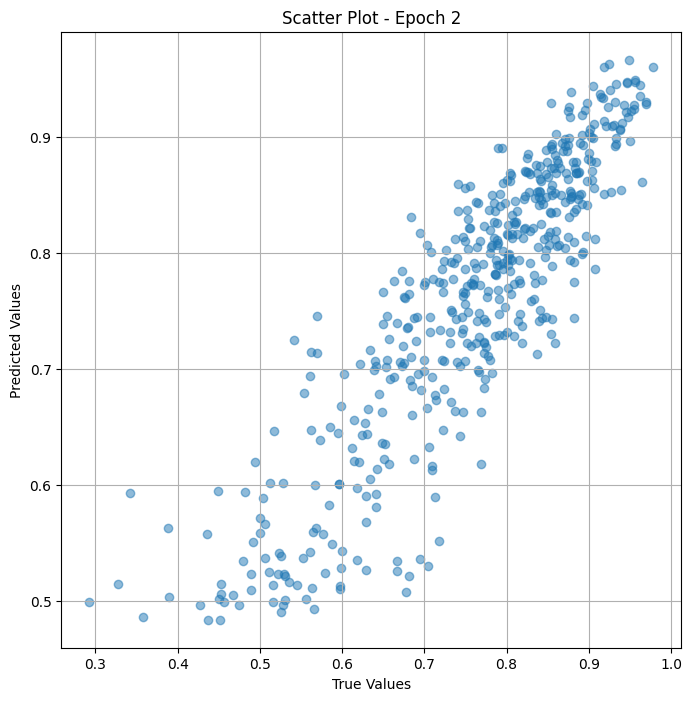

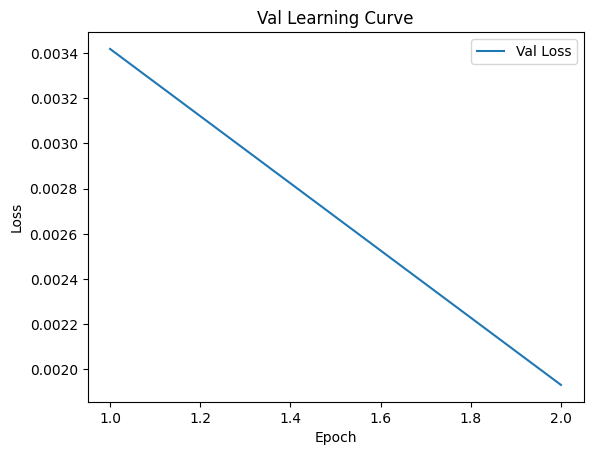


 Epoch: (3/30) Loss = 0.00093825813382864

 Epoch: (3/30) Loss_rmse = 0.03063100017607212

 Epoch: (3/30) R^2 = 0.9245029091835022

 Epoch: (3/30) MAE = 0.023539884015917778
Spearman correlation coefficient: SignificanceResult(statistic=0.9560355696461821, pvalue=8.35082232293605e-257)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.598214

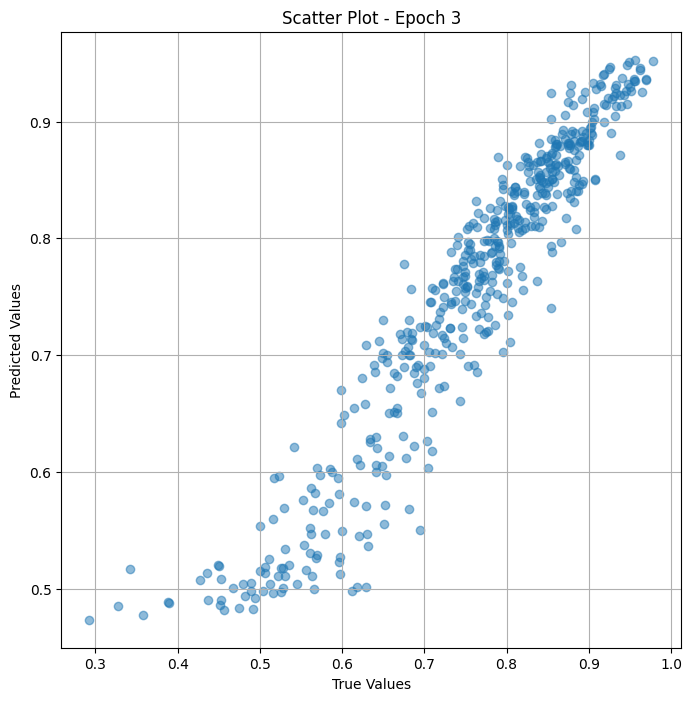

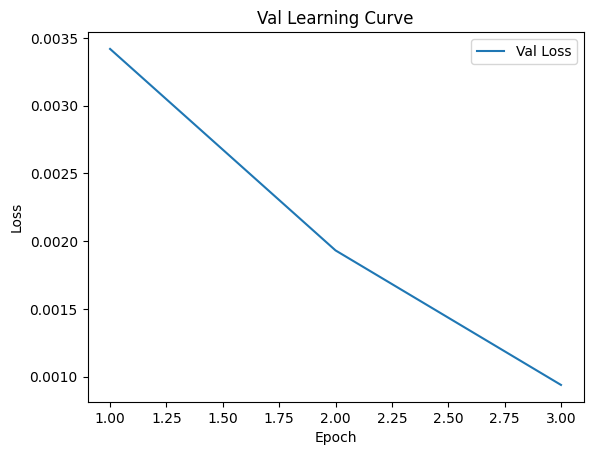


 Epoch: (4/30) Loss = 0.0008492876659147441

 Epoch: (4/30) Loss_rmse = 0.02914253994822502

 Epoch: (4/30) R^2 = 0.9316619634628296

 Epoch: (4/30) MAE = 0.023164475336670876
Spearman correlation coefficient: SignificanceResult(statistic=0.9551111368839276, pvalue=1.0788508895955259e-254)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59

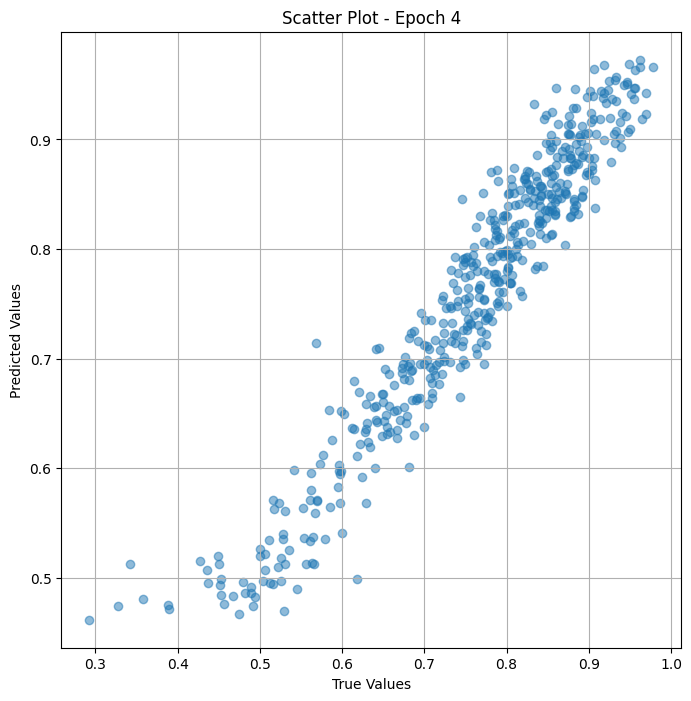

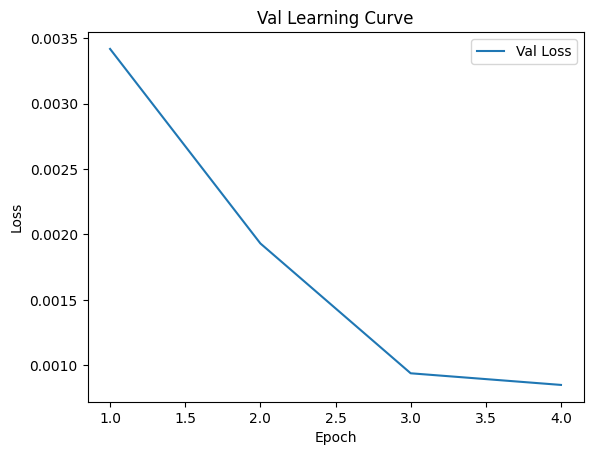


 Epoch: (5/30) Loss = 0.0012799398973584175

 Epoch: (5/30) Loss_rmse = 0.03577624633908272

 Epoch: (5/30) R^2 = 0.8970094323158264

 Epoch: (5/30) MAE = 0.034433938562870026
Spearman correlation coefficient: SignificanceResult(statistic=0.9671314754898792, pvalue=2.0563660587656084e-286)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59

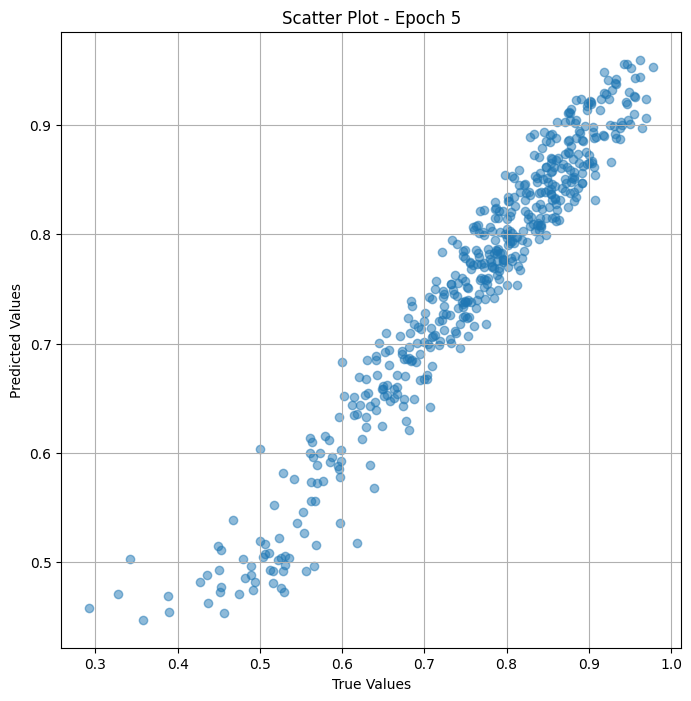

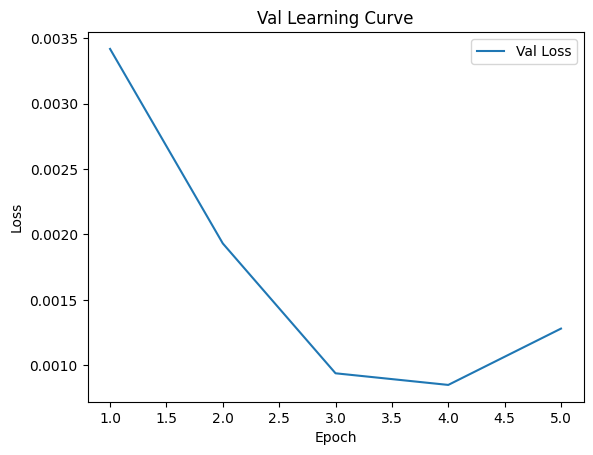


 Epoch: (6/30) Loss = 0.0021393222268670797

 Epoch: (6/30) Loss_rmse = 0.04625280946493149

 Epoch: (6/30) R^2 = 0.827859103679657

 Epoch: (6/30) MAE = 0.034664053469896317
Spearman correlation coefficient: SignificanceResult(statistic=0.9655937562704073, pvalue=9.515990495350596e-282)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982

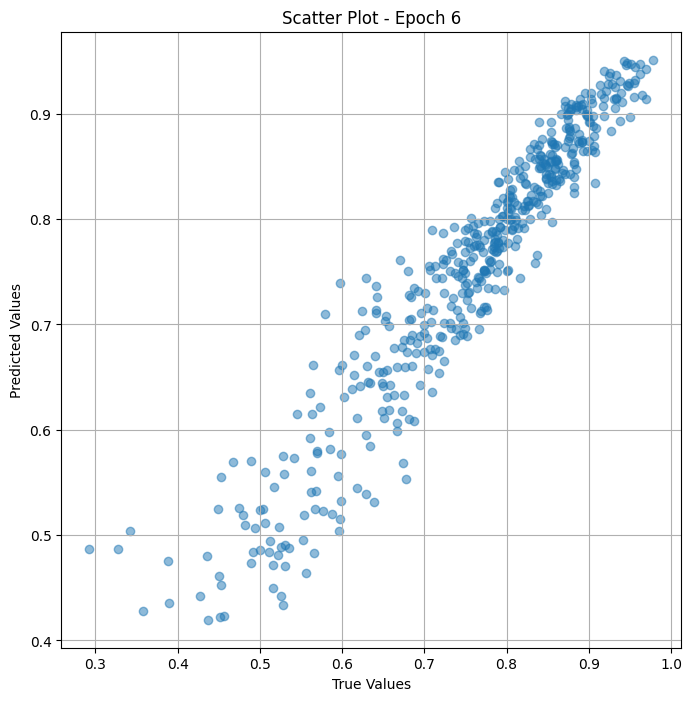

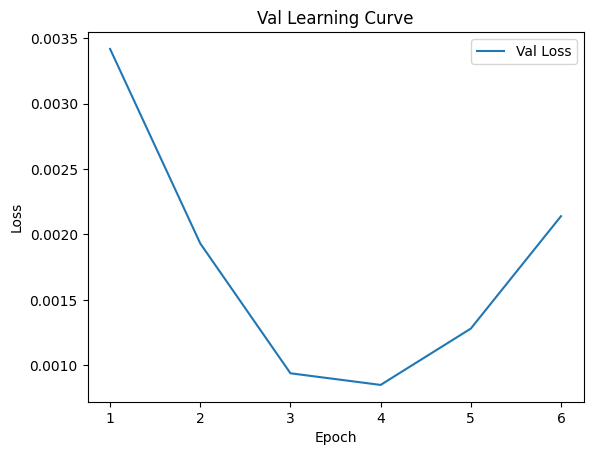

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/30) Loss = 0.0019592742901295424

 Epoch: (7/30) Loss_rmse = 0.04426369071006775

 Epoch: (7/30) R^2 = 0.8423466682434082

 Epoch: (7/30) MAE = 0.03494974970817566
Spearman correlation coefficient: SignificanceResult(statistic=0.9344498286429325, pvalue=1.7365721052067062e-216)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0

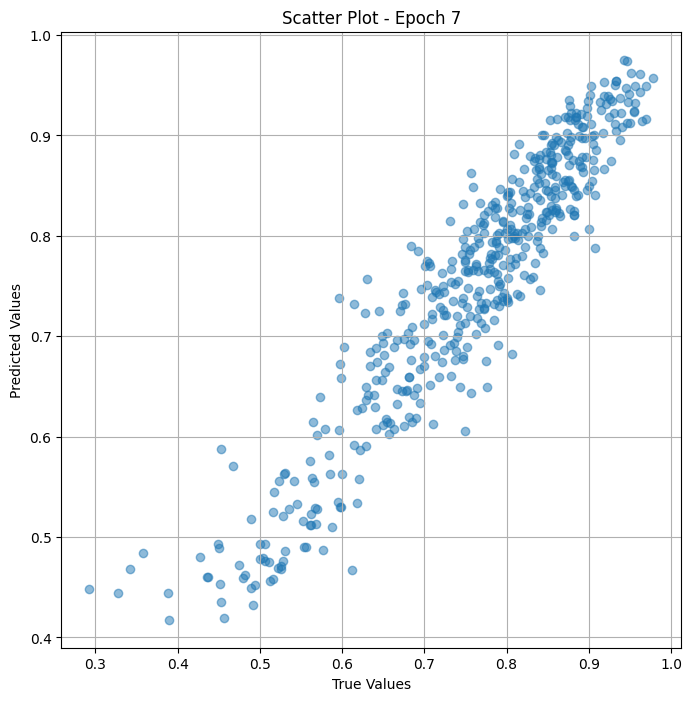

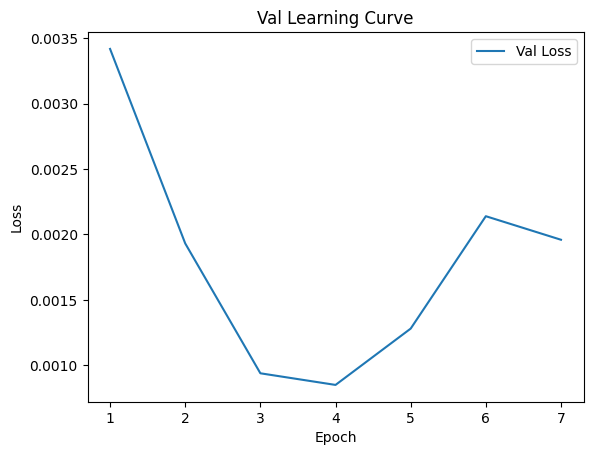


 Epoch: (8/30) Loss = 0.003299333853647113

 Epoch: (8/30) Loss_rmse = 0.05743982642889023

 Epoch: (8/30) R^2 = 0.7345185875892639

 Epoch: (8/30) MAE = 0.05305469036102295
Spearman correlation coefficient: SignificanceResult(statistic=0.8673915878320964, pvalue=5.536477273882996e-147)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821

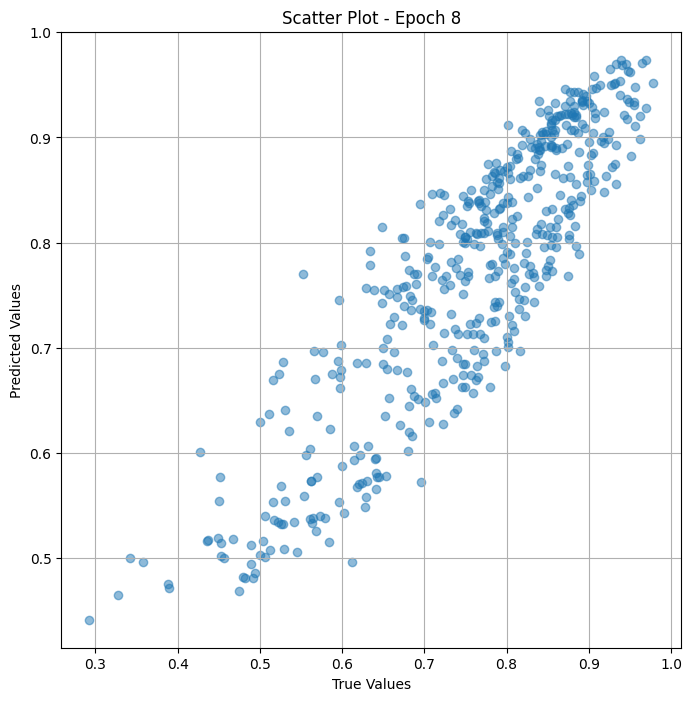

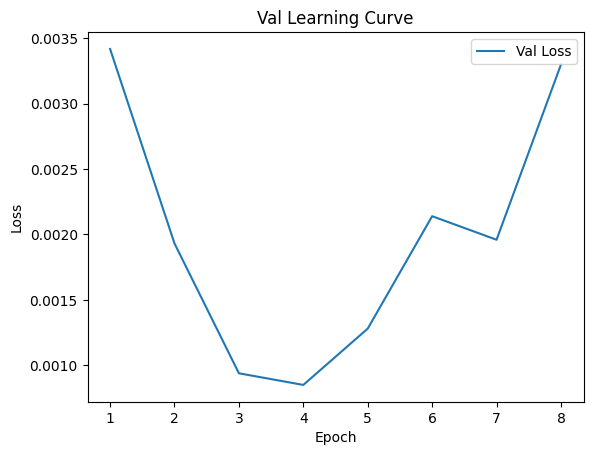


 Epoch: (9/30) Loss = 0.0012633331352844834

 Epoch: (9/30) Loss_rmse = 0.035543397068977356

 Epoch: (9/30) R^2 = 0.8983457088470459

 Epoch: (9/30) MAE = 0.0322047621011734
Spearman correlation coefficient: SignificanceResult(statistic=0.956709674762152, pvalue=2.2560863127639474e-258)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982

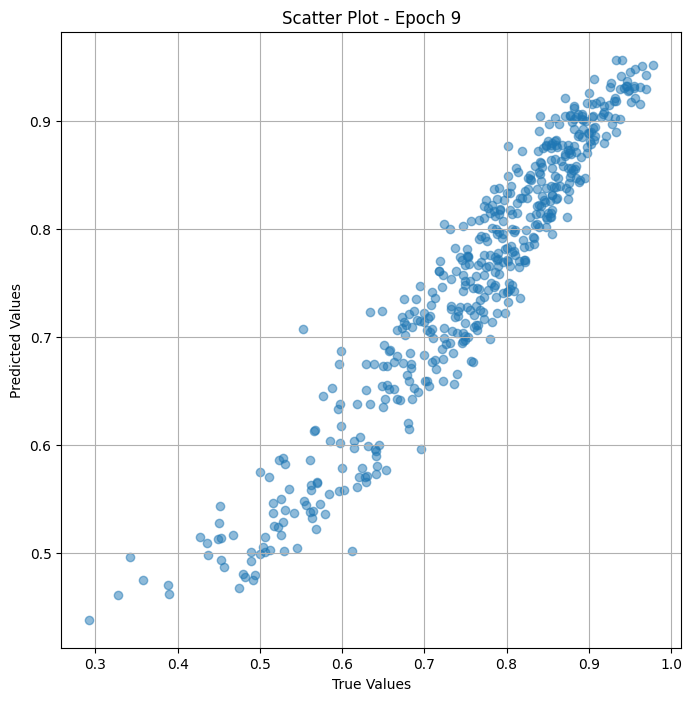

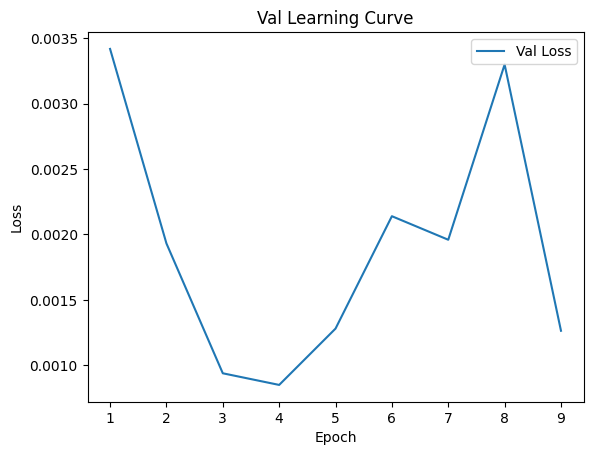

Epoch 0.03: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (10/30) Loss = 0.0008661923347972333

 Epoch: (10/30) Loss_rmse = 0.029431145638227463

 Epoch: (10/30) R^2 = 0.9303017258644104

 Epoch: (10/30) MAE = 0.02676994539797306
Spearman correlation coefficient: SignificanceResult(statistic=0.9617826345016811, pvalue=4.816468353735031e-271)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.792079

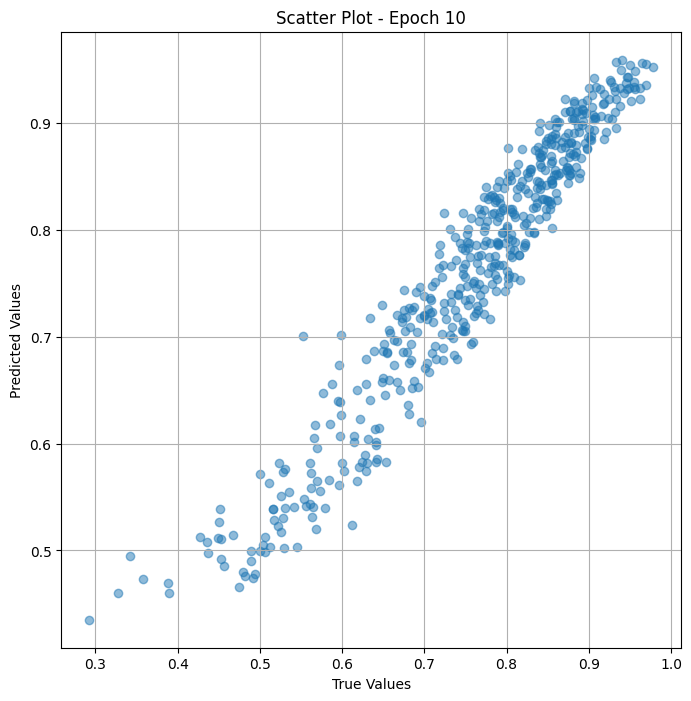

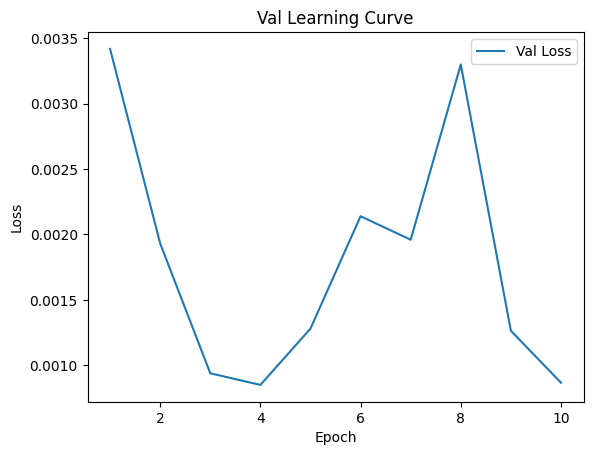


 Epoch: (11/30) Loss = 0.000763493764679879

 Epoch: (11/30) Loss_rmse = 0.02763139083981514

 Epoch: (11/30) R^2 = 0.9385653734207153

 Epoch: (11/30) MAE = 0.024965394288301468
Spearman correlation coefficient: SignificanceResult(statistic=0.9730180272067995, pvalue=1.3701347703024159e-306)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0

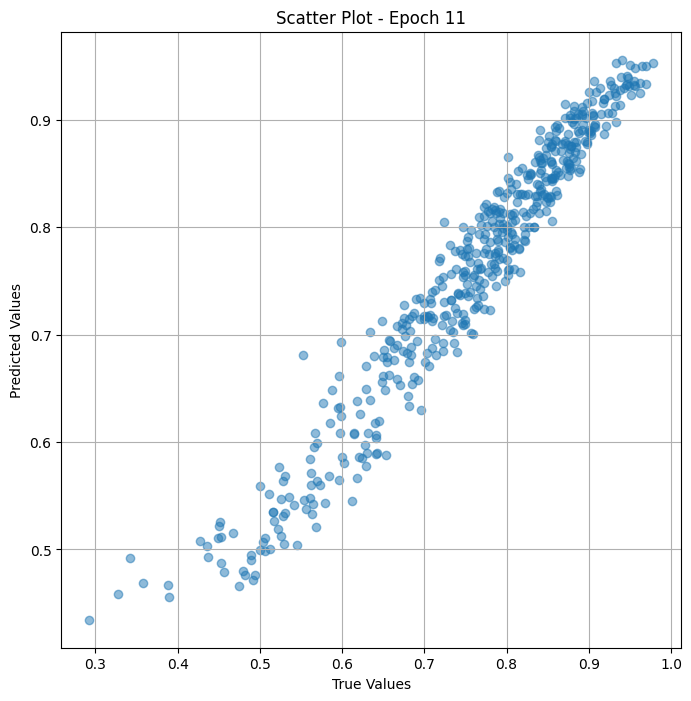

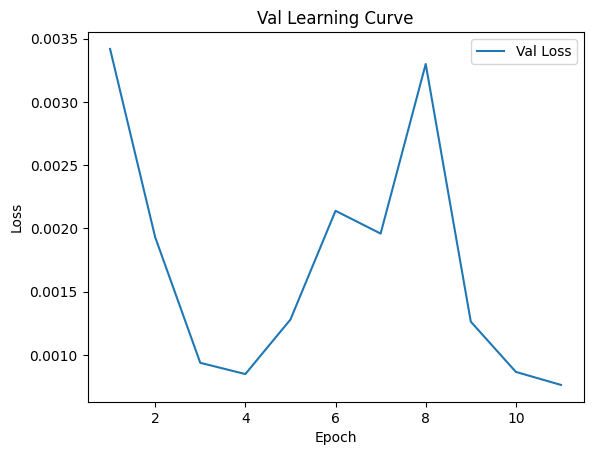


 Epoch: (12/30) Loss = 0.000759453047066927

 Epoch: (12/30) Loss_rmse = 0.02755817584693432

 Epoch: (12/30) R^2 = 0.9388905167579651

 Epoch: (12/30) MAE = 0.024943102151155472
Spearman correlation coefficient: SignificanceResult(statistic=0.9735394075017269, pvalue=1.376063240511462e-308)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.

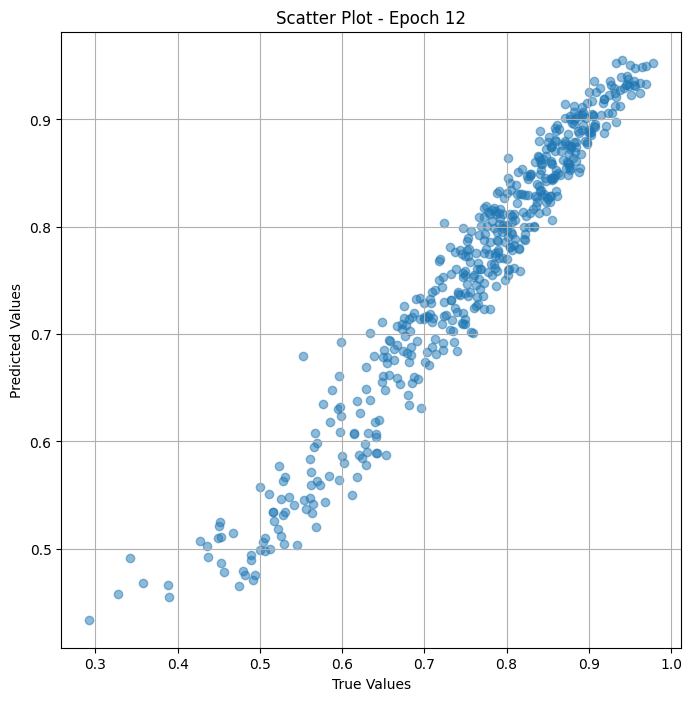

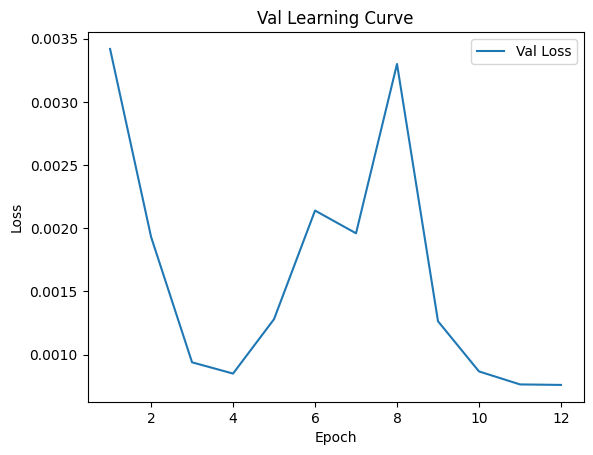


 Epoch: (13/30) Loss = 0.0007523018284700811

 Epoch: (13/30) Loss_rmse = 0.027428120374679565

 Epoch: (13/30) R^2 = 0.9394659399986267

 Epoch: (13/30) MAE = 0.024857675656676292
Spearman correlation coefficient: SignificanceResult(statistic=0.974154484338729, pvalue=5.363852817101e-311)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59

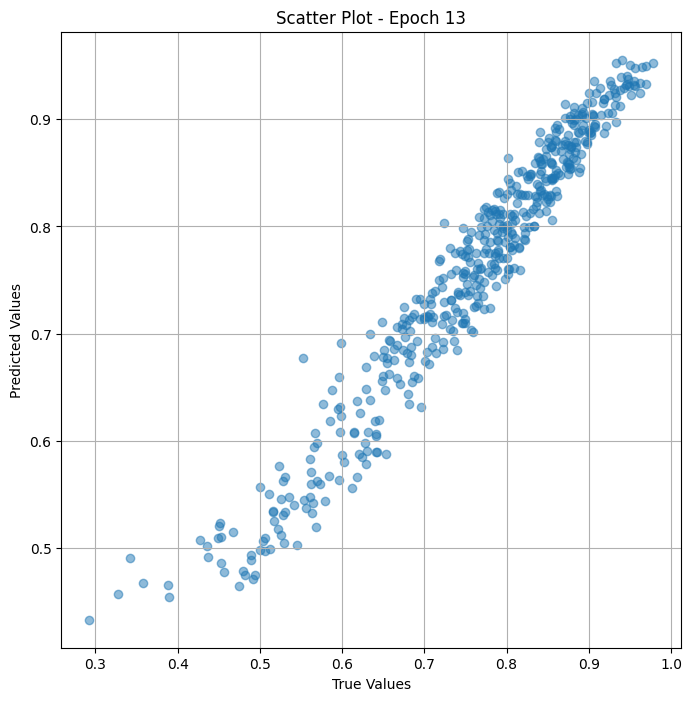

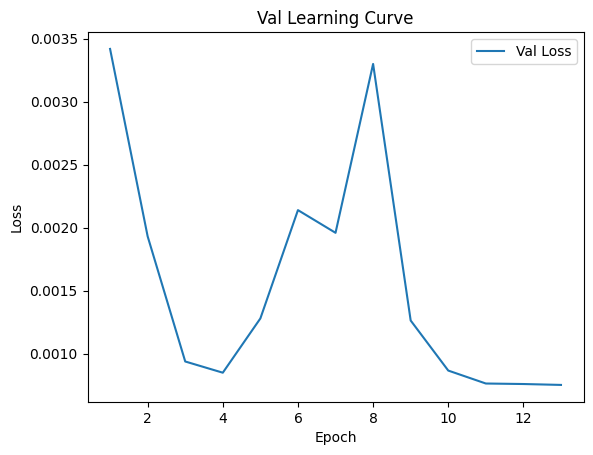


 Epoch: (14/30) Loss = 0.0007418181630782783

 Epoch: (14/30) Loss_rmse = 0.027236338704824448

 Epoch: (14/30) R^2 = 0.940309464931488

 Epoch: (14/30) MAE = 0.02470446191728115
Spearman correlation coefficient: SignificanceResult(statistic=0.9746881802764187, pvalue=3.904079652e-313)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.598214

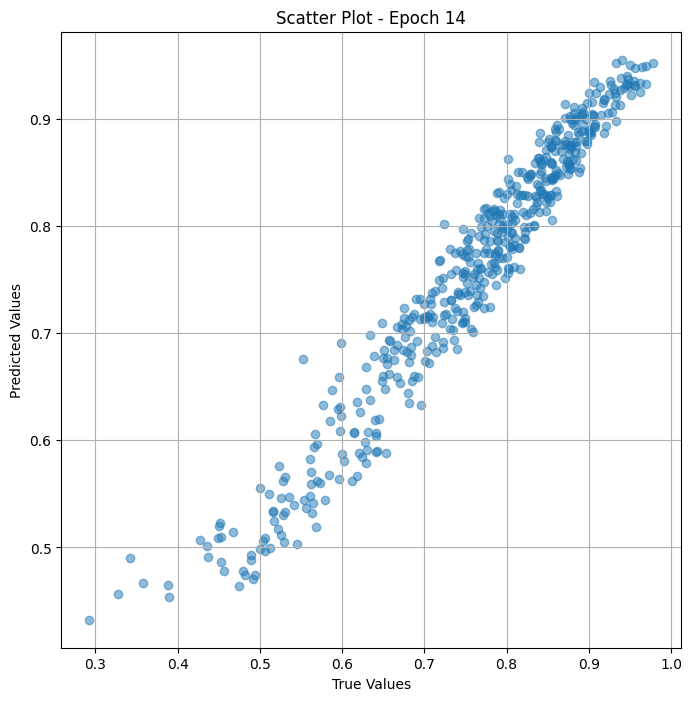

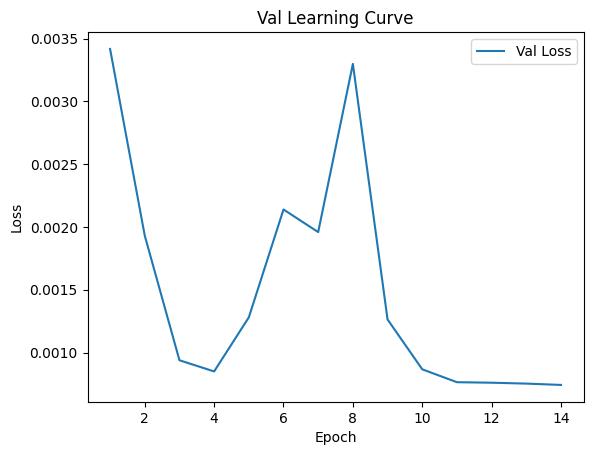


 Epoch: (15/30) Loss = 0.0007290453650057316

 Epoch: (15/30) Loss_rmse = 0.02700084075331688

 Epoch: (15/30) R^2 = 0.9413372278213501

 Epoch: (15/30) MAE = 0.02450272999703884
Spearman correlation coefficient: SignificanceResult(statistic=0.975175706117232, pvalue=3.964790603e-315)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.5982142

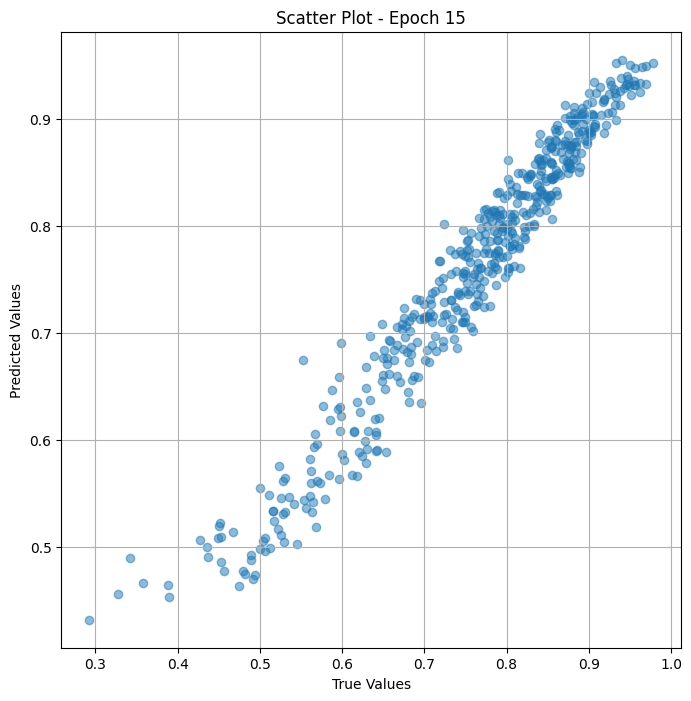

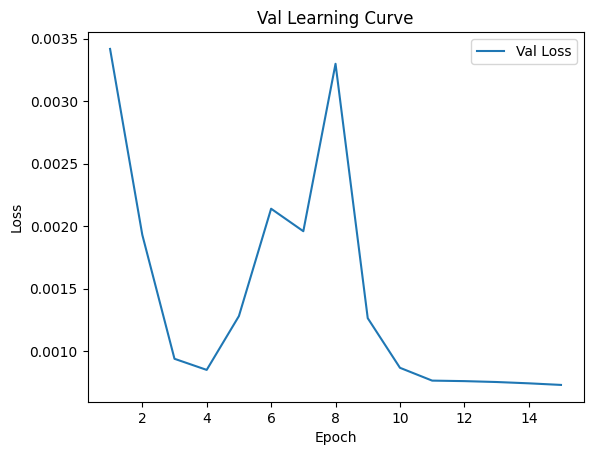


 Epoch: (16/30) Loss = 0.0007147158612497151

 Epoch: (16/30) Loss_rmse = 0.02673416957259178

 Epoch: (16/30) R^2 = 0.94249027967453

 Epoch: (16/30) MAE = 0.024265682324767113
Spearman correlation coefficient: SignificanceResult(statistic=0.975795665808193, pvalue=1.0125124e-317)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 

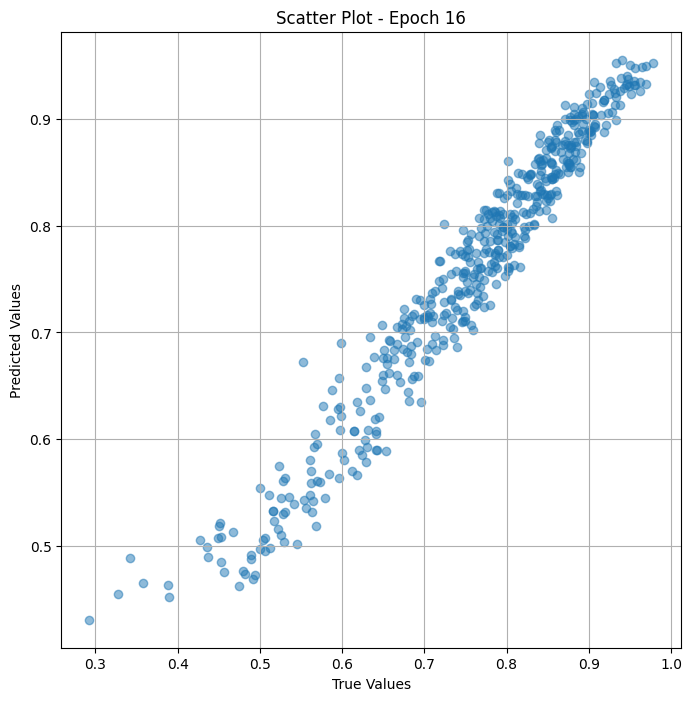

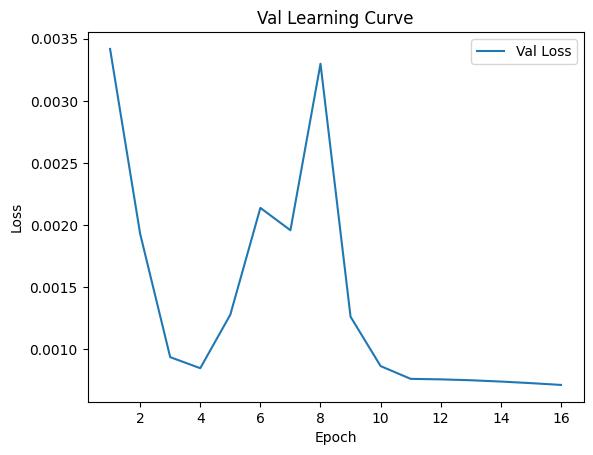


 Epoch: (17/30) Loss = 0.0006992751732468605

 Epoch: (17/30) Loss_rmse = 0.026443811133503914

 Epoch: (17/30) R^2 = 0.943732738494873

 Epoch: (17/30) MAE = 0.024001216515898705
Spearman correlation coefficient: SignificanceResult(statistic=0.9763678000161452, pvalue=3.567e-320)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0

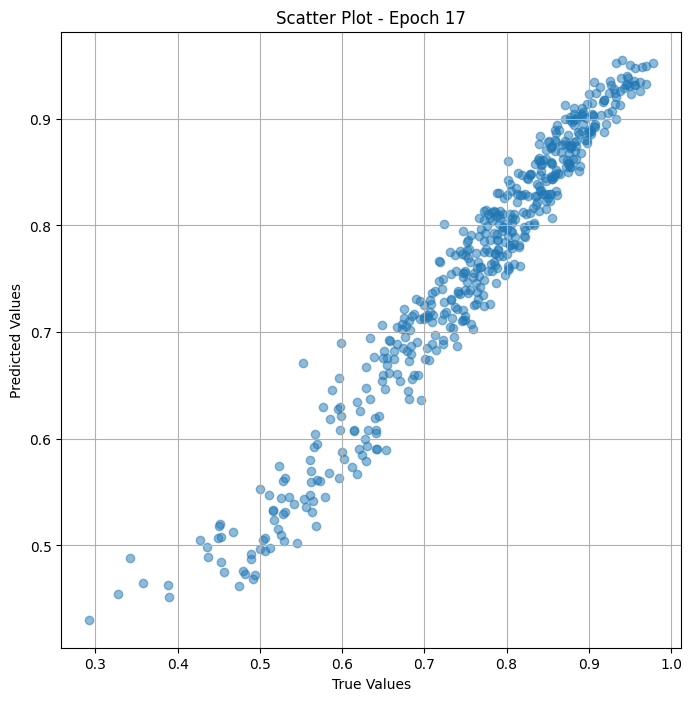

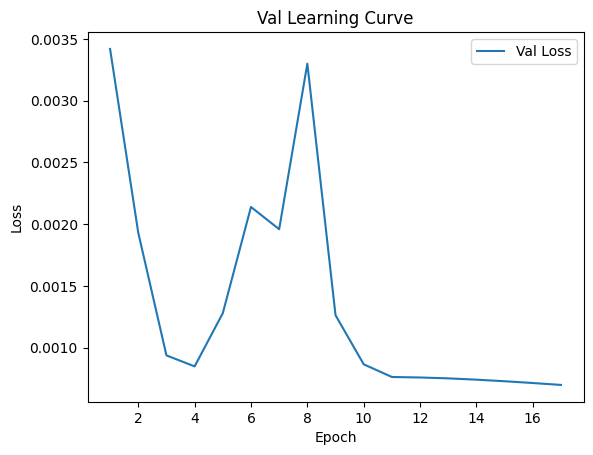


 Epoch: (18/30) Loss = 0.000683129474055022

 Epoch: (18/30) Loss_rmse = 0.026136744767427444

 Epoch: (18/30) R^2 = 0.9450318813323975

 Epoch: (18/30) MAE = 0.023716775700449944
Spearman correlation coefficient: SignificanceResult(statistic=0.9768422241733486, pvalue=2.96e-322)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.

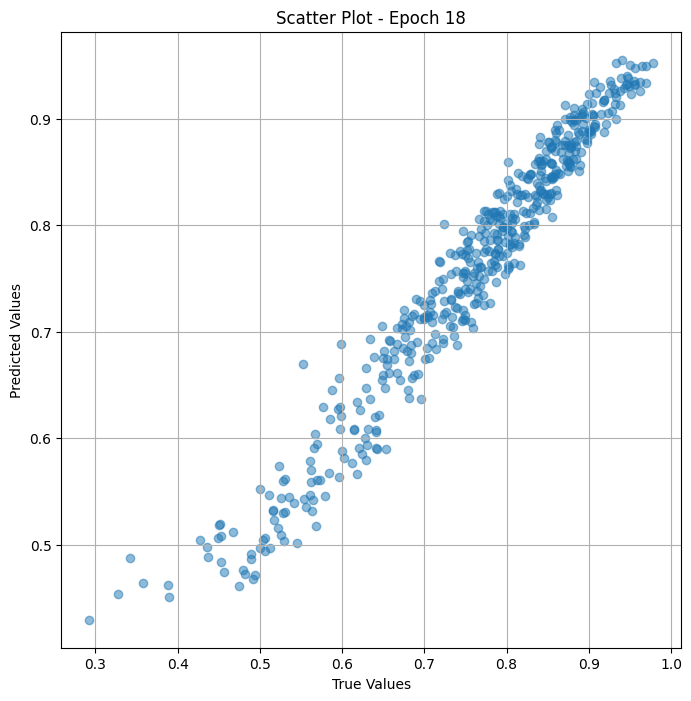

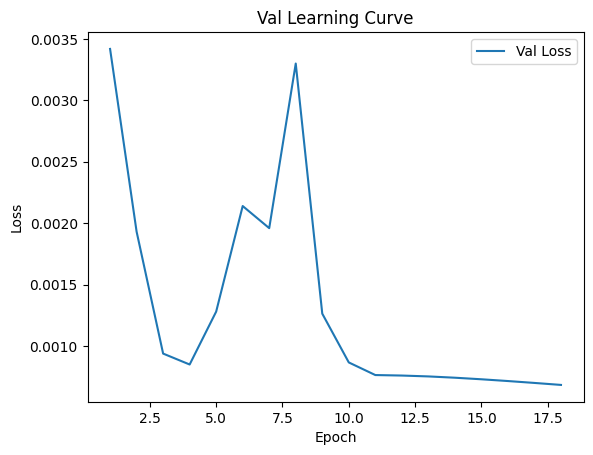


 Epoch: (19/30) Loss = 0.0006665917462669313

 Epoch: (19/30) Loss_rmse = 0.025818437337875366

 Epoch: (19/30) R^2 = 0.9463626146316528

 Epoch: (19/30) MAE = 0.0234182421118021
Spearman correlation coefficient: SignificanceResult(statistic=0.9774761813789911, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

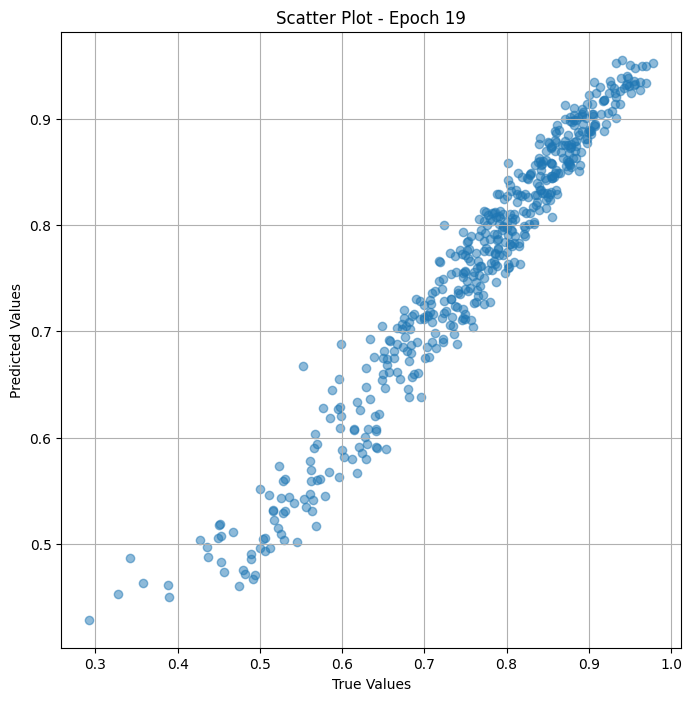

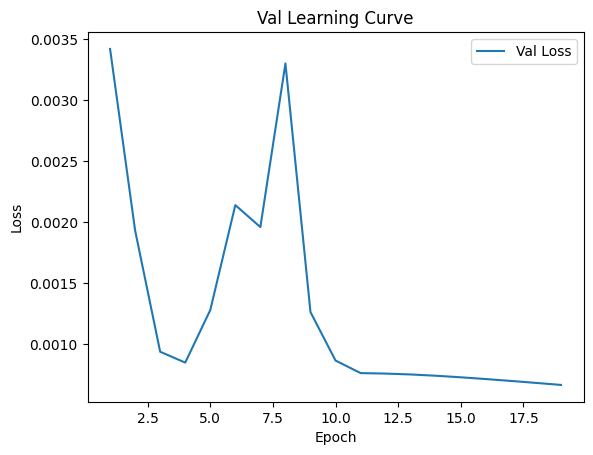


 Epoch: (20/30) Loss = 0.0006500037270598114

 Epoch: (20/30) Loss_rmse = 0.025495171546936035

 Epoch: (20/30) R^2 = 0.9476973414421082

 Epoch: (20/30) MAE = 0.023112798109650612
Spearman correlation coefficient: SignificanceResult(statistic=0.978014596812334, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

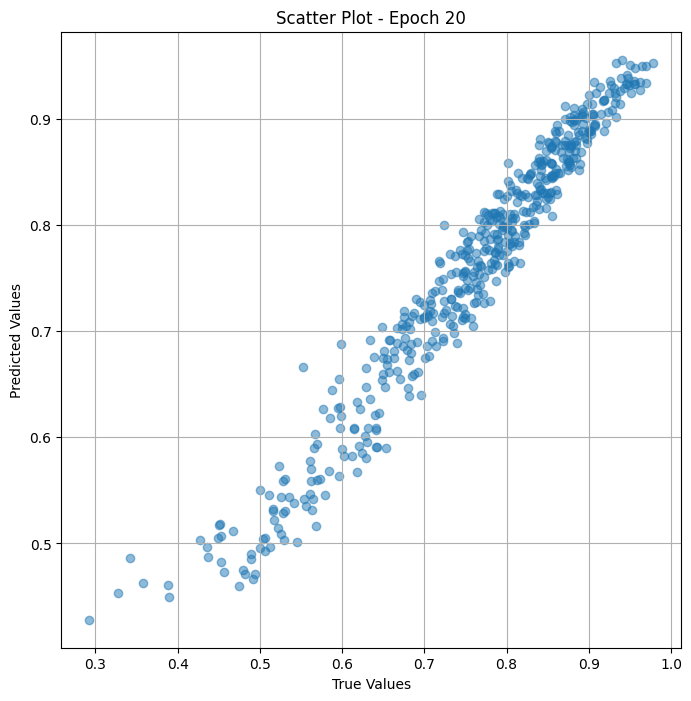

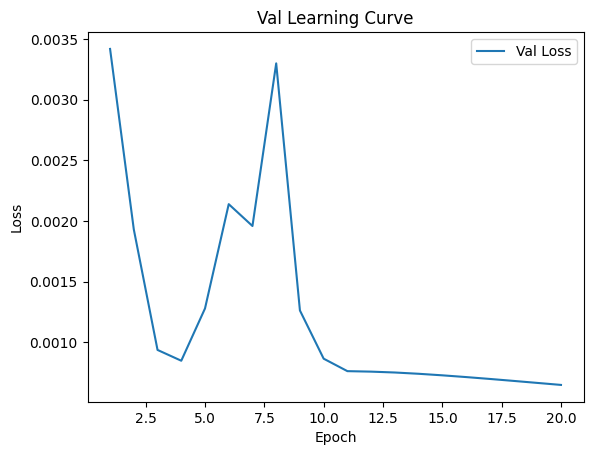


 Epoch: (21/30) Loss = 0.0006335194339044392

 Epoch: (21/30) Loss_rmse = 0.02516981214284897

 Epoch: (21/30) R^2 = 0.9490237832069397

 Epoch: (21/30) MAE = 0.02280399762094021
Spearman correlation coefficient: SignificanceResult(statistic=0.978688756778744, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.857

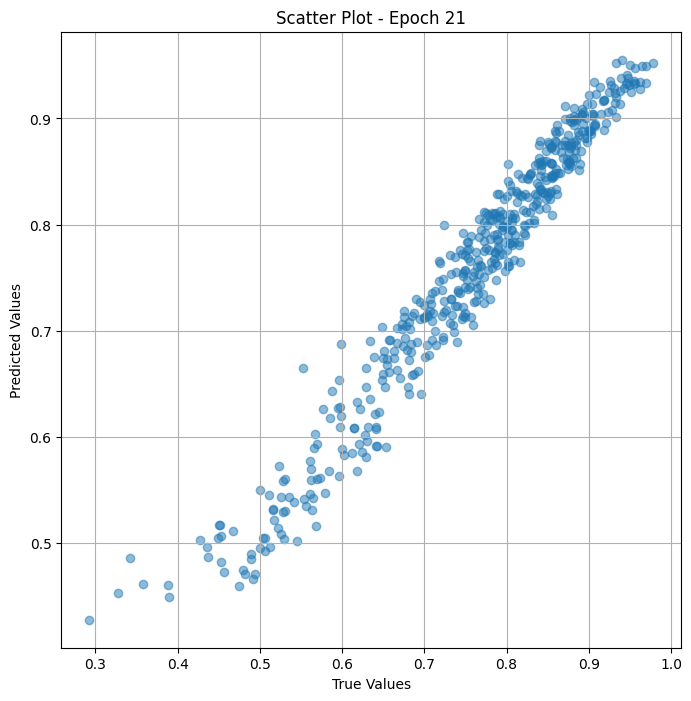

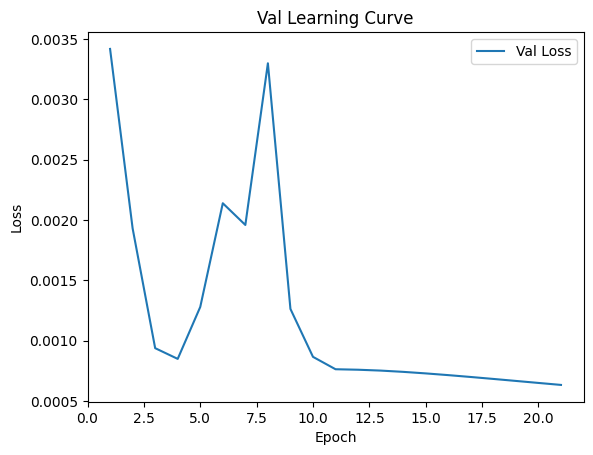


 Epoch: (22/30) Loss = 0.0006171559216454625

 Epoch: (22/30) Loss_rmse = 0.024842623621225357

 Epoch: (22/30) R^2 = 0.9503404498100281

 Epoch: (22/30) MAE = 0.02249232307076454
Spearman correlation coefficient: SignificanceResult(statistic=0.9792021617455385, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

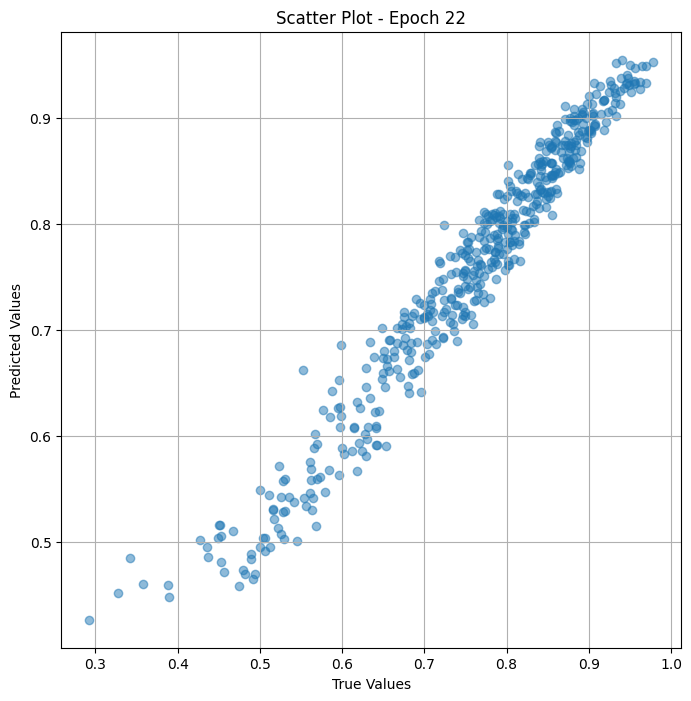

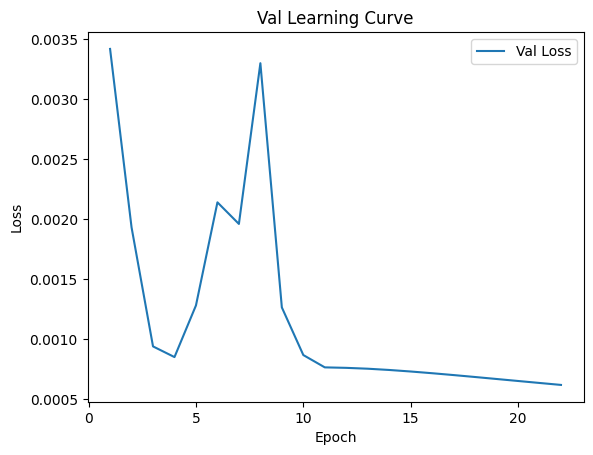


 Epoch: (23/30) Loss = 0.000600967847276479

 Epoch: (23/30) Loss_rmse = 0.02451464533805847

 Epoch: (23/30) R^2 = 0.9516430497169495

 Epoch: (23/30) MAE = 0.022178782150149345
Spearman correlation coefficient: SignificanceResult(statistic=0.9797541412586073, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

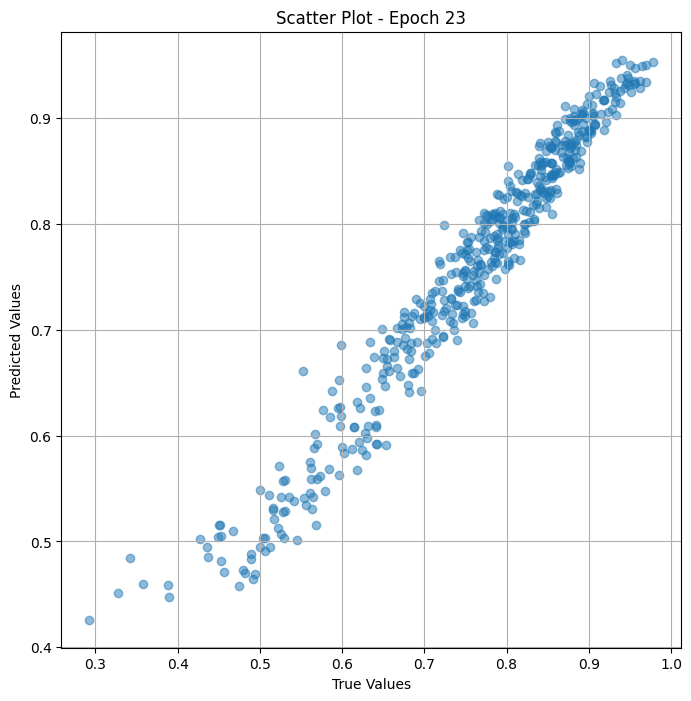

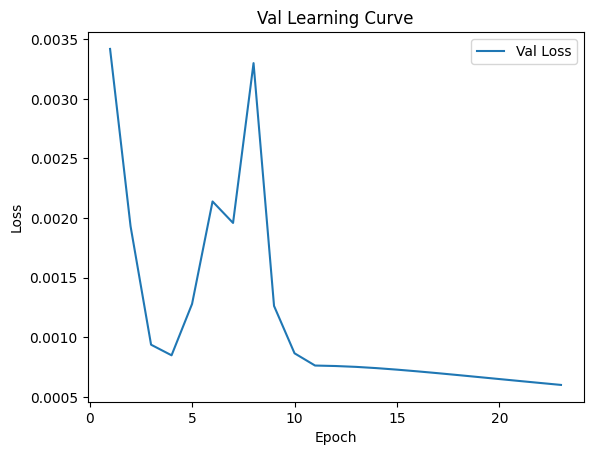


 Epoch: (24/30) Loss = 0.0005850726156495512

 Epoch: (24/30) Loss_rmse = 0.024188274517655373

 Epoch: (24/30) R^2 = 0.9529220461845398

 Epoch: (24/30) MAE = 0.02186591736972332
Spearman correlation coefficient: SignificanceResult(statistic=0.9803693266034751, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

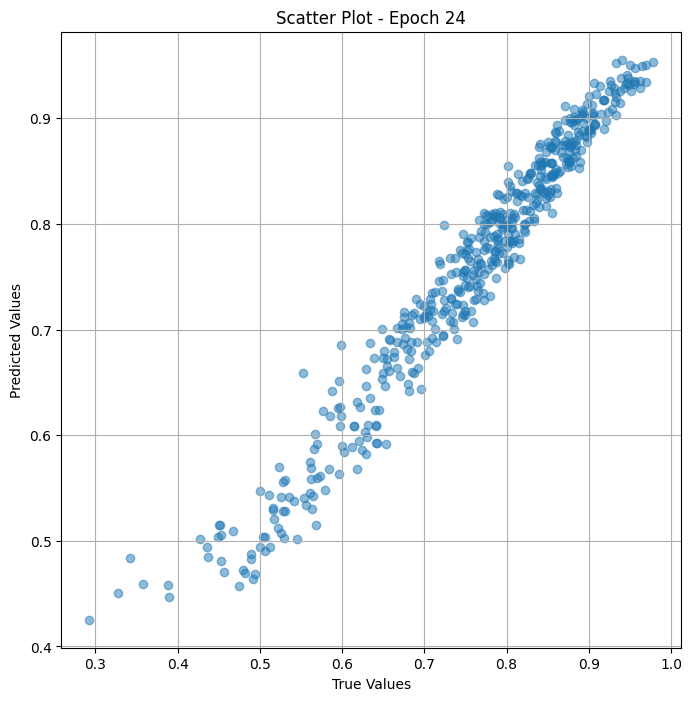

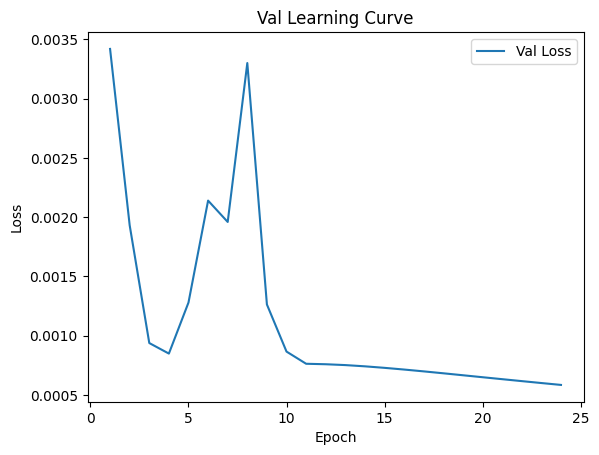


 Epoch: (25/30) Loss = 0.0005694226711057127

 Epoch: (25/30) Loss_rmse = 0.023862577974796295

 Epoch: (25/30) R^2 = 0.9541813135147095

 Epoch: (25/30) MAE = 0.02155291847884655
Spearman correlation coefficient: SignificanceResult(statistic=0.9808493654015518, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

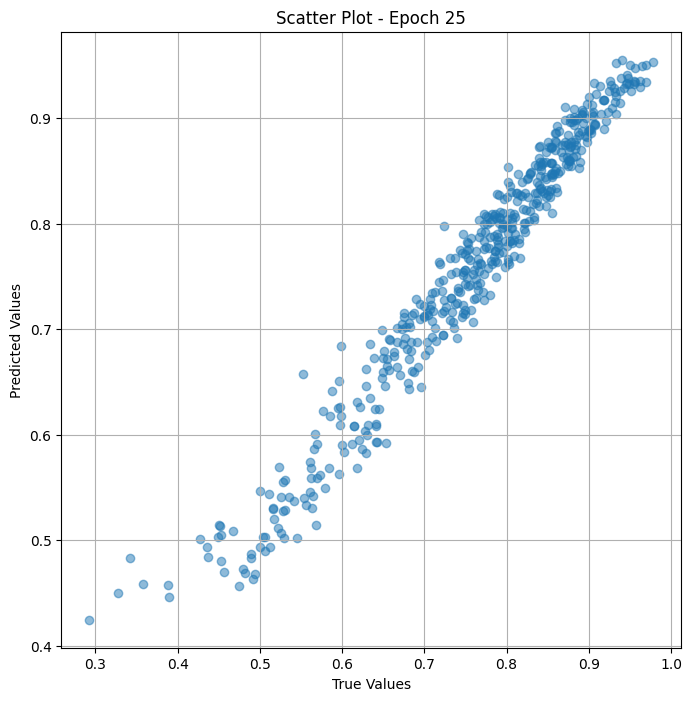

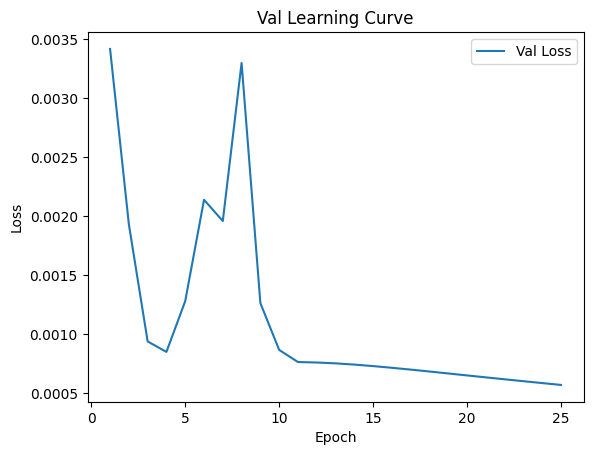


 Epoch: (26/30) Loss = 0.0005538446712307632

 Epoch: (26/30) Loss_rmse = 0.023533904924988747

 Epoch: (26/30) R^2 = 0.9554347991943359

 Epoch: (26/30) MAE = 0.021235326305031776
Spearman correlation coefficient: SignificanceResult(statistic=0.9812967433320376, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

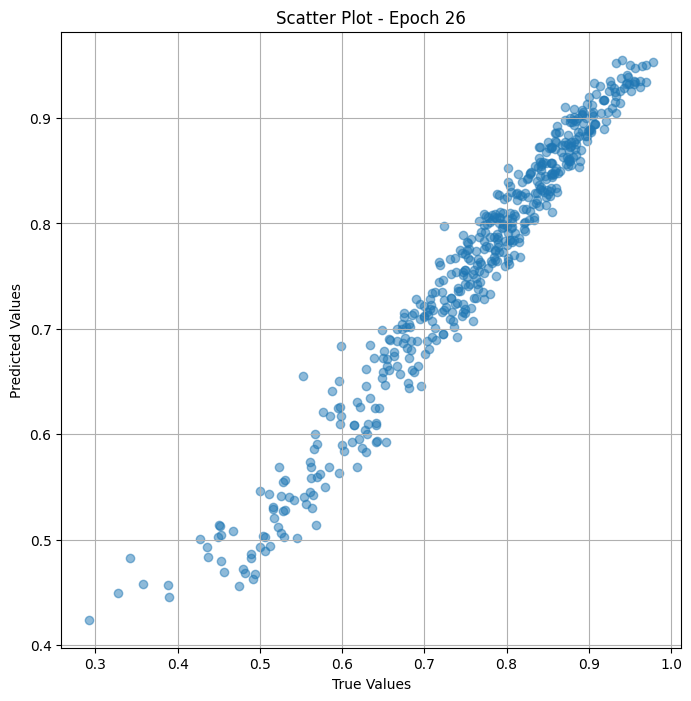

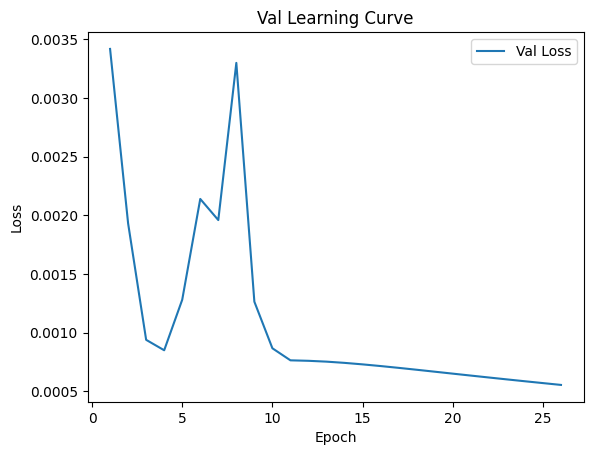


 Epoch: (27/30) Loss = 0.000538559805136174

 Epoch: (27/30) Loss_rmse = 0.023206891492009163

 Epoch: (27/30) R^2 = 0.9566646814346313

 Epoch: (27/30) MAE = 0.020918548107147217
Spearman correlation coefficient: SignificanceResult(statistic=0.9816626861092783, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

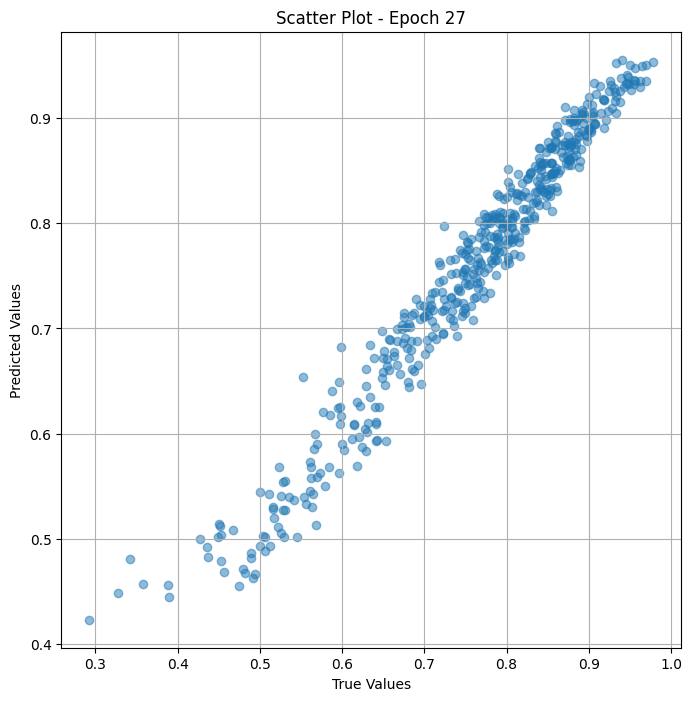

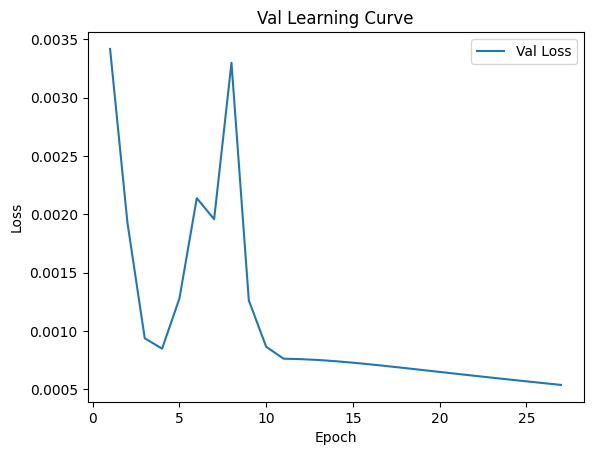


 Epoch: (28/30) Loss = 0.00052362255519256

 Epoch: (28/30) Loss_rmse = 0.022882800549268723

 Epoch: (28/30) R^2 = 0.9578666090965271

 Epoch: (28/30) MAE = 0.020604034885764122
Spearman correlation coefficient: SignificanceResult(statistic=0.9820979654127333, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.85

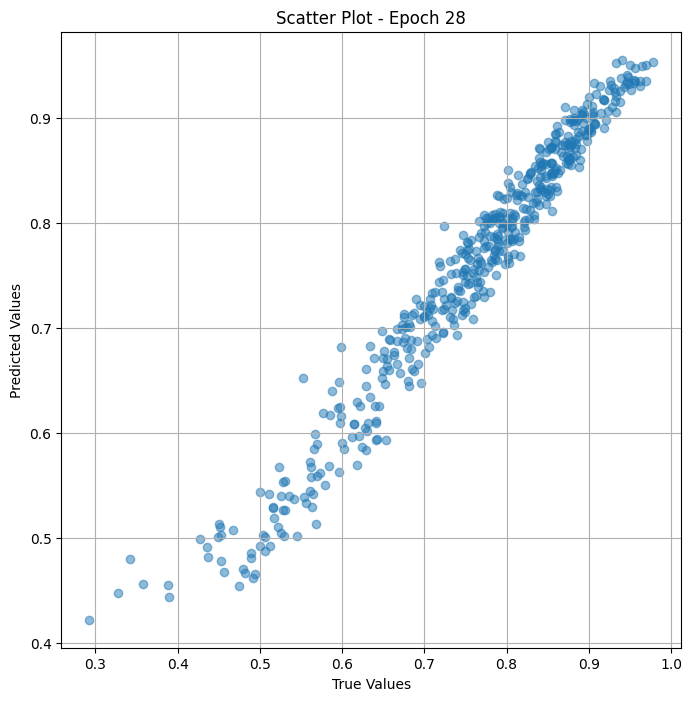

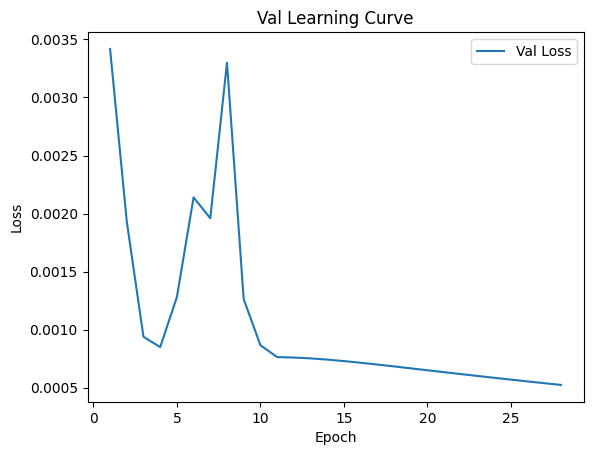


 Epoch: (29/30) Loss = 0.0005089110345579684

 Epoch: (29/30) Loss_rmse = 0.02255905605852604

 Epoch: (29/30) R^2 = 0.9590504169464111

 Epoch: (29/30) MAE = 0.020288867875933647
Spearman correlation coefficient: SignificanceResult(statistic=0.9825419253454483, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.8

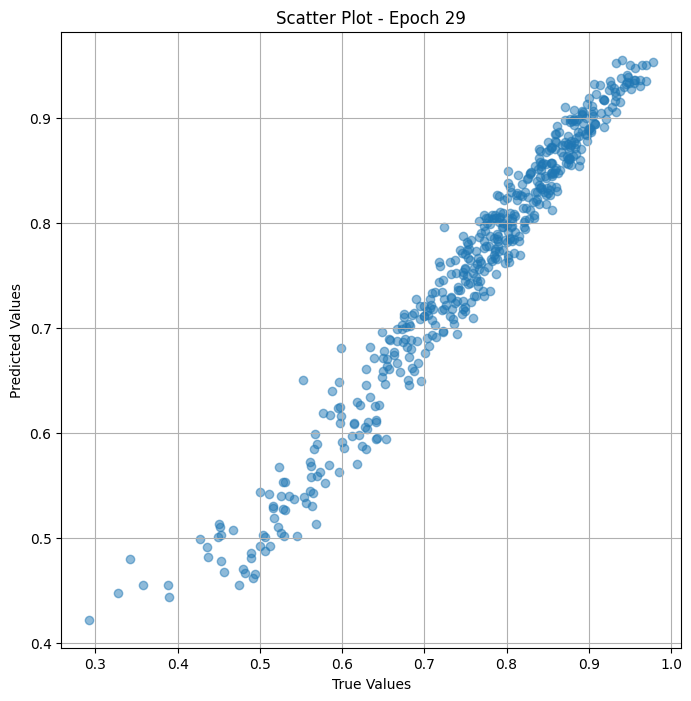

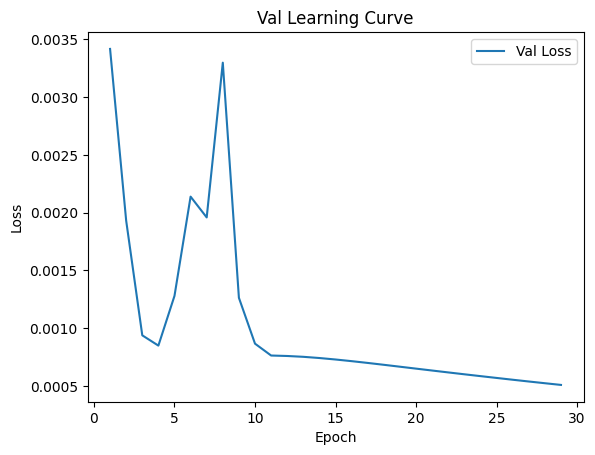


 Epoch: (30/30) Loss = 0.0004943294334225357

 Epoch: (30/30) Loss_rmse = 0.022233519703149796

 Epoch: (30/30) R^2 = 0.9602236747741699

 Epoch: (30/30) MAE = 0.019970932975411415
Spearman correlation coefficient: SignificanceResult(statistic=0.9830238630311755, pvalue=0.0)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.7314815, 0.7032967, 0.75268817, 0.79545456, 0.85555553, 0.88505745, 0.872549, 0.8019802, 0.8545455, 0.8869565, 0.7604167, 0.75, 0.35779816, 0.8737864, 0.59770113, 0.64835167, 0.7777778, 0.72619045, 0.83908045, 0.7027027, 0.6633663, 0.78846157, 0.85365856, 0.56989247, 0.8666667, 0.70652175, 0.8043478, 0.9375, 0.6333333, 0.82, 0.79591835, 0.8064516, 0.92523366, 0.82857144, 0.875, 0.7821782, 0.8411215, 0.8913044, 0.53571427, 0.51578945, 0.6344086, 0.5233645, 0.6759259, 0.89285713, 0.79, 0.8958333, 0.8348624, 0.82222223, 0.8787879, 0.8556701, 0.7920792, 0.6495727, 0.74038464, 0.91346157, 0.8041237, 0.7525773, 0.59821427, 0.8, 0.

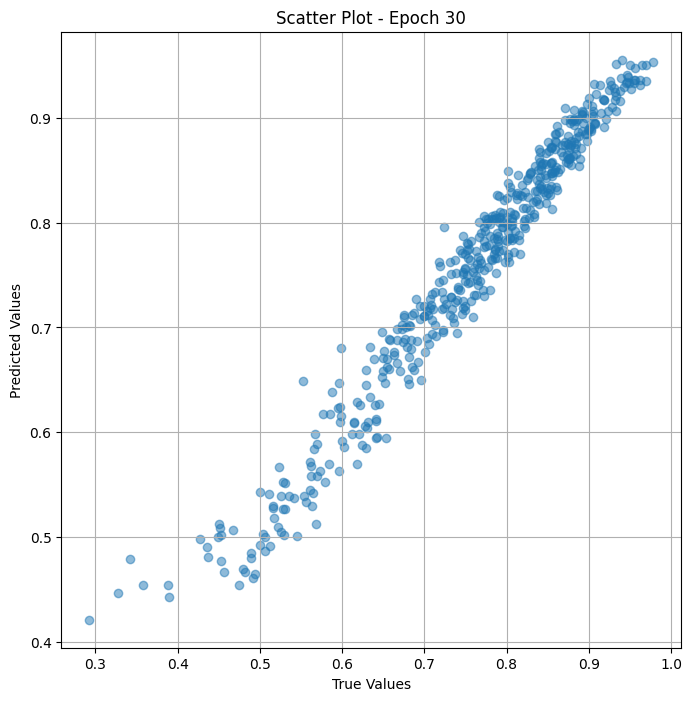

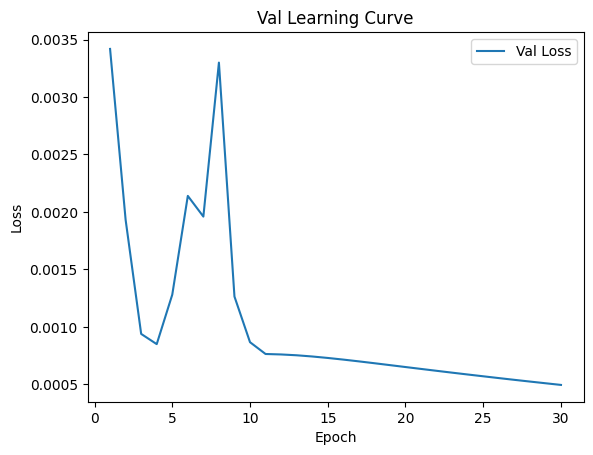

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.0006168236141093075

 Epoch: (1/30) Loss_rmse = 0.02483593299984932

 Epoch: (1/30) R^2 = 0.9363417029380798

 Epoch: (1/30) MAE = 0.017262892797589302
Spearman correlation coefficient: SignificanceResult(statistic=0.9624642572042077, pvalue=7.087947734658996e-273)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942528

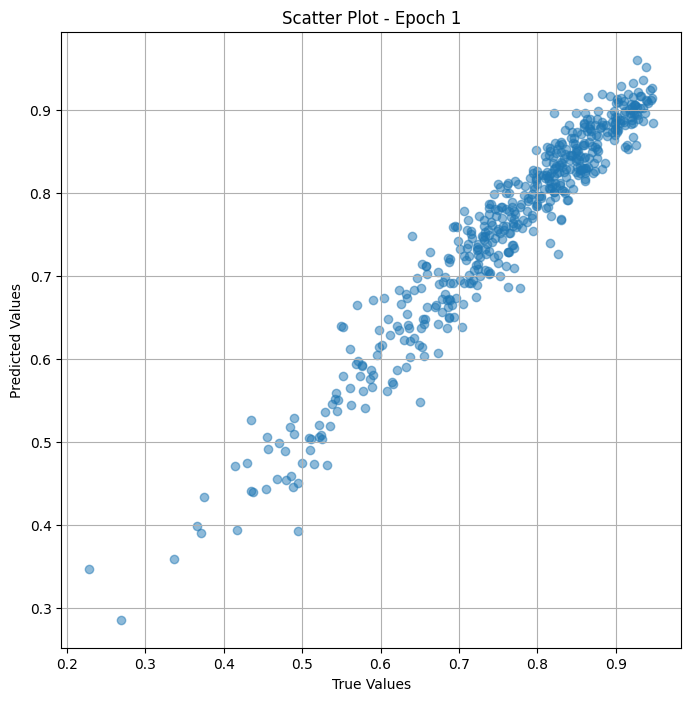

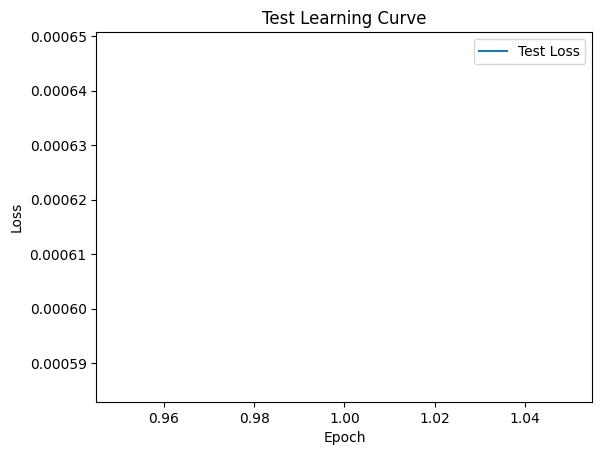


 Epoch: (2/30) Loss = 0.0007790561649017036

 Epoch: (2/30) Loss_rmse = 0.027911577373743057

 Epoch: (2/30) R^2 = 0.9195986986160278

 Epoch: (2/30) MAE = 0.023451542481780052
Spearman correlation coefficient: SignificanceResult(statistic=0.9264960197500165, pvalue=5.045228105525497e-205)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

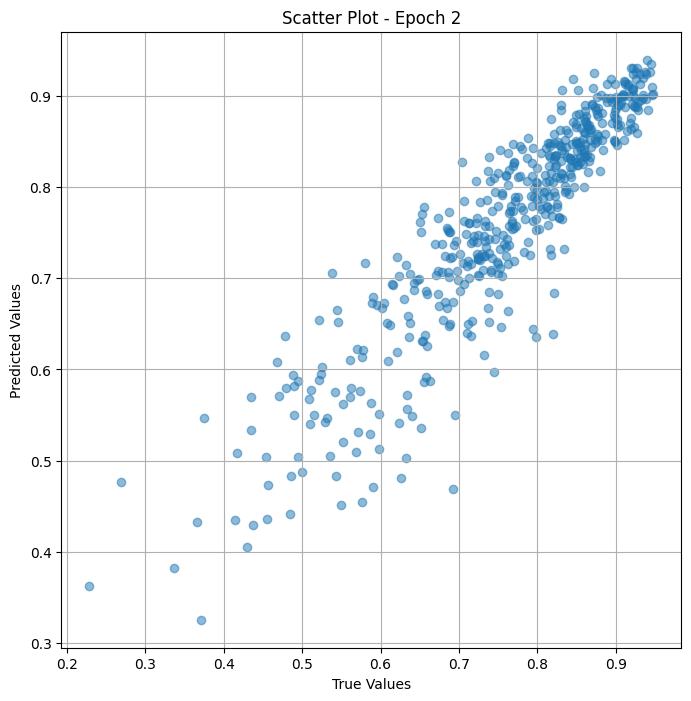

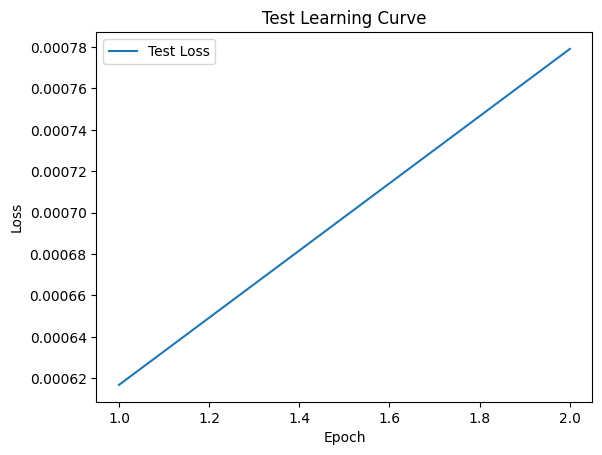


 Epoch: (3/30) Loss = 0.0005791290896013379

 Epoch: (3/30) Loss_rmse = 0.024065101519227028

 Epoch: (3/30) R^2 = 0.9402318596839905

 Epoch: (3/30) MAE = 0.018514350056648254
Spearman correlation coefficient: SignificanceResult(statistic=0.9516843092222038, pvalue=3.078771324315519e-247)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

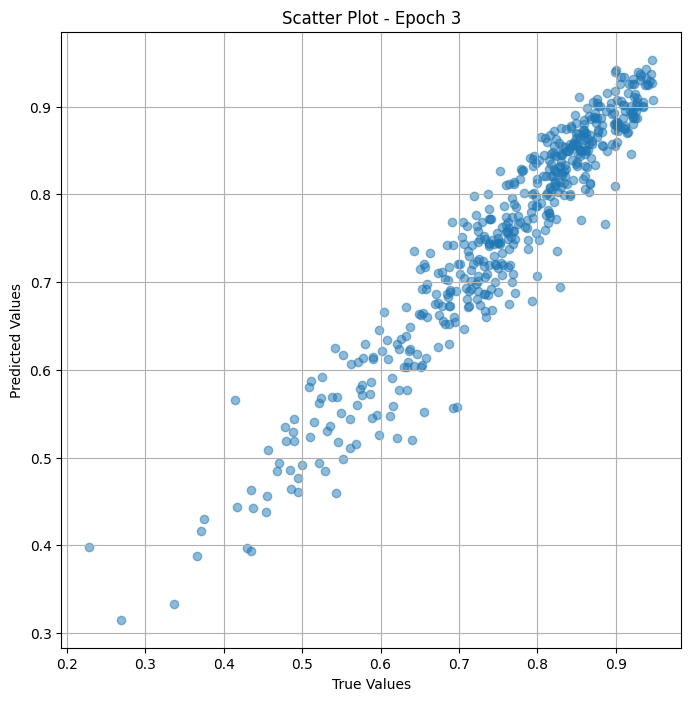

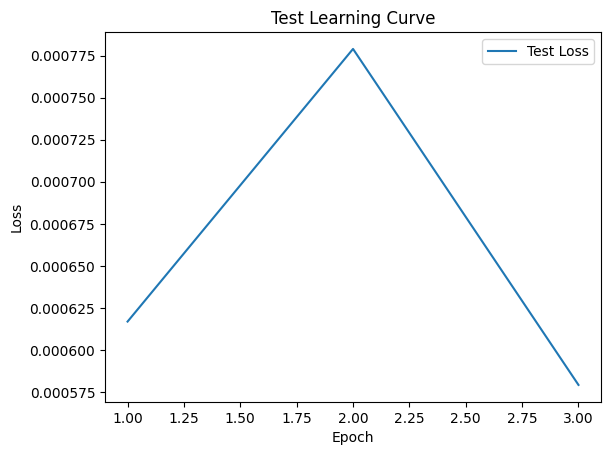


 Epoch: (4/30) Loss = 0.004291251301765442

 Epoch: (4/30) Loss_rmse = 0.06550764292478561

 Epoch: (4/30) R^2 = 0.5571280717849731

 Epoch: (4/30) MAE = 0.05667863041162491
Spearman correlation coefficient: SignificanceResult(statistic=0.9431665574316297, pvalue=7.790083890075848e-231)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286,

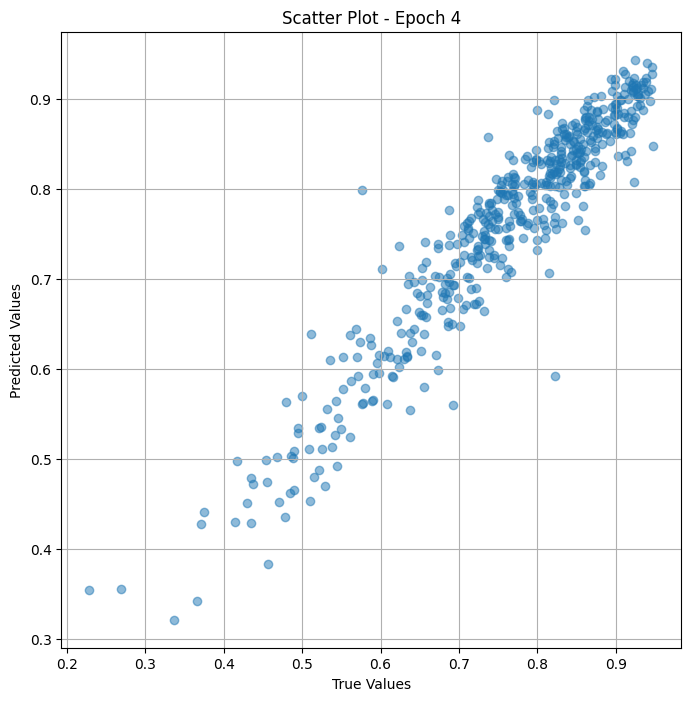

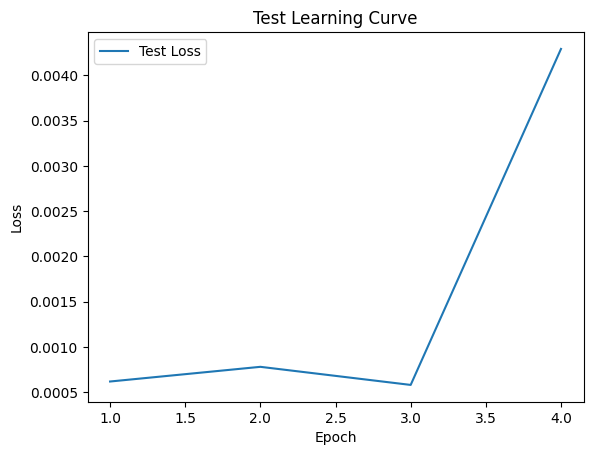


 Epoch: (5/30) Loss = 0.0009112024563364685

 Epoch: (5/30) Loss_rmse = 0.030186129733920097

 Epoch: (5/30) R^2 = 0.9059607982635498

 Epoch: (5/30) MAE = 0.026212632656097412
Spearman correlation coefficient: SignificanceResult(statistic=0.9664657808036374, pvalue=2.2881062544282074e-284)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425

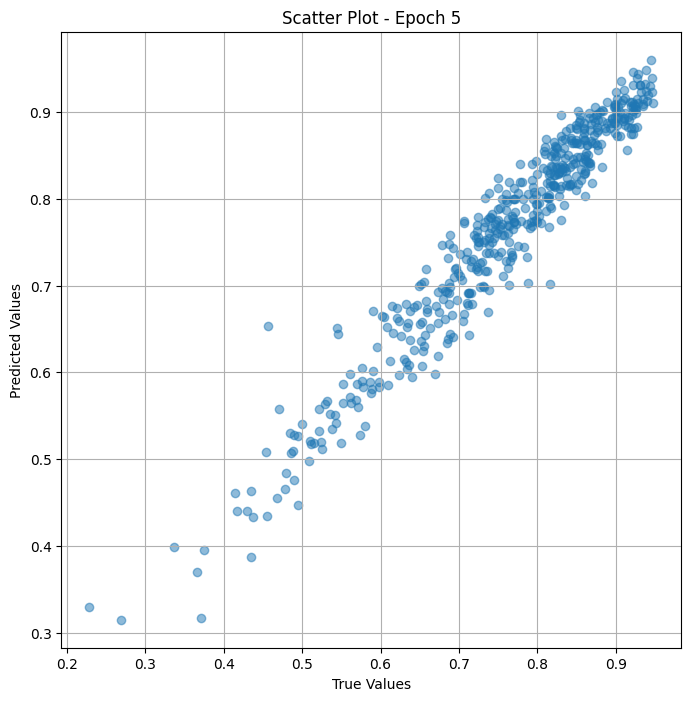

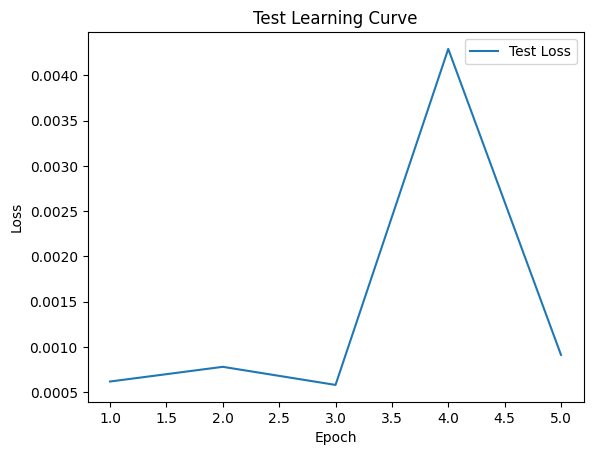

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/30) Loss = 0.0014984614681452513

 Epoch: (6/30) Loss_rmse = 0.038709964603185654

 Epoch: (6/30) R^2 = 0.8453536033630371

 Epoch: (6/30) MAE = 0.032898690551519394
Spearman correlation coefficient: SignificanceResult(statistic=0.924340512809549, pvalue=3.870290597251507e-202)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.919

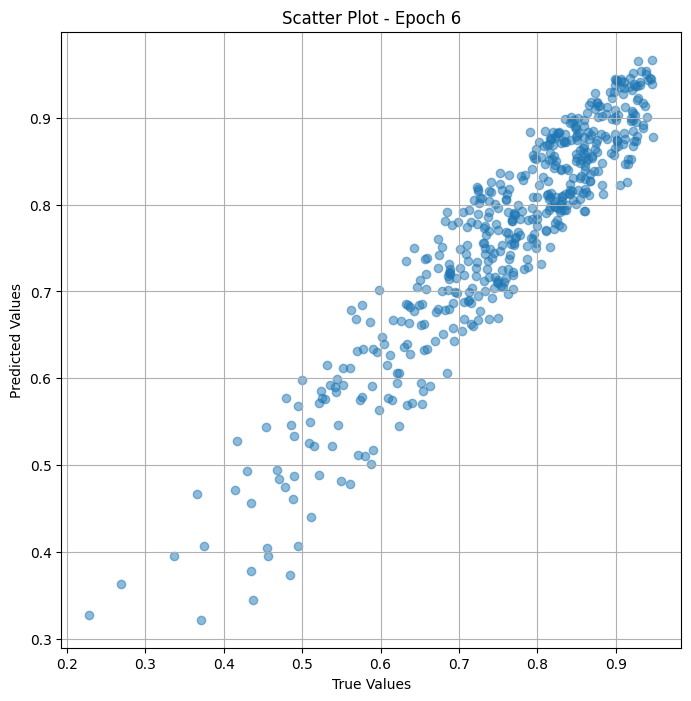

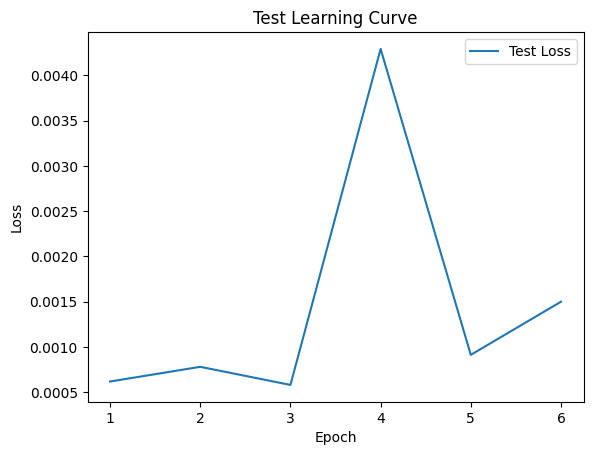


 Epoch: (7/30) Loss = 0.002230970188975334

 Epoch: (7/30) Loss_rmse = 0.04723314568400383

 Epoch: (7/30) R^2 = 0.7697561979293823

 Epoch: (7/30) MAE = 0.04119909927248955
Spearman correlation coefficient: SignificanceResult(statistic=0.9072116925423297, pvalue=7.084687269188605e-182)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286,

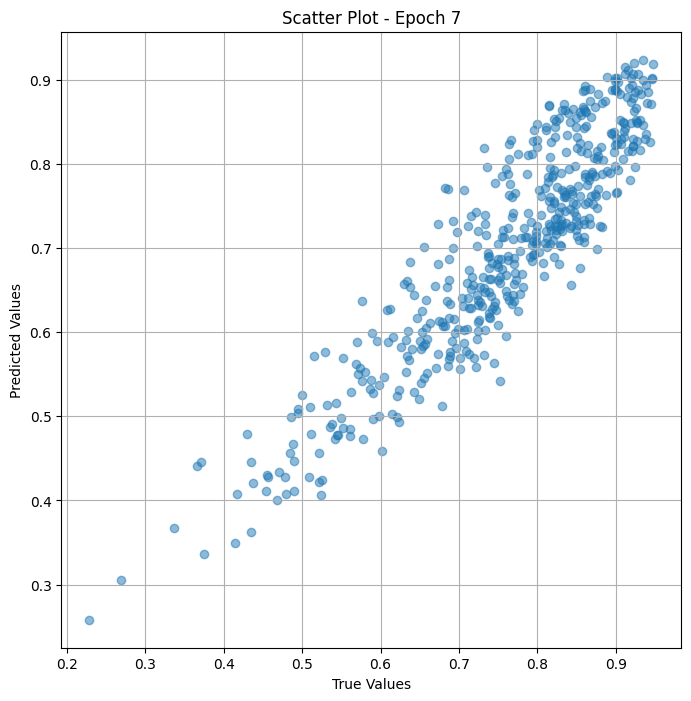

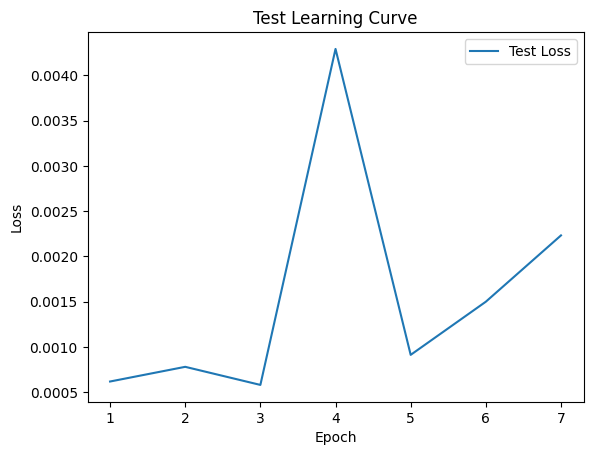


 Epoch: (8/30) Loss = 0.004109779838472605

 Epoch: (8/30) Loss_rmse = 0.06410756707191467

 Epoch: (8/30) R^2 = 0.5758565664291382

 Epoch: (8/30) MAE = 0.05892658233642578
Spearman correlation coefficient: SignificanceResult(statistic=0.95542343287763, pvalue=2.1122911091329852e-255)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425286, 

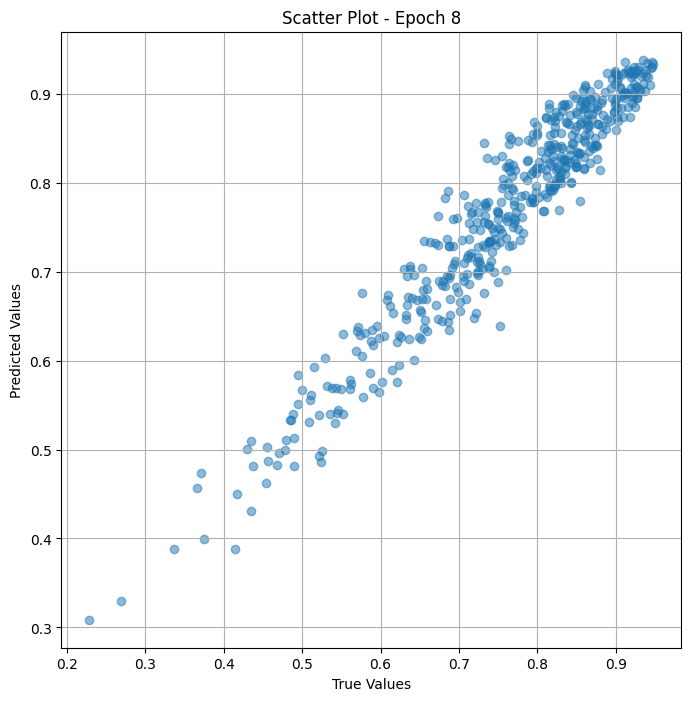

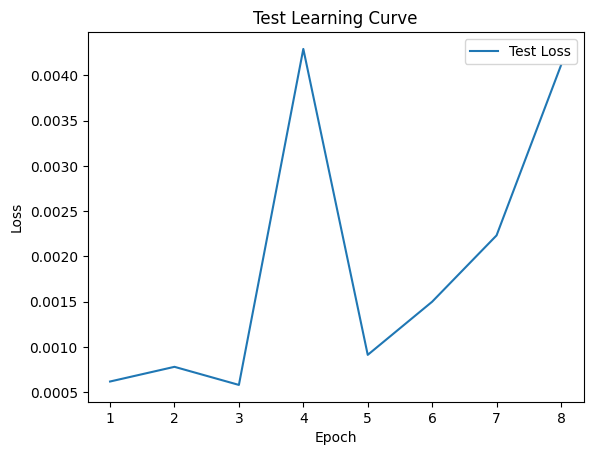

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (9/30) Loss = 0.002244807779788971

 Epoch: (9/30) Loss_rmse = 0.04737940430641174

 Epoch: (9/30) R^2 = 0.7683281302452087

 Epoch: (9/30) MAE = 0.04295635595917702
Spearman correlation coefficient: SignificanceResult(statistic=0.9664857462341456, pvalue=1.989321300669977e-284)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.91919

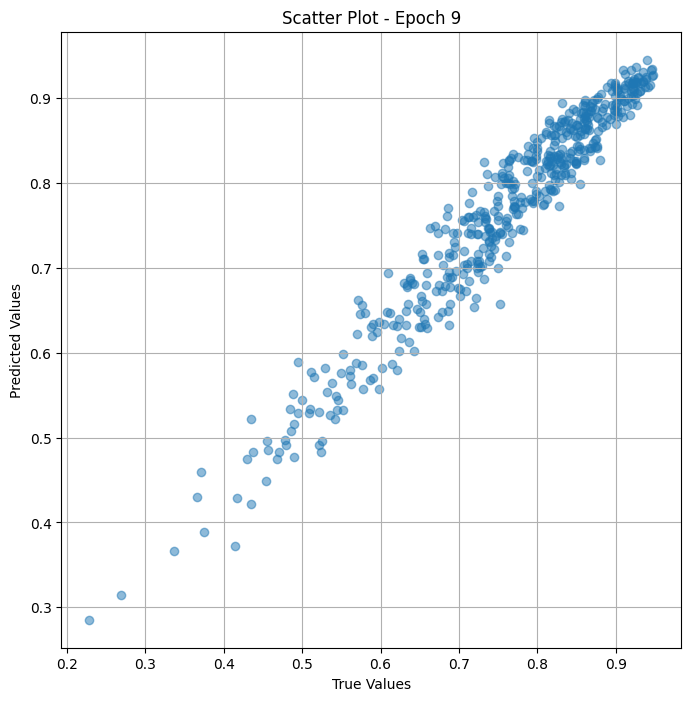

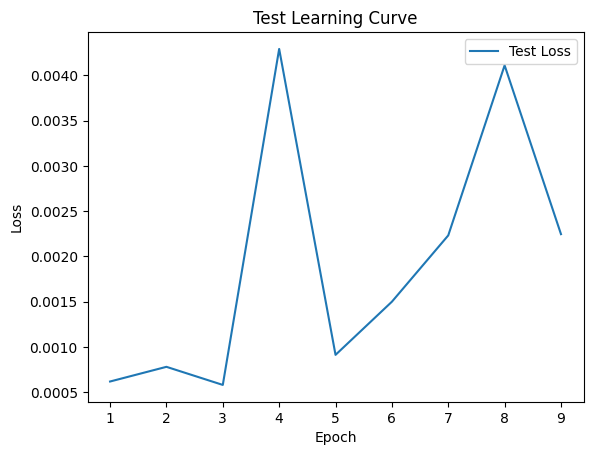


 Epoch: (10/30) Loss = 0.001964711816981435

 Epoch: (10/30) Loss_rmse = 0.04432506859302521

 Epoch: (10/30) R^2 = 0.7972350120544434

 Epoch: (10/30) MAE = 0.040011730045080185
Spearman correlation coefficient: SignificanceResult(statistic=0.9715825734180186, pvalue=2.7669291914468647e-301)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

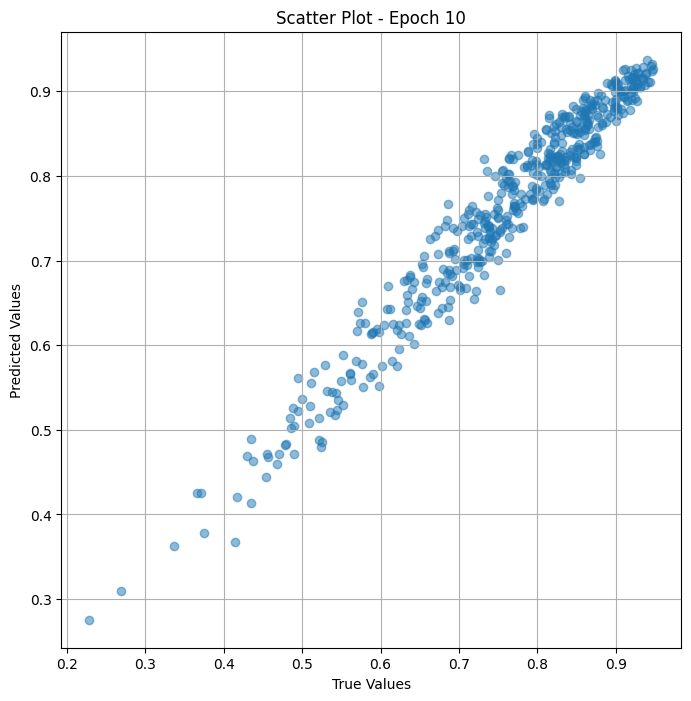

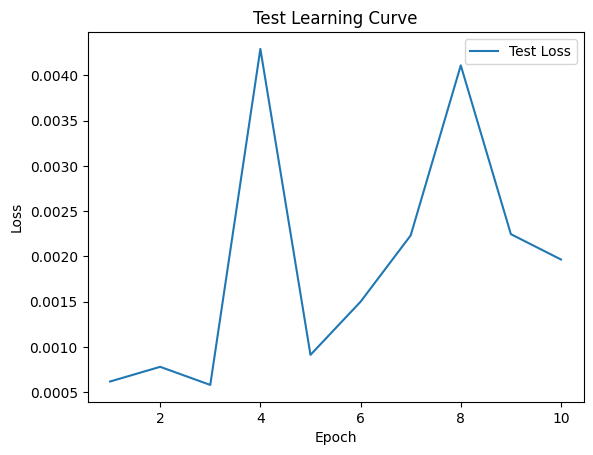


 Epoch: (11/30) Loss = 0.00189265760127455

 Epoch: (11/30) Loss_rmse = 0.043504685163497925

 Epoch: (11/30) R^2 = 0.8046712279319763

 Epoch: (11/30) MAE = 0.039248865097761154
Spearman correlation coefficient: SignificanceResult(statistic=0.9720697190716422, pvalue=4.706171113977128e-303)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942

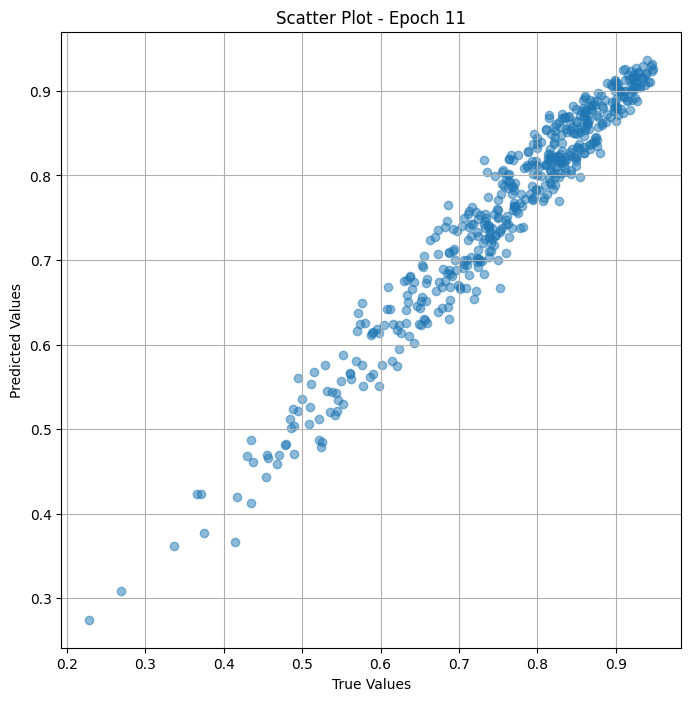

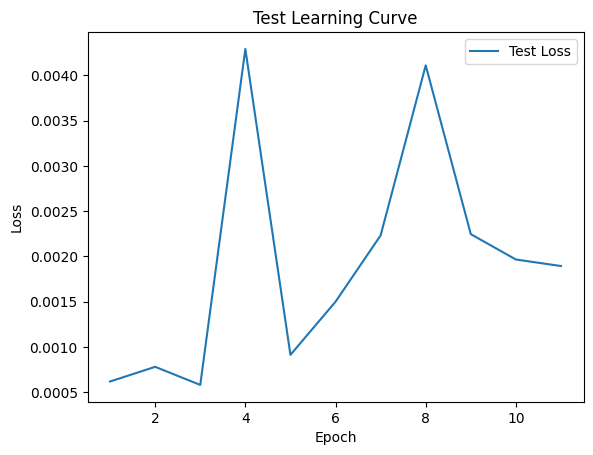

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (12/30) Loss = 0.0018334815977141261

 Epoch: (12/30) Loss_rmse = 0.04281917214393616

 Epoch: (12/30) R^2 = 0.8107783794403076

 Epoch: (12/30) MAE = 0.03861922770738602
Spearman correlation coefficient: SignificanceResult(statistic=0.9724581226504694, pvalue=1.7353788761663885e-304)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0

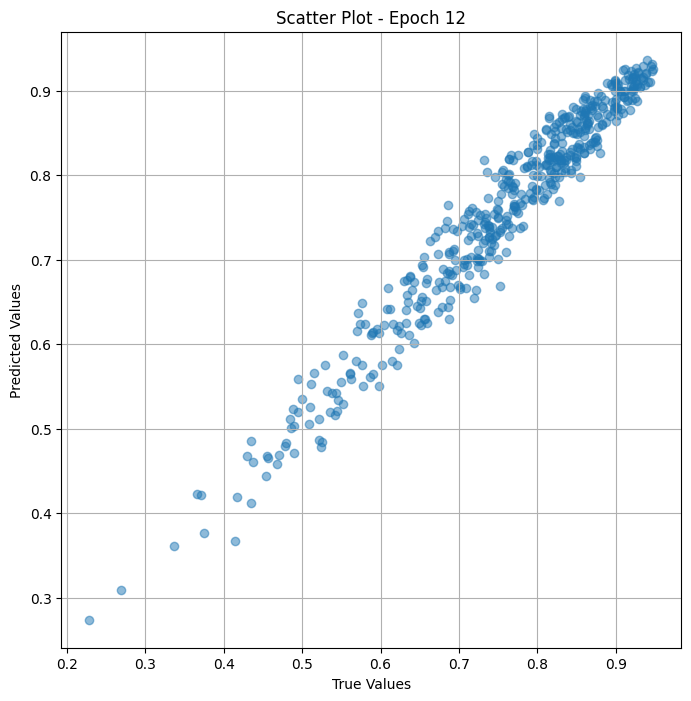

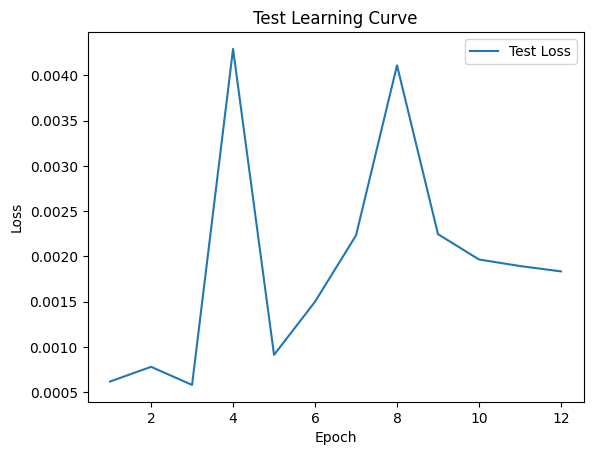


 Epoch: (13/30) Loss = 0.0018184640211984515

 Epoch: (13/30) Loss_rmse = 0.04264345392584801

 Epoch: (13/30) R^2 = 0.8123282790184021

 Epoch: (13/30) MAE = 0.038454268127679825
Spearman correlation coefficient: SignificanceResult(statistic=0.9731511075523215, pvalue=4.27065371624403e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942

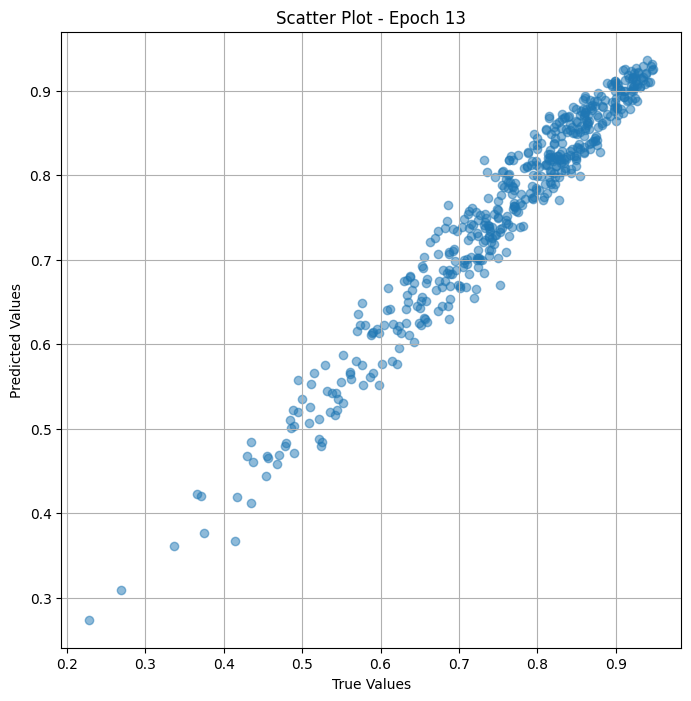

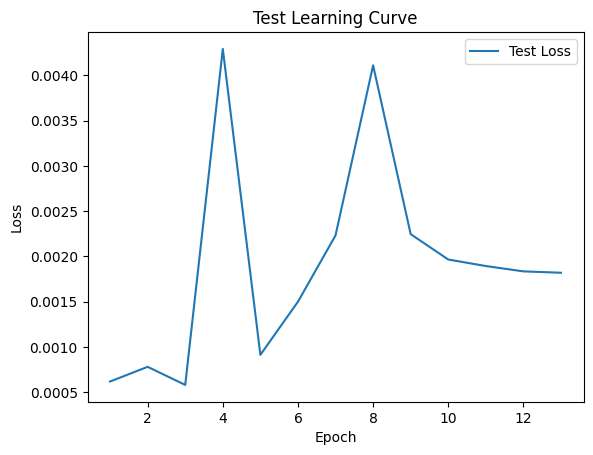


 Epoch: (14/30) Loss = 0.0018129261443391442

 Epoch: (14/30) Loss_rmse = 0.04257846996188164

 Epoch: (14/30) R^2 = 0.8128997683525085

 Epoch: (14/30) MAE = 0.038394901901483536
Spearman correlation coefficient: SignificanceResult(statistic=0.9731817609986182, pvalue=3.2622778612923172e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

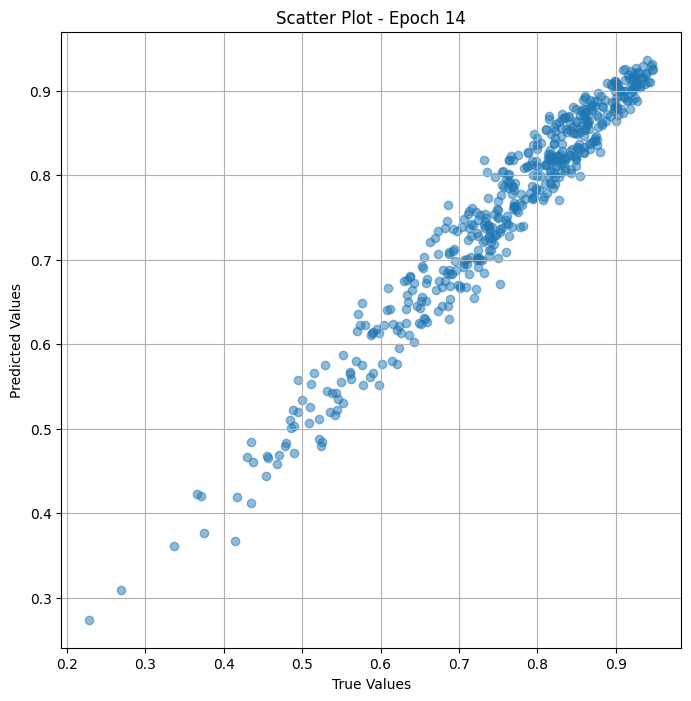

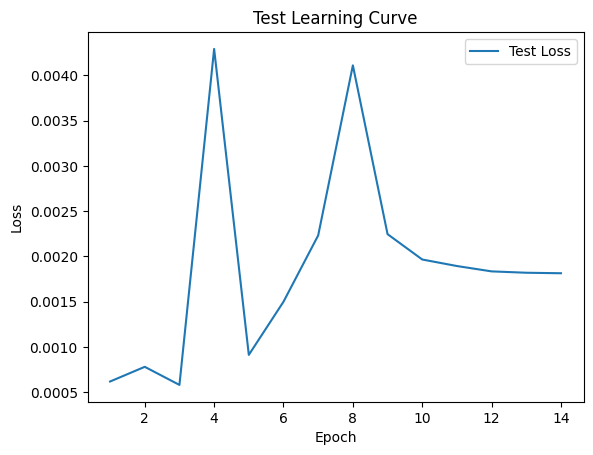

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (15/30) Loss = 0.0018073248211294413

 Epoch: (15/30) Loss_rmse = 0.042512644082307816

 Epoch: (15/30) R^2 = 0.8134778738021851

 Epoch: (15/30) MAE = 0.038334790617227554
Spearman correlation coefficient: SignificanceResult(statistic=0.9732239705228992, pvalue=2.250233410207875e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 

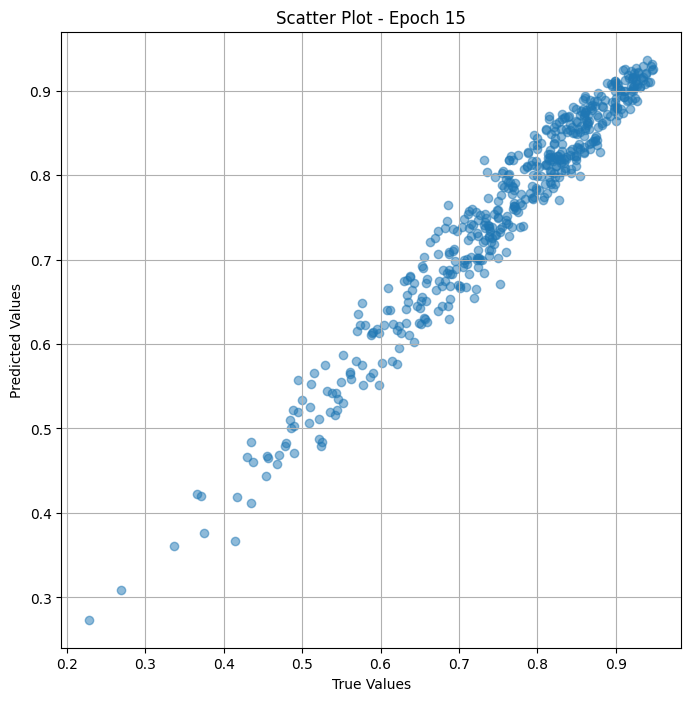

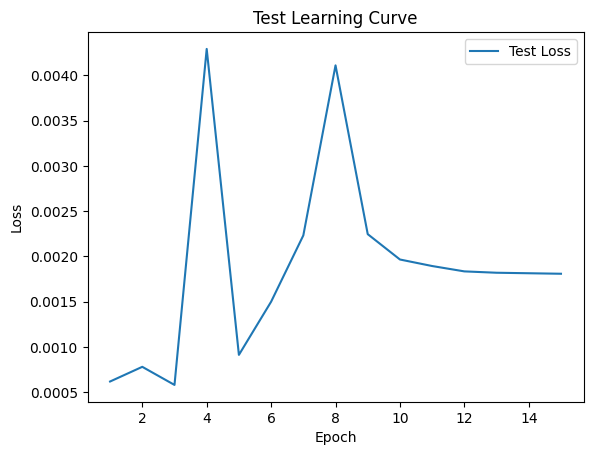


 Epoch: (16/30) Loss = 0.0018058893037959933

 Epoch: (16/30) Loss_rmse = 0.04249575734138489

 Epoch: (16/30) R^2 = 0.8136260509490967

 Epoch: (16/30) MAE = 0.03831887245178223
Spearman correlation coefficient: SignificanceResult(statistic=0.9732461061088975, pvalue=1.8515641692860094e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

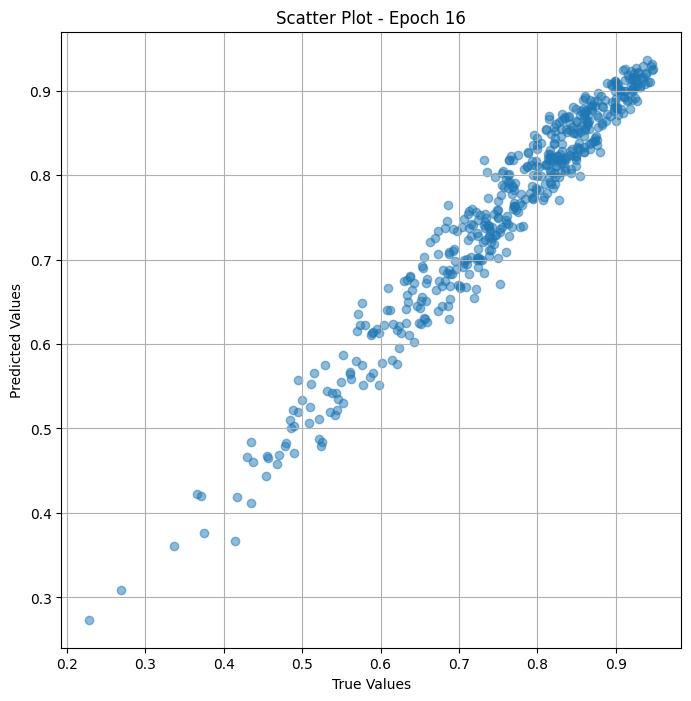

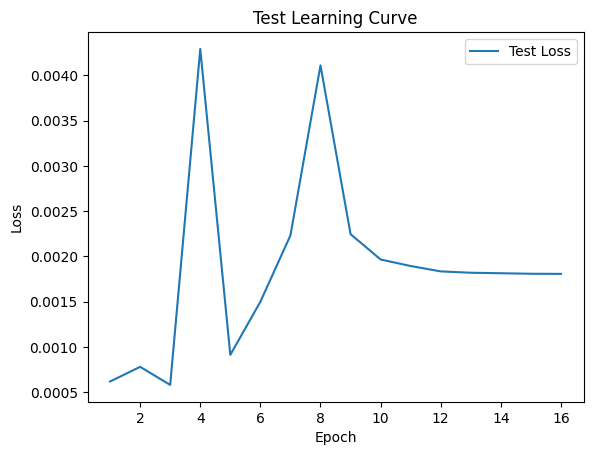


 Epoch: (17/30) Loss = 0.0018054668325930834

 Epoch: (17/30) Loss_rmse = 0.04249078407883644

 Epoch: (17/30) R^2 = 0.8136696219444275

 Epoch: (17/30) MAE = 0.03831430524587631
Spearman correlation coefficient: SignificanceResult(statistic=0.9732461061088975, pvalue=1.8515641692860094e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

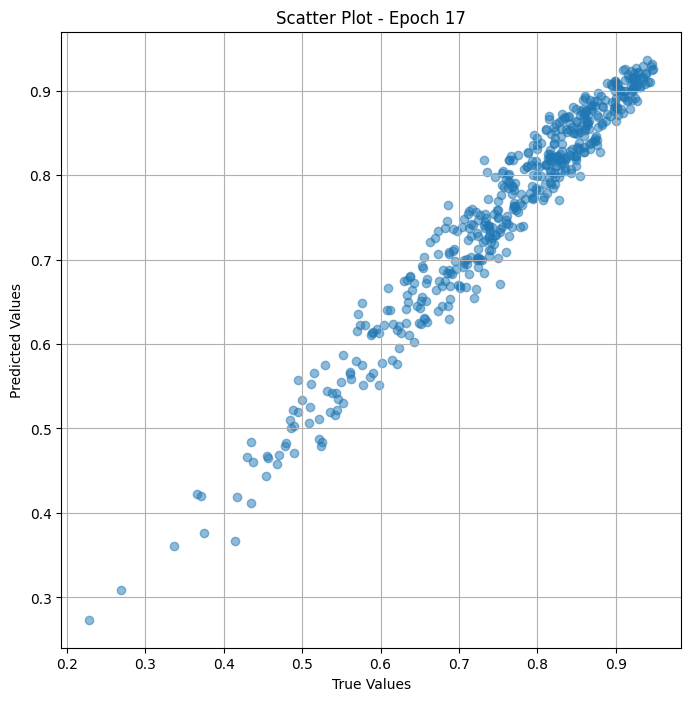

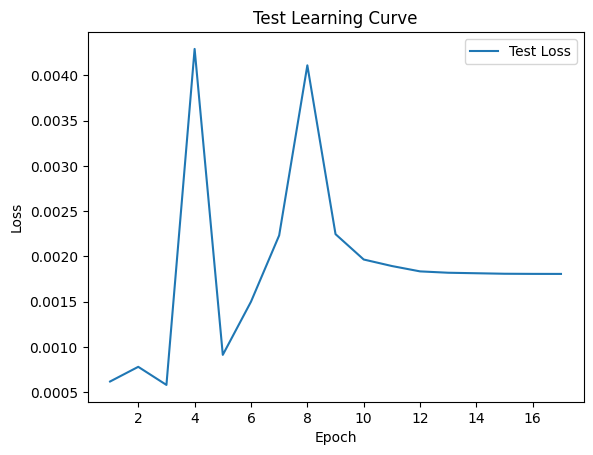


 Epoch: (18/30) Loss = 0.0018050328362733126

 Epoch: (18/30) Loss_rmse = 0.04248567670583725

 Epoch: (18/30) R^2 = 0.8137143850326538

 Epoch: (18/30) MAE = 0.03830961510539055
Spearman correlation coefficient: SignificanceResult(statistic=0.9732461061088975, pvalue=1.8515641692860094e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494

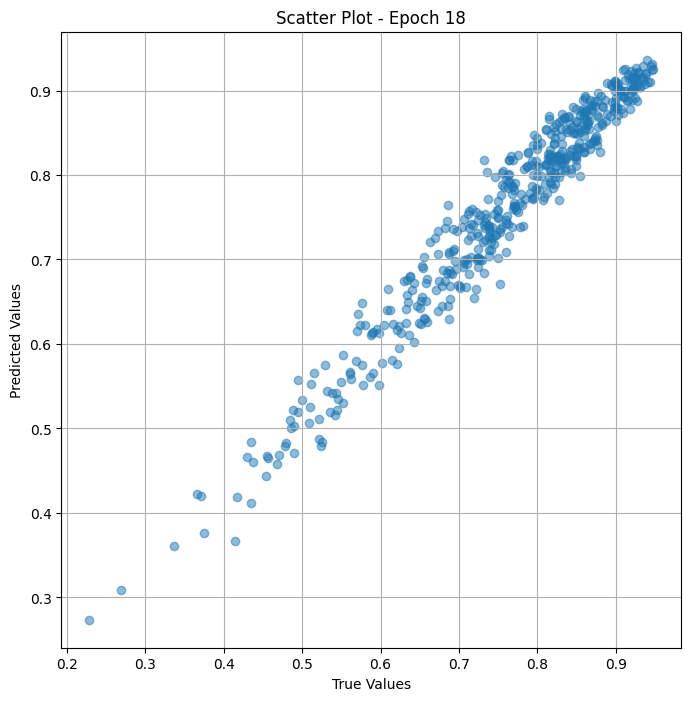

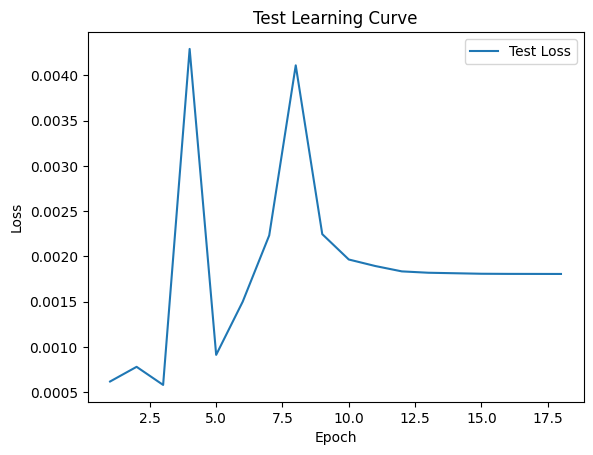


 Epoch: (19/30) Loss = 0.0018045873148366809

 Epoch: (19/30) Loss_rmse = 0.042480435222387314

 Epoch: (19/30) R^2 = 0.8137603998184204

 Epoch: (19/30) MAE = 0.038304802030324936
Spearman correlation coefficient: SignificanceResult(statistic=0.9732466486477699, pvalue=1.842731968428472e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

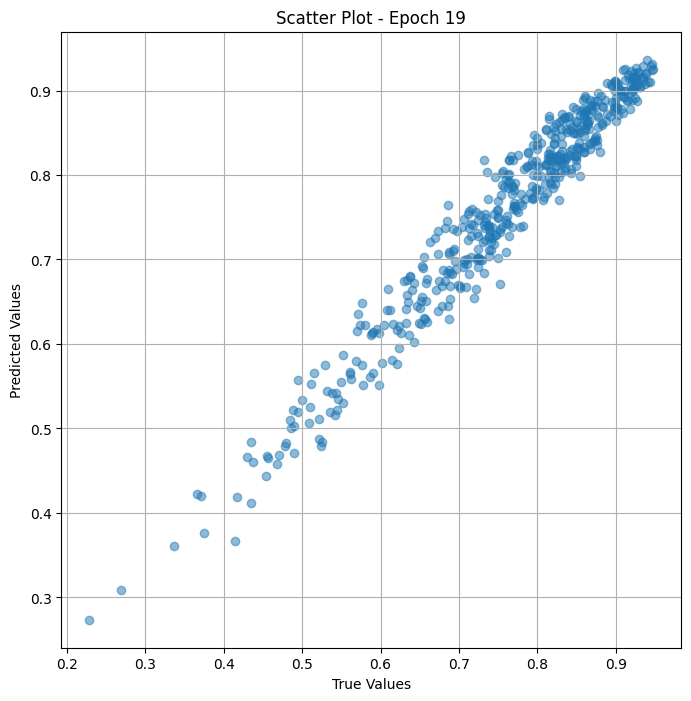

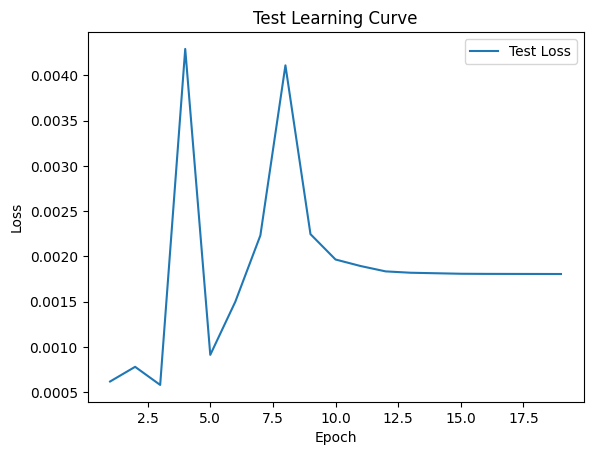


 Epoch: (20/30) Loss = 0.0018041309667751193

 Epoch: (20/30) Loss_rmse = 0.04247506335377693

 Epoch: (20/30) R^2 = 0.813807487487793

 Epoch: (20/30) MAE = 0.03829987347126007
Spearman correlation coefficient: SignificanceResult(statistic=0.9732591812957249, pvalue=1.6499883433345352e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942

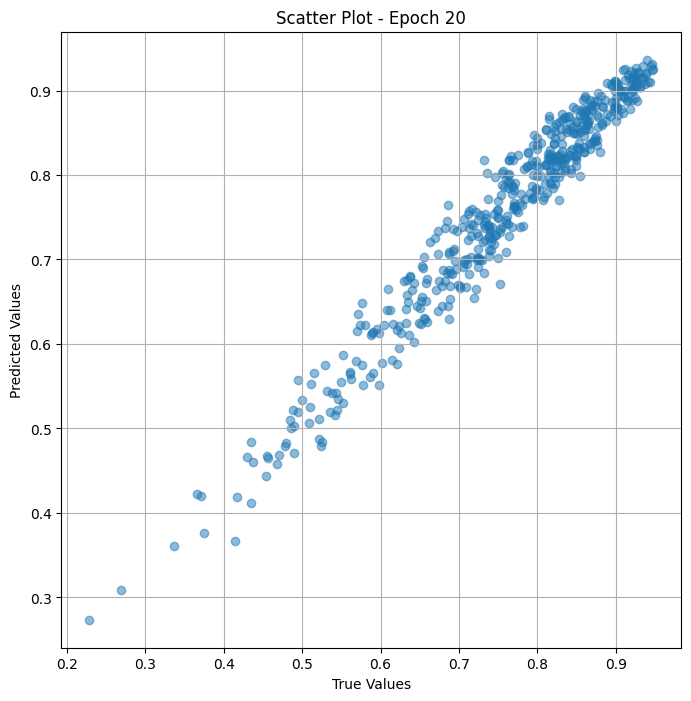

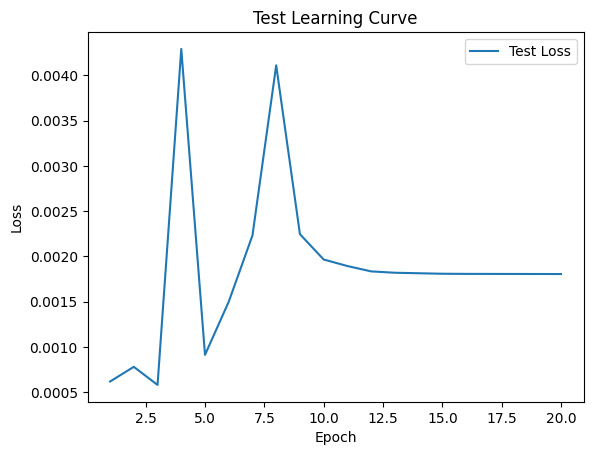


 Epoch: (21/30) Loss = 0.0018036667024716735

 Epoch: (21/30) Loss_rmse = 0.04246959835290909

 Epoch: (21/30) R^2 = 0.8138554096221924

 Epoch: (21/30) MAE = 0.038294848054647446
Spearman correlation coefficient: SignificanceResult(statistic=0.9732677534099105, pvalue=1.5298518303514982e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

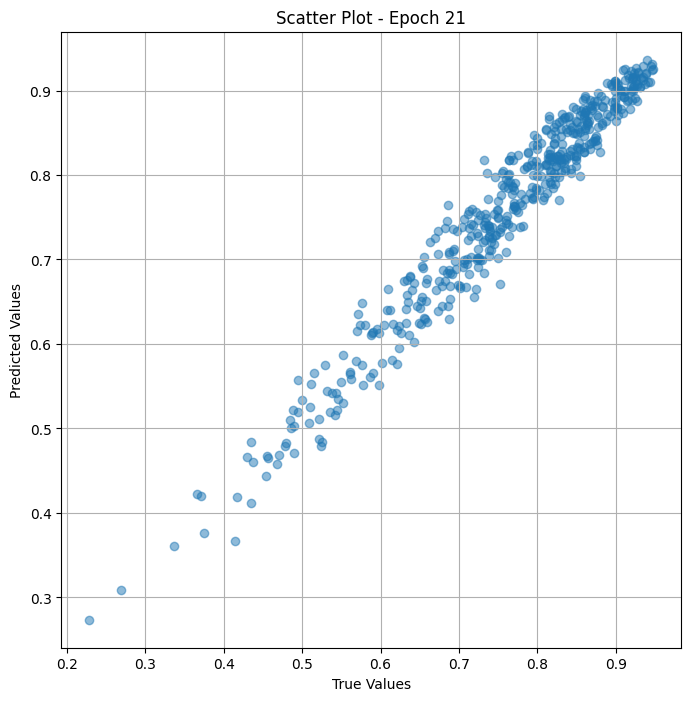

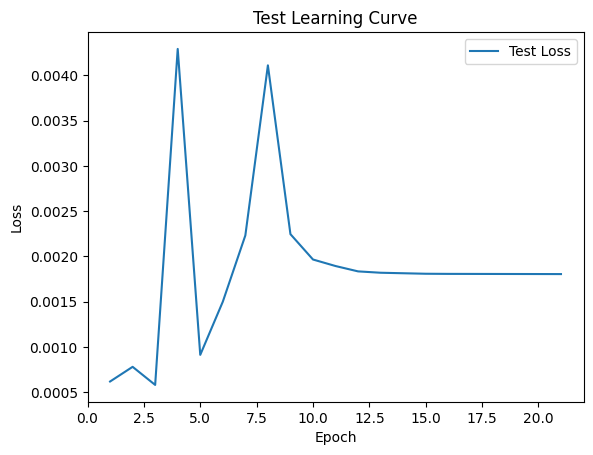


 Epoch: (22/30) Loss = 0.0018031898653134704

 Epoch: (22/30) Loss_rmse = 0.042463984340429306

 Epoch: (22/30) R^2 = 0.8139045834541321

 Epoch: (22/30) MAE = 0.03828969970345497
Spearman correlation coefficient: SignificanceResult(statistic=0.9732677534099105, pvalue=1.5298518303514982e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

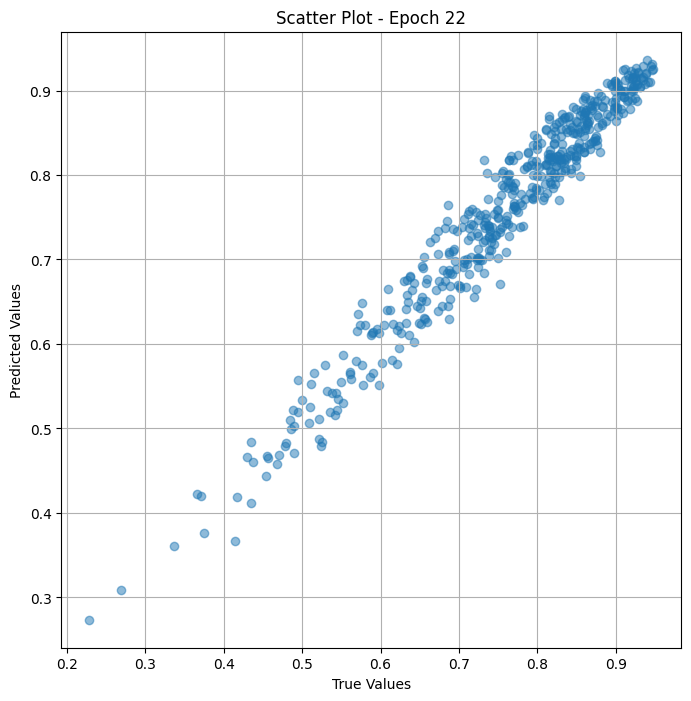

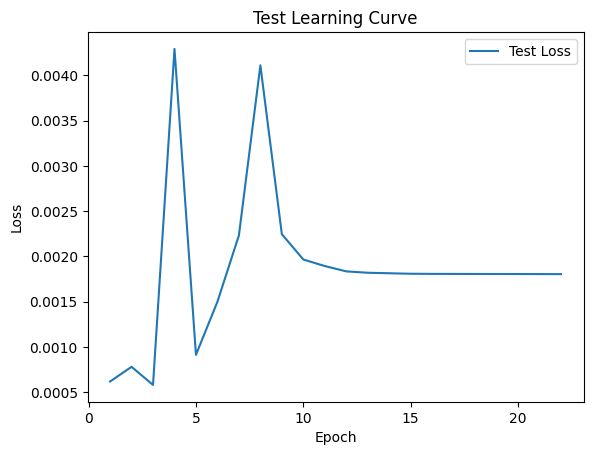


 Epoch: (23/30) Loss = 0.001802703714929521

 Epoch: (23/30) Loss_rmse = 0.04245825856924057

 Epoch: (23/30) R^2 = 0.813954770565033

 Epoch: (23/30) MAE = 0.03828444704413414
Spearman correlation coefficient: SignificanceResult(statistic=0.9732718767053415, pvalue=1.475207795680382e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

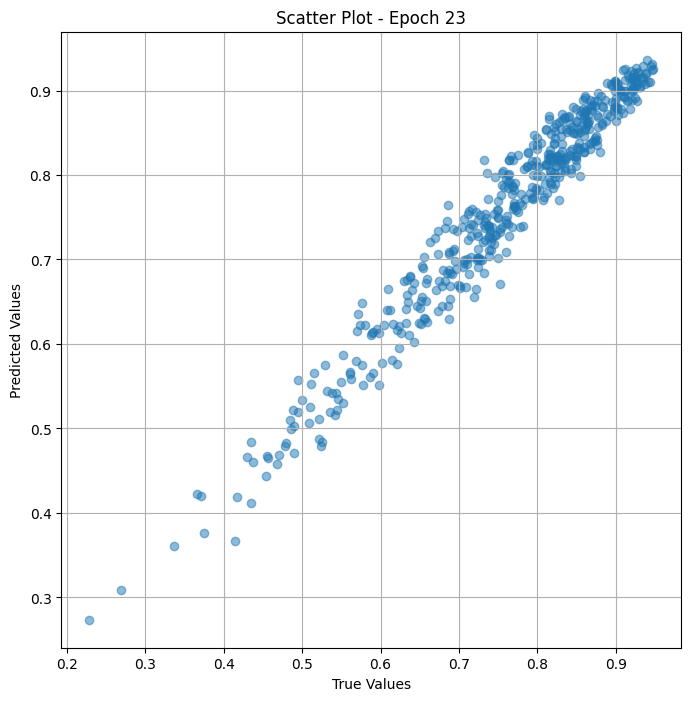

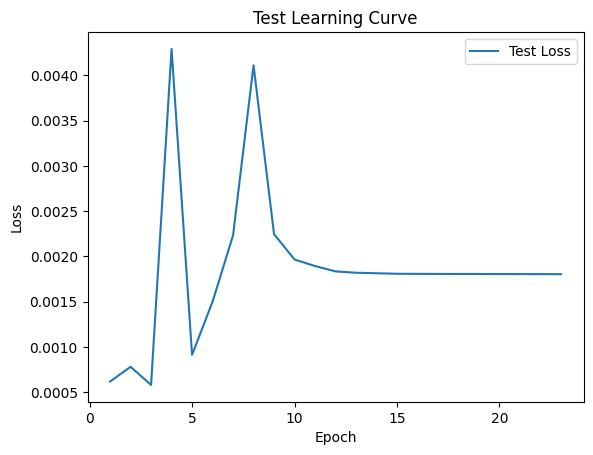


 Epoch: (24/30) Loss = 0.0018022079020738602

 Epoch: (24/30) Loss_rmse = 0.04245242103934288

 Epoch: (24/30) R^2 = 0.814005970954895

 Epoch: (24/30) MAE = 0.03827908635139465
Spearman correlation coefficient: SignificanceResult(statistic=0.9732718767053415, pvalue=1.475207795680382e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49425

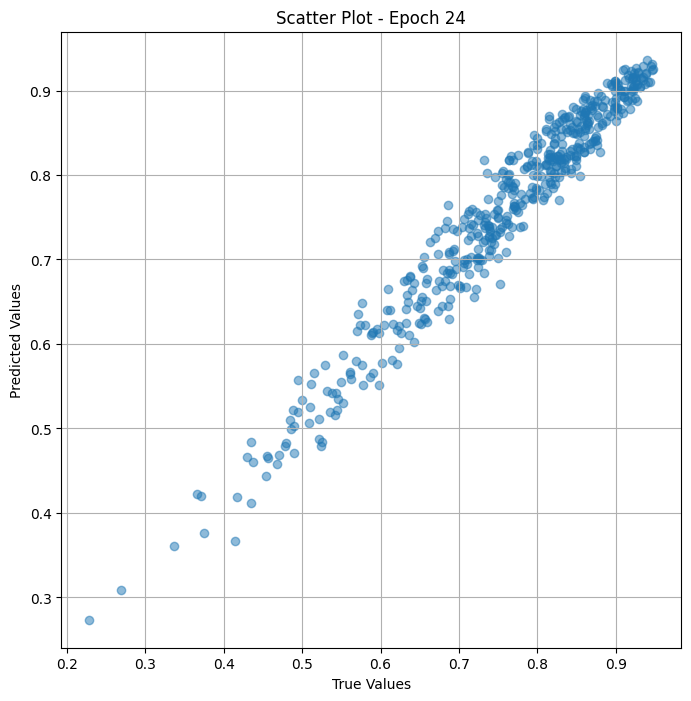

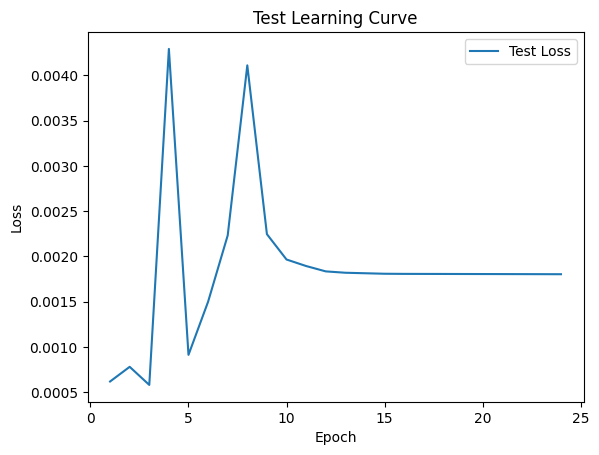


 Epoch: (25/30) Loss = 0.0018017053371295333

 Epoch: (25/30) Loss_rmse = 0.042446501553058624

 Epoch: (25/30) R^2 = 0.8140578269958496

 Epoch: (25/30) MAE = 0.0382736511528492
Spearman correlation coefficient: SignificanceResult(statistic=0.9732718767053415, pvalue=1.475207795680382e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4942

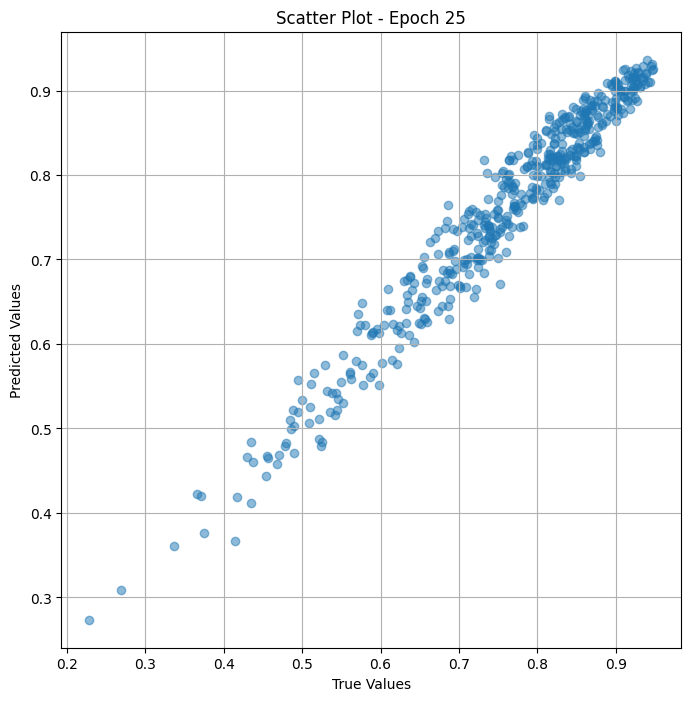

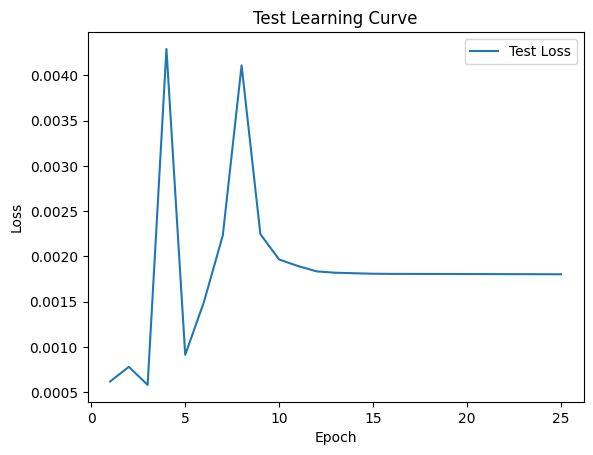


 Epoch: (26/30) Loss = 0.001801194273866713

 Epoch: (26/30) Loss_rmse = 0.04244047775864601

 Epoch: (26/30) R^2 = 0.814110517501831

 Epoch: (26/30) MAE = 0.03826814144849777
Spearman correlation coefficient: SignificanceResult(statistic=0.9732718767053415, pvalue=1.475207795680382e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.494252

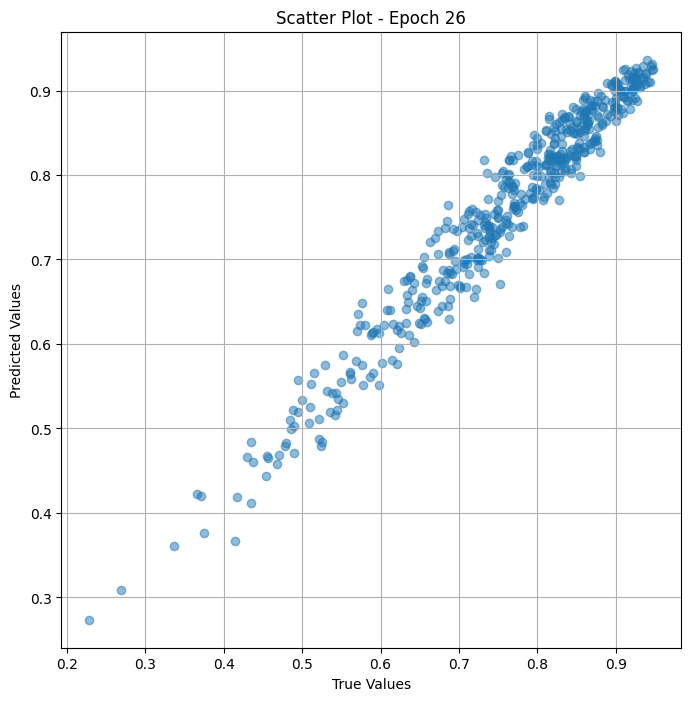

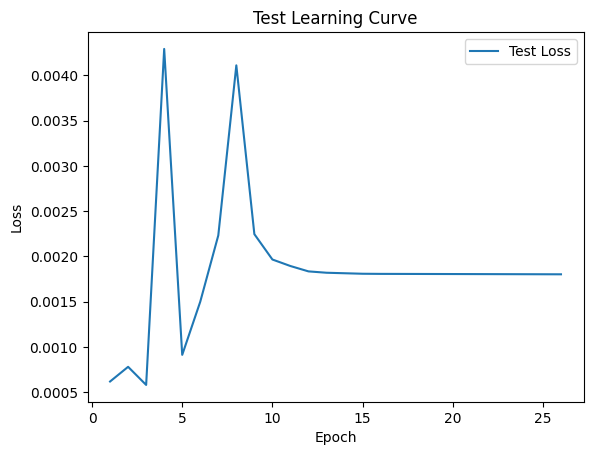


 Epoch: (27/30) Loss = 0.0018006740137934685

 Epoch: (27/30) Loss_rmse = 0.04243434965610504

 Epoch: (27/30) R^2 = 0.8141642212867737

 Epoch: (27/30) MAE = 0.038262512534856796
Spearman correlation coefficient: SignificanceResult(statistic=0.9732873933170952, pvalue=1.2864341530700133e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

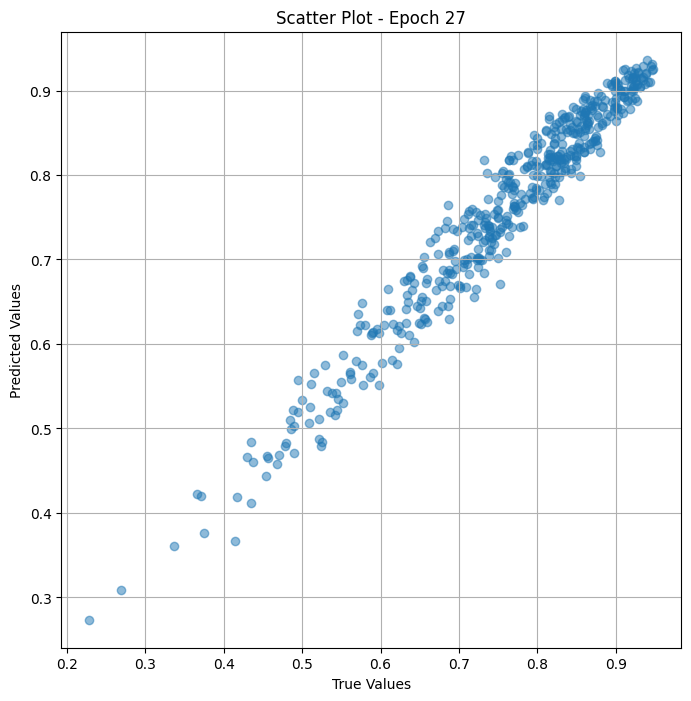

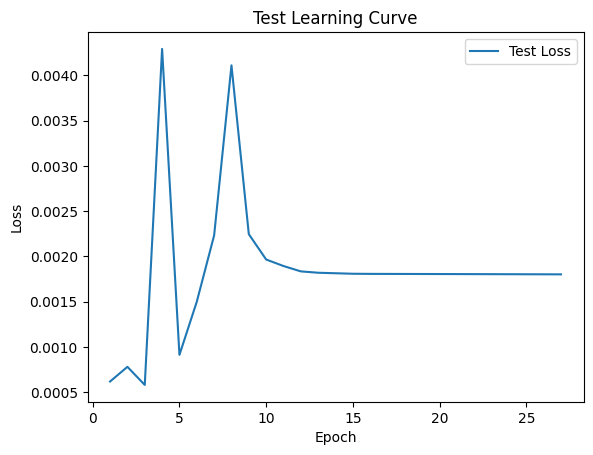


 Epoch: (28/30) Loss = 0.0018001471180468798

 Epoch: (28/30) Loss_rmse = 0.042428139597177505

 Epoch: (28/30) R^2 = 0.8142186403274536

 Epoch: (28/30) MAE = 0.038256820291280746
Spearman correlation coefficient: SignificanceResult(statistic=0.9732889124259383, pvalue=1.2692987984792017e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.4

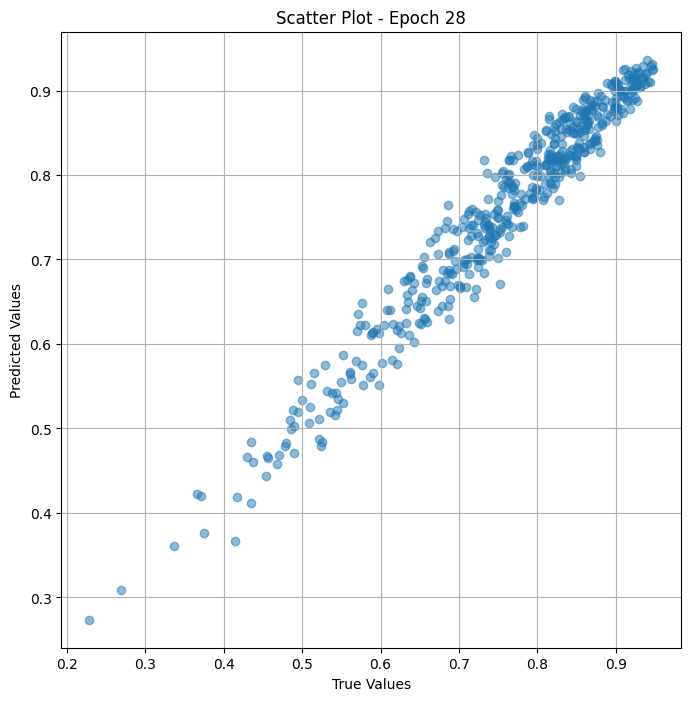

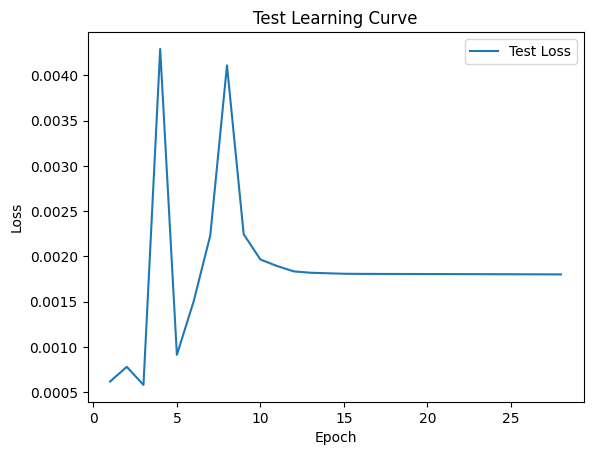


 Epoch: (29/30) Loss = 0.001799612888135016

 Epoch: (29/30) Loss_rmse = 0.042421843856573105

 Epoch: (29/30) R^2 = 0.8142737746238708

 Epoch: (29/30) MAE = 0.038251038640737534
Spearman correlation coefficient: SignificanceResult(statistic=0.9732889124259383, pvalue=1.2692987984792017e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

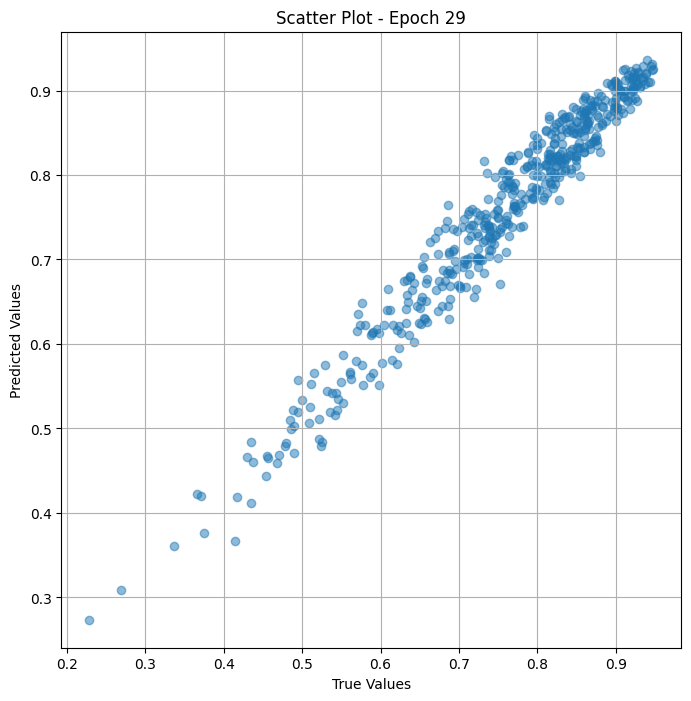

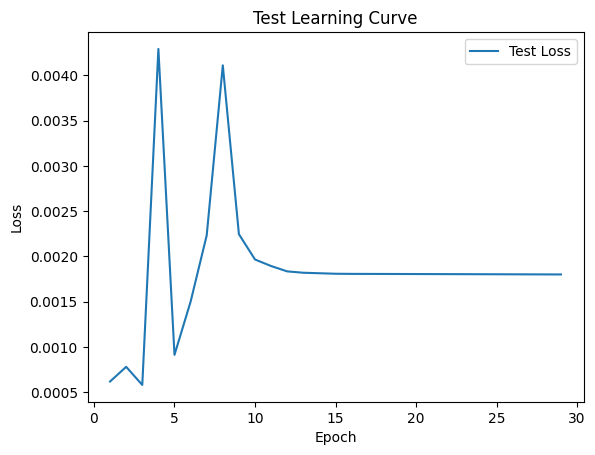


 Epoch: (30/30) Loss = 0.001799072022549808

 Epoch: (30/30) Loss_rmse = 0.042415469884872437

 Epoch: (30/30) R^2 = 0.8143295645713806

 Epoch: (30/30) MAE = 0.038245197385549545
Spearman correlation coefficient: SignificanceResult(statistic=0.9732954771462955, pvalue=1.1978248986225325e-307)

 true_values_list_val : 500

 predicted_values_list_val : 500

 true_values_list_val : [0.83035713, 0.37078652, 0.84090906, 0.92134833, 0.94, 0.91071427, 0.5740741, 0.73636365, 0.7830189, 0.68421054, 0.7529412, 0.815534, 0.82978725, 0.9255319, 0.6699029, 0.75555557, 0.65384614, 0.84, 0.71681416, 0.787037, 0.71304345, 0.8695652, 0.9263158, 0.8041237, 0.7628866, 0.7117117, 0.8604651, 0.8804348, 0.5714286, 0.60952383, 0.4347826, 0.7878788, 0.86904764, 0.7553192, 0.83157897, 0.872093, 0.75, 0.8521739, 0.6530612, 0.7627119, 0.71276593, 0.90909094, 0.82857144, 0.8446602, 0.84444445, 0.8214286, 0.70408165, 0.4888889, 0.86538464, 0.58064514, 0.9191919, 0.8606557, 0.6938776, 0.91588783, 0.82828283, 0.49

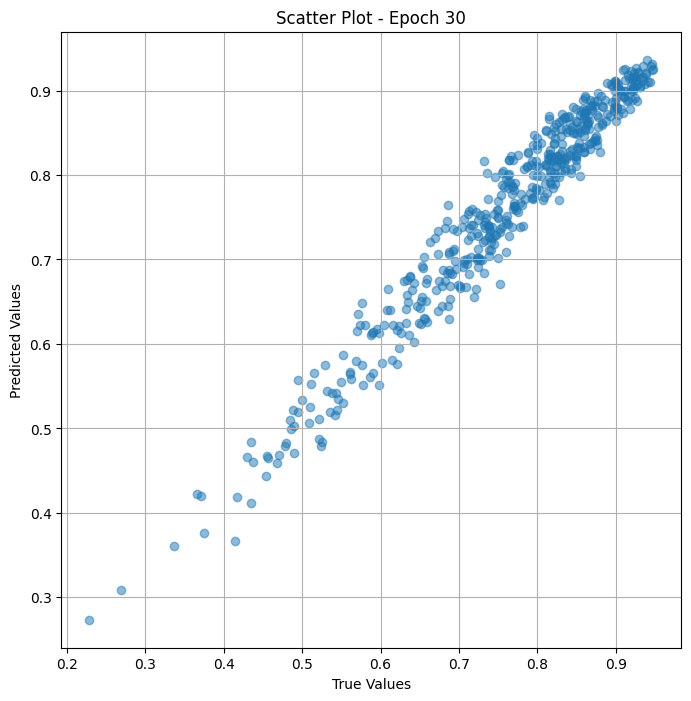

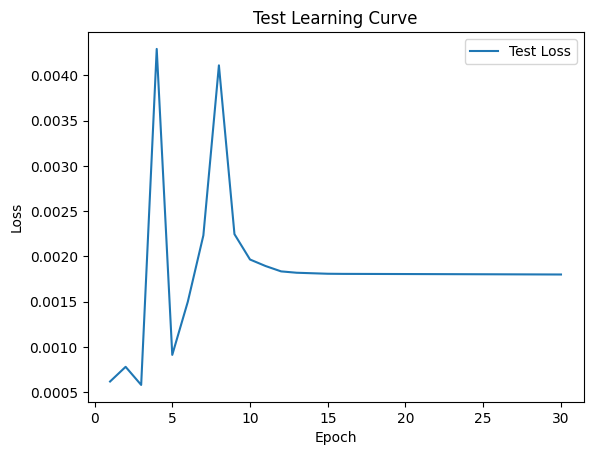

In [ ]:
# val the model and save weights
fit(30, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_merge' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_merge['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                            Image Path  True Value  \
0       /content/merged/n02332755_342_preprocessed.jpg    0.830357   
1    /content/merged/6bfa7b57d0deb743_preprocessed.jpg    0.370787   
2    /content/merged/8ec8d873e23d2435_preprocessed.jpg    0.840909   
3     /content/merged/n03670208_41966_preprocessed.jpg    0.921348   
4        /content/merged/000000233169_preprocessed.jpg    0.940000   
..                                                 ...         ...   
495      /content/merged/000000124462_preprocessed.jpg    0.923077   
496  /content/merged/sun_awesiopwrhjoojme_preproces...    0.637255   
497      /content/merged/000000259491_preprocessed.jpg    0.682243   
498      /content/merged/000000420002_preprocessed.jpg    0.766667   
499      /content/merged/000000076372_preprocessed.jpg    0.760417   

     Predicted Value  
0           0.846088  
1           0.420088  
2           0.853775  
3           0.901511  
4           0.936448  
..               ... 